In [1]:
%load_ext autoreload
%autoreload 2

import time
import numpy as np

# Constants

In [2]:
sample_rate = 44100
hop_size = 441*2
hidden_mod = 3
maximum = 32
width = 4
ds_path = './datasets/VN/ds.pkl'
model_path = './models/VN/model09_'

# Data Class

In [3]:
import os
import re
import json
import math
import cv2
import subprocess as sp
from osr2mp4.EEnum.EReplay import Replays
from osr2mp4.osr2mp4 import Osr2mp4
import torch
import torchvision.io as vision
import torchvision.transforms as transforms

In [4]:
class OSR():
    def __init__(self, beatmap_dir, beatmap, sample_rate=44100, hop_size=441, hidden=False,
                 width=4,
                 tmp='./tmp', vtmp='./vid', atmp='./wav'):
        self.beatmap = beatmap
        self.beatmap_dir = beatmap_dir
        self.beatmap_path = os.path.join(self.beatmap_dir, self.beatmap)
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.rate = int(sample_rate / hop_size)
        self.fps = self.rate
        self.tmp = tmp
        self.vtmp = vtmp
        self.atmp = atmp
        self.width = 4
        self.hidden = hidden
        self.data_json = os.path.join(self.tmp, self.beatmap + '.json')
        hdn = 'hdn' if hidden else ''
        self.video_path = os.path.join(self.vtmp, self.beatmap + hdn + '.avi')
        
        self.replay_info = None
        self.osr2mp4 = None
        self.video = None
        self.hitobjects = None
        self.cursorstream = None
        self.timestamp = None
                
    def run_osr2mp4(self):
        d = json.load(open('data.json', 'r'))
        f = open(self.data_json, 'w')
        d['Beatmap path'] = self.beatmap_path
        if self.hidden is False:
            d['Skin path'] = './skin'
        else:
            d['Skin path'] = './skin_hidden'
        d['FPS'] = self.fps
        d['Output path'] = self.video_path
        json.dump(d, f)
        f.close()
                 
        self.osr2mp4 = Osr2mp4(filedata=self.data_json, filesettings='settings.json', filepp='ppsettings.json', 
                               filestrain='strainsettings.json', logtofile=True)
        while True:
            if self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_X] == 0 and self.osr2mp4.replay_info.play_data[-1][Replays.CURSOR_Y] == 0:
                self.osr2mp4.replay_info.play_data = self.osr2mp4.replay_info.play_data[0:-1]
            else:
                break
        
    def create_vid(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        cmd = ['python', 'create_vid.py', self.data_json]
        proc = sp.Popen(cmd)
        proc.wait()
        
    def parse_timings(self):
        if self.video is None:
            self.get_video()
        self.beat_len = []
        self.timestamp = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'BeatDivisor.*', l):
                self.BeatDivisor = int(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[TimingPoints\]', l):
                break
        for l in f:
            if l == "\n":
                break
            a = l.split(',')
            if float(a[1]) < 0:
                continue
            self.beat_len.append(float(a[1]))
            self.timestamp.append(float(a[0]))
        self.timestamp.append(int(self.video[1].shape[1] / self.video[2]['audio_fps'] * 1000))
        f.close()
    
    def parse_hitobjects(self):
        self.hitobjects = []
        f = open(self.beatmap_path)
        for l in f:
            if re.match(r'ApproachRate.*', l):
                AR = float(l.split(':')[1])
                if AR < 5.0:
                    preempt = 1200 + 600 * (5 - AR) / 5
                    fadein = 800 + 400 * (5 - AR) / 5
                else:
                    preempt = 1200 - 750 * (AR - 5) / 5
                    fadein = 800 - 500 * (AR - 5) / 5
                self.preempt = preempt - fadein*0.1
                break
        f.seek(0)
        for l in f:
            if re.match(r'SliderMultiplier.*', l):
                self.sliderMultiplier = float(l.split(':')[1])
                break
        f.seek(0)
        for l in f:
            if re.match(r'\[HitObjects\]', l):
                break
        for l in f:
            self.hitobjects.append(l.split(','))
        f.close()
    
    def parse_beatmap(self):
        self.parse_timings()
        self.parse_hitobjects()
        
    def create_cursor_peak(self, y, i):
        alen = len(y)
        w = self.width/2/2
        
        def func(x):
            return math.exp(-j**2/w**2)
        
        j = 0 
        while i+j > 0 and abs(j) <= w*2:
            f = func(j)
            y[i+j][Replays.KEYS_PRESSED] = max(y[i+j][Replays.KEYS_PRESSED], f, 0)
            j -= 1
        j = 0
        while i+j < alen and abs(j) <= w*2:
            f = func(j)
            y[i+j][Replays.KEYS_PRESSED] = max(y[i+j][Replays.KEYS_PRESSED], f, 0)
            j += 1
    
    def process_beatobjects(self):
        pass
    
    def process_hitobjects(self):
        if self.hitobjects is None:
               self.parse_beatmap()
        self.hitobjStream = [None] * math.ceil(self.timestamp[-1] * 0.001 * self.rate)
    
    def process_clicks(self):
        pass
    
    def process_cursor(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        n = math.ceil((self.osr2mp4.replay_info.play_data[-1][Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)
        self.cursorstream = [None] * n
        #self.cursorstream = np.zeros((n, 3))
        
        for j in range(len(self.osr2mp4.replay_info.play_data) - 1):
            a = self.osr2mp4.replay_info.play_data[j]
            b = self.osr2mp4.replay_info.play_data[j+1]
            delta = (b[Replays.TIMES] - a[Replays.TIMES]) * 0.001 * self.fps
            xdist = b[Replays.CURSOR_X] - a[Replays.CURSOR_X]
            ydist = b[Replays.CURSOR_Y] - a[Replays.CURSOR_Y]
            stime = (a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps
            x = a[Replays.CURSOR_X]
            y = a[Replays.CURSOR_Y]
            
            e = np.array([0.0, 0.0, 0])
            if self.hidden is False:
                for t in range(math.ceil(delta)):
                    e[Replays.CURSOR_X] = x + xdist/delta*t
                    e[Replays.CURSOR_Y] = y + ydist/delta*t
                    self.cursorstream[int(stime + t)] = torch.tensor(e, dtype=torch.float)
            else:
                def f(x, dist):
                    if dist == 0:
                        return x
                    c = 20
                    o = dist/2
                    return o*2 * 1 / (1 + math.exp(-1 * c * (x - o) / o))
                for t in range(math.ceil(delta)):
                    e[Replays.CURSOR_X] = x + f(xdist/delta*t, xdist)
                    e[Replays.CURSOR_Y] = y + f(ydist/delta*t, ydist)
                    self.cursorstream[int(stime + t)] = torch.tensor(e, dtype=torch.float)
                
            e[Replays.KEYS_PRESSED] = a[Replays.KEYS_PRESSED]
            e[Replays.CURSOR_X] = a[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = a[Replays.CURSOR_Y]
            self.cursorstream[int((a[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
            e[Replays.KEYS_PRESSED] = b[Replays.KEYS_PRESSED]
            e[Replays.CURSOR_X] = b[Replays.CURSOR_X]
            e[Replays.CURSOR_Y] = b[Replays.CURSOR_Y]
            self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
        
    def process_events(self):
        self.process_clicks()
        self.process_cursor()
        
    def read_video(self, scale=1):
        if not os.path.exists(self.video_path):
            self.create_vid()
        #self.video = vision.read_video(self.video_path)
        transform = transforms.ToTensor()
        frames = []
        vc = cv2.VideoCapture(self.video_path)
        while True:
            r, f = vc.read()
            f = cv2.resize(f, (0,0), fx=scale, fy=scale)
            frames.append(transform(f))
            if r is False:
                break
        return torch.stack(frames)
        
    def queue_vid(self):
        if not os.path.exists(self.video_path):
            self.create_vid()   
        return self.video_path
    
    def get_offset(self):
        if self.osr2mp4 is None:
            self.run_osr2mp4()
        return self.osr2mp4.replay_info.play_data[0][Replays.TIMES]
    
    def get_beatobjects(self):
        if self.beatobjStream is None:
            self.process_beatobjects()
        stream = [None] * len(self.beatobjStream)
        for i in range(len(self.beatobjStream)):
            if self.beatobjStream[i] == [] or self.beatobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.beatobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
        
    def get_hitobjects(self):
        if self.hitobjStream is None:
            self.process_hitobjects()
        stream = [None] * len(self.hitobjStream)
        for i in range(len(self.hitobjStream)):
            if self.hitobjStream[i] == [] or self.hitobjStream == None:
                h = np.array([0], dtype=np.float32)
            else:
                h = np.array(self.hitobjStream[i], dtype=np.float32)
            stream[i] = torch.tensor(np.pad(h, (0, 64 - h.shape[0])))
        return torch.stack(stream)
    
    def get_cursor(self):
        if self.cursorstream is None:
            self.process_events()
        return torch.stack(self.cursorstream)
        
    def get_video(self, scale=1):
        if self.video is None:
            self.read_video(scale=1)
        return self.video

# Dataset

In [5]:
import glob
import copy
import traceback
import torch
import torchvision.transforms as transforms
from torch.utils.data import Dataset
import cv2
import matplotlib.pyplot as plt

In [6]:
class OSR_Dataset(Dataset):
    def __init__(self, beatmap_dir, sample_rate=44100, hop_size=441, seq_dur=10, scale=1, hidden_mod=0, maximum=100):
        self.beatmap_dir = beatmap_dir
        self.sample_rate = sample_rate
        self.hop_size = hop_size
        self.seq_len = int(seq_dur * sample_rate / hop_size)
        self.hidden_mod = hidden_mod
        self.maximum = maximum
        self.scale = scale
        
        self.osrs = []
        
        if beatmap_dir is None:
            self.v = []
            self.c = []
            return
        
        j = 0
        def parse_beatmaps(j):
            for r, dirs, _ in os.walk(beatmap_dir):
                for dir in dirs:
                    for root, _, files in os.walk(os.path.join(r, dir)):
                        for f in files:
                            if re.match(r'.*osu$', f):
                                if self.hidden_mod == 0 or j % self.hidden_mod != 0:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size))
                                else:
                                    self.osrs.append(OSR(root, f, sample_rate=sample_rate, hop_size=hop_size, hidden=True))
                                if j == self.maximum:
                                    return j
                                j += 1
            return j
        j = parse_beatmaps(j)
        
        self.v = [None] * j
        self.c = [None] * j
        
        def process(i):
            m = self.osrs[i]
            self.osrs[i] = None;
            try:
                print(str(i) + '/' + str(j-1), m.beatmap)
                self.v[i] = copy.deepcopy(m.queue_vid())
                self.c[i] = copy.deepcopy(m.get_cursor())
            except Exception as e:
                traceback.print_exc()
                print("pruning:", m.beatmap)
                self.v[i] = None
                self.c[i] = None
            del m
        
        list(map(process, range(j)))
        
        self.v = list(filter(lambda x: x is not None, self.v))
        self.c = list(filter(lambda x: x is not None, self.c))
        
    def take(self, ds, i, j):
        self.v = ds.v[i:j]
        self.c = ds.c[i:j]

    def __len__(self):
        return len(self.v)

    def __getitem__(self, i):
        if self.seq_len == 0:
            return None
        
        transform = transforms.ToTensor()
        j = np.random.randint(0, self.c[i].shape[0] - self.seq_len)
        vc = cv2.VideoCapture(self.v[i])
        vc.set(cv2.CAP_PROP_POS_FRAMES, j)
        #for k in range(j):
        #    _, _ = vc.read()
        
        f = [None] * self.seq_len
        for k in range(self.seq_len):
            frame = vc.read()[1]
            frame = cv2.resize(frame, (0,0), fx=self.scale, fy=self.scale)
            frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
            f[k] = transform(frame)
        
        c = self.c[i][j: j+self.seq_len]
        cy = torch.div(c[:,Replays.CURSOR_Y], 384) #, dtype=c.type())
        c[:,1] = torch.div(c[:,Replays.CURSOR_X], 512) #, dtype=c.type())
        c[:,0] = cy
        
        return (torch.stack(f), c) #self.c[i][j: j+self.seq_len])256

# Testing

In [7]:
ds = OSR_Dataset('../ex/beatmaps', sample_rate=sample_rate, hop_size=hop_size, hidden_mod=1, maximum=1)

0/0 sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osu
***********************************************************
['ffmpeg', '-y', '-loglevel', 'info', '-thread_queue_size', '24', '-f', 'rawvideo', '-vcodec', 'rawvideo', '-s', '1024x600', '-pix_fmt', 'yuv420p', '-r', '50.00', '-an', '-i', '-', '-i', '/tmp/8b935ce0-c0c2-11ec-aa61-a85e4554c351temp/audio.mp3', '-acodec', 'aac', '-vcodec', 'mjpeg', '-preset', 'fast', '-crf', '18', '-ab', '320k', '-threads', '0', "./vid/sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-'s Hard].osuhdn.avi"]
***********************************************************


(600, 1024, 1)
tensor(0.8164) tensor(0.9062)
(349, 245)


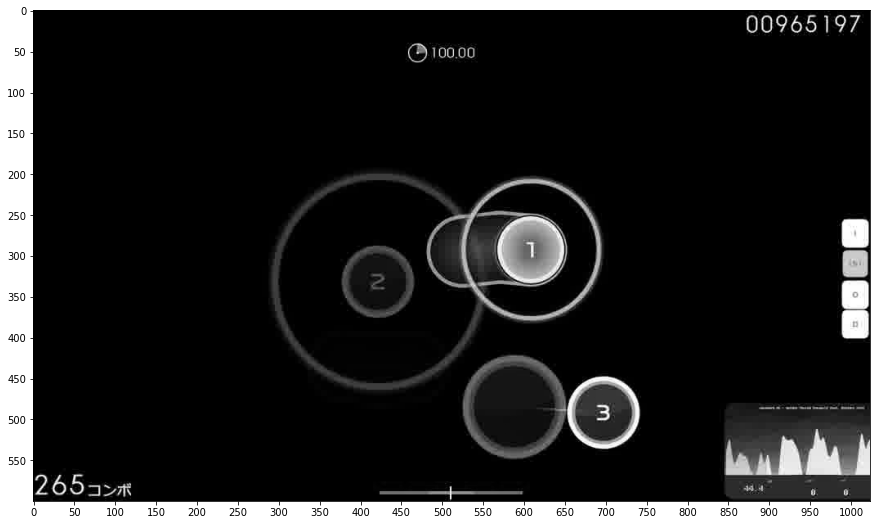

In [49]:
import matplotlib.pyplot as plt

import op

op.h = 600 / 2
op.w = 1024 / 2
op.calratio()

e = ds[0]
print(e[0][0].permute(1, 2, 0).numpy().shape)

plt.rcParams["figure.figsize"] = (15, 15)

plt.xticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[1], 50))
plt.yticks(np.arange(0, e[0][0].permute(1, 2, 0).numpy().shape[0], 50))

plt.imshow(cv2.cvtColor(e[0][0].permute(1, 2, 0).numpy(), cv2.COLOR_BGR2RGB))
print(e[1][0][1], e[1][0][0])
print(op.cor(e[1][0][1] * 512, e[1][0][0] * 384))
#print(op.cor(e[1][0][1], e[1][0][0]))
#for x in e[1][0:10]:
    #print(op.cor(x[0], x[1]))

# Process Data

In [7]:
import time

In [7]:
ds = OSR_Dataset('../beatmaps', sample_rate=sample_rate, hop_size=hop_size, hidden_mod=1, maximum=256)

0/255 Chata - Engage (Lasse) [Insane].osu
1/255 Mimi - Surrealism (feat. ZAT) (-Tatsuo) [no mania].osu
2/255 sana - kanojo wa tabi ni deru (Firika) [Insane].osu
3/255 Ishida Youko - To the Promised Sky ~The place that I was~ (caren) [Collabo].osu
4/255 StylipS - Prism Sympathy(Asterisk Remix) (iMage--) [Kaleid Liner].osu
5/255 Cranky - Chandelier - King (Mao) [Gero's Insane].osu
6/255 senya - Akatsuki no Suiheisen ni (Satellite) [Zweib's Insane].osu
7/255 Tadokoro Azusa - 1HOPE SNIPER (Sotarks) [NiNo's Insane].osu
8/255 fripSide - future gazer (TV Size) (alacat) [Insane].osu
9/255 cYsmix - bells! (Gero) [normal!].osu
10/255 Yazawa Nico (CV.Tokui Sora) - Nicopuri Joshidou (yf_bmp) [z1085684963's Insane].osu
11/255 Hamburgaga - Watame Internet Connection Race (CE6A) [Insane].osu
12/255 xi - Parousia -LAST JUDGMENT- (Zapy) [Retribution].osu
13/255 Shiena Nishizawa - Meaning (Taeyang) [xChippy's Insane].osu
14/255 namirin - Hitokoto no Kyori (sahuang) [Linadeft's Insane].osu
15/255 Narushi

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 7482 in argument 0, but got NoneType


pruning: Fujijo Seitokai Shikkou-bu - Best FriendS (sahuang) [N a s y a's Insane].osu
60/255 Omoi - Chiisana Koi no Uta (Synth Rock Cover) (val0108) [Marianna's Insane].osu
61/255 Natsumi Kiyoura - Tabi no Tochuu (Weinmagier) [Normal].osu
62/255 Nico Nico Douga - U.Nknown Goose (Borokuzu) [Insane].osu
63/255 Hatsune Miku - Moon (Saten ruiko) [Insane].osu
64/255 fripSide - black bullet (TV Size) (Chloe) [Insane].osu
65/255 Hatsune Miku - the last effect (Holoaz) [ringloid].osu
66/255 Gojou Kai - Touhou Youkai Komachi (James) [Normal].osu
67/255 REOL - Hibikase (Gero) [NiNo's Insane].osu
68/255 Kuba Oms - My Love (W h i t e) [Insane].osu
69/255 Yasuo - P - Electric Angel (- Ruby Rose -) [Insane].osu
70/255 Shimotsuki Haruka, Suzuyu - Fairy Wreath (ImpurePug) [Angraecum].osu
71/255 ClariS - Connect (TV Size) (browiec) [Mathew's Insane].osu
72/255 DIVELA feat. Hatsune Miku - BEAT SYNCER (Log Off Now) [Insane].osu
73/255 The Quick Brown Fox - The Big Black (Blue Dragon) [WHO'S AFRAID OF THE

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 6527 in argument 0, but got NoneType


75/255 toby fox - Nyeh Heh Heh! & Bonetrousle (DaxMasterix) [NORMAL].osu
76/255 ryo (supercell) - ODDS&ENDS (Short Ver.) (Betsuto) [Insane].osu
77/255 TRakker - Trail of Dust (Amamiya Yuko) [Trail of Star].osu
78/255 Police Piccadilly feat. Hatsune Miku - Kire Carry On (Sinnoh) [negusver's Insane].osu
79/255 MOSAIC.WAV - Zen Sekai Teki Touch Panel (Laurier) [CrystLer].osu
80/255 Aiobahn & Yunomi - Makuramoto ni Ghost (feat. Nicamoq) (Swan) [Swan's Melanzana].osu
81/255 Camellia - Routing (Shiirn) [pishi's Advanced].osu
82/255 seleP feat. Lily - Chloe-Five Decades Ago- (Duftende Pizza) [V].osu
83/255 dj TAKA - quaver (Monstrata) [Haru's Insane].osu
84/255 Silver Forest Feat. Aki & Sakura Mayuko - Summer time Heaven -after (RVMathew) [Ojou].osu
85/255 Van Darkholme - GachiMuchi circulation (Kr0n0s23) [Thank you, sir!].osu
86/255 Ariabl'eyeS - Senkou no Furea (Kibbleru) [Redemption].osu
87/255 ATeens - Gimme! Gimme! Gimme! (Nightcore Mix) (ShadowSoul) [Gimme!].osu
88/255 Tomoe Tamiyasu - 

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 241, in get_cursor
    return torch.stack(self.cursorstream)
TypeError: expected Tensor as element 512 in argument 0, but got NoneType


pruning: Tomoe Tamiyasu - Yamato Nadeshiko Hanakotoba (Lasse) [Insane].osu
89/255 Masayoshi Minoshima ft. nomico - Bad Apple!! (Ephemeral) [Normal].osu
90/255 solfa feat. Shimotsuki Haruka - Natsuiro Ramune (Lasse) [Bariton's Insane].osu
91/255 Nakagawa Shouko - Sorairo Days (Rizen) [Fizz's Insane].osu
92/255 LeaF - Calamity Fortune (Arphimigon) [BOOM].osu
93/255 cillia - Fairytale, (SkinnyJommy) [Pho's Insane].osu
94/255 Lindsey Stirling - Senbonzakura (MrSergio) [Insane].osu
95/255 Hatsune Miku - Senkouhanabi Aika (val0108) [Insane].osu
96/255 Hatsune Miku - Himitsu Keisatsu (Lalarun) [Insane].osu
97/255 MISATO - Necro Fantasia (WORSTPOLACKEU) [Cheesecake's Insane].osu
98/255 a_hisa - Cheshire,s dance (Muya) [Normal].osu
99/255 Roselia - The Everlasting Guilty Crown (Underdogs) [Insane].osu
100/255 40meter-P - Mousou sketch (Noways) [Insane!].osu
101/255 sasakure.UK x DECO27 - 39 (Finshie) [Insane].osu
102/255 Chata - len (Cami) [xiqingwa's Lunatic].osu
103/255 Fractal Dreamers - Fat

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


121/255 Sawai Miku - Colorful. (Asterisk DnB Remix) (Asfand) [Vibrant].osu
122/255 Yunomi & nicamoq - Indoor Kei Nara Trackmaker (dipperbee) [TrAcK MaKeR].osu
123/255 GTA feat. Sam Bruno - Red Lips (Mendus Remix) (Euny) [Natsu's Insane].osu
124/255 TrySail - Utsuroi (Short Ver.) (Log Off Now) [Nexus' Insane].osu
125/255 ZAQ - Seven Doors (eINess) [wkyik's Insane].osu
126/255 M2U - Stellar (Ultima Fox) [defiance's Insane].osu
127/255 SawanoHiroyuki[nZk]mizuki - aLIEz (jonathanlfj) [Trust's Normal].osu
128/255 YOASOBI - Yoru ni Kakeru (Petal) [Keirelia's Insane].osu
129/255 Usada Pekora - Discommunication Alien (Yugu) [XLT's Insane].osu
130/255 EastNewSound - Sadistic Paranoia (TicClick) [Vass-RJ's Hard].osu
131/255 Sound Souler - Paradise (kwk) [Mir's Insane].osu
132/255 Hatsune Miku - Subarashii Sekai (val0108) [Insane].osu
133/255 AAAA - carnation (Veridian) [noffy's normal].osu
134/255 Kamogawa rokkaazu (CVKubota Kaoru) - STONES (Pata-Mon) [GDInsane [placeholder]].osu
135/255 UNISON 

Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


175/255 petit milady - Koi wa Milk Tea (Okoratu) [Normal].osu
176/255 Dark PHOENiX - Taketori Hishou (KanbeKotori) [Extra].osu
177/255 Mili - Origin (TV Size) (Ryuusei Aika) [kanor's Insane].osu
178/255 Hanataba - Night of Knights (v2b) [Normal].osu
179/255 Sagara Kokoro - Hoshizora no Ima (Star Stream) [Insane].osu
180/255 Hanatan - Uta ni Katachi wa Nai keredo (Asahina Momoko) [Recollection].osu
181/255 PinocchioP - SLoWMoTIoN (Short Ver.)feat.Hatsune Miku (lllmtklll) [Insane].osu
pruning: PinocchioP - SLoWMoTIoN (Short Ver.)feat.Hatsune Miku (lllmtklll) [Insane].osu
182/255 Yoko Takahashi - Zankoku Na Tenshi No These (TV. Size Version) (moph) [Ambient's Insane].osu
183/255 Noboru ft. Hatsune Miku - Shiroi Yuki No Princess Wa (Hokichi) [ShiraHoki's Light Insane].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


184/255 Chitose Sara - Arcadia (Short ver.) (Riven) [-Tochi's Insane].osu
185/255 eyemedia - Bloody Purity (tsuka) [Normal].osu
pruning: eyemedia - Bloody Purity (tsuka) [Normal].osu
186/255 Atoguru - Itoshi Kimi wo Mitsuke ni (Pizza Kun) [Insane].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


187/255 Hanasaka Yui(CV M.A.O) - Harumachi Clover (Naotoshi) [Light Insane].osu
188/255 Hatsune Miku - Ephemeral (Wishkey) [Fade Away].osu
189/255 emon - shake it! (kosiga) [Normal].osu
190/255 Suzuki Konomi - This game (TV Size) (Sekai-nyan) [Nyquill's Insane Game].osu
191/255 Warak - REANIMATE (iyasine) [xsrs's Extra].osu
192/255 Noriko Mitose - The Party of Seven Witches (Kibbleru) [Dereliction].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


pruning: Noriko Mitose - The Party of Seven Witches (Kibbleru) [Dereliction].osu
193/255 Kuroneko Dungeon - Ryoushi no Umi no Lindwurm (Crystal) [ak74's Insane].osu
194/255 Feint - Reprise (Secretpipe) [Sieg's Light Insane].osu
195/255 Umetora - Ifuudoudou (Nymph) [Insane].osu
196/255 Hana - Kuukirikigaku Shoujo to Shounen no Uta (Soleily Remix) (Koiyuki) [Yuki].osu
197/255 wowaka - Unknown Mother-Goose feat. Hatsune Miku (tutuhaha) [Insane].osu
198/255 Megurine Luka - LukaLuka Night Fever (samipale) [Normal+].osu
199/255 paraoka feat. harunya & amane - Trickstar (lahphnya) [Insane].osu
200/255 Silver Forest - PORUTA ~ gaisuto no himatsubushi (Eirene) [Normal].osu
201/255 rerulili - Noushou Sakuretsu Girl (NatsumeRin) [dksslqj Style].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


pruning: rerulili - Noushou Sakuretsu Girl (NatsumeRin) [dksslqj Style].osu
202/255 Yooh - MariannE (Yogurtt) [Extra].osu
203/255 Various Artists - IIDX collection (N a s y a) [V3].osu
204/255 CHiCO with HoneyWorks - Heart no Shuchou (Sotarks) [Yuitarks' Insane].osu
205/255 Demetori - Fall of Fall ~ The Door Into Summer (jonathanlfj) [Extra Stage].osu
206/255 u's - Baby Maybe Koi no Button (Asterisk DnB Remix) (jeydude) [Love Live!].osu
207/255 ALTIMA - Burst The Gravity (TV Size) (bes_joker) [Insane].osu
pruning: ALTIMA - Burst The Gravity (TV Size) (bes_joker) [Insane].osu
208/255 Chiyoko - Baby Fantastic! -Short ver.- (Zweib) [iMage's Insane].osu
209/255 Apocalyptica - Rage of Poseidon (pishifat) [Extreme].osu


Traceback (most recent call last):
  File "/tmp/ipykernel_30336/319404534.py", line 44, in process
    self.c[i] = copy.deepcopy(m.get_cursor())
  File "/tmp/ipykernel_30336/3267943912.py", line 240, in get_cursor
    self.process_events()
  File "/tmp/ipykernel_30336/3267943912.py", line 187, in process_events
    self.process_cursor()
  File "/tmp/ipykernel_30336/3267943912.py", line 183, in process_cursor
    self.cursorstream[int((b[Replays.TIMES] - self.get_offset()) * 0.001 * self.fps)] = torch.tensor(e, dtype=torch.float)
IndexError: list assignment index out of range


210/255 fripSide - snow blind -after- (Mordred) [Tears Like Snowflakes].osu
211/255 ryo (supercell) feat.Hatsune Miku - Tsumi no Namae (Monstrata) [Blooming].osu
212/255 Uehara Rena - Todokanai Koi '13 (TV EDIT) (Sellenite) [Rewrite].osu
213/255 Giga-P - LUVORATORRRRRY! (Selisi) [Insane].osu
214/255 Barbarian On The Groove feat. Takizawa Ichiru - Yoi ni Kanawazu (Shurelia) [Hard].osu
215/255 livetune feat.Hatsune Miku - Last Night, Good Night (Autumn) [Oyasumi].osu
216/255 MiddleIsland - Achromat (zxhzxhz) [Insane].osu
217/255 Tamura Yukari - MERRY MERRY MERRY MENU... Ne! (moonlightleaf) [wkyik's Insane].osu
218/255 Dreamcatcher - YOU AND I (Natsu) [Insane].osu
219/255 M2U - Dual Fractal (Hailie) [Insane].osu
220/255 EGOIST - Namae no Nai Kaibutsu (LunarSakuya) [lfj's Insane].osu
221/255 ginkiha - dawn(ginkiha hardcore remix) (Aka) [Kyubey's Insane].osu
222/255 seleP - Remember me (Avishay) [A's Extra].osu
223/255 Kano - Stella-rium (Kowari) [Insane].osu
224/255 IOSYS - Hakurei Jinja (

In [8]:
start = time.time()

torch.save(ds, ds_path)

end = time.time()
print(end - start, 'secs')

0.0817873477935791 secs


# Load Daaset

In [7]:
ds = torch.load(ds_path)

# Model

In [8]:
import math
import torch
import torch.nn as nn
import torch.nn.functional as nnF

from attention.attention import SpatialAttn, ProjectorBlock

In [9]:
class VN(nn.Module):
    def __init__(self, dim_in, device):
        super(VN, self).__init__()
        
        self.device = device
        self.lstmA_size = 256
        self.lstmA_layers = 2
        self.dim_out = 2
        
        #self.convA1 = nn.Conv3d(1, 1, (3, 1, 1), stride=1, padding=0)
        self.convB1 = nn.Conv2d(1, 4, 3, stride=1, padding=1) 
        self.maxPB1 = nn.MaxPool2d(3, stride=2, padding=1)

        self.convC1 = nn.Conv2d(4, 8, 3, stride=1, padding=1) 
        self.maxPC1 = nn.MaxPool2d(3, stride=2, padding=1)
        
        #self.linear1 = nn.Linear(19456, 1024)
       
        self.lstmA = nn.LSTM(19456, hidden_size=self.lstmA_size, num_layers=self.lstmA_layers,
                             batch_first=True, bidirectional=False)
        self.linearA = nn.Linear(self.lstmA_size, self.lstmA_size)
        self.normA = nn.LayerNorm(self.lstmA_size)
        self.linearB = nn.Linear(self.lstmA_size, 32)
        self.normB = nn.LayerNorm(32)
        self.linearC = nn.Linear(32, self.dim_out)
        
        self.hiddenA = None
        
    def _make_layer(self, in_features, out_features, blocks, pool=False):
        layers = []
        for i in range(blocks):
            conv2d = nn.Conv2d(in_channels=in_features, out_channels=out_features, kernel_size=3, padding=1, bias=False)
            layers += [conv2d, nn.BatchNorm2d(out_features), nn.ReLU(inplace=True)]
            in_features = out_features
            if pool:
                layers += [nn.MaxPool2d(kernel_size=2, stride=2)]
        return nn.Sequential(*layers)
        
    def init_hidden(self, batch_size):
        h = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        c = torch.zeros(self.lstmA_layers, batch_size, self.lstmA_size).to(self.device)
        self.hiddenA = (h, c)
 
    def forward(self, x):
        s = x.shape
        x = torch.reshape(x, (s[0] * s[1], s[2], s[3], s[4]))
        
        #x = x.unsqueeze(1)
        #x = self.convA1(x)
        #x = nnF.relu(x)
        #x = x.squeeze(1)
        x = self.convB1(x)
        x = nnF.relu(x)
        x = self.maxPB1(x)
        x = self.convC1(x)
        x = nnF.relu(x)
        x = self.maxPC1(x)
        
        x = torch.flatten(x, start_dim=1)
        x = torch.reshape(x, (s[0], s[1], x.shape[-1]))
        
        #x = self.linear1(x)
        
        x, self.hiddenA = self.lstmA(x, self.hiddenA)
        x = self.linearA(x)
        x = self.normA(x)
        x = nnF.tanh(x)
        x = self.linearB(x)
        x = self.normB(x)
        x = nnF.tanh(x)
        x = self.linearC(x)
        x = nnF.sigmoid(x)
        
        return x

# Training

In [10]:
import torch
from torch.utils.data import DataLoader
from torchinfo import summary
from qqdm.notebook import qqdm
import matplotlib.pyplot as plt
import op

In [11]:
batch_size = 1
scale = 1/4
dim_in = (int(600 * scale), int(1024 * scale))
seq_dur = 2

In [12]:
device = torch.device('cuda')

In [45]:
epoch_cum = 0
best_loss = 9999
best_weights = None
val_hist = []
train_hist = []
vn = VN(dim_in=dim_in, device=device)
vn.to(device)

VN(
  (convB1): Conv2d(1, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPB1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (convC1): Conv2d(4, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPC1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (lstmA): LSTM(19456, 256, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=256, out_features=256, bias=True)
  (normA): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
  (linearB): Linear(in_features=256, out_features=32, bias=True)
  (normB): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
  (linearC): Linear(in_features=32, out_features=2, bias=True)
)

In [46]:
vn.init_hidden(1)
summary(vn, input_size=(1, 1, 1, dim_in[0], dim_in[1]), col_width=16,
           col_names=["input_size",
                "output_size",
                "num_params",
                "kernel_size",
                "mult_adds",])

Layer (type:depth-idx)                   Input Shape      Output Shape     Param #          Kernel Shape     Mult-Adds
VN                                       --               --               --               --               --
├─Conv2d: 1-1                            [1, 1, 150, 256] [1, 4, 150, 256] 40               [1, 4, 3, 3]     1,536,000
├─MaxPool2d: 1-2                         [1, 4, 150, 256] [1, 4, 75, 128]  --               --               --
├─Conv2d: 1-3                            [1, 4, 75, 128]  [1, 8, 75, 128]  296              [4, 8, 3, 3]     2,841,600
├─MaxPool2d: 1-4                         [1, 8, 75, 128]  [1, 8, 38, 64]   --               --               --
├─LSTM: 1-5                              [1, 1, 19456]    [1, 1, 256]      20,713,472       --               20,713,472
├─Linear: 1-6                            [1, 1, 256]      [1, 1, 256]      65,792           [256, 256]       65,792
├─LayerNorm: 1-7                         [1, 1, 256]      [1, 1, 256]  

In [15]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

In [16]:
criterion = nn.L1Loss(reduction='sum')
optimizer = torch.optim.Adam(vn.parameters(), lr=0.001)

In [17]:
op.h = dim_in[0]
op.w = dim_in[1]
op.calratio()

def trainVN():
    global epoch_cum
    global best_loss, best_weights
    global v, c, PV, pv, g, gt, MP, MC
    
    print(1, 'of', epochs+epoch_cum)    
    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for i, (v, c) in enumerate(val_ldr):
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()
            print("\r                                                           ", end="\r")
            print("\rval:", str(i) + '/' + str(len(val_ds)), "loss:", f'{loss.item():.4f}', end="\r")
        print('')

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 3)
        
        e = v[0][-32].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[1] * 512, pv[0] * 384)
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[1] * 512, gt[0] * 384)
        p[1].set_xlim([0, 512])
        p[1].set_ylim([-128, 384])
        p[1].invert_yaxis()
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        plt.show()
        
        print("\n", epoch+epoch_cum+1, 'of', epochs+epoch_cum)

        if val_loss < best_loss:
            best_loss = val_loss
            best_weights = vn.state_dict().copy()

    epoch_cum += epochs

In [18]:
def trainVNRecurse():
    global epoch_cum
    global best_loss, best_weights
    global v, c, PV, pv, g, gt, MP, MC

    loss_avg = 1
    print(1, 'of', epochs+epoch_cum)
    for epoch in range(epochs):
        vn.train()
        train_loss = 0
        info = qqdm(train_ldr)
        rv = []
        rc = []
        tloss = []
        for v, c in info:
        #for v, c in train_ldr:
            V, C = v.to(device), c.to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            tloss.append(loss.item())
            if loss.item() > loss_avg+loss_thresh:
                if torch.max(c[:,:2]) > 0:
                    rv.append(v)
                    rc.append(c)
            
            train_loss += loss.item()
            info.set_infos({'loss': f'{loss.item():.4f}'})    
        loss_avg = train_loss/len(train_ldr)
        print('avg:', loss_avg)
        
        i = 0
        print('outliers:', len(rc))
        while len(rc) > rnum_min:
            if i >= len(rc):
                i = 0
            V, C = rv[i].to(device), rc[i].to(device)
            
            optimizer.zero_grad()
            vn.init_hidden(v.shape[0])
            PV = vn(V)

            loss = criterion(PV, C[:,:,:2])
            loss.backward()
            optimizer.step()
            
            if loss.item() < loss_avg+loss_thresh:
                del rc[i]
                del rv[i]
            else:
                i += 1
            print("\r                           ", end="\r")
            print("\rretrain:", len(rc), end='')
        print('')

        vn.eval()
        torch.no_grad()
        val_loss = 0
        for i, (v, c) in enumerate(val_ldr):
            V, C = v.to(device), c.to(device)

            vn.init_hidden(v.shape[0])
            PV = vn(V)
            
            loss = criterion(PV, C[:,:,:2])
            val_loss += loss.item()
            print("\r                                                           ", end="\r")
            print("\rval:", str(i+1) + '/' + str(len(val_ds)), "loss:", f'{loss.item():.4f}', end="\r")
        print('')

        plt.rcParams["figure.figsize"] = (15, 5)
        plt.figure()
        _, p = plt.subplots(1, 4)
        
        e = v[0][-32].permute(1, 2, 0).numpy()
        g = c[0][10][:2]
        print('pred:', float(PV[0][0][1]), float(PV[0][0][0]))
        print('gt:', float(g[1]), float(g[0]))
        print(op.cor(g[1] * 512, g[0] * 384))
        p[0].imshow(cv2.cvtColor(e, cv2.COLOR_BGR2RGB))
        
        pv = PV[0].cpu().detach().numpy().transpose(1, 0)
        p[1].plot(pv[1] * 512, pv[0] * 384)
        gt = c[0].permute(1, 0).numpy()
        p[1].plot(gt[1] * 512, gt[0] * 384)
        p[1].set_xlim([0, 512])
        p[1].set_ylim([-128, 384])
        p[1].invert_yaxis()
        
        train_loss = train_loss/len(train_ldr)
        val_loss = val_loss/len(val_ldr)
        train_hist.append(float(train_loss))
        val_hist.append(float(val_loss))
        
        p[2].plot(train_hist)
        p[2].plot(val_hist)
        p[3].plot(tloss)
        plt.show()
        
        print("\n", epoch+epoch_cum+1, 'of', epochs+epoch_cum)
        
        if val_loss < best_loss:
            best_loss = val_loss
            best_weights = vn.state_dict().copy()
    epoch_cum += epochs

1 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.58it/s  40.7396                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

val: 49/50 loss: 34.5581                                   
pred: 0.5309963226318359 0.4100622832775116
gt: 0.7714840769767761 0.1614585667848587
(167, 36)


<Figure size 1080x360 with 0 Axes>

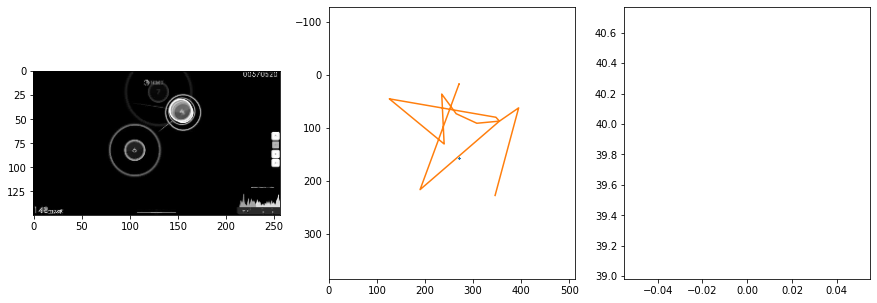


 1 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.38it/s  54.6511                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 31.7974                                   
pred: 0.47333407402038574 0.5467010140419006
gt: 0.6816211938858032 0.33337652683258057
(153, 56)


<Figure size 1080x360 with 0 Axes>

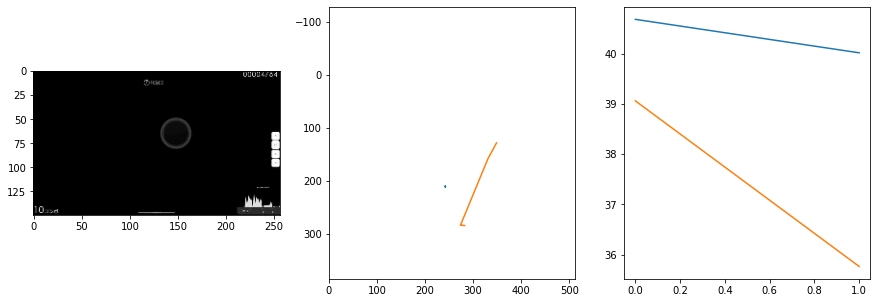


 2 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.44it/s  38.0240                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 40.9799                                   
pred: 0.5050809383392334 0.4839150905609131
gt: 0.5190408229827881 0.2229466587305069
(128, 43)


<Figure size 1080x360 with 0 Axes>

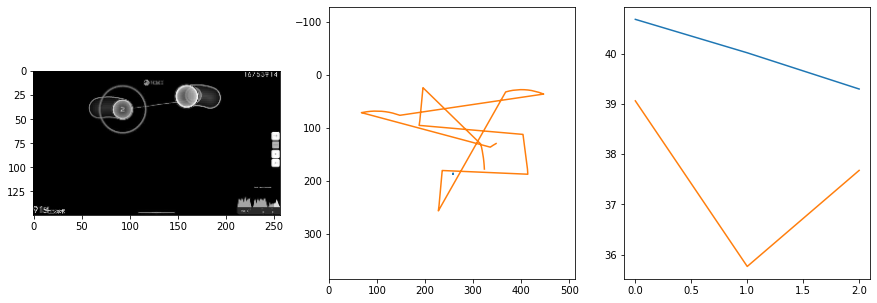


 3 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.37it/s  66.6185                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 23.4817                                   
pred: 0.28436729311943054 0.663573682308197
gt: 0.318359375 0.6302083134651184
(97, 91)


<Figure size 1080x360 with 0 Axes>

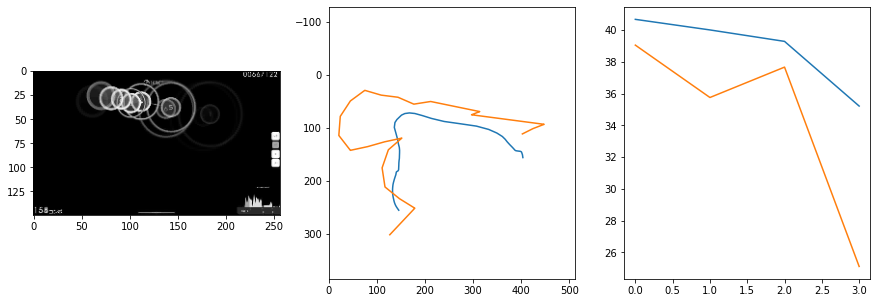


 4 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.35it/s  14.8763                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 17.0216                                   
pred: 0.20025037229061127 0.6627725958824158
gt: 0.30146917700767517 0.7020931839942932
(94, 99)


<Figure size 1080x360 with 0 Axes>

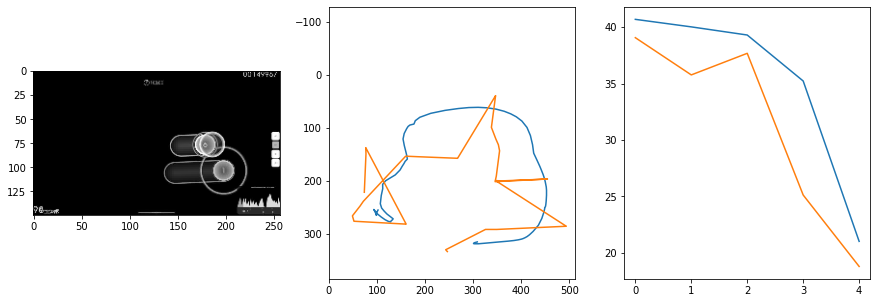


 5 of 6


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.55it/s  43.7466                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


val: 49/50 loss: 25.4116                                   
pred: 0.4817311465740204 0.5164504051208496
gt: 0.34327399730682373 0.6748245358467102
(101, 96)


<Figure size 1080x360 with 0 Axes>

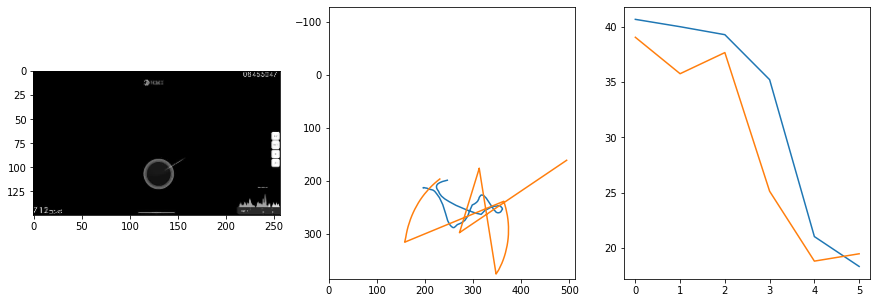


 6 of 6
199.9053316116333 secs


In [19]:
start = time.time()

epochs = 6
trainVN()

end = time.time()
print(end - start, 'secs')

In [20]:
train_hist = []
val_hist = []

1 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.49it/s  17.1667                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 17.282416735376632
outliers: 196
retrain: 8                 
val: 50/50 loss: 17.1885                                   
pred: 0.775139570236206 0.8730351328849792
gt: 0.4856691360473633 0.7086296081542969
(123, 100)


<Figure size 1080x360 with 0 Axes>

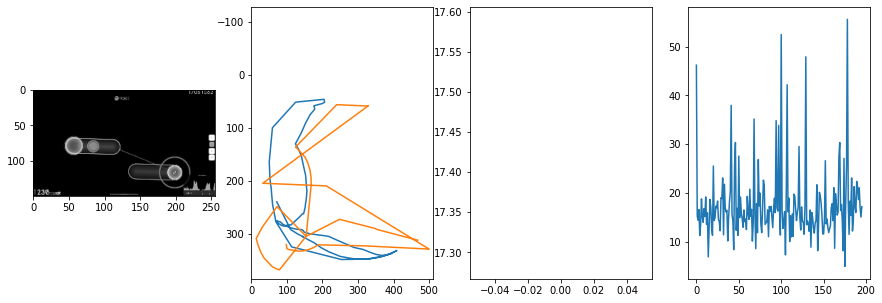


 7 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.65it/s  18.5104                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 16.87052739882956
outliers: 56
retrain: 8                 
val: 50/50 loss: 33.4697                                   
pred: 0.8871073722839355 0.25609859824180603
gt: 0.7131094932556152 0.40554091334342957
(158, 65)


<Figure size 1080x360 with 0 Axes>

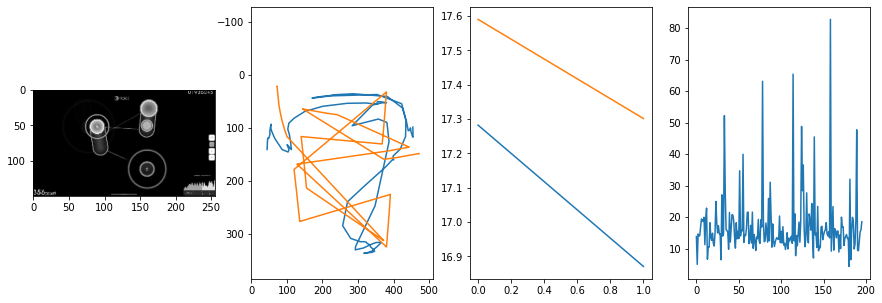


 8 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:28<00:00:00  6.95it/s  16.8010                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 15.69728391024531
outliers: 51
retrain: 8                 
val: 50/50 loss: 16.6493                                   
pred: 0.7412258386611938 0.5681572556495667
gt: 0.799820065498352 0.505302906036377
(172, 76)


<Figure size 1080x360 with 0 Axes>

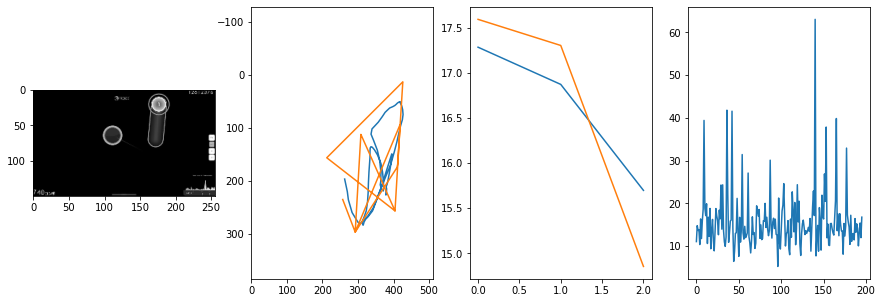


 9 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.16it/s  11.0609                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 15.899506418072448
outliers: 64
retrain: 8                 
val: 50/50 loss: 15.2950                                   
pred: 0.31206998229026794 0.33716222643852234
gt: 0.3125 0.3125
(96, 54)


<Figure size 1080x360 with 0 Axes>

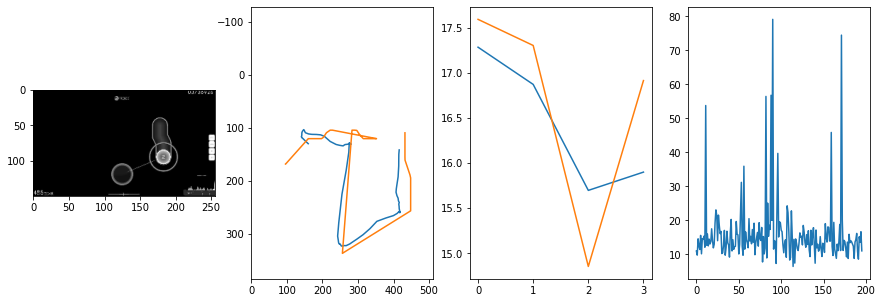


 10 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.12it/s  13.1394                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.90611154205945
outliers: 65
retrain: 8                 
val: 50/50 loss: 12.7198                                   
pred: 0.3520626723766327 0.43020471930503845
gt: 0.3125 0.4583333432674408
(96, 71)


<Figure size 1080x360 with 0 Axes>

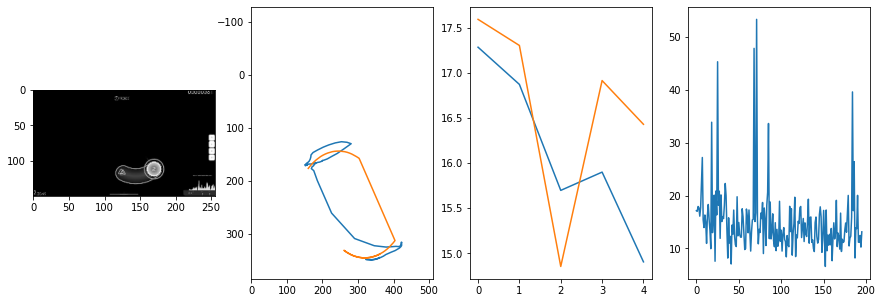


 11 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.42it/s  9.4518                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.803973995909399
outliers: 60
retrain: 8                 
val: 50/50 loss: 15.4692                                   
pred: 0.3300116956233978 0.10585791617631912
gt: 0.4254206418991089 0.2619325816631317
(113, 48)


<Figure size 1080x360 with 0 Axes>

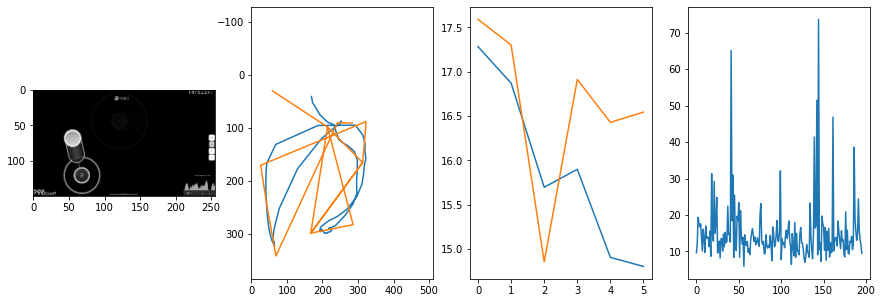


 12 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.20it/s  9.1469                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 15.15144310192186
outliers: 55
retrain: 8                 
val: 50/50 loss: 13.5847                                   
pred: 0.4701046347618103 0.16049374639987946
gt: 0.6090329885482788 0.1473766565322876
(142, 35)


<Figure size 1080x360 with 0 Axes>

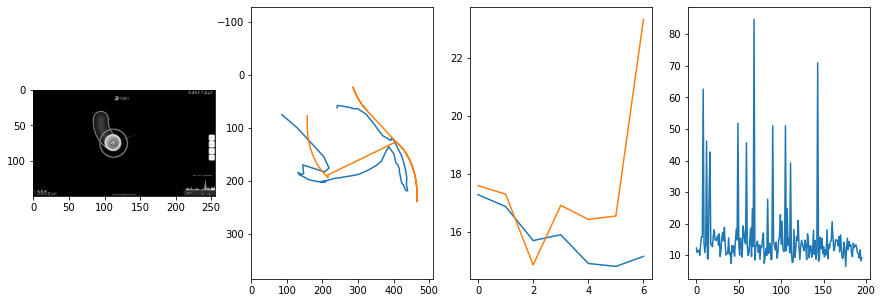


 13 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.61it/s  11.1844                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 15.930117728758832
outliers: 74
retrain: 8                 
val: 50/50 loss: 14.9470                                   
pred: 0.41970592737197876 0.7002918124198914
gt: 0.30468758940696716 0.7083340287208557
(95, 100)


<Figure size 1080x360 with 0 Axes>

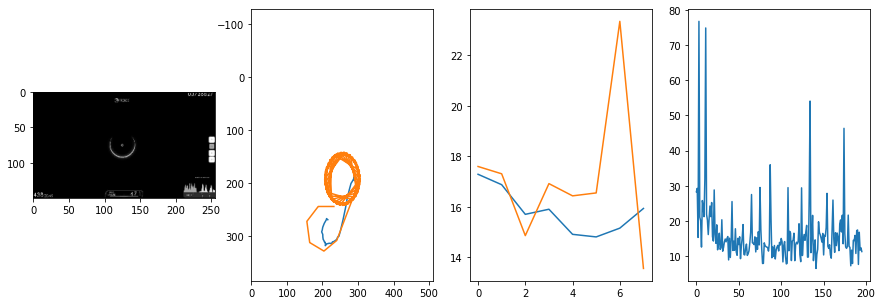


 14 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.53it/s  15.1592                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.505245252531402
outliers: 30
retrain: 8                 
val: 50/50 loss: 16.7576                                   
pred: 0.6678104400634766 0.5432957410812378
gt: 0.75 0.3098958432674408
(164, 54)


<Figure size 1080x360 with 0 Axes>

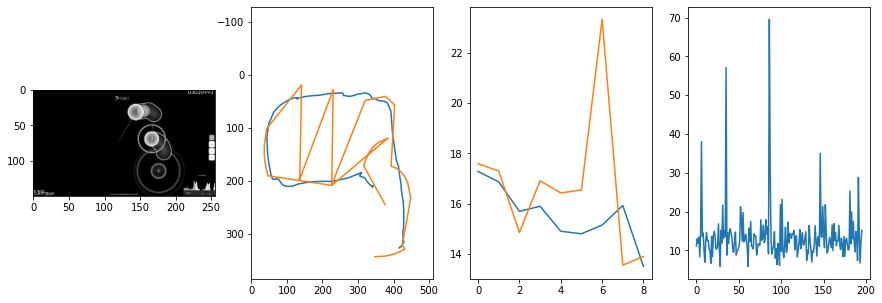


 15 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.35it/s  13.5180                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.747195297357987
outliers: 72
retrain: 8                 
val: 50/50 loss: 13.3982                                   
pred: 0.5592014789581299 0.1819562315940857
gt: 0.5078129768371582 0.11458142846822739
(126, 31)


<Figure size 1080x360 with 0 Axes>

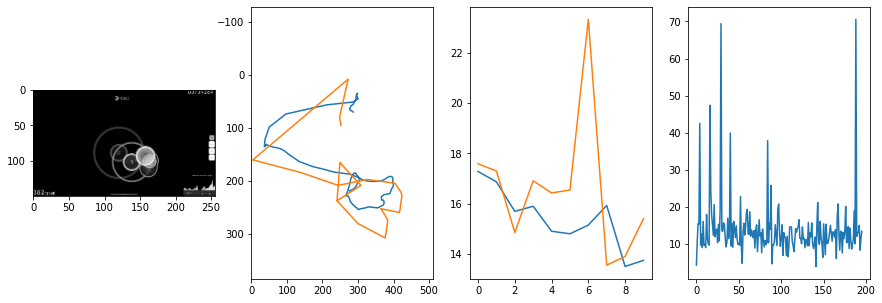


 16 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.38it/s  9.2369                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.965352131395925
outliers: 63
retrain: 8                 
val: 50/50 loss: 16.3901                                   
pred: 0.6054099798202515 0.16556882858276367
gt: 0.2901168465614319 0.2395208477973938
(92, 45)


<Figure size 1080x360 with 0 Axes>

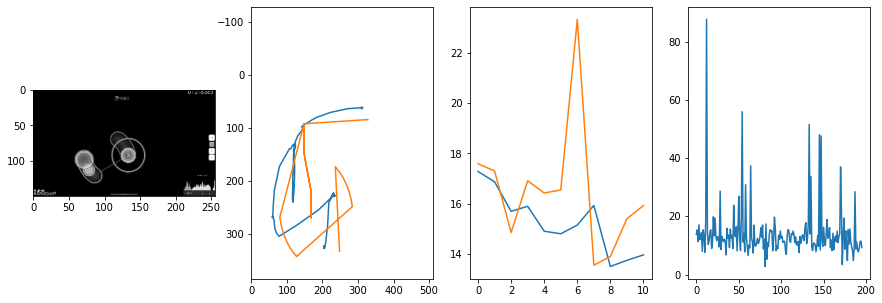


 17 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.35it/s  16.6199                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 15.953403410862903
outliers: 71
retrain: 8                 
val: 50/50 loss: 26.2739                                   
pred: 0.08810552209615707 0.6382487416267395
gt: 0.39453253149986267 0.138021782040596
(109, 34)


<Figure size 1080x360 with 0 Axes>

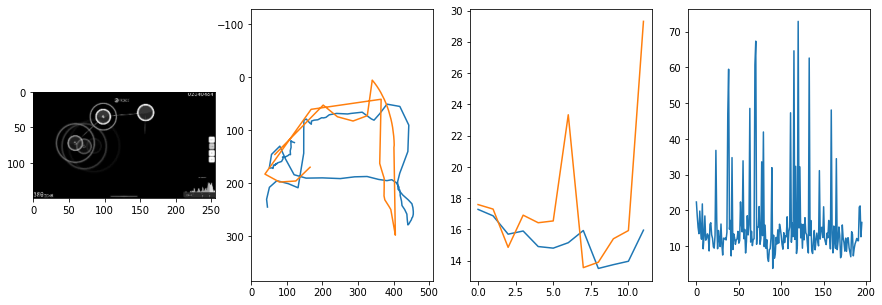


 18 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.28it/s  13.1634                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 15.698411939095477
outliers: 52
retrain: 8                 
val: 50/50 loss: 13.1530                                   
pred: 0.5114036798477173 0.41856226325035095
gt: 0.5 0.5
(125, 76)


<Figure size 1080x360 with 0 Axes>

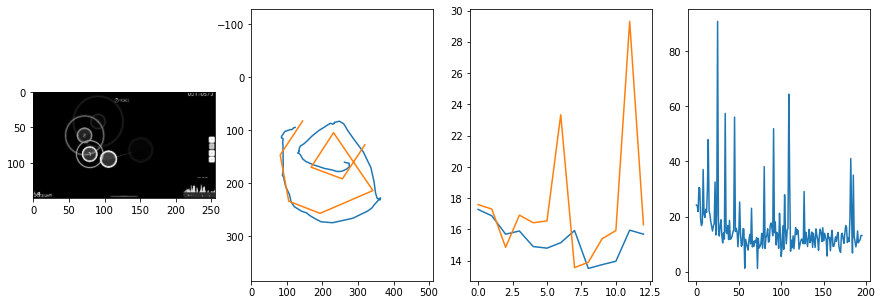


 19 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.22it/s  17.2274                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.726856012733615
outliers: 41
retrain: 8                 
val: 50/50 loss: 10.9705                                   
pred: 0.42652183771133423 0.8072695732116699
gt: 0.45381253957748413 0.7509167194366455
(118, 105)


<Figure size 1080x360 with 0 Axes>

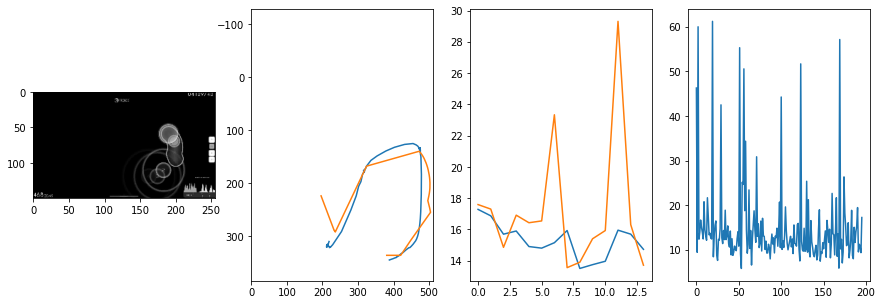


 20 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.54it/s  14.7723                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.103034107052551
outliers: 48
retrain: 8                 
val: 50/50 loss: 11.4072                                   
pred: 0.5623813271522522 0.7132588028907776
gt: 0.61328125 0.640625
(143, 92)


<Figure size 1080x360 with 0 Axes>

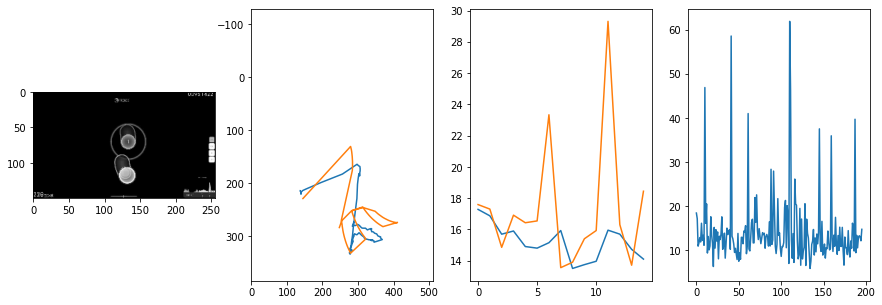


 21 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.55it/s  9.1584                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.393306330758698
outliers: 58
retrain: 8                 
val: 50/50 loss: 15.6051                                   
pred: 0.5196112394332886 0.5481597185134888
gt: 0.5842414498329163 0.514721691608429
(138, 77)


<Figure size 1080x360 with 0 Axes>

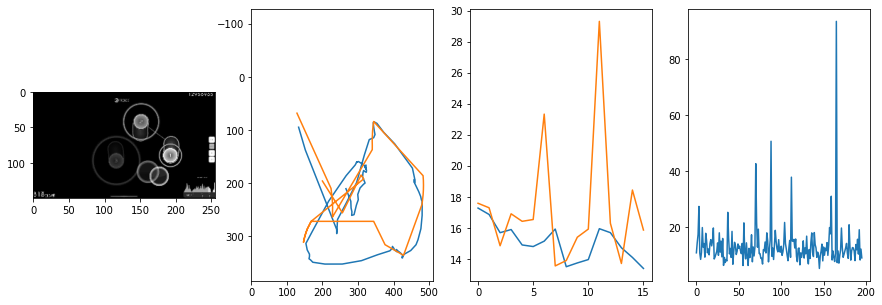


 22 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.34it/s  9.8868                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.50205410499962
outliers: 72
retrain: 8                 
val: 50/50 loss: 26.0270                                   
pred: 0.3001461923122406 0.4710013270378113
gt: 0.49997562170028687 0.5000108480453491
(125, 76)


<Figure size 1080x360 with 0 Axes>

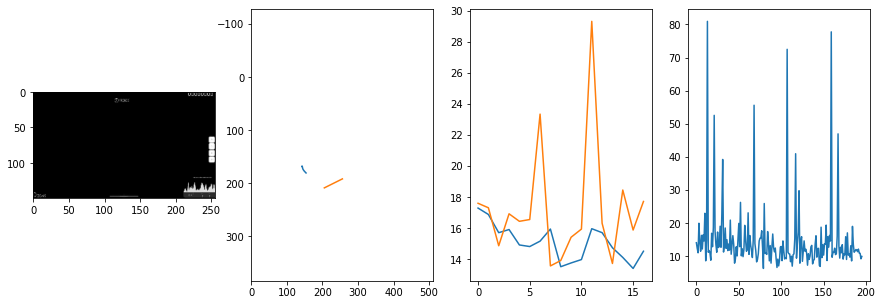


 23 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.11it/s  11.9490                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.167693240301949
outliers: 44
retrain: 8                 
val: 50/50 loss: 20.6762                                   
pred: 0.48752111196517944 0.5245118737220764
gt: 0.42404788732528687 0.48038020730018616
(113, 73)


<Figure size 1080x360 with 0 Axes>

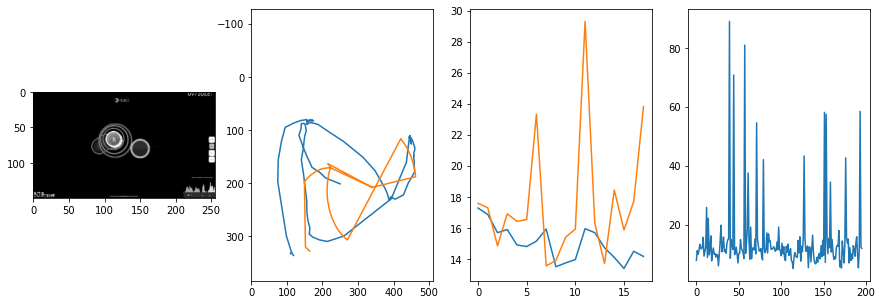


 24 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.30it/s  8.6483                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.59517534168399
outliers: 55
retrain: 8                 
val: 50/50 loss: 13.8004                                   
pred: 0.47813332080841064 0.6390321254730225
gt: 0.5151090621948242 0.39568576216697693
(127, 64)


<Figure size 1080x360 with 0 Axes>

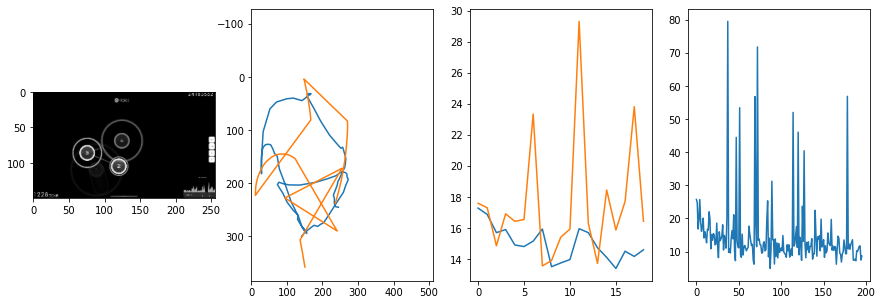


 25 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.27it/s  9.7810                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.114077866077423
outliers: 37
retrain: 8                 
val: 50/50 loss: 11.3871                                   
pred: 0.8452277183532715 0.6720924973487854
gt: 0.841834306716919 0.6912031173706055
(178, 98)


<Figure size 1080x360 with 0 Axes>

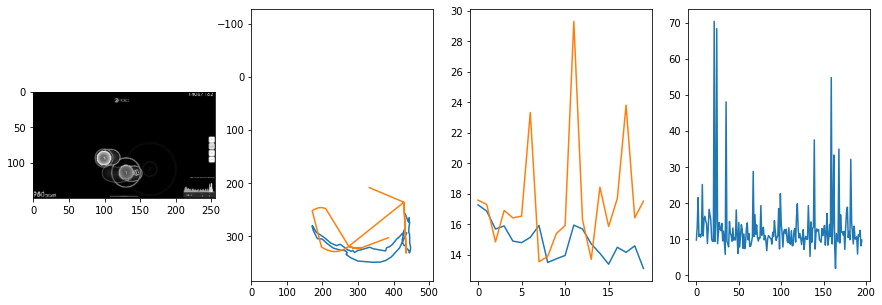


 26 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.27it/s  36.8829                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.880894266829198
outliers: 58
retrain: 8                 
val: 50/50 loss: 12.1146                                   
pred: 0.4711013734340668 0.5148711204528809
gt: 0.3125014305114746 0.5
(96, 76)


<Figure size 1080x360 with 0 Axes>

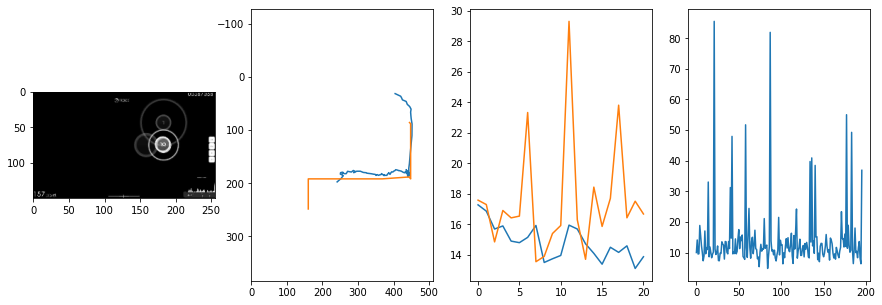


 27 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.22it/s  45.9939                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.062859082708554
outliers: 42
retrain: 8                 
val: 50/50 loss: 12.6628                                   
pred: 0.6137441396713257 0.3633960783481598
gt: 0.5630814433097839 0.3236081004142761
(135, 55)


<Figure size 1080x360 with 0 Axes>

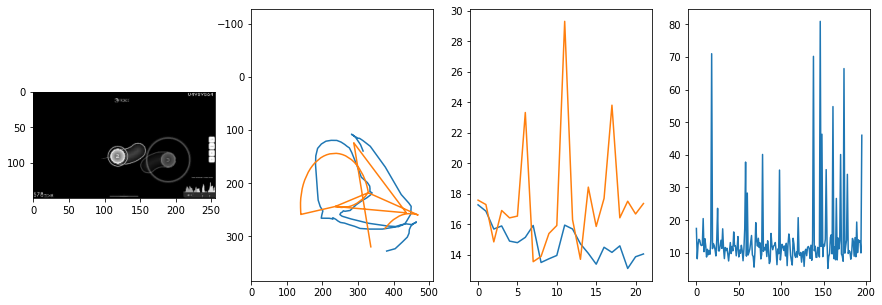


 28 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.25it/s  11.3719                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.329120263761403
outliers: 42
retrain: 8                 
val: 50/50 loss: 12.0699                                   
pred: 0.21682538092136383 0.27375343441963196
gt: 0.234375 0.1666666716337204
(84, 37)


<Figure size 1080x360 with 0 Axes>

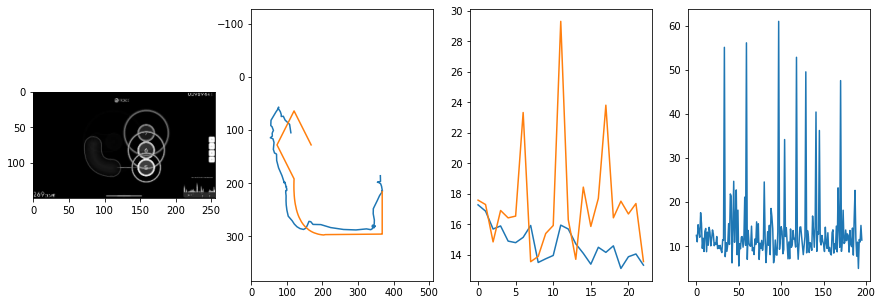


 29 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.27it/s  14.0355                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.429518668019043
outliers: 55
retrain: 8                 
val: 50/50 loss: 9.3330                                    
pred: 0.7004899382591248 0.33952340483665466
gt: 0.796821653842926 0.36972784996032715
(171, 61)


<Figure size 1080x360 with 0 Axes>

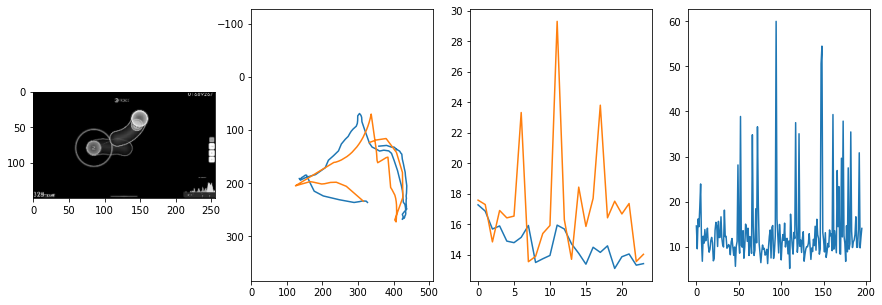


 30 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.39it/s  10.7529                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.117367126503769
outliers: 49
retrain: 8                 
val: 50/50 loss: 15.2107                                   
pred: 0.7121096849441528 0.5230773091316223
gt: 0.5231528282165527 0.481791615486145
(129, 74)


<Figure size 1080x360 with 0 Axes>

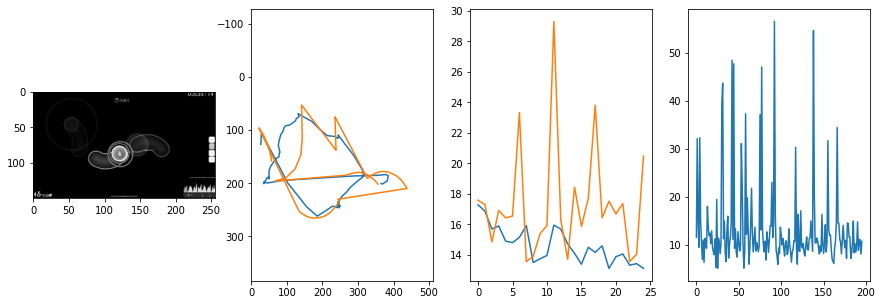


 31 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.36it/s  16.8005                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.174282071541766
outliers: 59
retrain: 8                 
val: 50/50 loss: 19.5934                                   
pred: 0.47236302495002747 0.39128538966178894
gt: 0.591796875 0.6406249403953552
(139, 92)


<Figure size 1080x360 with 0 Axes>

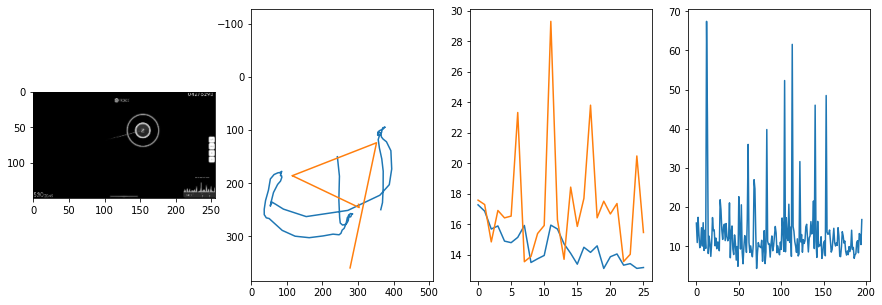


 32 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.27it/s  7.0767                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 13.05742331670255
outliers: 49
retrain: 8                 
val: 50/50 loss: 11.2189                                   
pred: 0.5248743891716003 0.25577855110168457
gt: 0.3262563645839691 0.48667189478874207
(98, 74)


<Figure size 1080x360 with 0 Axes>

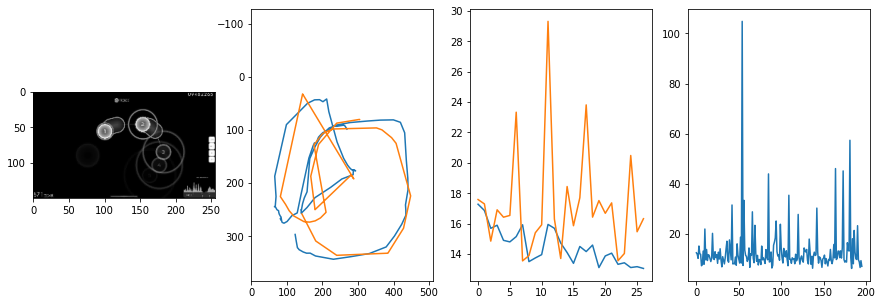


 33 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.35it/s  11.9313                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.054656469092077
outliers: 51
retrain: 8                 
val: 50/50 loss: 24.0138                                   
pred: 0.3121846616268158 0.37894561886787415
gt: 0.2939192056655884 0.3416741192340851
(93, 57)


<Figure size 1080x360 with 0 Axes>

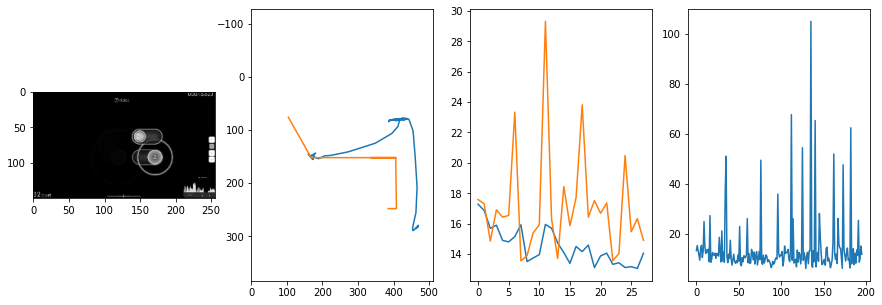


 34 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.52it/s  56.7694                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 14.034765197306264
outliers: 43
retrain: 8                 
val: 50/50 loss: 10.9545                                   
pred: 0.5166434049606323 0.5843412280082703
gt: 0.5204336643218994 0.5877619981765747
(128, 86)


<Figure size 1080x360 with 0 Axes>

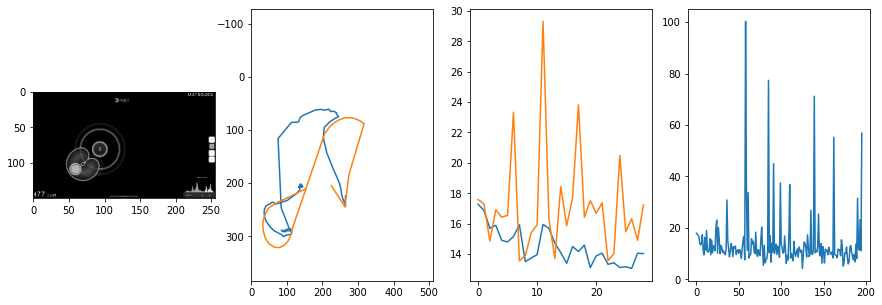


 35 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.47it/s  7.5940                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 12.433986693012471
outliers: 38
retrain: 8                 
val: 50/50 loss: 11.0543                                   
pred: 0.5253150463104248 0.3056057095527649
gt: 0.4955444931983948 0.5006731748580933
(124, 76)


<Figure size 1080x360 with 0 Axes>

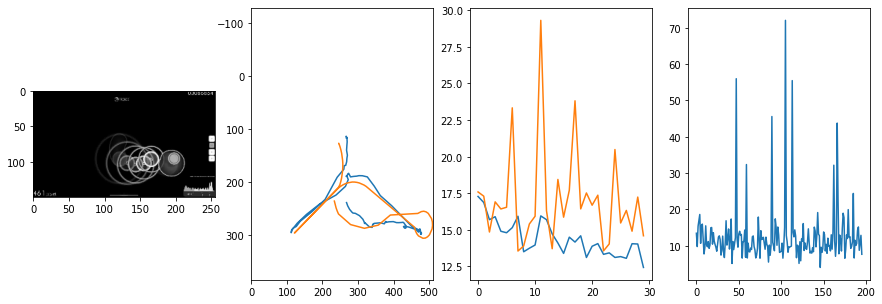


 36 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.17it/s  9.2277                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.537041634929423
outliers: 47
retrain: 8                 
val: 50/50 loss: 24.9478                                   
pred: 0.3116588592529297 0.4965873658657074
gt: 0.41477030515670776 0.43640658259391785
(112, 68)


<Figure size 1080x360 with 0 Axes>

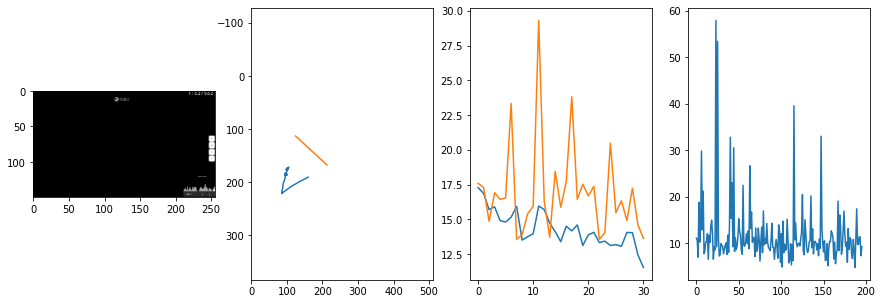


 37 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.24it/s  10.7503                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.9499690970596
outliers: 57
retrain: 8                 
val: 50/50 loss: 10.8141                                   
pred: 0.40716856718063354 0.22964242100715637
gt: 0.24700692296028137 0.10841818898916245
(86, 30)


<Figure size 1080x360 with 0 Axes>

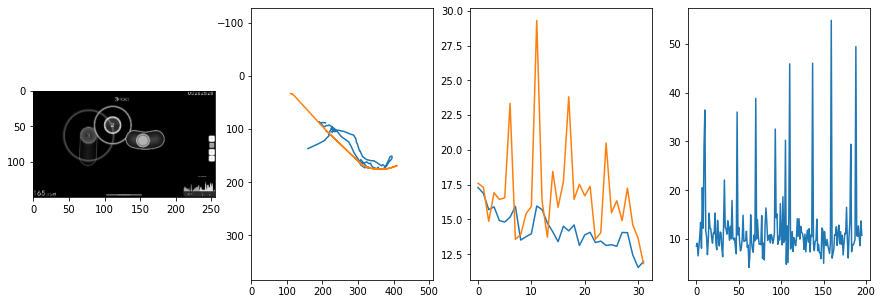


 38 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.48it/s  50.8482                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 12.351901015456843
outliers: 49
retrain: 8                 
val: 50/50 loss: 19.5899                                   
pred: 0.763161838054657 0.6576144695281982
gt: 0.19531257450580597 0.5416666269302368
(78, 81)


<Figure size 1080x360 with 0 Axes>

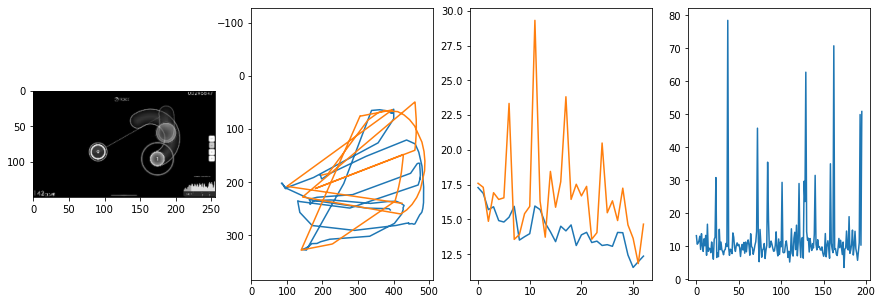


 39 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.29it/s  8.1199                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.238042172120542
outliers: 46
retrain: 8                 
val: 50/50 loss: 11.1871                                   
pred: 0.6441080570220947 0.4528394937515259
gt: 0.6534690260887146 0.4468128979206085
(149, 69)


<Figure size 1080x360 with 0 Axes>

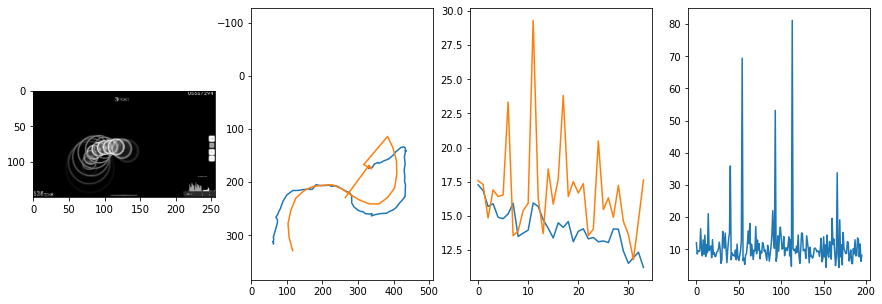


 40 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:28<00:00:00  6.94it/s  14.6704                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.788025447300502
outliers: 70
retrain: 8                 
val: 50/50 loss: 13.5006                                   
pred: 0.5099790692329407 0.5703540444374084
gt: 0.5517677664756775 0.6336340308189392
(133, 91)


<Figure size 1080x360 with 0 Axes>

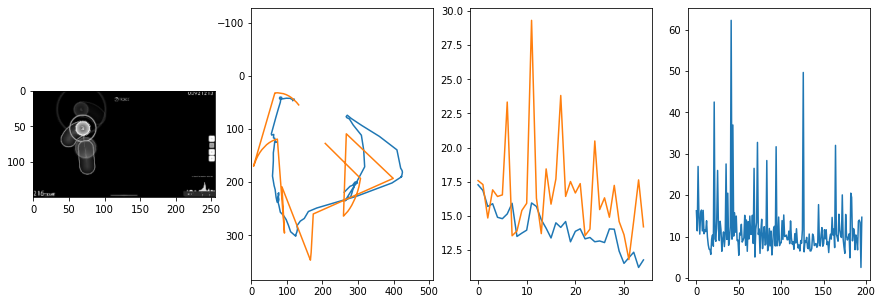


 41 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:28<00:00:00  6.96it/s  6.0295                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.080451915458758
outliers: 51
retrain: 8                 
val: 50/50 loss: 16.5862                                   
pred: 0.3764090836048126 0.20016451179981232
gt: 0.5234375 0.7708333134651184
(129, 107)


<Figure size 1080x360 with 0 Axes>

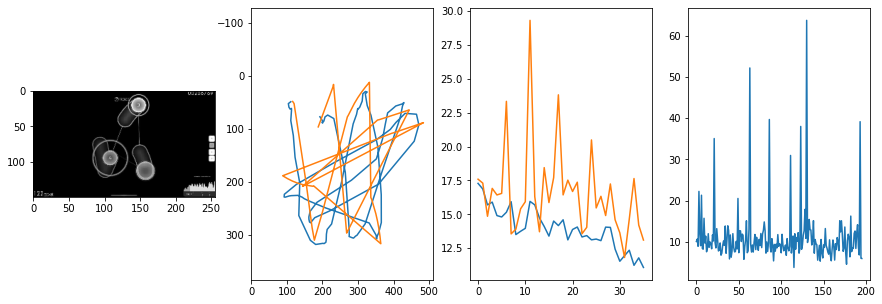


 42 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.16it/s  11.8334                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 12.420666826014616
outliers: 68
retrain: 8                 
val: 50/50 loss: 13.9680                                   
pred: 0.7873660922050476 0.9293596148490906
gt: 0.7988033890724182 0.5052062273025513
(171, 76)


<Figure size 1080x360 with 0 Axes>

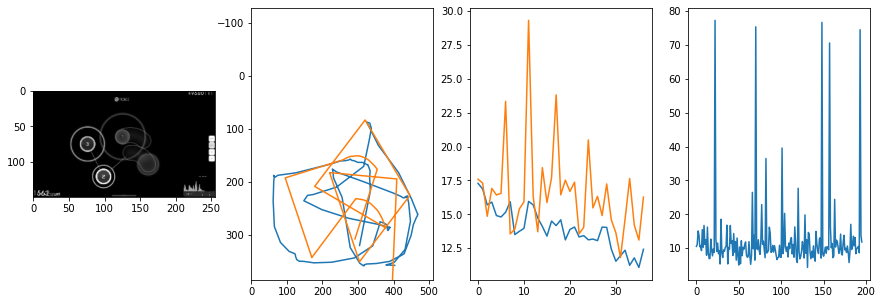


 43 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.23it/s  10.8620                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.566107102802821
outliers: 35
retrain: 8                 
val: 50/50 loss: 8.6656                                    
pred: 0.514324426651001 0.7234531044960022
gt: 0.623046875 0.3333333432674408
(144, 56)


<Figure size 1080x360 with 0 Axes>

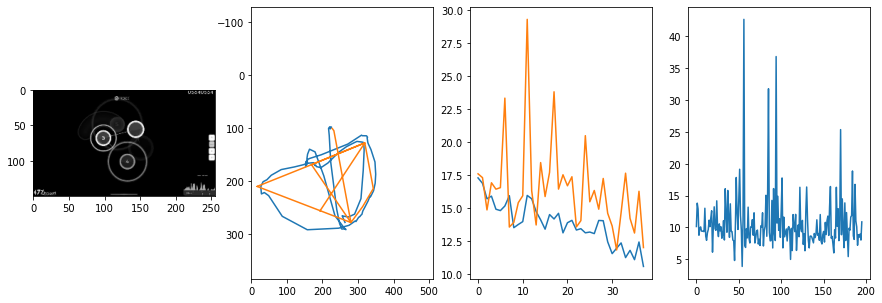


 44 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.20it/s  8.0231                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.82790233650986
outliers: 70
retrain: 8                 
val: 50/50 loss: 9.4362                                    
pred: 0.7963455319404602 0.3866947591304779
gt: 0.7949219346046448 0.33854153752326965
(171, 57)


<Figure size 1080x360 with 0 Axes>

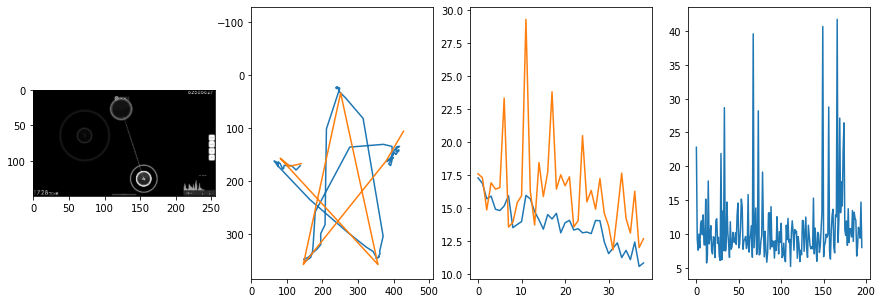


 45 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.46it/s  6.1758                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 12.629478026409538
outliers: 71
retrain: 8                 
val: 50/50 loss: 12.1969                                   
pred: 0.372480571269989 0.1652684509754181
gt: 0.3203125 0.1666666716337204
(97, 37)


<Figure size 1080x360 with 0 Axes>

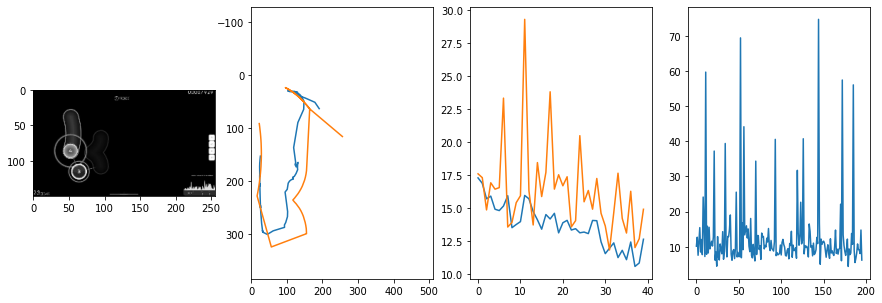


 46 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.42it/s  8.7656                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 12.22708288747437
outliers: 45
retrain: 8                 
val: 50/50 loss: 15.4643                                   
pred: 0.48976826667785645 0.31927549839019775
gt: 0.48363059759140015 0.17758971452713013
(123, 38)


<Figure size 1080x360 with 0 Axes>

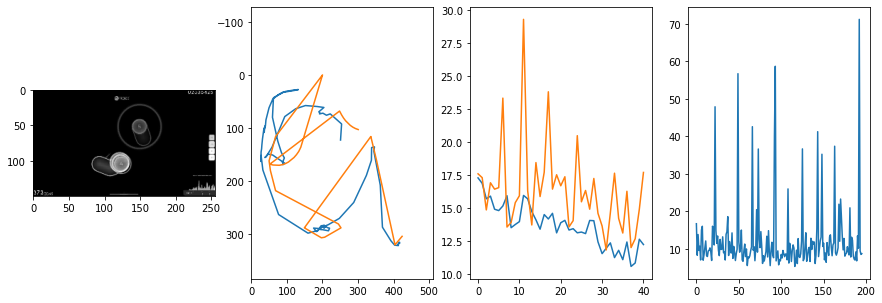


 47 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.36it/s  9.3223                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.828431010246277
outliers: 41
retrain: 8                 
val: 50/50 loss: 16.1889                                   
pred: 0.4392019510269165 0.6664655804634094
gt: 0.5132431983947754 0.371416836977005
(127, 61)


<Figure size 1080x360 with 0 Axes>

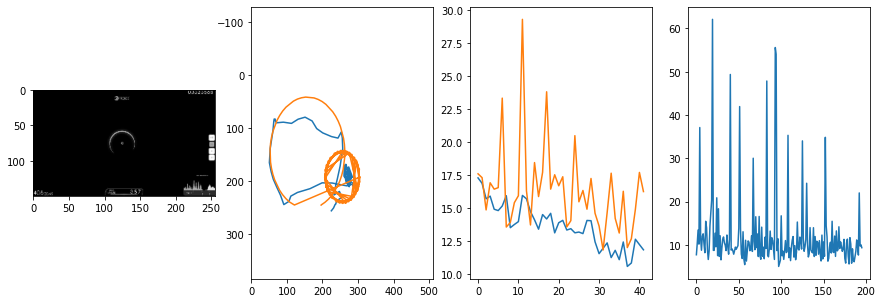


 48 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.57it/s  8.4153                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.622530642212654
outliers: 53
retrain: 8                 
val: 50/50 loss: 8.1229                                    
pred: 0.5402947664260864 0.8553933501243591
gt: 0.7900258302688599 0.8743038177490234
(170, 119)


<Figure size 1080x360 with 0 Axes>

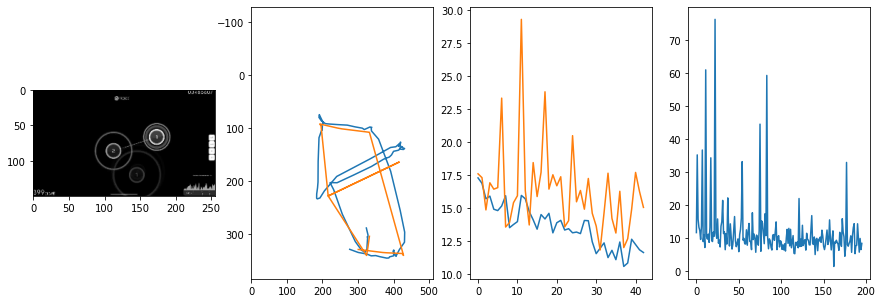


 49 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.60it/s  6.9821                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.703087035490542
outliers: 44
retrain: 8                 
val: 50/50 loss: 13.1297                                   
pred: 0.5755628943443298 0.6678451895713806
gt: 0.78125 0.4166666567325592
(169, 66)


<Figure size 1080x360 with 0 Axes>

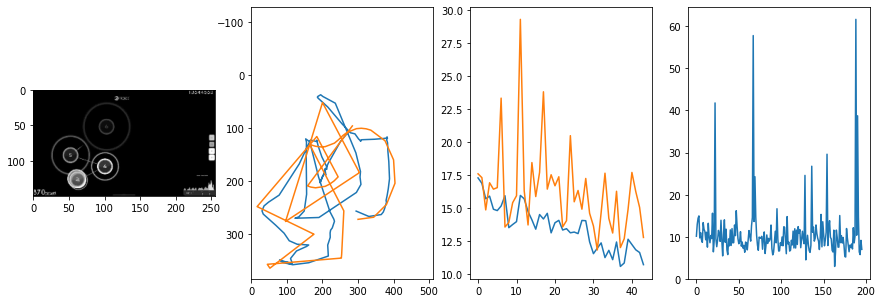


 50 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.57it/s  5.9691                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.50661956777378
outliers: 60
retrain: 8                 
val: 50/50 loss: 10.1017                                   
pred: 0.23681358993053436 0.852983832359314
gt: 0.390625 0.8541666865348816
(108, 117)


<Figure size 1080x360 with 0 Axes>

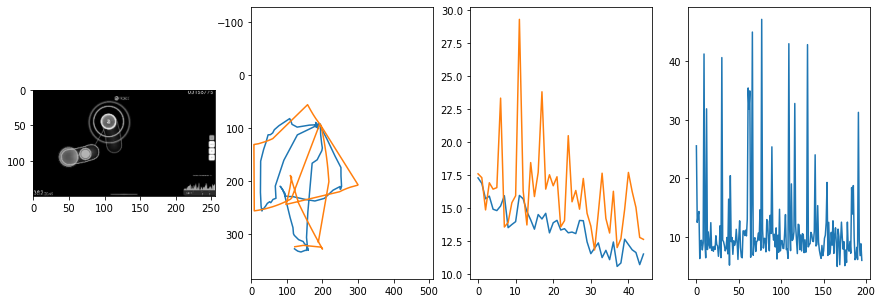


 51 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.53it/s  13.6656                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.6701536300231
outliers: 57
retrain: 8                 
val: 50/50 loss: 11.0975                                   
pred: 0.3889521062374115 0.3322436511516571
gt: 0.18048368394374847 0.6150198578834534
(75, 89)


<Figure size 1080x360 with 0 Axes>

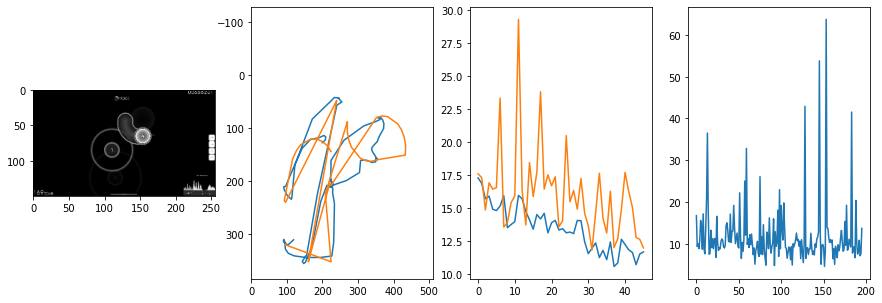


 52 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.37it/s  9.1956                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.989328858803729
outliers: 36
retrain: 8                 
val: 50/50 loss: 11.5296                                   
pred: 0.7162879109382629 0.32696717977523804
gt: 0.7252523303031921 0.4991428852081299
(160, 76)


<Figure size 1080x360 with 0 Axes>

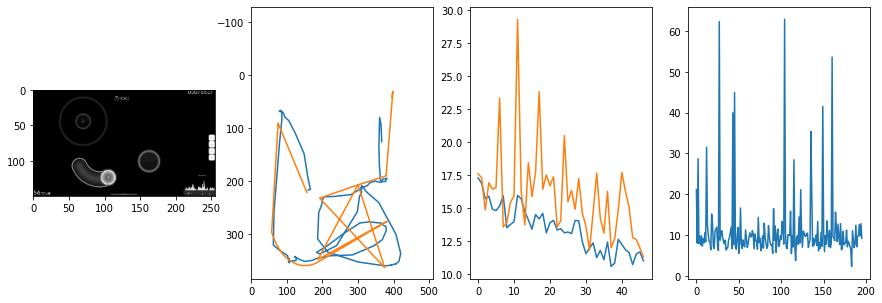


 53 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.45it/s  9.3980                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.76205099723777
outliers: 49
retrain: 8                 
val: 50/50 loss: 8.0462                                    
pred: 0.5762733817100525 0.07210736721754074
gt: 0.599609375 0.041666653007268906
(140, 22)


<Figure size 1080x360 with 0 Axes>

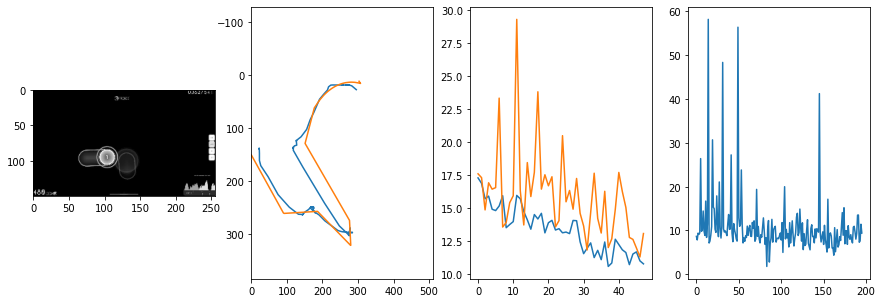


 54 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.61it/s  8.7421                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.267626409627953
outliers: 58
retrain: 8                 
val: 50/50 loss: 19.0062                                   
pred: 0.44440045952796936 0.3414309620857239
gt: 0.5625 0.1979166716337204
(135, 41)


<Figure size 1080x360 with 0 Axes>

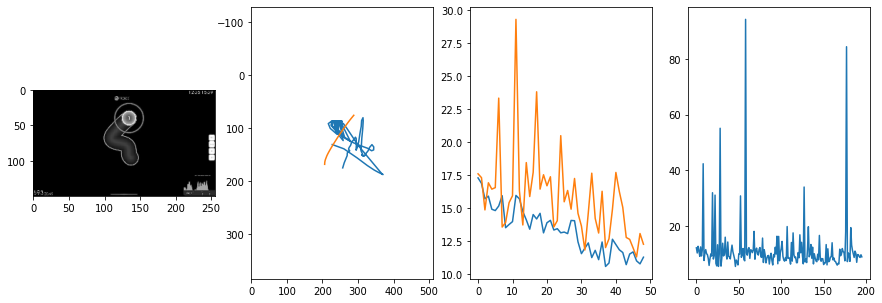


 55 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.47it/s  7.8439                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 12.082093007710515
outliers: 52
retrain: 8                 
val: 50/50 loss: 11.0881                                   
pred: 0.35543563961982727 0.7581865787506104
gt: 0.4935549795627594 0.7310356497764587
(124, 103)


<Figure size 1080x360 with 0 Axes>

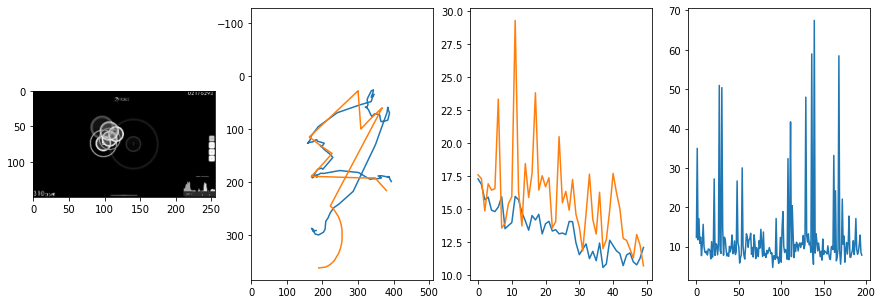


 56 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.47it/s  9.6811                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.1248691325285
outliers: 27
retrain: 8                 
val: 50/50 loss: 10.5383                                   
pred: 0.5923773050308228 0.8316136002540588
gt: 0.7126998901367188 0.7941603660583496
(158, 110)


<Figure size 1080x360 with 0 Axes>

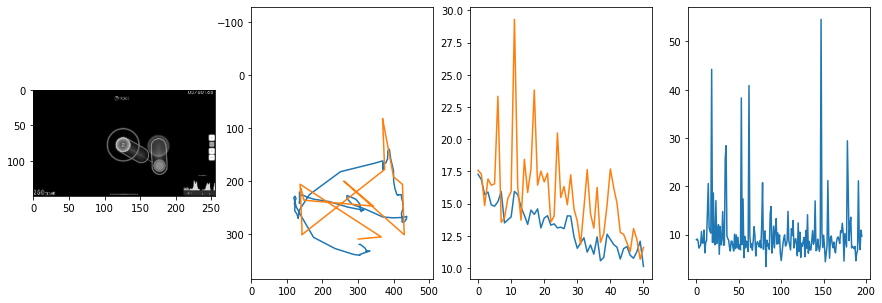


 57 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.48it/s  47.7993                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.916414652551923
outliers: 68
retrain: 8                 
val: 50/50 loss: 9.9093                                    
pred: 0.1941220611333847 0.33215367794036865
gt: 0.060860101133584976 0.41208842396736145
(57, 65)


<Figure size 1080x360 with 0 Axes>

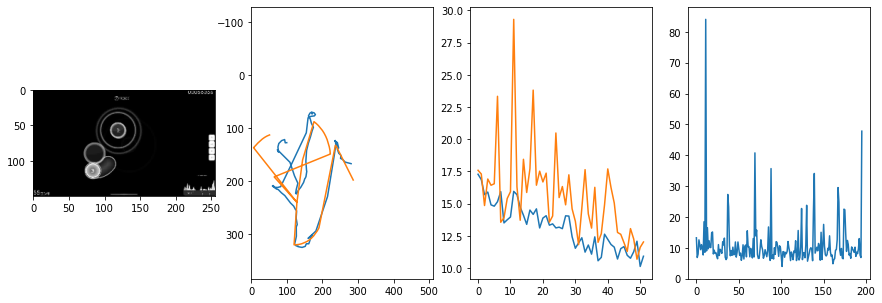


 58 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:27<00:00:00  7.19it/s  9.1954                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.00498935884359
outliers: 55
retrain: 8                 
val: 50/50 loss: 9.0700                                    
pred: 0.7267106771469116 0.35438334941864014
gt: 0.8908330798149109 0.3033006489276886
(186, 53)


<Figure size 1080x360 with 0 Axes>

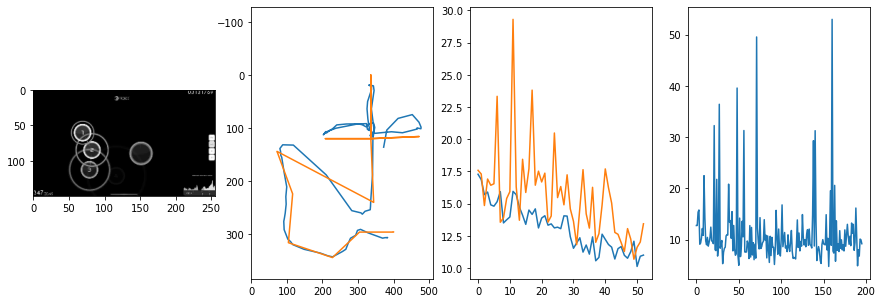


 59 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.63it/s  10.9193                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.09422393477693
outliers: 42
retrain: 8                 
val: 50/50 loss: 45.8451                                   
pred: 0.48514413833618164 0.4561120867729187
gt: 0.037218935787677765 0.5442603230476379
(53, 81)


<Figure size 1080x360 with 0 Axes>

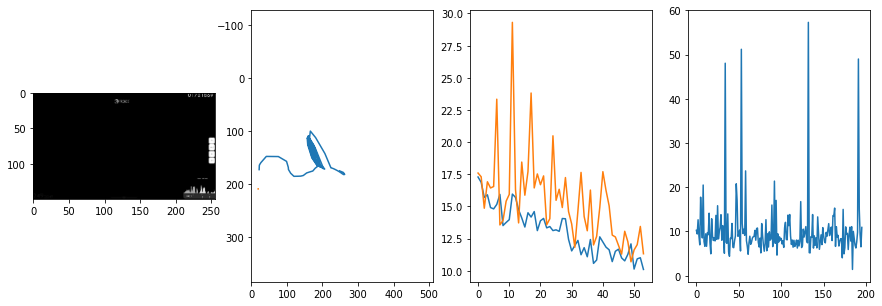


 60 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.49it/s  6.9904                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.642324004854474
outliers: 52
retrain: 8                 
val: 50/50 loss: 8.7961                                    
pred: 0.8309813737869263 0.7911363840103149
gt: 0.9023416042327881 0.8307294249534607
(187, 114)


<Figure size 1080x360 with 0 Axes>

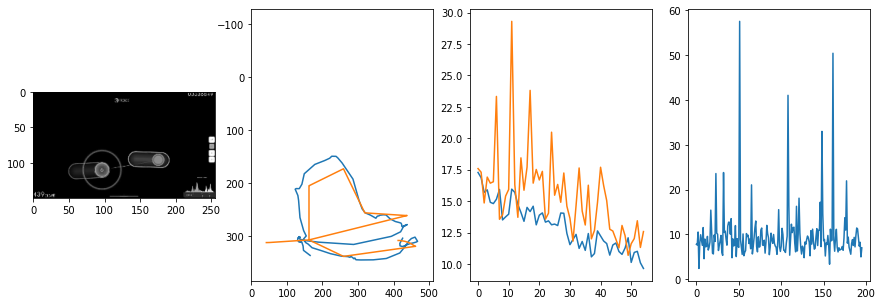


 61 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.27it/s  9.5990                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.580865366118294
outliers: 75
retrain: 8                 
val: 50/50 loss: 10.4627                                   
pred: 0.4519445598125458 0.45263850688934326
gt: 0.6053303480148315 0.39535775780677795
(141, 63)


<Figure size 1080x360 with 0 Axes>

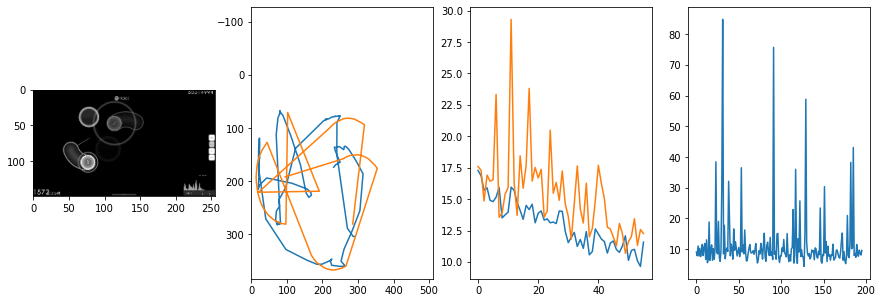


 62 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.37it/s  7.9345                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.45473406266193
outliers: 34
retrain: 8                 
val: 50/50 loss: 13.0938                                   
pred: 0.6393767595291138 0.1891019642353058
gt: 0.36718863248825073 0.6874942183494568
(104, 97)


<Figure size 1080x360 with 0 Axes>

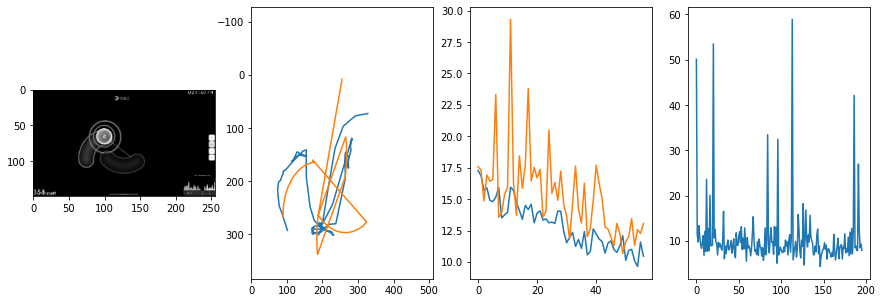


 63 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.40it/s  7.8491                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.52210497734498
outliers: 42
retrain: 8                 
val: 50/50 loss: 10.8184                                   
pred: 0.5331599712371826 0.17371976375579834
gt: 0.7207095623016357 0.401220440864563
(159, 64)


<Figure size 1080x360 with 0 Axes>

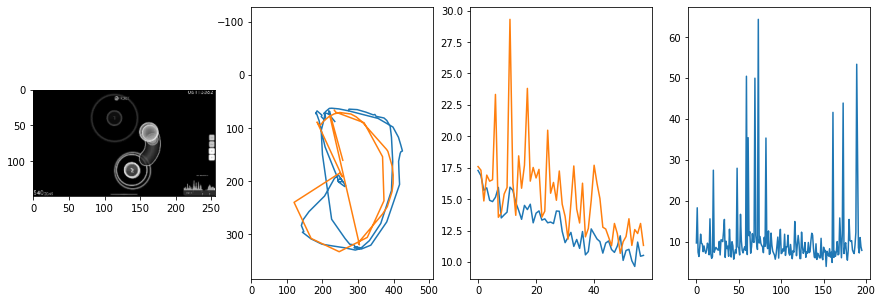


 64 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.44it/s  9.5172                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.530643677224917
outliers: 55
retrain: 8                 
val: 50/50 loss: 30.5047                                   
pred: 0.5081989169120789 0.4977247416973114
gt: 0.5005109310150146 0.20985937118530273
(125, 42)


<Figure size 1080x360 with 0 Axes>

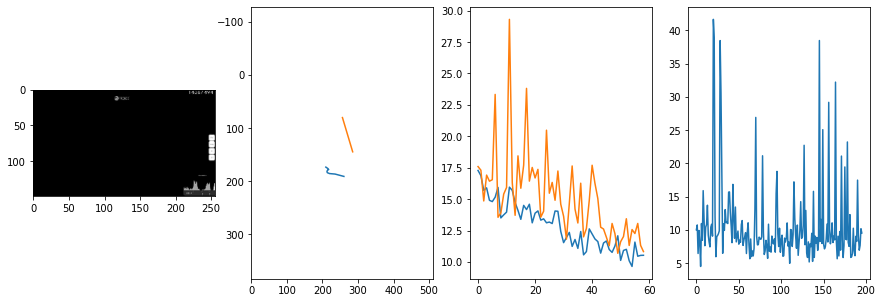


 65 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  6.7406                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.158362897074952
outliers: 46
retrain: 8                 
val: 50/50 loss: 11.2698                                   
pred: 0.03872464969754219 0.35741618275642395
gt: 0.27539053559303284 0.5520833134651184
(90, 82)


<Figure size 1080x360 with 0 Axes>

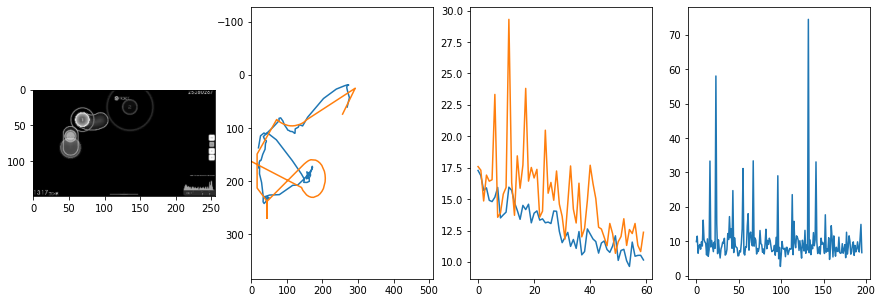


 66 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  8.7659                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.709026823238451
outliers: 44
retrain: 8                 
val: 50/50 loss: 8.8511                                    
pred: 0.25076761841773987 0.5481752753257751
gt: 0.544772207736969 0.34645846486091614
(132, 58)


<Figure size 1080x360 with 0 Axes>

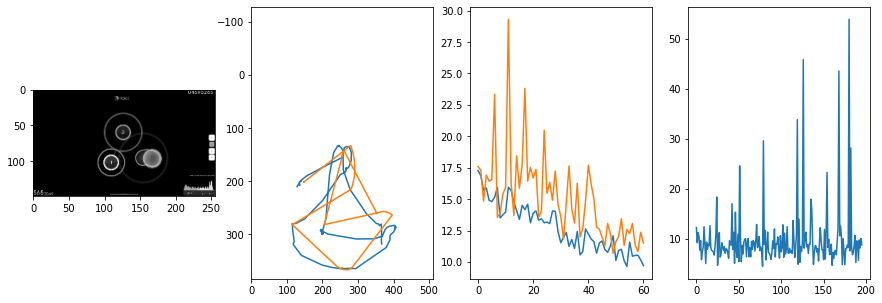


 67 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.68it/s  5.8060                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.299867381854932
outliers: 61
retrain: 8                 
val: 50/50 loss: 32.9845                                   
pred: 0.6279317736625671 0.14237335324287415
gt: 0.677734375 0.21176372468471527
(153, 42)


<Figure size 1080x360 with 0 Axes>

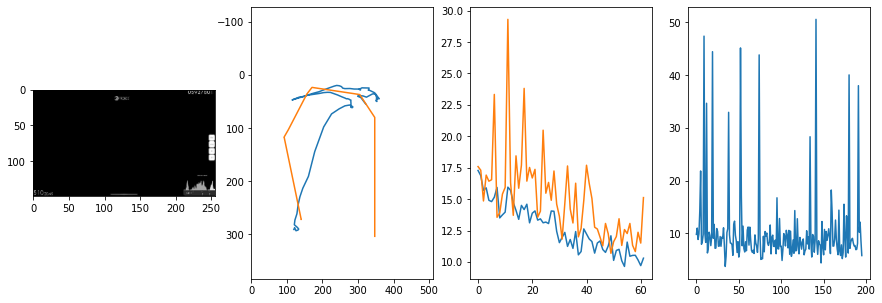


 68 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  9.7362                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.597830327189698
outliers: 62
retrain: 8                 
val: 50/50 loss: 12.2331                                   
pred: 0.8780012130737305 0.7071176767349243
gt: 0.7987273931503296 0.6241611838340759
(171, 90)


<Figure size 1080x360 with 0 Axes>

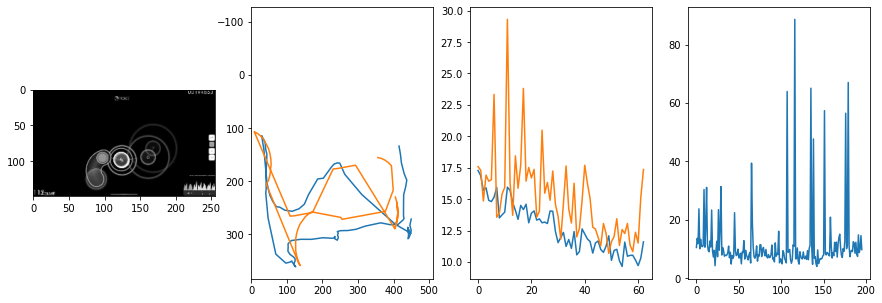


 69 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.74it/s  31.8765                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.891067191046112
outliers: 40
retrain: 8                 
val: 50/50 loss: 10.3880                                   
pred: 0.3134233355522156 0.7633857727050781
gt: 0.21162569522857666 0.7326870560646057
(80, 103)


<Figure size 1080x360 with 0 Axes>

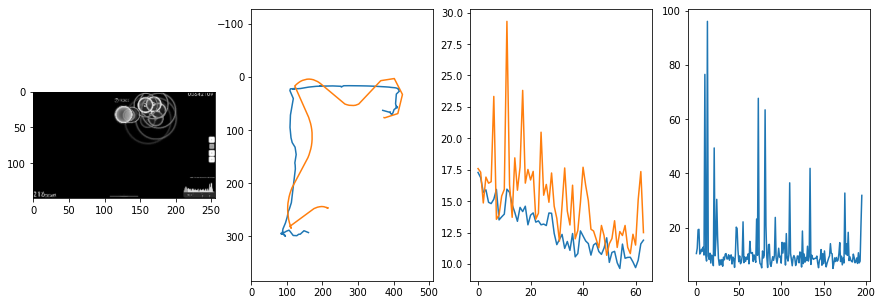


 70 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  8.6801                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.264529544479993
outliers: 33
retrain: 8                 
val: 50/50 loss: 9.9960                                    
pred: 0.5748319625854492 0.9486134648323059
gt: 0.7021517753601074 0.9938030242919922
(156, 133)


<Figure size 1080x360 with 0 Axes>

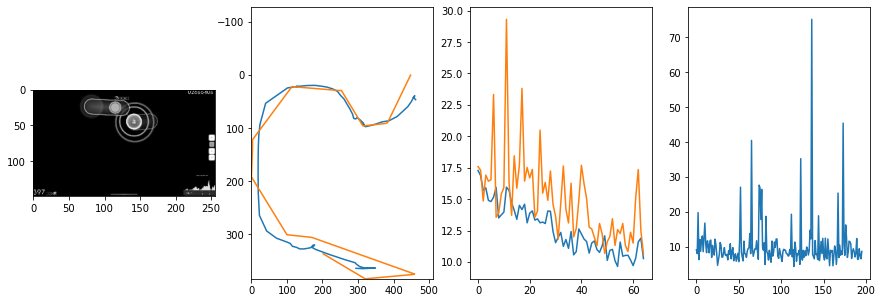


 71 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  8.7057                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.738350736851595
outliers: 54
retrain: 8                 
val: 50/50 loss: 6.3901                                    
pred: 0.7251940369606018 0.8010455965995789
gt: 0.7031296491622925 0.77864670753479
(157, 108)


<Figure size 1080x360 with 0 Axes>

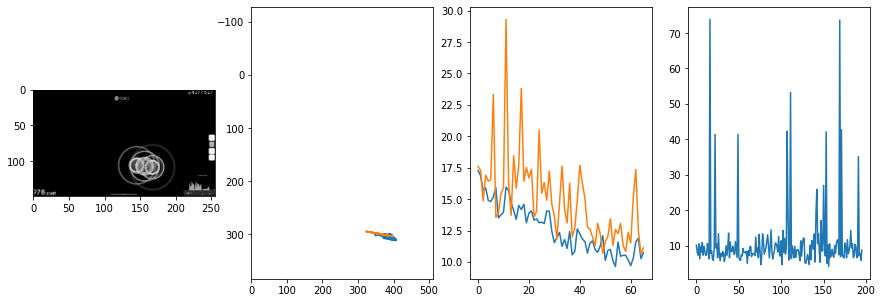


 72 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  6.8731                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.105621924205701
outliers: 39
retrain: 8                 
val: 50/50 loss: 12.8612                                   
pred: 0.4187765121459961 0.8504216074943542
gt: 0.6493328809738159 0.8936207890510559
(148, 121)


<Figure size 1080x360 with 0 Axes>

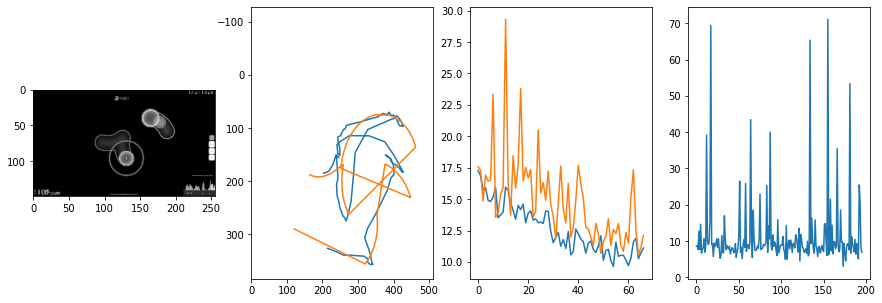


 73 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  7.4984                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 12.243696120320534
outliers: 54
retrain: 8                 
val: 50/50 loss: 9.7681                                    
pred: 0.8605150580406189 0.49959322810173035
gt: 0.8829677700996399 0.27438488602638245
(184, 49)


<Figure size 1080x360 with 0 Axes>

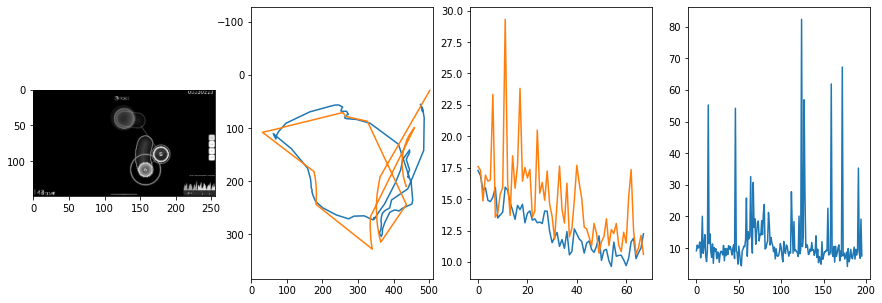


 74 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  5.4364                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.53285309976461
outliers: 35
retrain: 8                 
val: 50/50 loss: 15.9482                                   
pred: 0.4154817759990692 0.6590077877044678
gt: 0.5468887686729431 0.5676957964897156
(132, 84)


<Figure size 1080x360 with 0 Axes>

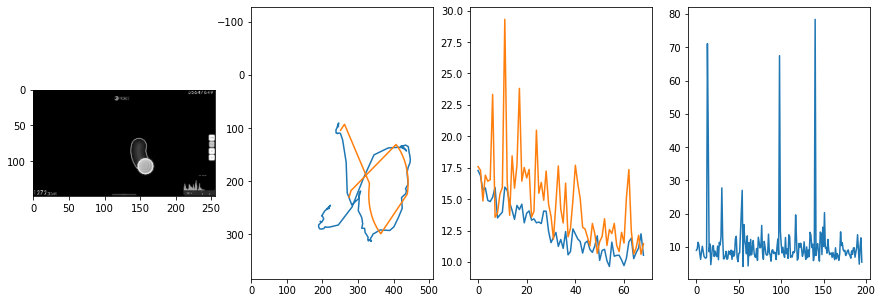


 75 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  12.6103                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.498431183853928
outliers: 44
retrain: 8                 
val: 50/50 loss: 12.2250                                   
pred: 0.3779609799385071 0.9103794097900391
gt: 0.20977485179901123 0.7966839671134949
(80, 110)


<Figure size 1080x360 with 0 Axes>

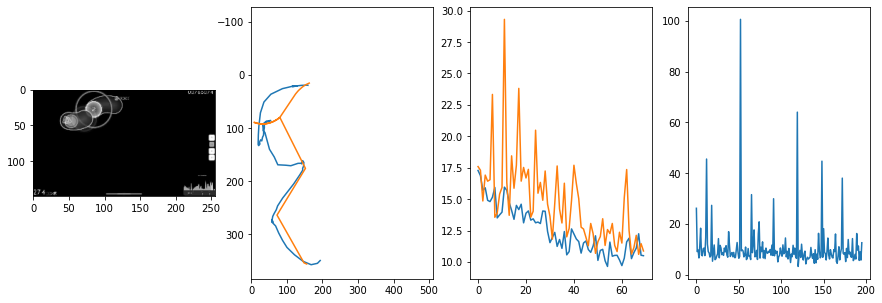


 76 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  8.9784                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.811608229364667
outliers: 39
retrain: 8                 
val: 50/50 loss: 9.9594                                    
pred: 0.6497278809547424 0.36941948533058167
gt: 0.4974827766418457 0.7577863335609436
(125, 106)


<Figure size 1080x360 with 0 Axes>

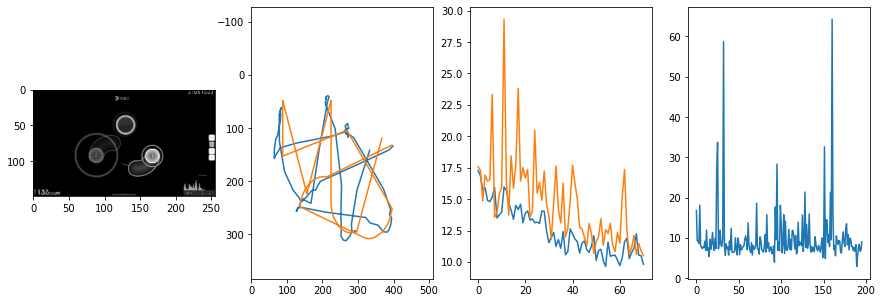


 77 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  12.9820                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.62572325614034
outliers: 48
retrain: 8                 
val: 50/50 loss: 11.4039                                   
pred: 0.4012368619441986 0.8027186989784241
gt: 0.5589724183082581 0.9176898002624512
(134, 124)


<Figure size 1080x360 with 0 Axes>

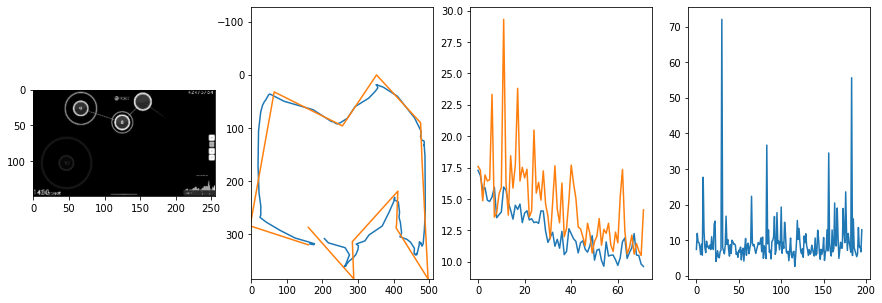


 78 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.77it/s  8.8267                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.850171938234446
outliers: 77
retrain: 8                 
val: 50/50 loss: 9.4954                                    
pred: 0.20703549683094025 0.25083866715431213
gt: 0.3462499976158142 0.3125
(101, 54)


<Figure size 1080x360 with 0 Axes>

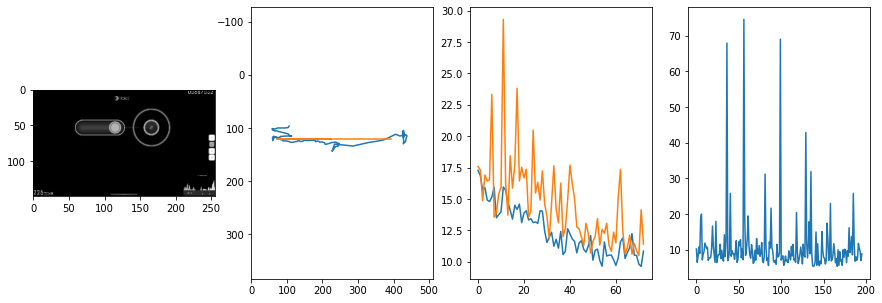


 79 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  9.0516                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.556632230476458
outliers: 31
retrain: 8                 
val: 50/50 loss: 9.3802                                    
pred: 0.7348289489746094 0.2803615927696228
gt: 0.40629416704177856 0.895747184753418
(111, 122)


<Figure size 1080x360 with 0 Axes>

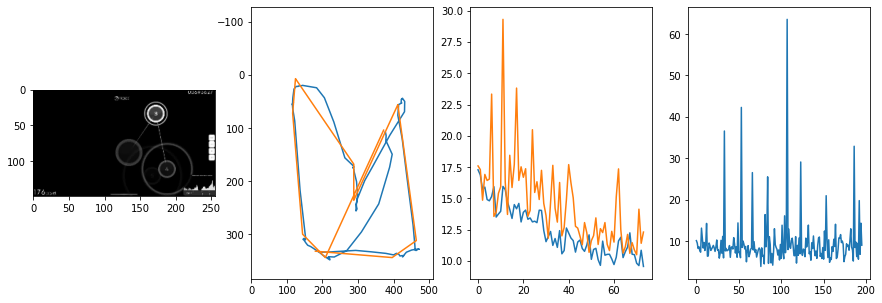


 80 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.74it/s  5.9790                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.608067118391698
outliers: 56
retrain: 8                 
val: 50/50 loss: 12.9506                                   
pred: 0.12116962671279907 0.4655485153198242
gt: 0.3976920545101166 0.30665257573127747
(109, 53)


<Figure size 1080x360 with 0 Axes>

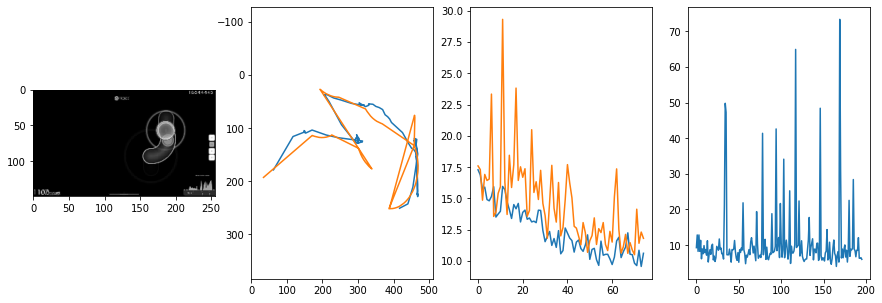


 81 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.74it/s  4.7666                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.269124863099078
outliers: 41
retrain: 8                 
val: 50/50 loss: 13.5912                                   
pred: 0.27817973494529724 0.19180826842784882
gt: 0.3874492049217224 0.7619616389274597
(108, 106)


<Figure size 1080x360 with 0 Axes>

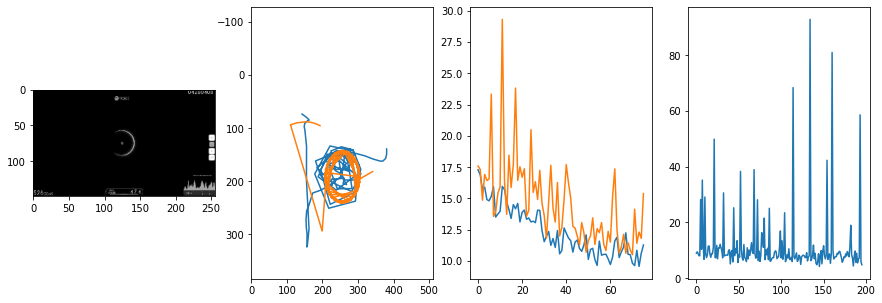


 82 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.84it/s  16.0156                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 11.904588475519297
outliers: 66
retrain: 8                 
val: 50/50 loss: 8.5964                                    
pred: 0.5623225569725037 0.1171833947300911
gt: 0.5019531846046448 0.10677095502614975
(125, 30)


<Figure size 1080x360 with 0 Axes>

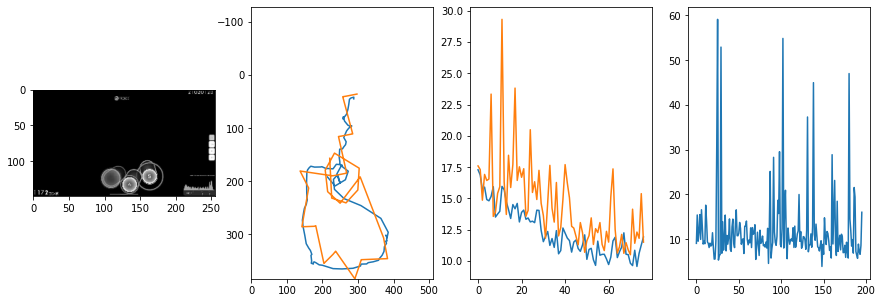


 83 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.69it/s  19.8716                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.972751666088493
outliers: 25
retrain: 8                 
val: 50/50 loss: 6.1370                                    
pred: 0.2716401219367981 0.308158278465271
gt: 0.27350252866744995 0.3880608379840851
(90, 63)


<Figure size 1080x360 with 0 Axes>

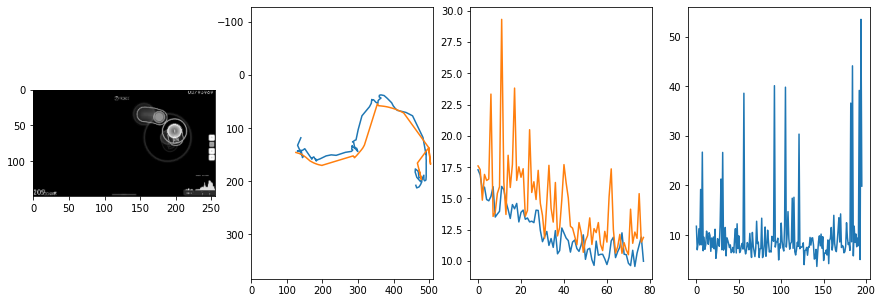


 84 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.73it/s  8.5820                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.506025406779075
outliers: 47
retrain: 8                 
val: 50/50 loss: 28.7618                                   
pred: 0.5654815435409546 0.5028389096260071
gt: 0.5 0.45876410603523254
(125, 71)


<Figure size 1080x360 with 0 Axes>

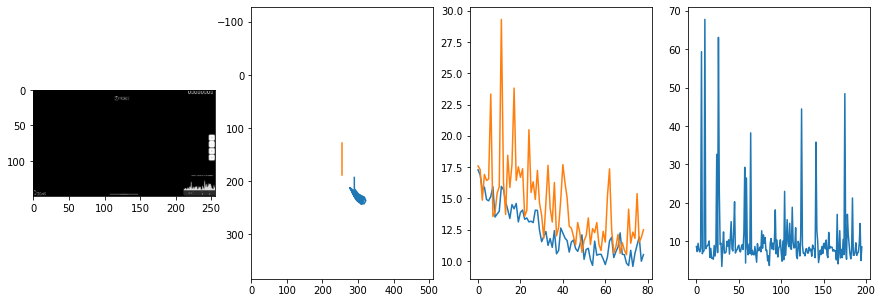


 85 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  10.3332                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.716828139460816
outliers: 38
retrain: 8                 
val: 50/50 loss: 29.4977                                   
pred: 0.3504847288131714 0.5018460154533386
gt: 0.44140639901161194 0.7161455750465393
(116, 101)


<Figure size 1080x360 with 0 Axes>

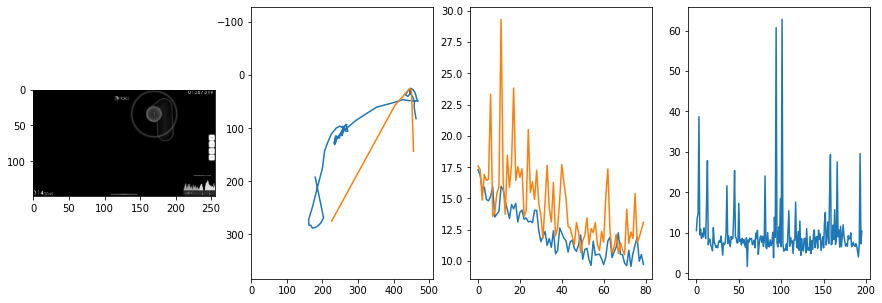


 86 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  6.4933                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.101821223083807
outliers: 46
retrain: 8                 
val: 50/50 loss: 6.7325                                    
pred: 0.7059351801872253 0.504818856716156
gt: 0.6093752980232239 0.354167103767395
(142, 59)


<Figure size 1080x360 with 0 Axes>

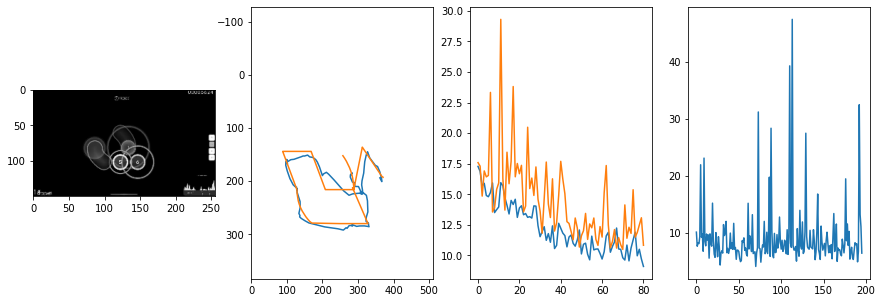


 87 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  7.7110                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.38026368131443
outliers: 62
retrain: 8                 
val: 50/50 loss: 13.2590                                   
pred: 0.7176699042320251 0.5122957229614258
gt: 0.7342453002929688 0.5001830458641052
(161, 76)


<Figure size 1080x360 with 0 Axes>

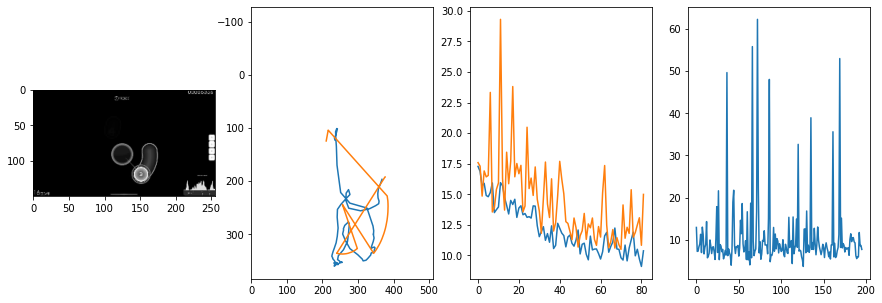


 88 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  8.7367                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.194607965800227
outliers: 41
retrain: 8                 
val: 50/50 loss: 8.0639                                    
pred: 0.6993166208267212 0.7677463889122009
gt: 0.843975305557251 0.7430756092071533
(178, 104)


<Figure size 1080x360 with 0 Axes>

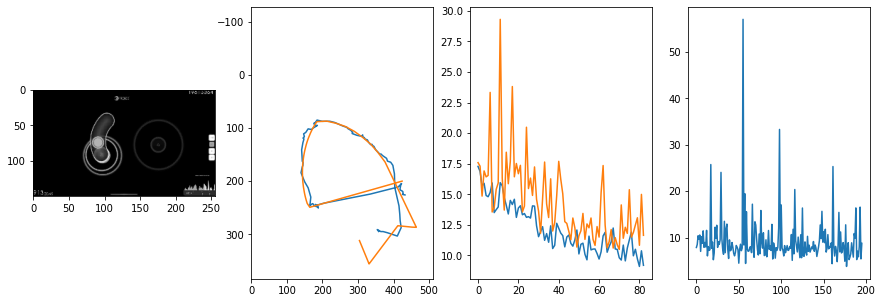


 89 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  8.4146                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.69286061306389
outliers: 82
retrain: 8                 
val: 50/50 loss: 9.0331                                    
pred: 0.5376209616661072 0.23899130523204803
gt: 0.5546875 0.3125
(134, 54)


<Figure size 1080x360 with 0 Axes>

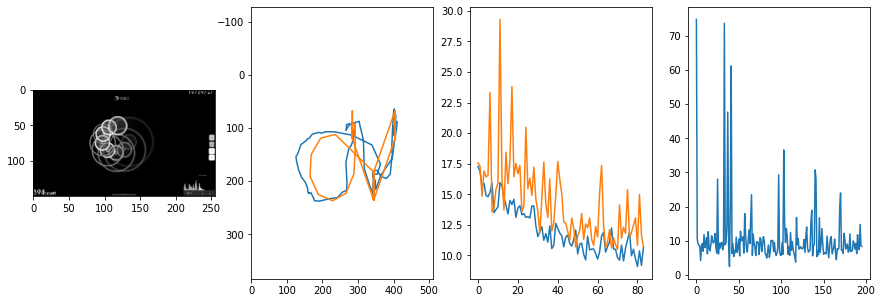


 90 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  8.8293                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.304069331714086
outliers: 34
retrain: 8                 
val: 50/50 loss: 8.2986                                    
pred: 0.27571535110473633 0.4697803854942322
gt: 0.10937510430812836 0.6458332538604736
(64, 93)


<Figure size 1080x360 with 0 Axes>

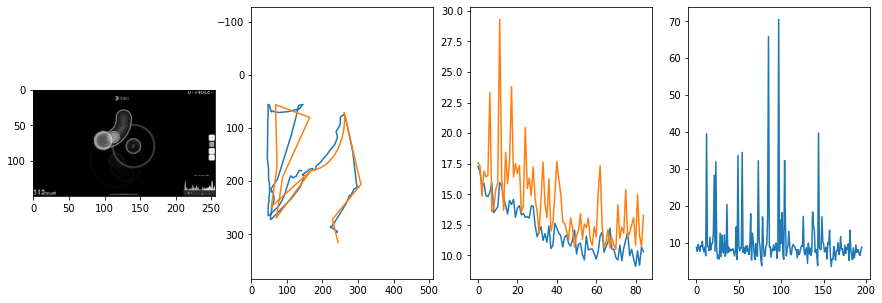


 91 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:26<00:00:00  7.26it/s  10.2421                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.458411256877744
outliers: 37
retrain: 8                 
val: 50/50 loss: 8.4818                                    
pred: 0.13891175389289856 0.8800004720687866
gt: 0.6171871423721313 0.6770834922790527
(143, 96)


<Figure size 1080x360 with 0 Axes>

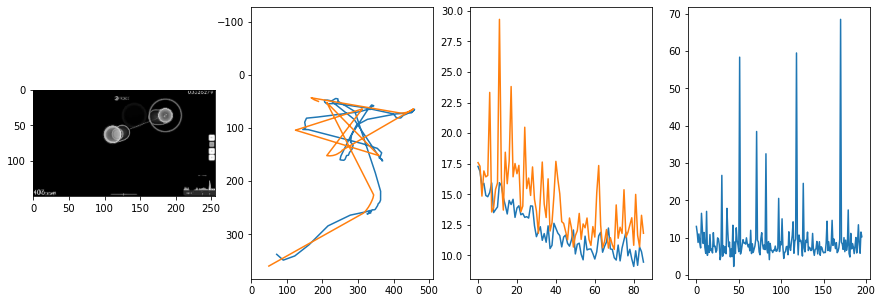


 92 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  6.8333                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.353650786438767
outliers: 45
retrain: 8                 
val: 50/50 loss: 17.6502                                   
pred: 0.8349260687828064 0.7401002049446106
gt: 0.7308708429336548 0.7997572422027588
(161, 111)


<Figure size 1080x360 with 0 Axes>

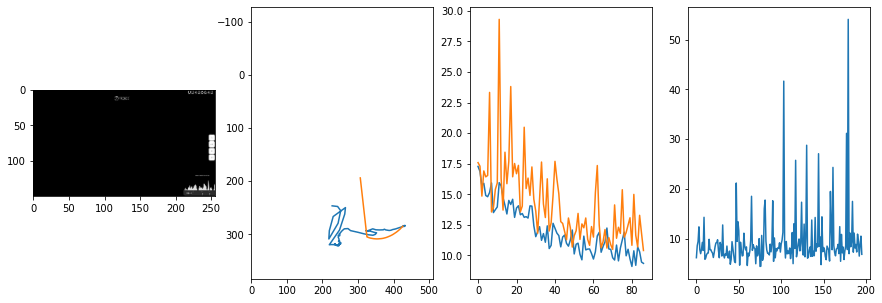


 93 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  7.2313                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.817700918839902
outliers: 50
retrain: 8                 
val: 50/50 loss: 8.2050                                    
pred: 0.1732366383075714 0.07987526804208755
gt: 0.18116730451583862 0.12957723438739777
(76, 33)


<Figure size 1080x360 with 0 Axes>

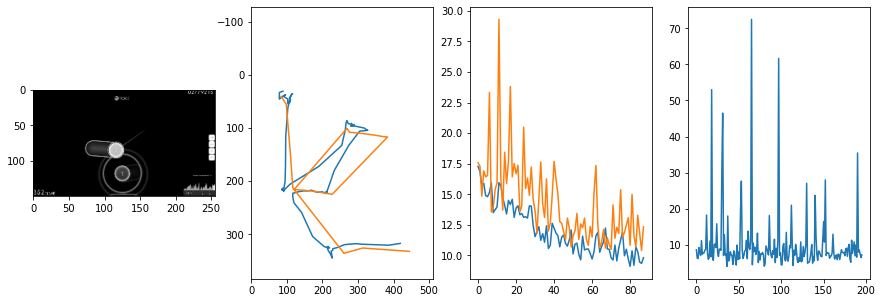


 94 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  74.4858                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.763802686516119
outliers: 45
retrain: 8                 
val: 50/50 loss: 13.4041                                   
pred: 0.21160748600959778 0.5810871720314026
gt: 0.3251012861728668 0.8801069855690002
(98, 120)


<Figure size 1080x360 with 0 Axes>

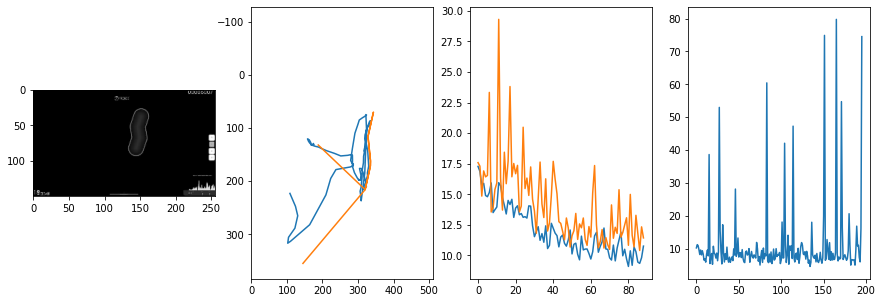


 95 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.85it/s  7.3616                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.831580524541893
outliers: 36
retrain: 8                 
val: 50/50 loss: 9.6382                                    
pred: 0.960695207118988 0.37776216864585876
gt: 0.9307346343994141 0.6036048531532288
(192, 88)


<Figure size 1080x360 with 0 Axes>

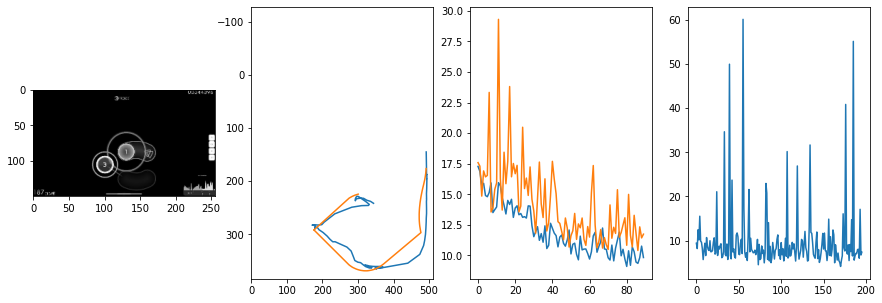


 96 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  5.5803                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.161900935124377
outliers: 46
retrain: 8                 
val: 50/50 loss: 7.1202                                    
pred: 0.6246993541717529 0.20398138463497162
gt: 0.37793734669685364 0.055219441652297974
(106, 24)


<Figure size 1080x360 with 0 Axes>

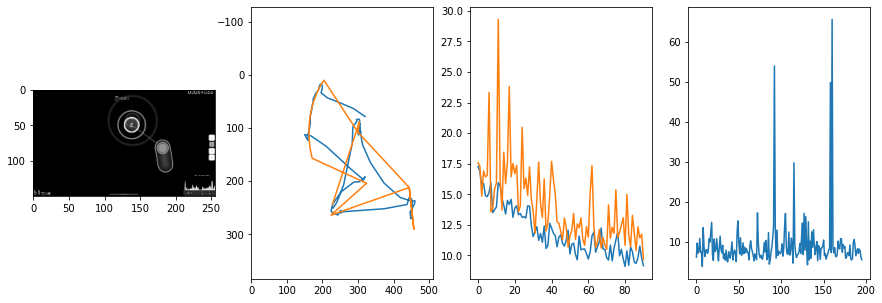


 97 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  4.3783                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.408648483607234
outliers: 60
retrain: 8                 
val: 50/50 loss: 6.2234                                    
pred: 0.2405063360929489 0.6882913708686829
gt: 0.3125 0.696093738079071
(96, 98)


<Figure size 1080x360 with 0 Axes>

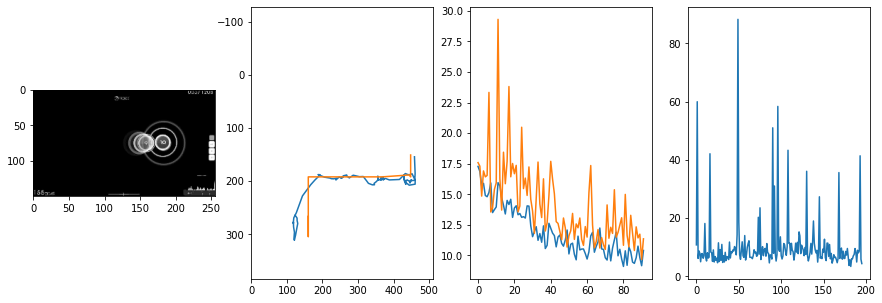


 98 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.72it/s  12.1225                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.630237735047633
outliers: 41
retrain: 8                 
val: 50/50 loss: 12.9991                                   
pred: 0.39820757508277893 0.28957855701446533
gt: 0.705078125 0.0416666679084301
(157, 22)


<Figure size 1080x360 with 0 Axes>

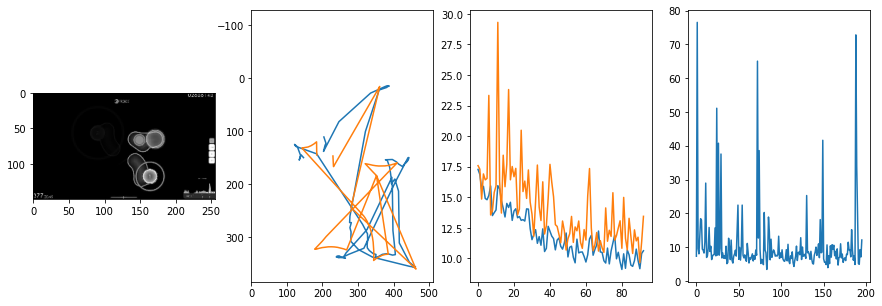


 99 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  6.1362                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.386981720827064
outliers: 47
retrain: 8                 
val: 50/50 loss: 12.3634                                   
pred: 0.45736947655677795 0.1967962235212326
gt: 0.7035591006278992 0.35545119643211365
(157, 59)


<Figure size 1080x360 with 0 Axes>

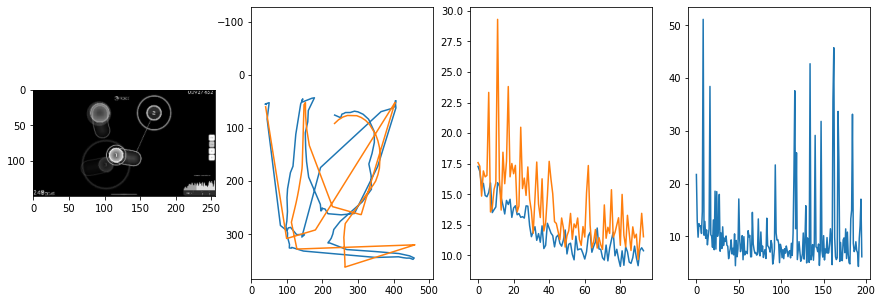


 100 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  6.9636                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.711266911759669
outliers: 39
retrain: 8                 
val: 50/50 loss: 7.0948                                    
pred: 0.6963103413581848 0.29562830924987793
gt: 0.7996053695678711 0.36173200607299805
(172, 60)


<Figure size 1080x360 with 0 Axes>

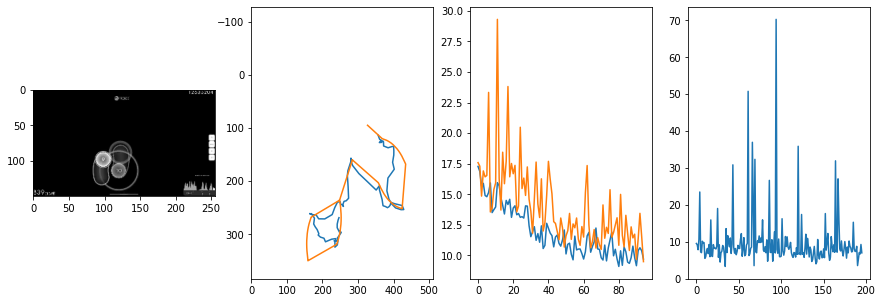


 101 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.72it/s  9.6986                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.857165509340714
outliers: 45
retrain: 8                 
val: 50/50 loss: 9.2500                                    
pred: 0.2737739384174347 0.5472583770751953
gt: 0.13086499273777008 0.6197996735572815
(68, 90)


<Figure size 1080x360 with 0 Axes>

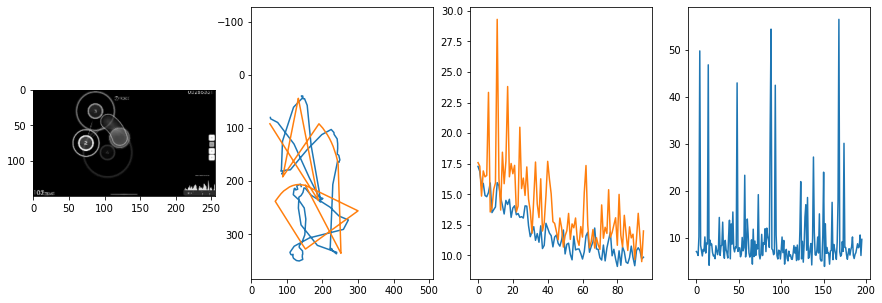


 102 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  51.2485                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.900096856817907
outliers: 48
retrain: 8                 
val: 50/50 loss: 17.5190                                   
pred: 0.5372419357299805 0.2661650776863098
gt: 0.7031103372573853 0.21877223253250122
(157, 43)


<Figure size 1080x360 with 0 Axes>

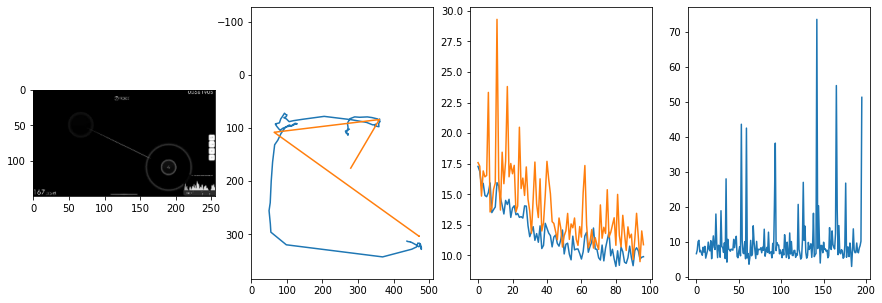


 103 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  12.7987                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.174080610275269
outliers: 37
retrain: 8                 
val: 50/50 loss: 5.2514                                    
pred: 0.31001555919647217 0.7672259211540222
gt: 0.4609375 0.7604166865348816
(119, 106)


<Figure size 1080x360 with 0 Axes>

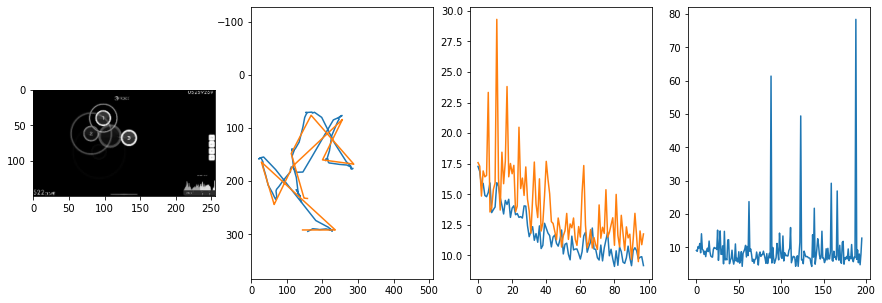


 104 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.90it/s  7.4092                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.330208192066271
outliers: 52
retrain: 8                 
val: 50/50 loss: 12.0075                                   
pred: 0.29736217856407166 0.22444923222064972
gt: 0.5404378175735474 0.29164597392082214
(131, 51)


<Figure size 1080x360 with 0 Axes>

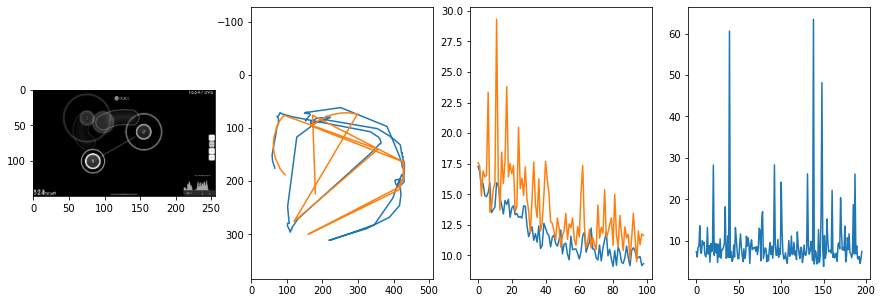


 105 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.66it/s  8.9974                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.198319374298563
outliers: 41
retrain: 8                 
val: 50/50 loss: 6.6126                                    
pred: 0.24625501036643982 0.15545755624771118
gt: 0.21875007450580597 0.16666676104068756
(81, 37)


<Figure size 1080x360 with 0 Axes>

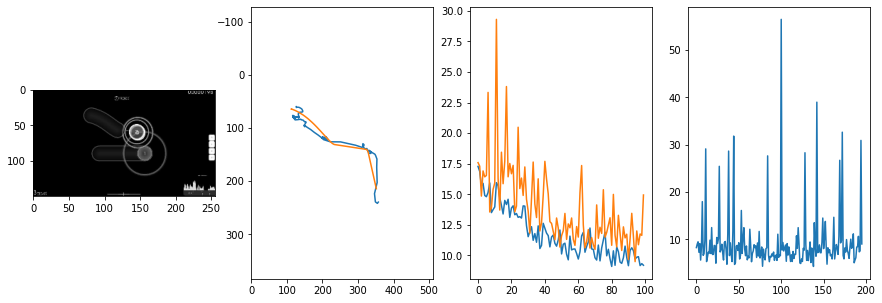


 106 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  7.7207                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.547933364401059
outliers: 54
retrain: 8                 
val: 50/50 loss: 6.7575                                    
pred: 0.9215745329856873 0.6802067756652832
gt: 0.8020941019058228 0.6007117629051208
(172, 87)


<Figure size 1080x360 with 0 Axes>

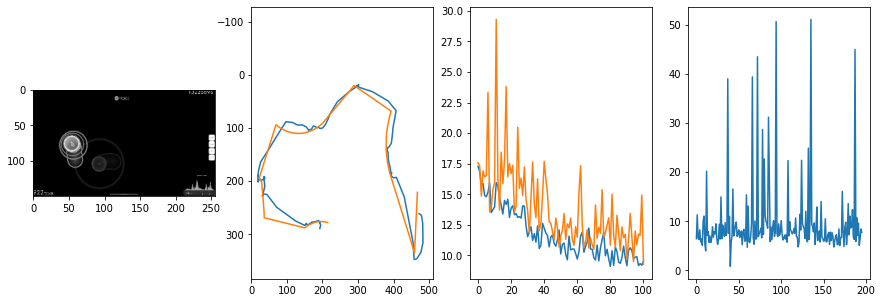


 107 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  44.3001                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.699315747436213
outliers: 53
retrain: 8                 
val: 50/50 loss: 8.2742                                    
pred: 0.1587524265050888 0.5477880239486694
gt: 0.1718749850988388 0.40625
(74, 65)


<Figure size 1080x360 with 0 Axes>

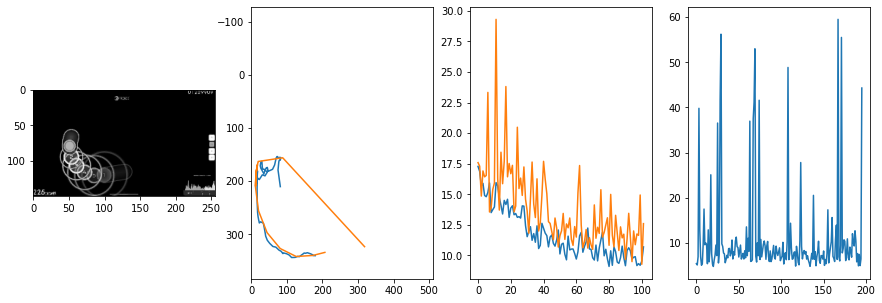


 108 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  6.4045                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.663267462837453
outliers: 29
retrain: 8                 
val: 50/50 loss: 11.0341                                   
pred: 0.5440588593482971 0.37385401129722595
gt: 0.47656553983688354 0.6822888255119324
(121, 97)


<Figure size 1080x360 with 0 Axes>

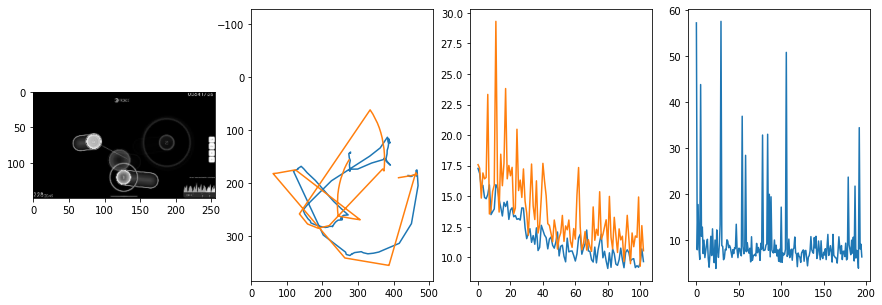


 109 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.92it/s  52.8214                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.719645994050163
outliers: 44
retrain: 8                 
val: 50/50 loss: 17.9639                                   
pred: 0.19146552681922913 0.7295981049537659
gt: 0.781248152256012 0.7812499403953552
(169, 108)


<Figure size 1080x360 with 0 Axes>

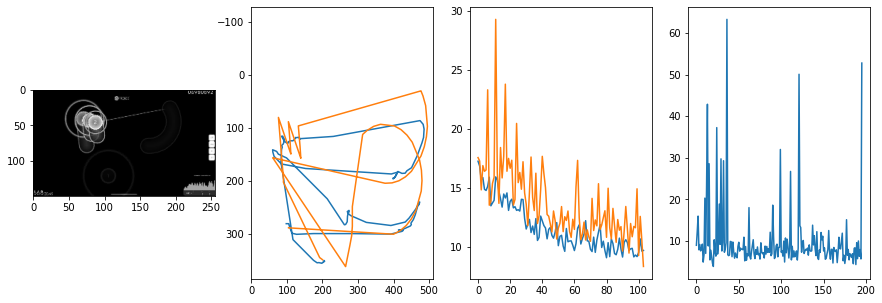


 110 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  7.2129                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.402617564006727
outliers: 38
retrain: 8                 
val: 50/50 loss: 8.0577                                    
pred: 0.4828018546104431 0.6054127216339111
gt: 0.30416348576545715 0.9053465723991394
(95, 123)


<Figure size 1080x360 with 0 Axes>

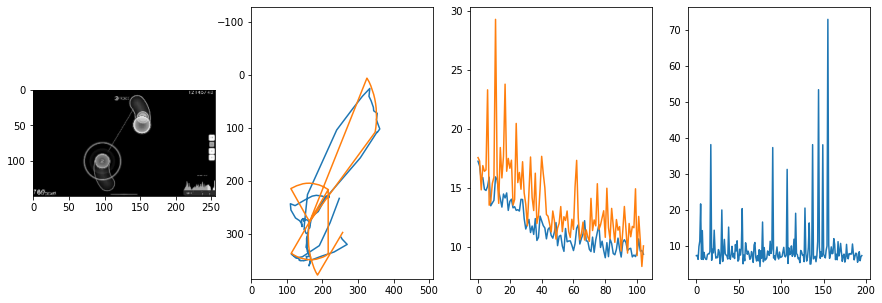


 111 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.94it/s  36.0048                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.383606429002723
outliers: 53
retrain: 8                 
val: 50/50 loss: 9.5096                                    
pred: 0.4122292995452881 0.25197574496269226
gt: 0.5396115779876709 0.29944589734077454
(131, 52)


<Figure size 1080x360 with 0 Axes>

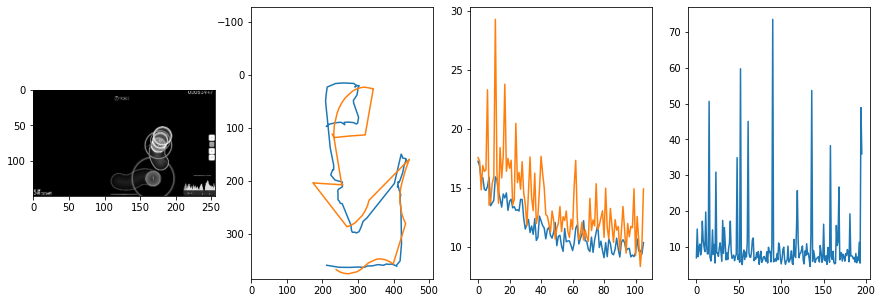


 112 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  11.1058                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.821796419669171
outliers: 28
retrain: 8                 
val: 50/50 loss: 11.0811                                   
pred: 0.4239047169685364 0.5343355536460876
gt: 0.51171875 0.3932291567325592
(127, 63)


<Figure size 1080x360 with 0 Axes>

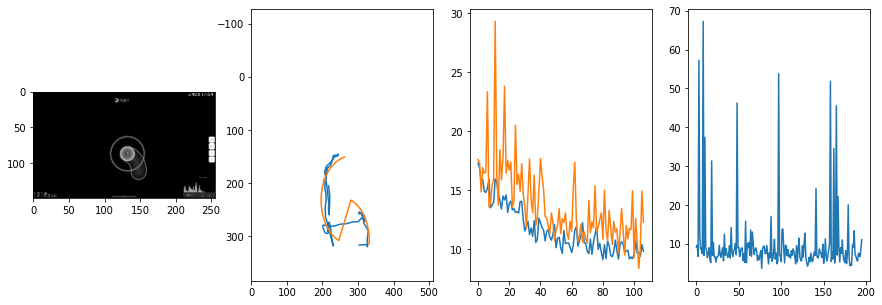


 113 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  7.7187                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.859527845771945
outliers: 40
retrain: 8                 
val: 50/50 loss: 10.3491                                   
pred: 0.5428115725517273 0.7096318602561951
gt: 0.376953125 0.6666666865348816
(106, 95)


<Figure size 1080x360 with 0 Axes>

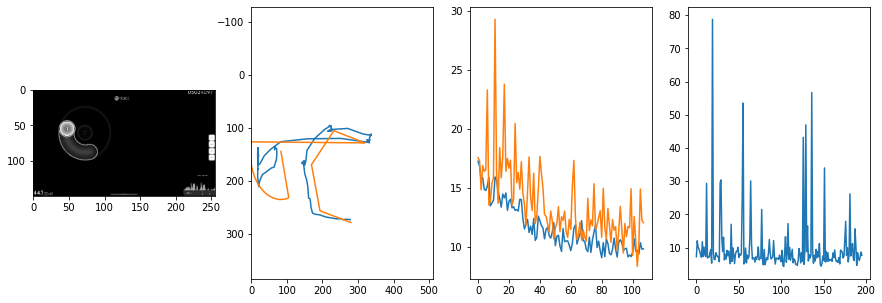


 114 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.69it/s  4.0934                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.639667895375466
outliers: 39
retrain: 8                 
val: 50/50 loss: 10.6568                                   
pred: 0.42186346650123596 0.3956941068172455
gt: 0.6933543682098389 0.6510312557220459
(155, 93)


<Figure size 1080x360 with 0 Axes>

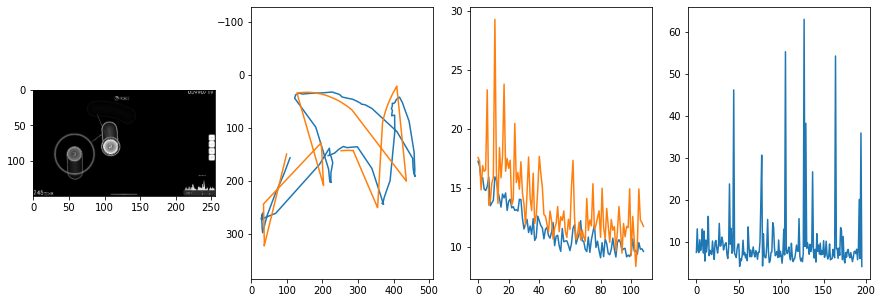


 115 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.83it/s  4.9521                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 8.647915858395246
outliers: 38
retrain: 8                 
val: 50/50 loss: 8.2732                                    
pred: 0.5120165348052979 0.13891784846782684
gt: 0.0859375 0.21875
(61, 43)


<Figure size 1080x360 with 0 Axes>

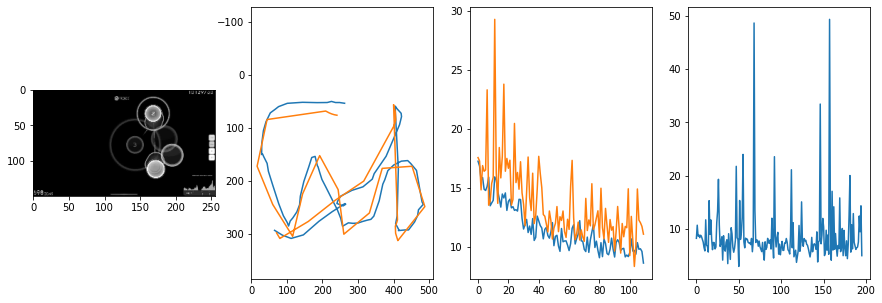


 116 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  5.7598                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.28743858483373
outliers: 81
retrain: 8                 
val: 50/50 loss: 10.1104                                   
pred: 0.15354445576667786 0.3326999843120575
gt: 0.1523842215538025 0.3799101412296295
(71, 62)


<Figure size 1080x360 with 0 Axes>

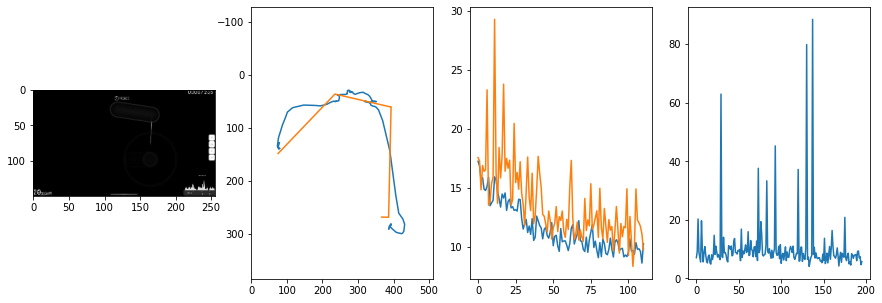


 117 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.72it/s  6.2449                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.549880486361834
outliers: 27
retrain: 8                 
val: 50/50 loss: 12.2465                                   
pred: 0.3205541670322418 0.37702876329421997
gt: 0.80078125 0.5651041865348816
(172, 83)


<Figure size 1080x360 with 0 Axes>

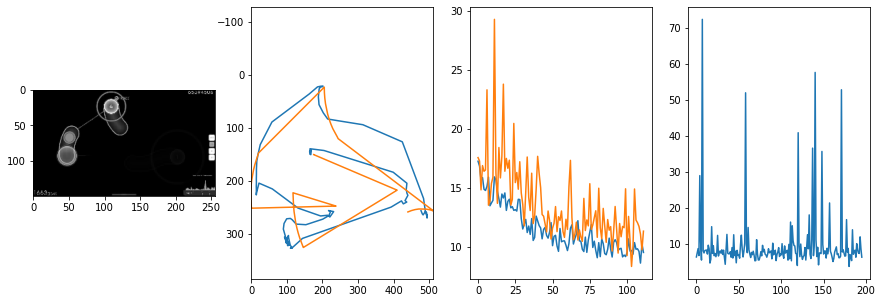


 118 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  36.5600                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 8.635070199869118
outliers: 33
retrain: 8                 
val: 50/50 loss: 19.6298                                   
pred: 0.5785917043685913 0.4507768750190735
gt: 0.4552881121635437 0.3842375576496124
(118, 62)


<Figure size 1080x360 with 0 Axes>

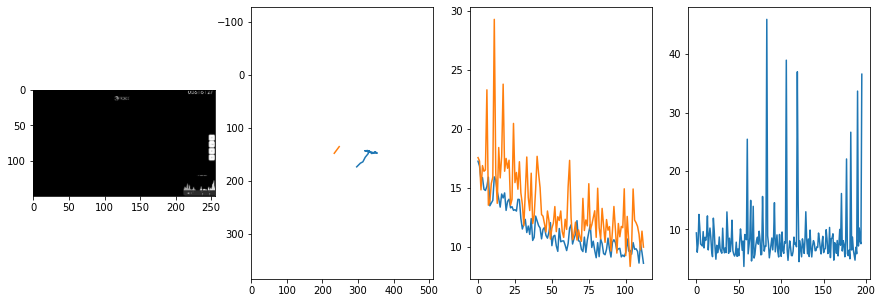


 119 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  7.5250                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.311427117610464
outliers: 51
retrain: 8                 
val: 50/50 loss: 13.4285                                   
pred: 0.7495628595352173 0.48751100897789
gt: 0.849940299987793 0.302272766828537
(179, 53)


<Figure size 1080x360 with 0 Axes>

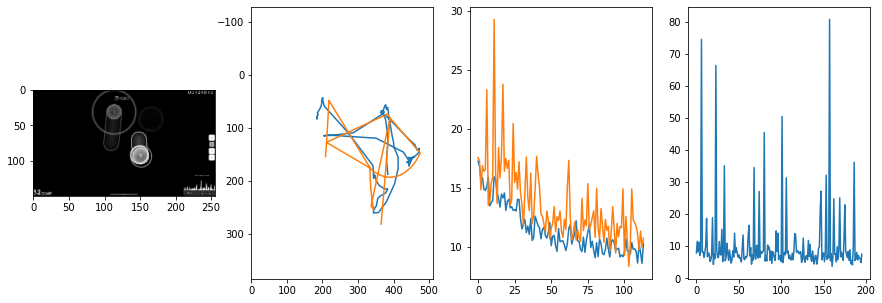


 120 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:24<00:00:00  7.86it/s  18.9527                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.408469243925445
outliers: 28
retrain: 8                 
val: 50/50 loss: 4.9972                                    
pred: 0.20714302361011505 0.6874723434448242
gt: 0.14151348173618317 0.6604279279708862
(69, 94)


<Figure size 1080x360 with 0 Axes>

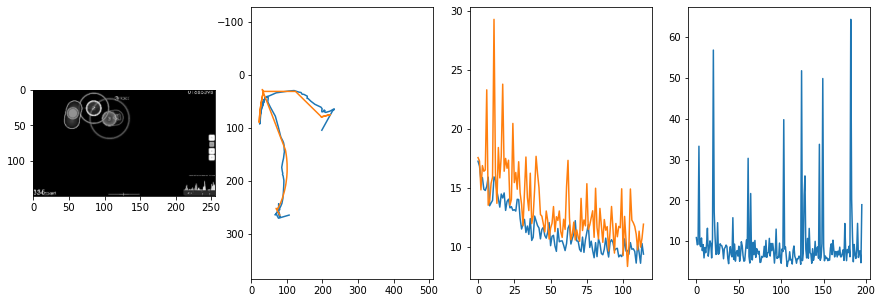


 121 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.70it/s  9.2881                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.217304845245517
outliers: 40
retrain: 8                 
val: 50/50 loss: 7.3784                                    
pred: 0.629802405834198 0.8046702742576599
gt: 0.5390710234642029 0.2292029708623886
(131, 44)


<Figure size 1080x360 with 0 Axes>

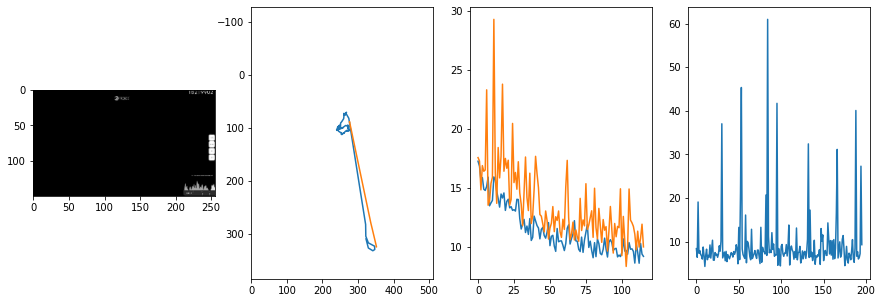


 122 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.69it/s  7.6310                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.018278292247228
outliers: 45
retrain: 8                 
val: 50/50 loss: 8.6094                                    
pred: 0.5483318567276001 0.4221368134021759
gt: 0.8105365633964539 0.3854175806045532
(173, 62)


<Figure size 1080x360 with 0 Axes>

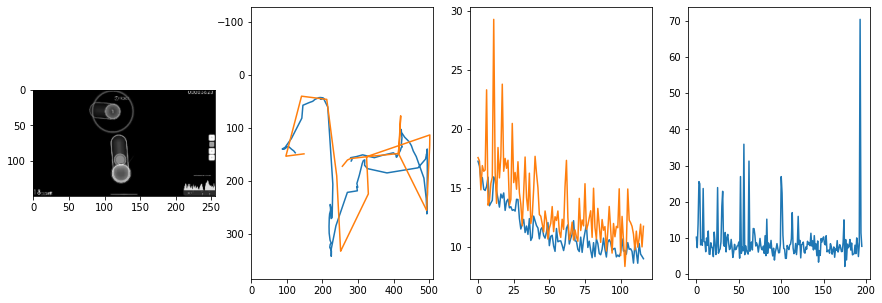


 123 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.62it/s  7.3006                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.896312390054975
outliers: 47
retrain: 8                 
val: 50/50 loss: 8.5861                                    
pred: 0.7463080883026123 0.5369858145713806
gt: 0.8906227350234985 0.716142475605011
(186, 101)


<Figure size 1080x360 with 0 Axes>

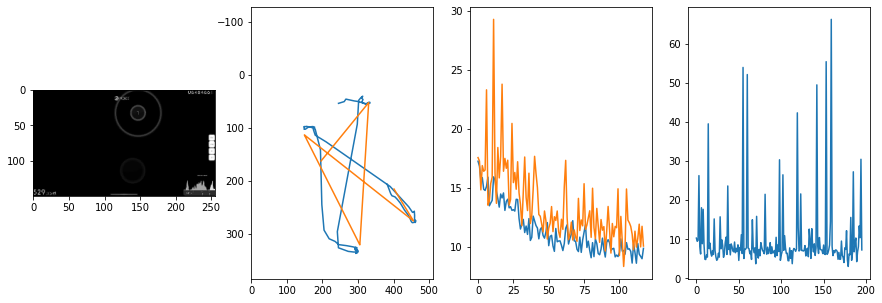


 124 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  9.9271                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.182355503646695
outliers: 35
retrain: 8                 
val: 50/50 loss: 7.8834                                    
pred: 0.6240097284317017 0.5750232338905334
gt: 0.59765625 0.4088541567325592
(140, 65)


<Figure size 1080x360 with 0 Axes>

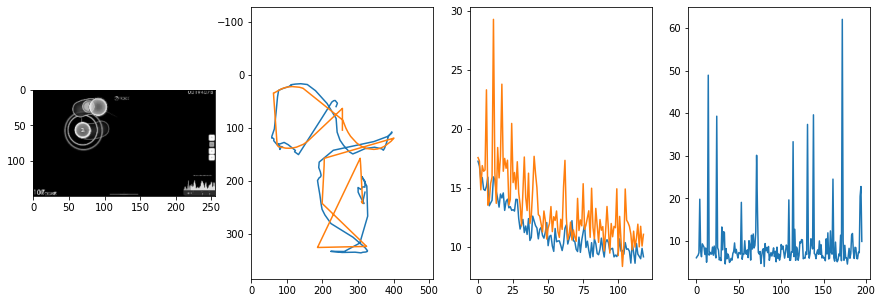


 125 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.75it/s  9.0026                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 8.475446702266225
outliers: 43
retrain: 8                 
val: 50/50 loss: 7.9328                                    
pred: 0.7235519289970398 0.23995769023895264
gt: 0.7326531410217285 0.24040557444095612
(161, 45)


<Figure size 1080x360 with 0 Axes>

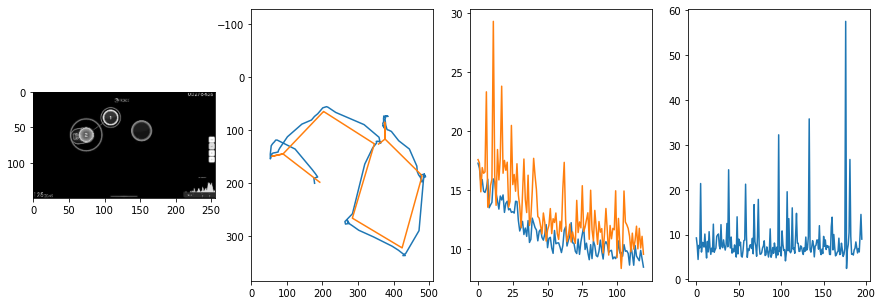


 126 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.78it/s  24.5749                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.409728697368077
outliers: 55
retrain: 8                 
val: 50/50 loss: 8.2240                                    
pred: 0.729790449142456 0.6838067770004272
gt: 0.1294003278017044 0.6050336956977844
(68, 88)


<Figure size 1080x360 with 0 Axes>

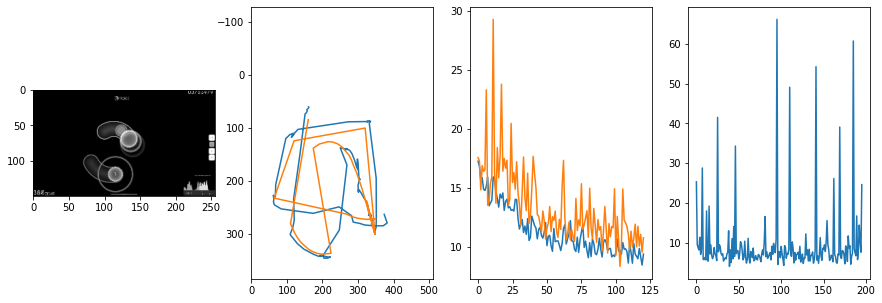


 127 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.79it/s  5.9824                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 8.985657080095642
outliers: 40
retrain: 8                 
val: 50/50 loss: 8.6809                                    
pred: 0.36958953738212585 0.12315292656421661
gt: 0.33831676840782166 0.1590348184108734
(100, 36)


<Figure size 1080x360 with 0 Axes>

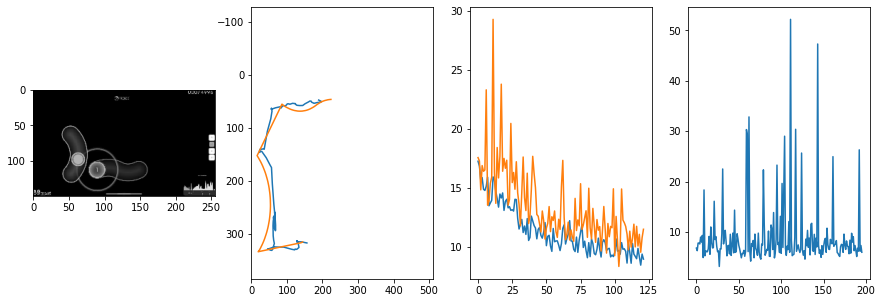


 128 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.82it/s  7.1072                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 8.896374596624959
outliers: 51
retrain: 8                 
val: 50/50 loss: 13.7045                                   
pred: 0.28201740980148315 0.33087554574012756
gt: 0.28325995802879333 0.8796547055244446
(91, 120)


<Figure size 1080x360 with 0 Axes>

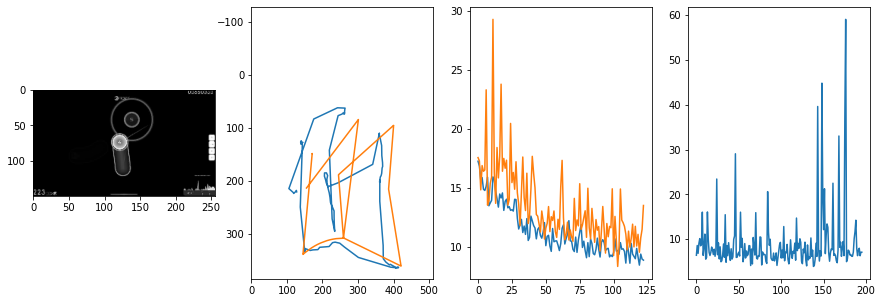


 129 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.80it/s  6.7006                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.000824658238159
outliers: 54
retrain: 8                 
val: 50/50 loss: 6.9927                                    
pred: 0.6936612129211426 0.821097195148468
gt: 0.7949219346046448 0.8593750596046448
(171, 117)


<Figure size 1080x360 with 0 Axes>

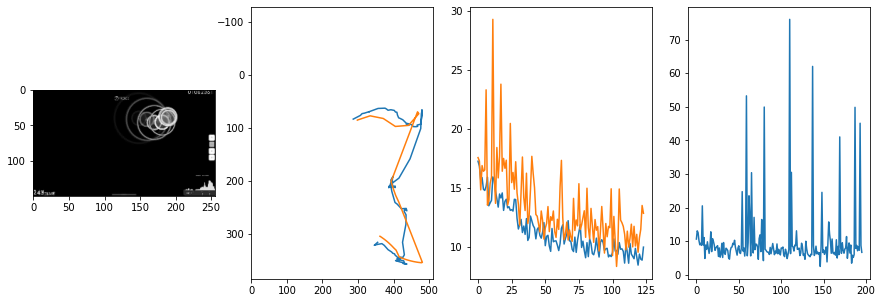


 130 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  4.8737                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 10.17106693861436
outliers: 48
retrain: 8                 
val: 50/50 loss: 12.9909                                   
pred: 0.7132753729820251 0.9188937544822693
gt: 0.8965075612068176 0.9764184951782227
(187, 131)


<Figure size 1080x360 with 0 Axes>

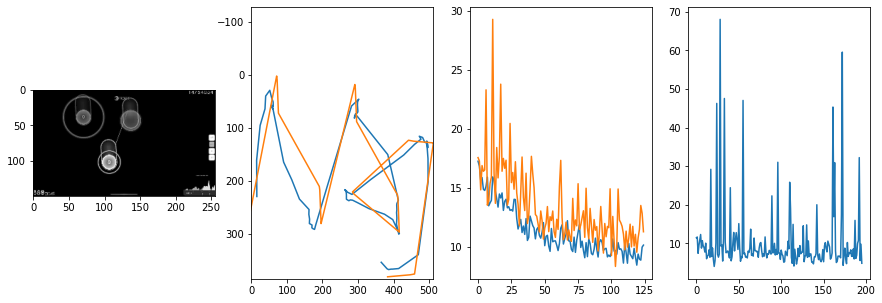


 131 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.76it/s  4.7283                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 8.654651082291895
outliers: 27
retrain: 8                 
val: 50/50 loss: 6.8521                                    
pred: 0.2302267998456955 0.3805680572986603
gt: 0.11314360797405243 0.3786274492740631
(65, 62)


<Figure size 1080x360 with 0 Axes>

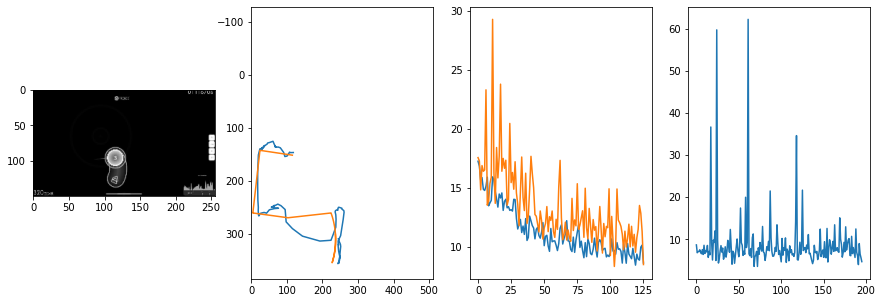


 132 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.81it/s  6.3584                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.160949988024575
outliers: 48
retrain: 8                 
val: 50/50 loss: 7.8320                                    
pred: 0.7301431894302368 0.91709965467453
gt: 0.5976477861404419 0.9140509963035583
(140, 124)


<Figure size 1080x360 with 0 Axes>

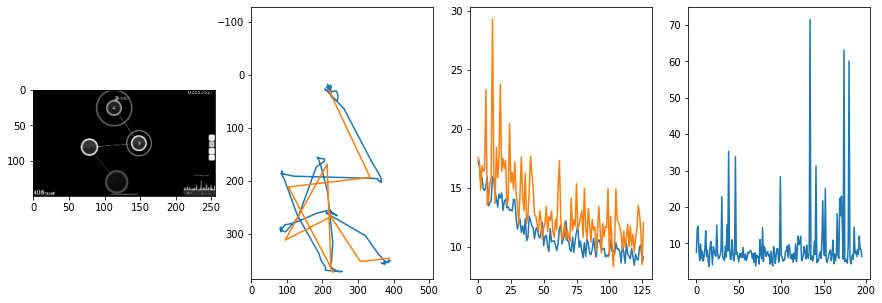


 133 of 134


  Iters     Elapsed Time      Speed     loss                                    
 196/196  00:00:25<00:00:00  7.65it/s  6.8604                                   

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 9.537672609699015
outliers: 47
retrain: 8                 
val: 50/50 loss: 12.4576                                   
pred: 0.4495893120765686 0.2130078375339508
gt: 0.4707089066505432 0.1979312300682068
(120, 41)


<Figure size 1080x360 with 0 Axes>

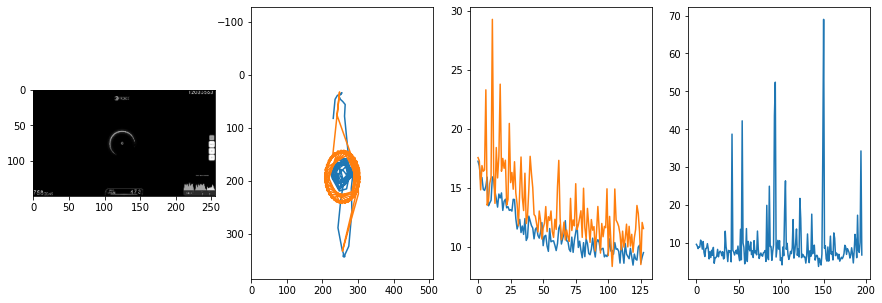


 134 of 134
4742.8444809913635 secs


In [21]:
start = time.time()

epochs = 128
loss_thresh = 0.0005
rnum_min = 8
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [22]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

8.36323489189148


In [23]:
seq_dur = 1
best_loss = 9999

In [24]:
train_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)
val_ds = OSR_Dataset(None, sample_rate=sample_rate, hop_size=hop_size, seq_dur=seq_dur, scale=scale, hidden_mod=hidden_mod, maximum=maximum)

train_ds.take(ds, 0, int(len(ds) * 0.8))
val_ds.take(ds, int(len(ds) * 0.8), len(ds))

train_ldr = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)
val_ldr = DataLoader(val_ds, batch_size=batch_size, shuffle=True, num_workers=1, prefetch_factor=2)

1 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  3.4939                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.351588606834412
outliers: 196
retrain: 4                 
val: 50/50 loss: 3.0673                                    
pred: 0.31250089406967163 0.5120290517807007
gt: 0.2812504172325134 0.6953163146972656
(91, 98)


<Figure size 1080x360 with 0 Axes>

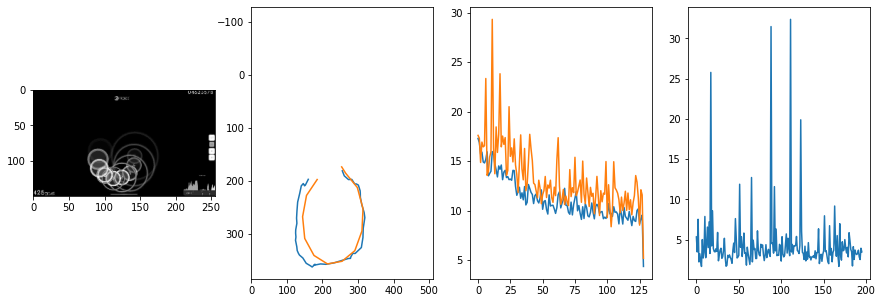


 135 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  7.9015                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.619851605016358
outliers: 62
retrain: 4                 
val: 50/50 loss: 5.6914                                    
pred: 0.13243591785430908 0.34382936358451843
gt: 0.5625 0.3229166567325592
(135, 55)


<Figure size 1080x360 with 0 Axes>

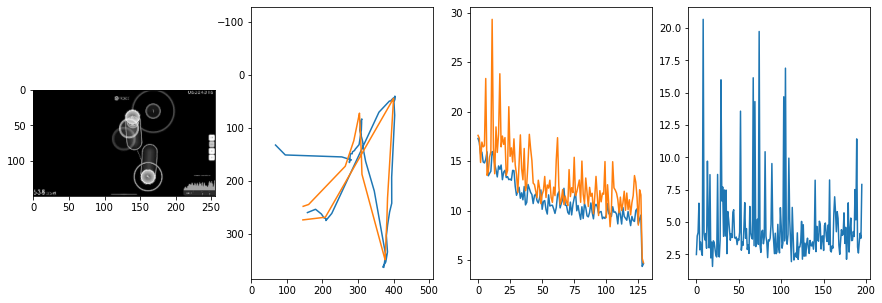


 136 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.98it/s  3.4069                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.190181198168774
outliers: 40
retrain: 4                 
val: 50/50 loss: 4.3089                                    
pred: 0.28684547543525696 0.12348795682191849
gt: 0.2812500298023224 0.2682291865348816
(91, 49)


<Figure size 1080x360 with 0 Axes>

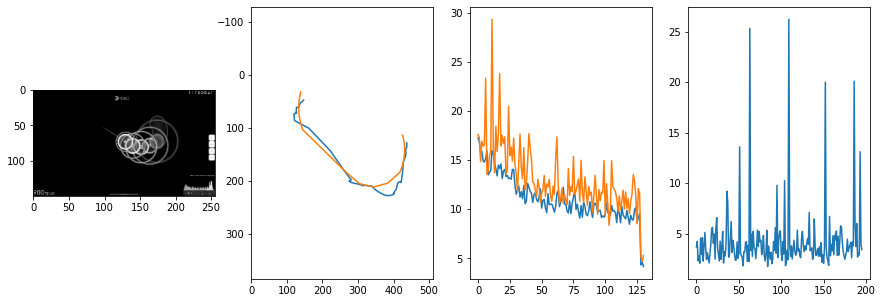


 137 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  13.05it/s  2.1308                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.667495941021005
outliers: 64
retrain: 4                 
val: 50/50 loss: 4.4616                                    
pred: 0.5893453359603882 0.9570969343185425
gt: 0.7622305154800415 0.9160704612731934
(166, 124)


<Figure size 1080x360 with 0 Axes>

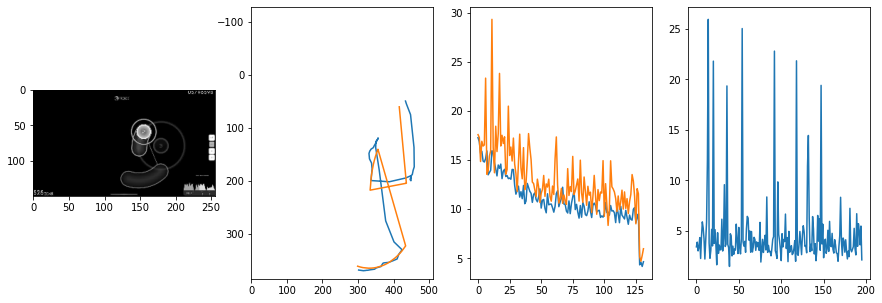


 138 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.26it/s  2.4752                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.665666831999409
outliers: 45
retrain: 4                 
val: 50/50 loss: 4.0442                                    
pred: 0.7297928333282471 0.3388248383998871
gt: 0.7157156467437744 0.12069150060415268
(158, 32)


<Figure size 1080x360 with 0 Axes>

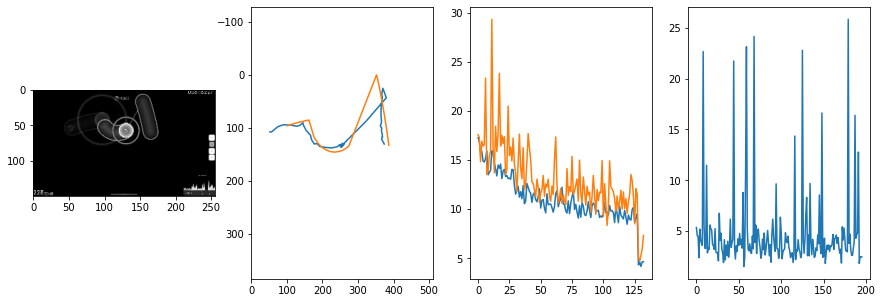


 139 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.10it/s  4.3632                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.760793879932287
outliers: 89
retrain: 4                 
val: 50/50 loss: 3.6135                                    
pred: 0.7139474749565125 0.6954477429389954
gt: 0.890625 0.7499999403953552
(186, 105)


<Figure size 1080x360 with 0 Axes>

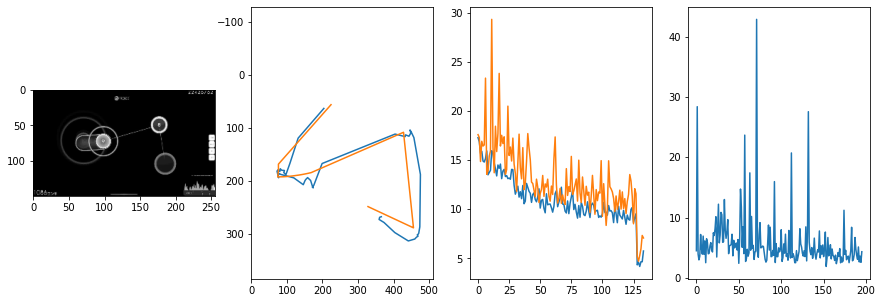


 140 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.73it/s  4.5018                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.359507935995958
outliers: 38
retrain: 4                 
val: 50/50 loss: 4.6453                                    
pred: 0.4544582664966583 0.22701328992843628
gt: 0.4272031784057617 0.2794261872768402
(114, 50)


<Figure size 1080x360 with 0 Axes>

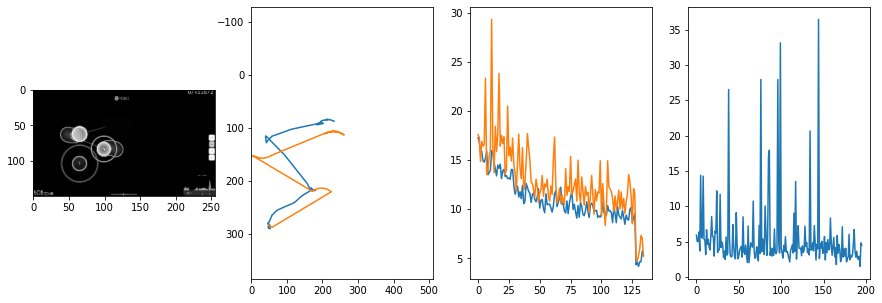


 141 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.12it/s  3.6017                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.738090072359357
outliers: 46
retrain: 4                 
val: 50/50 loss: 5.4613                                    
pred: 0.6528739929199219 0.5040010809898376
gt: 0.7656095027923584 0.2291666716337204
(166, 44)


<Figure size 1080x360 with 0 Axes>

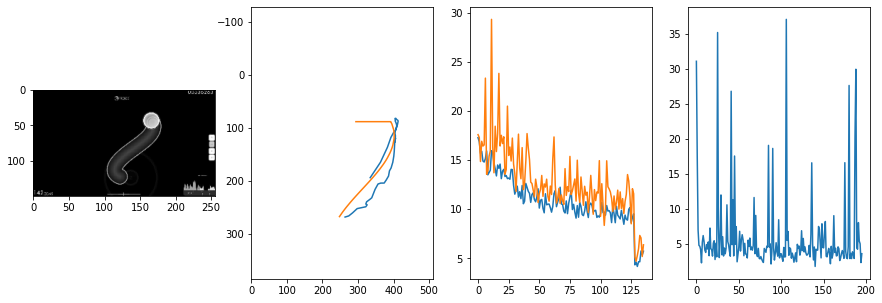


 142 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.16it/s  3.3996                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.398090705579641
outliers: 35
retrain: 4                 
val: 50/50 loss: 3.5313                                    
pred: 0.14576181769371033 0.14070342481136322
gt: 0.32031241059303284 0.2083333134651184
(97, 42)


<Figure size 1080x360 with 0 Axes>

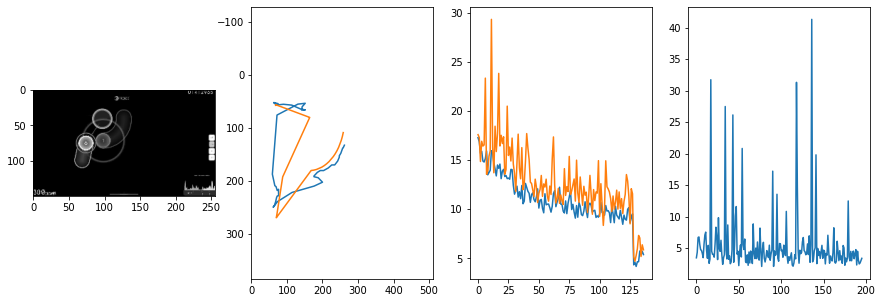


 143 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.26it/s  27.0295                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.782836248680037
outliers: 34
retrain: 4                 
val: 50/50 loss: 4.1399                                    
pred: 0.74558424949646 0.24420417845249176
gt: 0.6330726146697998 0.7241377234458923
(146, 102)


<Figure size 1080x360 with 0 Axes>

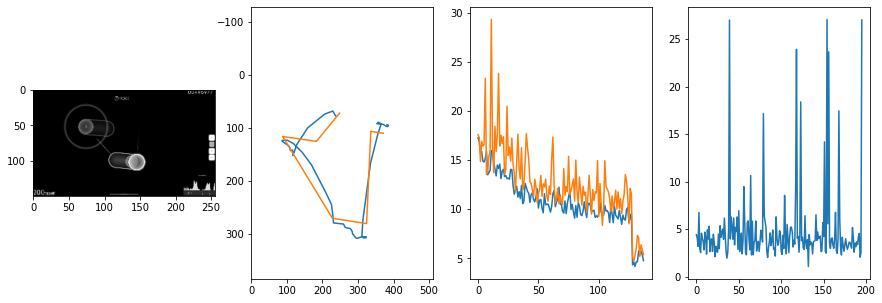


 144 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.23it/s  4.4691                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 6.10373988990881
outliers: 64
retrain: 4                 
val: 50/50 loss: 3.2546                                    
pred: 0.3302900791168213 0.2904205322265625
gt: 0.44335365295410156 0.3802048861980438
(116, 62)


<Figure size 1080x360 with 0 Axes>

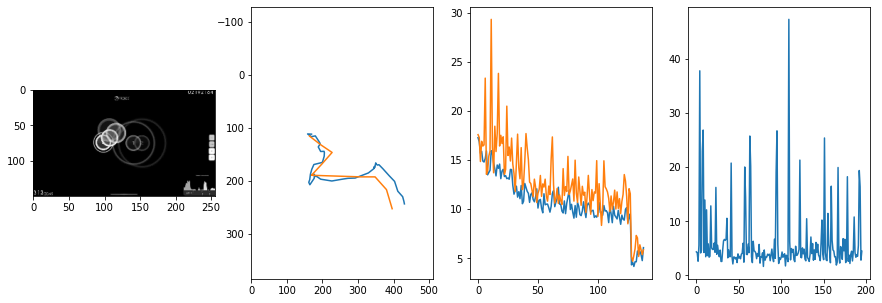


 145 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.24it/s  4.1992                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.830647099991234
outliers: 23
retrain: 4                 
val: 50/50 loss: 36.3108                                   
pred: 0.5215587615966797 0.466755211353302
gt: 0.21476049721240997 0.14232145249843597
(81, 34)


<Figure size 1080x360 with 0 Axes>

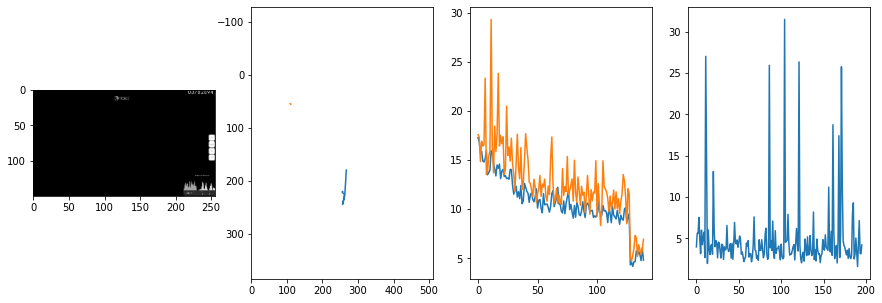


 146 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.81it/s  4.9384                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.896136082556783
outliers: 49
retrain: 4                 
val: 50/50 loss: 3.4167                                    
pred: 0.5101765990257263 0.723648190498352
gt: 0.46239688992500305 0.32658445835113525
(119, 55)


<Figure size 1080x360 with 0 Axes>

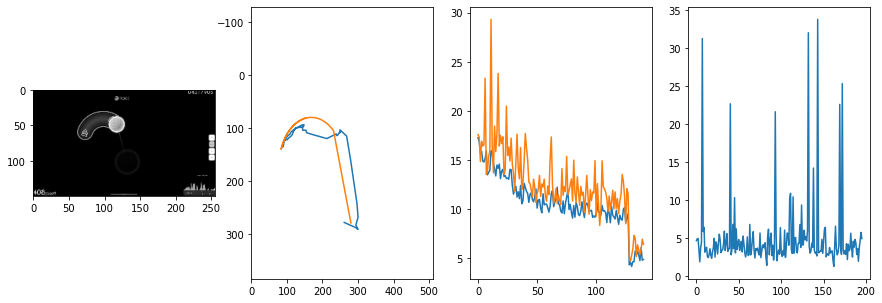


 147 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.18it/s  3.1867                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.650227108172008
outliers: 55
retrain: 4                 
val: 50/50 loss: 4.8632                                    
pred: 0.5926819443702698 0.6005759239196777
gt: 0.44390034675598145 0.3934202492237091
(116, 63)


<Figure size 1080x360 with 0 Axes>

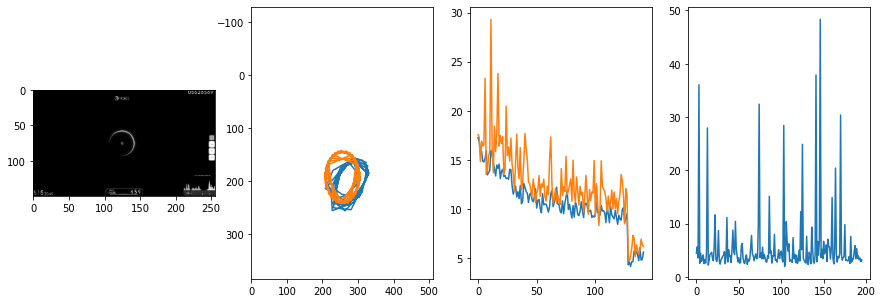


 148 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.73it/s  2.8301                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.434051517321139
outliers: 39
retrain: 4                 
val: 50/50 loss: 4.1357                                    
pred: 0.26761671900749207 0.654960572719574
gt: 0.296875 0.3984375
(94, 64)


<Figure size 1080x360 with 0 Axes>

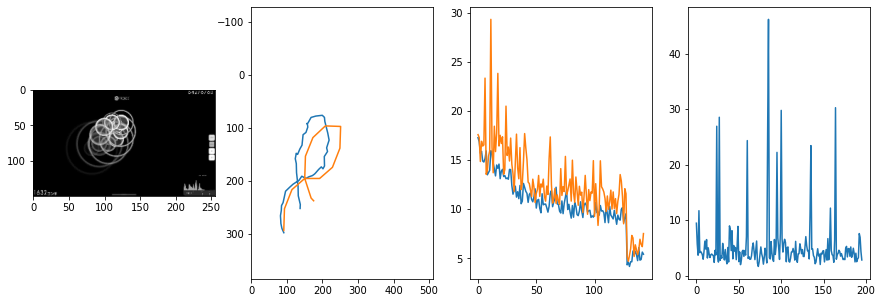


 149 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.94it/s  3.0702                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.7563865002320735
outliers: 42
retrain: 4                 
val: 50/50 loss: 17.9265                                   
pred: 0.36048007011413574 0.5192472338676453
gt: 0.10156271606683731 0.6249999403953552
(63, 90)


<Figure size 1080x360 with 0 Axes>

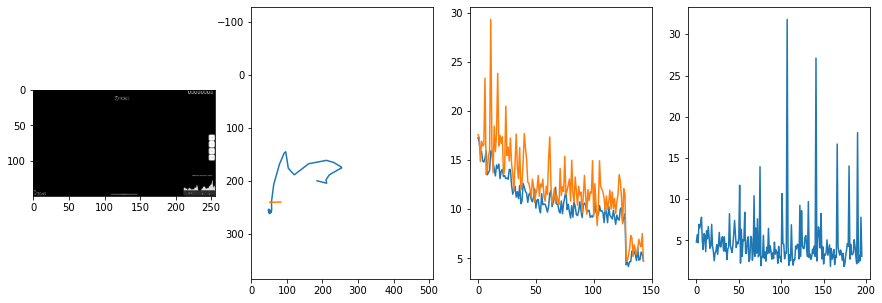


 150 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.69it/s  3.0155                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.90715123682606
outliers: 53
retrain: 4                 
val: 50/50 loss: 4.6038                                    
pred: 0.7414854168891907 0.46350017189979553
gt: 0.7634241580963135 0.4900803864002228
(166, 75)


<Figure size 1080x360 with 0 Axes>

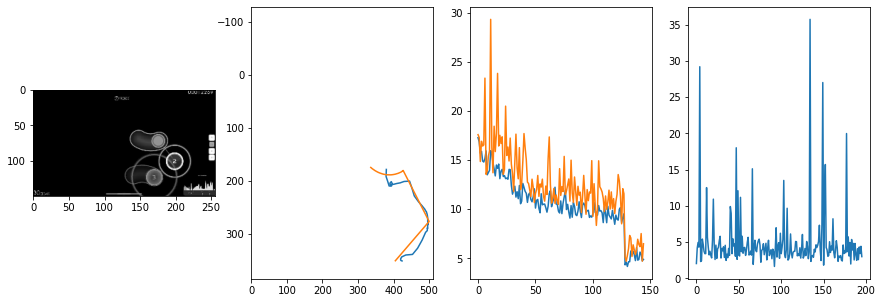


 151 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.66it/s  10.4530                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.290981126683099
outliers: 46
retrain: 4                 
val: 50/50 loss: 3.3944                                    
pred: 0.16739484667778015 0.5746117234230042
gt: 0.1640625 0.59375
(73, 87)


<Figure size 1080x360 with 0 Axes>

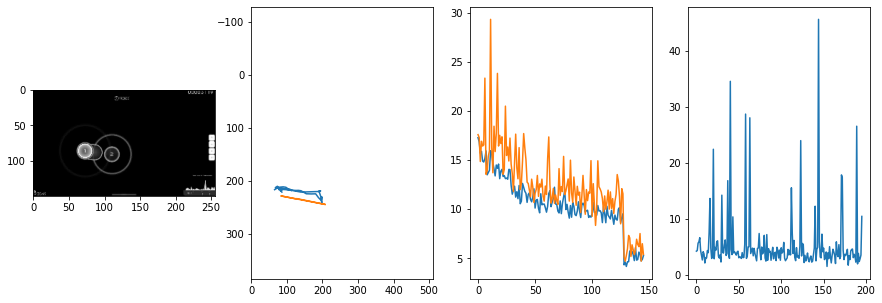


 152 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.56it/s  3.4584                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.574812912211126
outliers: 32
retrain: 4                 
val: 50/50 loss: 4.0428                                    
pred: 0.5845798850059509 0.7922937273979187
gt: 0.40397024154663086 0.312790185213089
(110, 54)


<Figure size 1080x360 with 0 Axes>

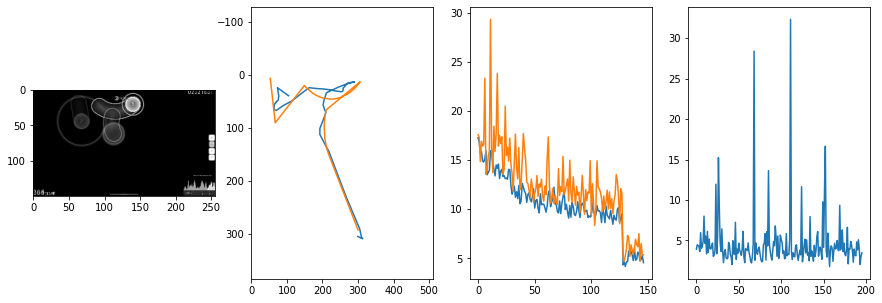


 153 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.66it/s  10.0901                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.757446757384709
outliers: 49
retrain: 4                 
val: 50/50 loss: 2.9902                                    
pred: 0.4142031669616699 0.8877776265144348
gt: 0.35967010259628296 0.9260633587837219
(103, 125)


<Figure size 1080x360 with 0 Axes>

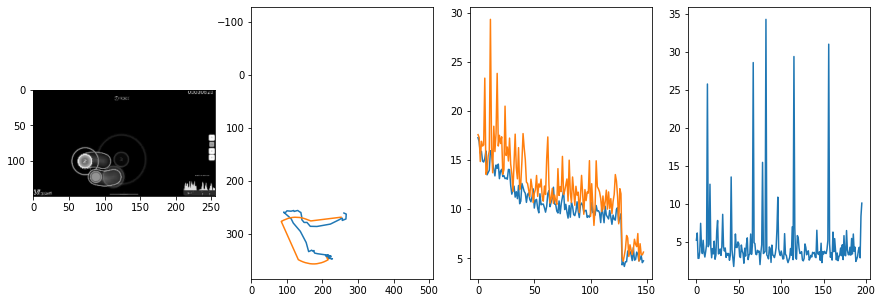


 154 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.56it/s  3.4130                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.631445484501975
outliers: 48
retrain: 4                 
val: 50/50 loss: 4.2277                                    
pred: 0.7394611239433289 0.5309414267539978
gt: 0.7793859243392944 0.4320099353790283
(168, 68)


<Figure size 1080x360 with 0 Axes>

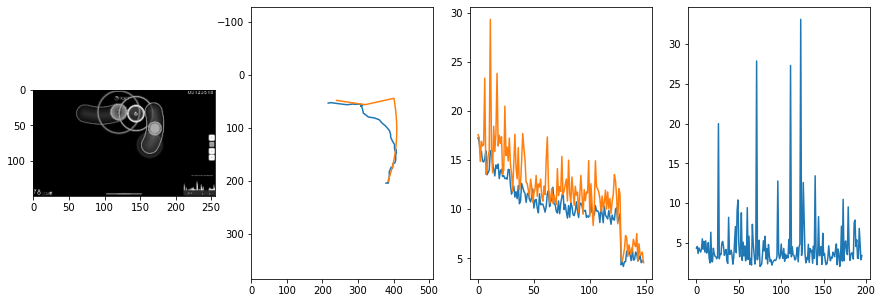


 155 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.57it/s  21.0201                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.266382273362607
outliers: 61
retrain: 4                 
val: 50/50 loss: 6.6326                                    
pred: 0.12038543075323105 0.690748929977417
gt: 0.18749886751174927 0.6067766547203064
(77, 88)


<Figure size 1080x360 with 0 Axes>

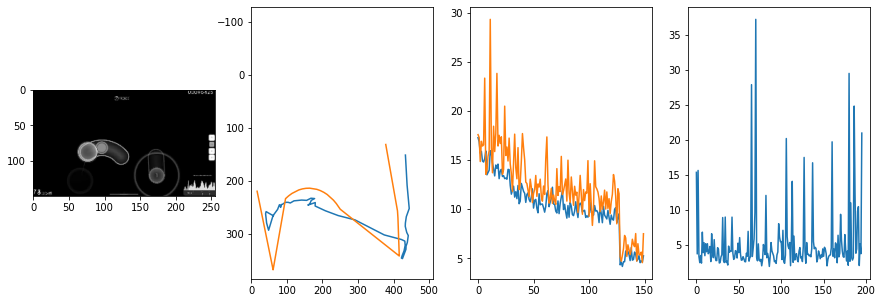


 156 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.73it/s  2.5490                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.590110084840229
outliers: 48
retrain: 4                 
val: 50/50 loss: 6.8093                                    
pred: 0.7072587013244629 0.12241744250059128
gt: 0.6804112195968628 0.12596498429775238
(153, 32)


<Figure size 1080x360 with 0 Axes>

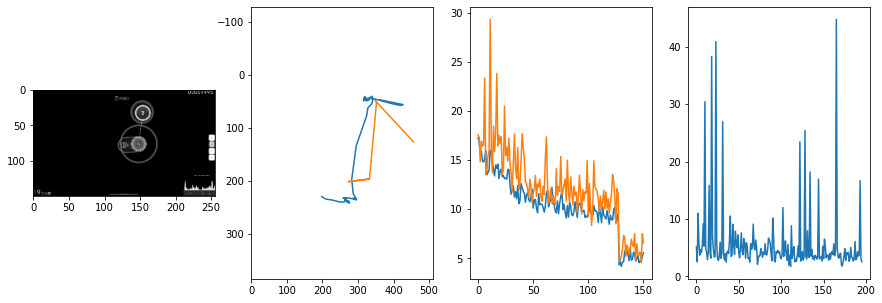


 157 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.49it/s  3.3983                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.0559069672409365
outliers: 38
retrain: 4                 
val: 50/50 loss: 17.5253                                   
pred: 0.44134995341300964 0.4311847686767578
gt: 0.5695851445198059 0.6105653643608093
(136, 89)


<Figure size 1080x360 with 0 Axes>

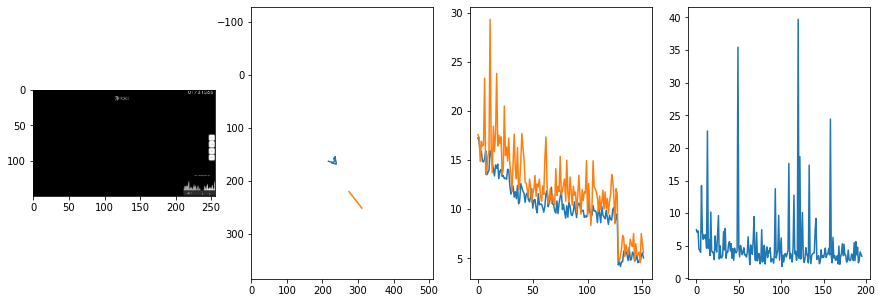


 158 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.87it/s  6.0863                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.4560041737799745
outliers: 45
retrain: 4                 
val: 50/50 loss: 4.0202                                    
pred: 0.5312172770500183 0.20659124851226807
gt: 0.5476117730140686 0.24168361723423004
(132, 46)


<Figure size 1080x360 with 0 Axes>

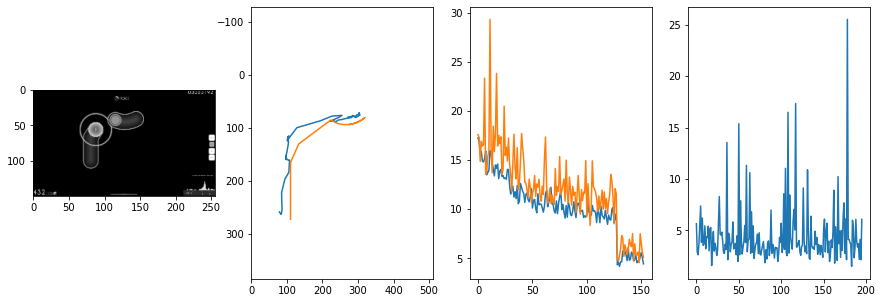


 159 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.59it/s  6.8439                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.538277191775186
outliers: 53
retrain: 4                 
val: 50/50 loss: 2.5149                                    
pred: 0.587078869342804 0.23491689562797546
gt: 0.511557936668396 0.3120434880256653
(127, 54)


<Figure size 1080x360 with 0 Axes>

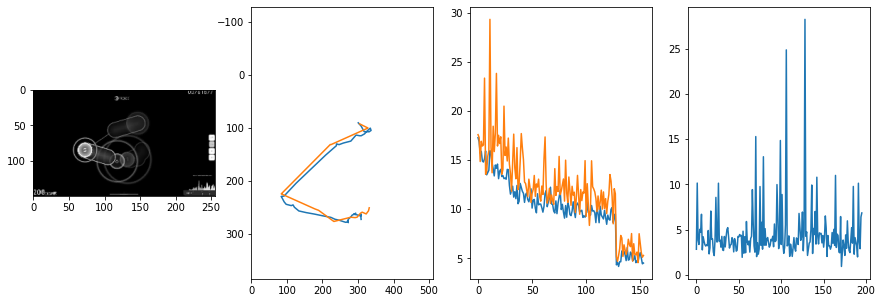


 160 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.82it/s  3.4181                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.932887844285187
outliers: 55
retrain: 4                 
val: 50/50 loss: 9.7316                                    
pred: 0.43013614416122437 0.6466755270957947
gt: 0.43531548976898193 0.4711407721042633
(115, 72)


<Figure size 1080x360 with 0 Axes>

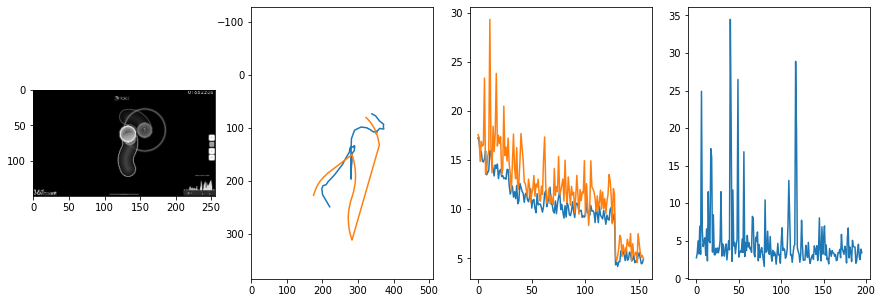


 161 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  3.2381                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.903748546327863
outliers: 46
retrain: 4                 
val: 50/50 loss: 11.1863                                   
pred: 0.5568415522575378 0.49151846766471863
gt: 0.5060483813285828 0.3700416386127472
(126, 61)


<Figure size 1080x360 with 0 Axes>

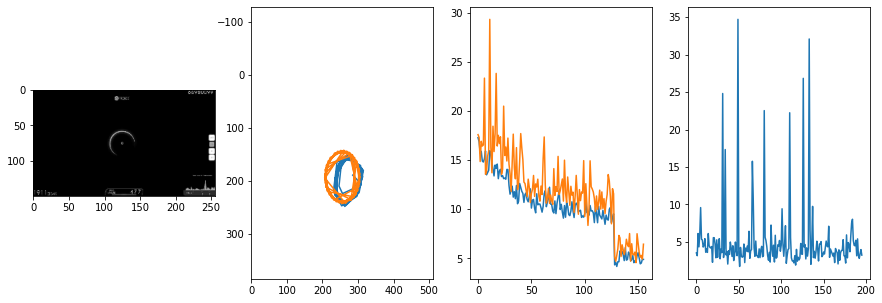


 162 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  3.0266                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.693139050383957
outliers: 42
retrain: 4                 
val: 50/50 loss: 6.0409                                    
pred: 0.3847618103027344 0.7894839644432068
gt: 0.7841090559959412 0.6883613467216492
(169, 98)


<Figure size 1080x360 with 0 Axes>

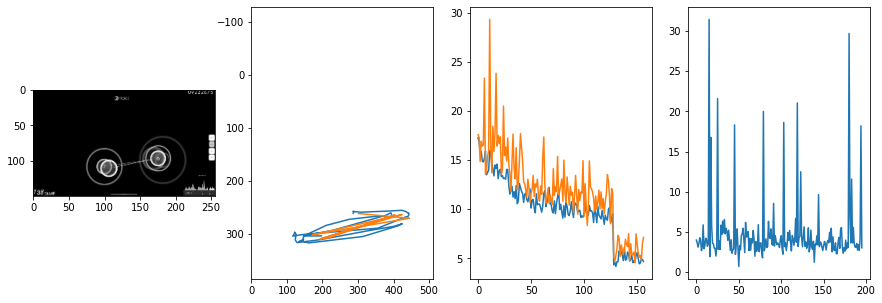


 163 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  13.01it/s  4.1295                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.379739485224899
outliers: 70
retrain: 4                 
val: 50/50 loss: 6.2286                                    
pred: 0.40958040952682495 0.2545224726200104
gt: 0.6093770861625671 0.44791439175605774
(142, 70)


<Figure size 1080x360 with 0 Axes>

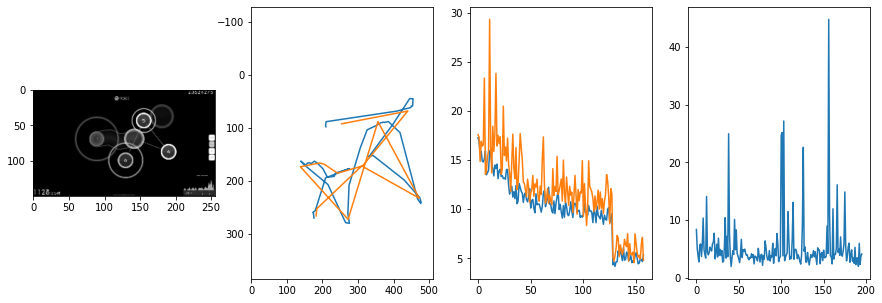


 164 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.62it/s  4.0061                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.150007321518295
outliers: 36
retrain: 4                 
val: 50/50 loss: 7.5051                                    
pred: 0.3564952611923218 0.4553077816963196
gt: 0.45507946610450745 0.8385400176048279
(118, 115)


<Figure size 1080x360 with 0 Axes>

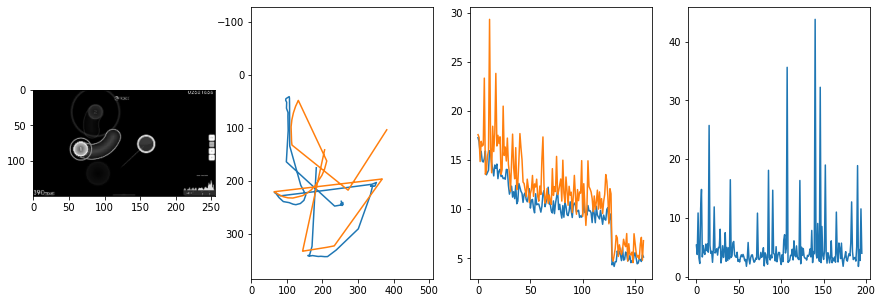


 165 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.16it/s  4.6550                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.263374675901568
outliers: 47
retrain: 4                 
val: 50/50 loss: 4.1952                                    
pred: 0.09755537658929825 0.5937429070472717
gt: 0.2502286434173584 0.5714431405067444
(86, 84)


<Figure size 1080x360 with 0 Axes>

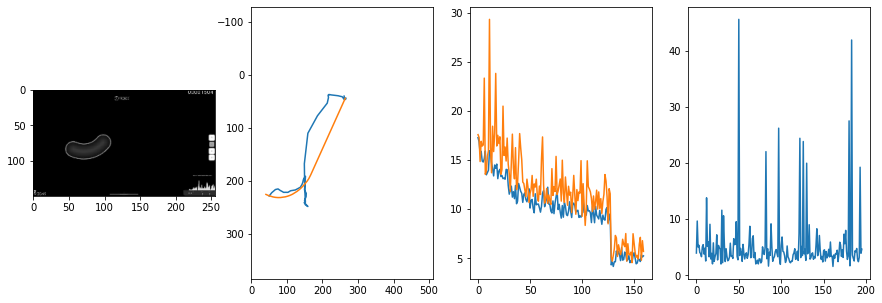


 166 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.16it/s  3.2613                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.240982312937172
outliers: 45
retrain: 4                 
val: 50/50 loss: 6.2266                                    
pred: 0.31289955973625183 0.7187215685844421
gt: 0.26696687936782837 0.8747574687004089
(89, 119)


<Figure size 1080x360 with 0 Axes>

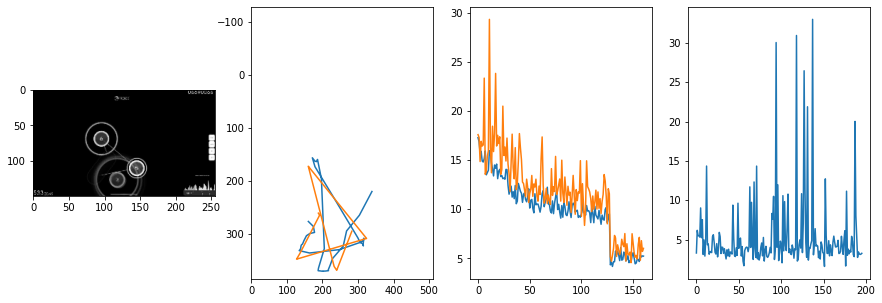


 167 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.14it/s  4.2120                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.316387843112556
outliers: 34
retrain: 4                 
val: 50/50 loss: 4.8953                                    
pred: 0.930941104888916 0.4608665406703949
gt: 0.8989406228065491 0.3029312193393707
(187, 53)


<Figure size 1080x360 with 0 Axes>

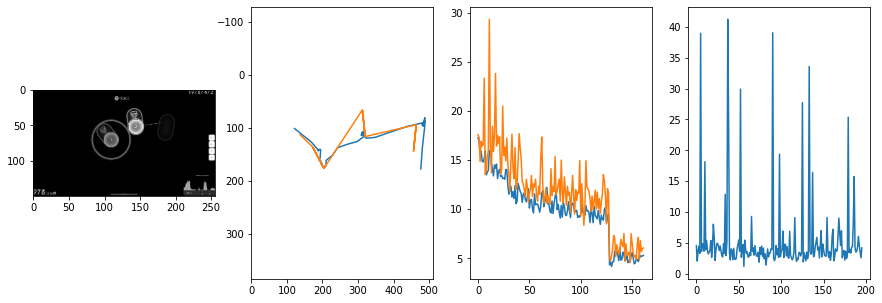


 168 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.72it/s  3.9405                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.05054693623465
outliers: 42
retrain: 4                 
val: 50/50 loss: 4.1911                                    
pred: 0.4951729476451874 0.46906161308288574
gt: 0.509765625 0.5963541865348816
(127, 87)


<Figure size 1080x360 with 0 Axes>

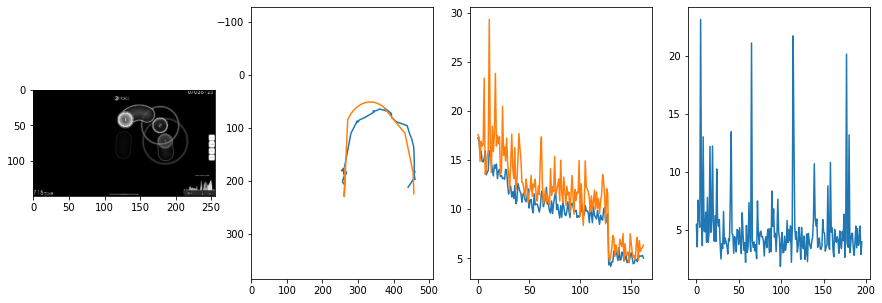


 169 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  13.04it/s  4.7329                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.744920582187419
outliers: 41
retrain: 4                 
val: 50/50 loss: 4.5731                                    
pred: 0.06376543641090393 0.9031800627708435
gt: 0.33825206756591797 0.7850335240364075
(100, 109)


<Figure size 1080x360 with 0 Axes>

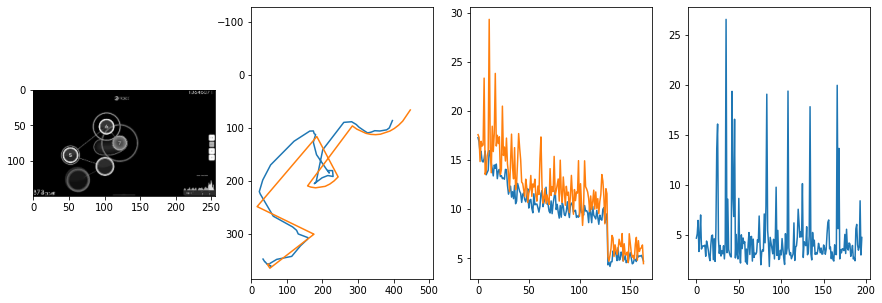


 170 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.94it/s  3.4063                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.494332412067725
outliers: 47
retrain: 4                 
val: 50/50 loss: 4.8423                                    
pred: 0.7189950942993164 0.4012598991394043
gt: 0.6268994212150574 0.5885704755783081
(145, 86)


<Figure size 1080x360 with 0 Axes>

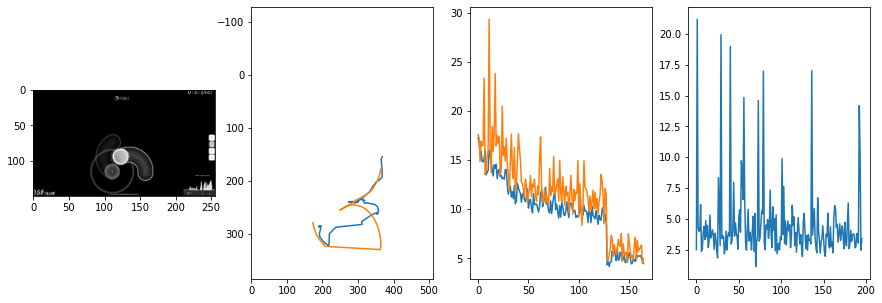


 171 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  13.05it/s  3.5666                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.525638555993839
outliers: 55
retrain: 4                 
val: 50/50 loss: 11.7153                                   
pred: 0.4894345700740814 0.43416187167167664
gt: 0.4807038903236389 0.36917948722839355
(122, 60)


<Figure size 1080x360 with 0 Axes>

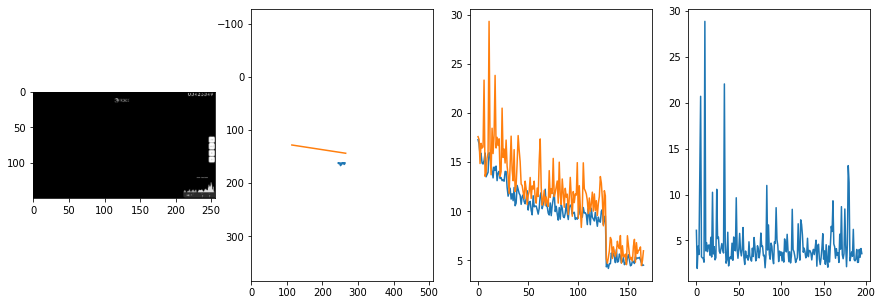


 172 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.99it/s  4.1284                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.401391672236579
outliers: 49
retrain: 4                 
val: 50/50 loss: 4.6914                                    
pred: 0.8541707992553711 0.19266271591186523
gt: 0.8385719060897827 0.15547658503055573
(178, 36)


<Figure size 1080x360 with 0 Axes>

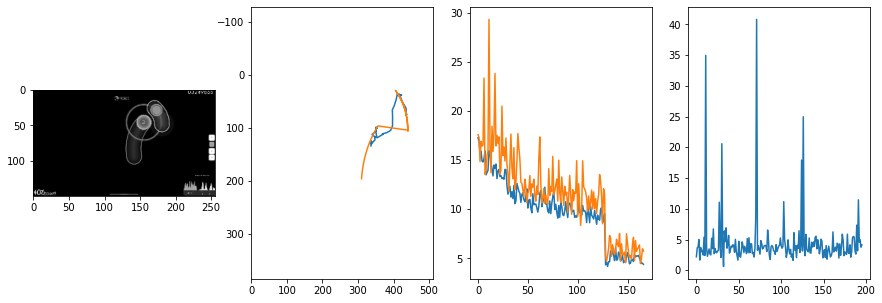


 173 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.21it/s  2.1487                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.614488990939393
outliers: 58
retrain: 4                 
val: 50/50 loss: 16.2871                                   
pred: 0.32210302352905273 0.33478376269340515
gt: 0.5000053644180298 0.2083493322134018
(125, 42)


<Figure size 1080x360 with 0 Axes>

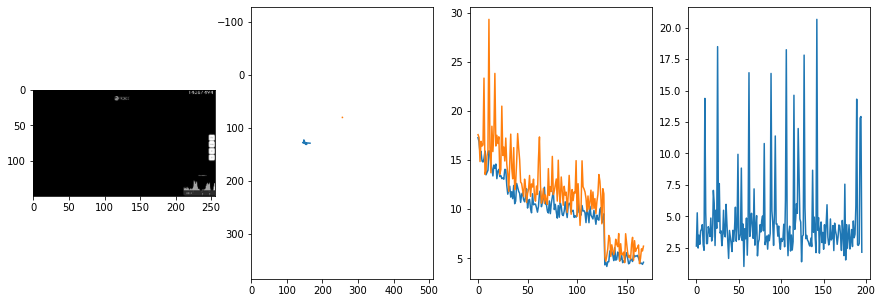


 174 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.22it/s  3.2046                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.693191905410922
outliers: 51
retrain: 4                 
val: 50/50 loss: 5.6009                                    
pred: 0.8346347212791443 0.6872596740722656
gt: 0.39967265725135803 0.41435810923576355
(109, 66)


<Figure size 1080x360 with 0 Axes>

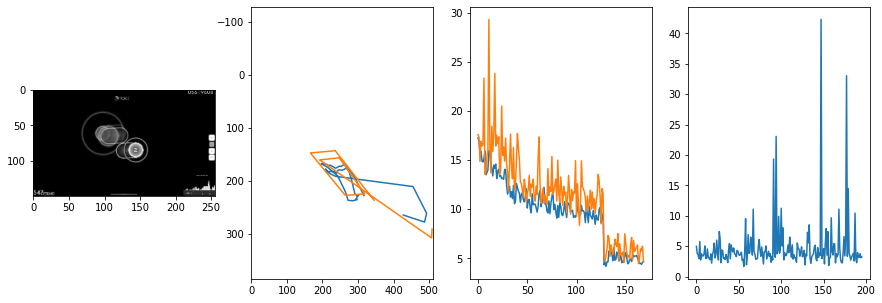


 175 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  13.02it/s  4.0597                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.559714752800611
outliers: 43
retrain: 4                 
val: 50/50 loss: 3.9048                                    
pred: 0.4756665527820587 0.263532429933548
gt: 0.38671889901161194 0.6796866059303284
(107, 97)


<Figure size 1080x360 with 0 Axes>

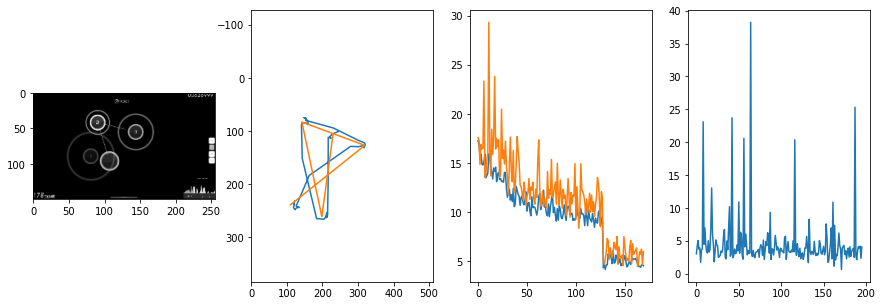


 176 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.90it/s  3.1884                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.2117486555053265
outliers: 40
retrain: 4                 
val: 50/50 loss: 4.1455                                    
pred: 0.30659377574920654 0.21920108795166016
gt: 0.2480469048023224 0.3828125298023224
(86, 62)


<Figure size 1080x360 with 0 Axes>

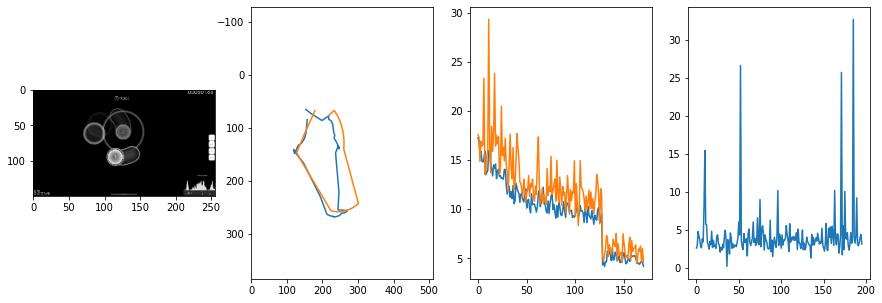


 177 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.94it/s  4.3197                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.152715737418252
outliers: 57
retrain: 4                 
val: 50/50 loss: 4.5252                                    
pred: 0.6266748905181885 0.1620716154575348
gt: 0.732421875 0.5885416865348816
(161, 86)


<Figure size 1080x360 with 0 Axes>

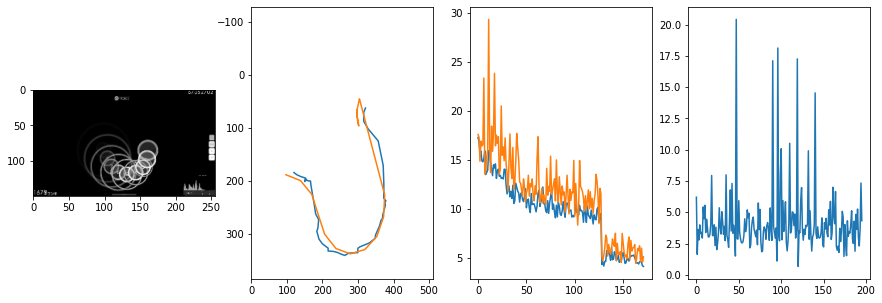


 178 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.18it/s  3.3136                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.175847917186971
outliers: 78
retrain: 4                 
val: 50/50 loss: 3.9394                                    
pred: 0.7091726064682007 0.4092477560043335
gt: 0.4531259536743164 0.22916710376739502
(118, 44)


<Figure size 1080x360 with 0 Axes>

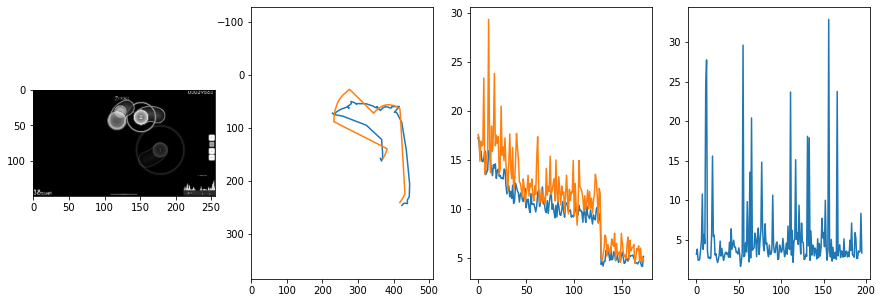


 179 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  13.05it/s  5.7113                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.383257742438998
outliers: 51
retrain: 4                 
val: 50/50 loss: 5.8597                                    
pred: 0.9228206872940063 0.4221356213092804
gt: 0.9531249403953552 0.6458335518836975
(195, 93)


<Figure size 1080x360 with 0 Axes>

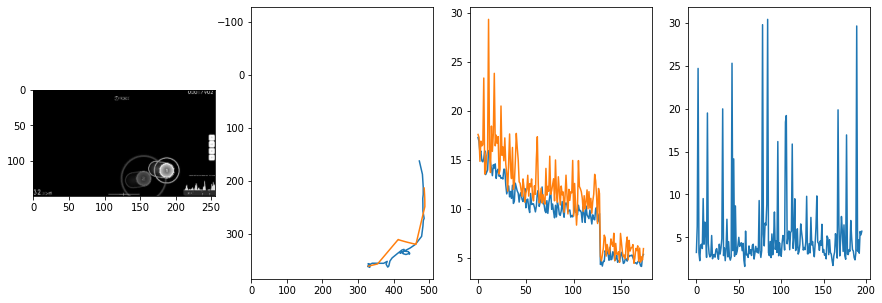


 180 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.10it/s  3.8177                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.8128920903011245
outliers: 36
retrain: 4                 
val: 50/50 loss: 3.2942                                    
pred: 0.3742498457431793 0.49201062321662903
gt: 0.29883572459220886 0.4947812259197235
(94, 75)


<Figure size 1080x360 with 0 Axes>

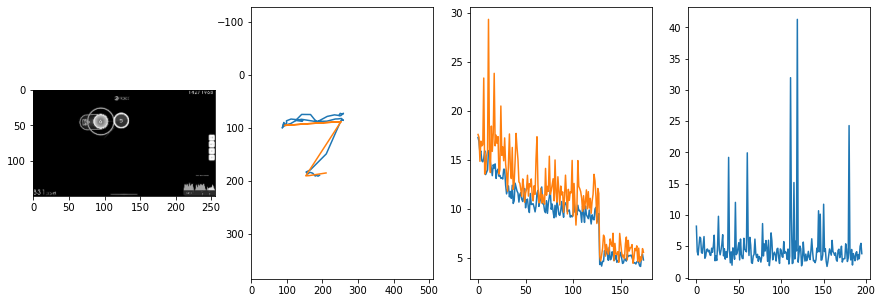


 181 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.96it/s  4.5659                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.462070497931267
outliers: 46
retrain: 4                 
val: 50/50 loss: 2.4884                                    
pred: 0.6279515027999878 0.2529427409172058
gt: 0.6320114135742188 0.2718280851840973
(146, 49)


<Figure size 1080x360 with 0 Axes>

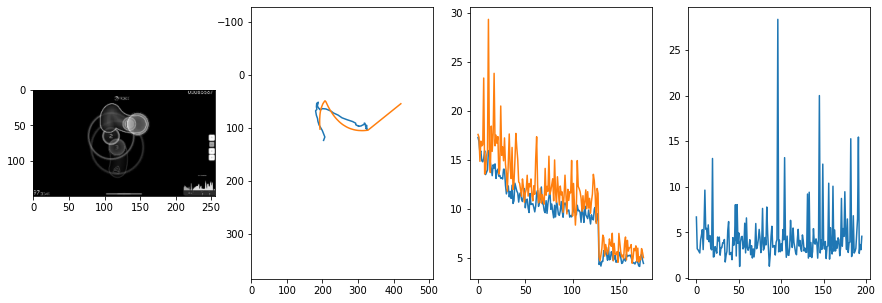


 182 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.13it/s  2.6194                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.589236497270818
outliers: 63
retrain: 4                 
val: 50/50 loss: 2.8444                                    
pred: 0.5438034534454346 0.17330117523670197
gt: 0.6559199094772339 0.5374858975410461
(149, 80)


<Figure size 1080x360 with 0 Axes>

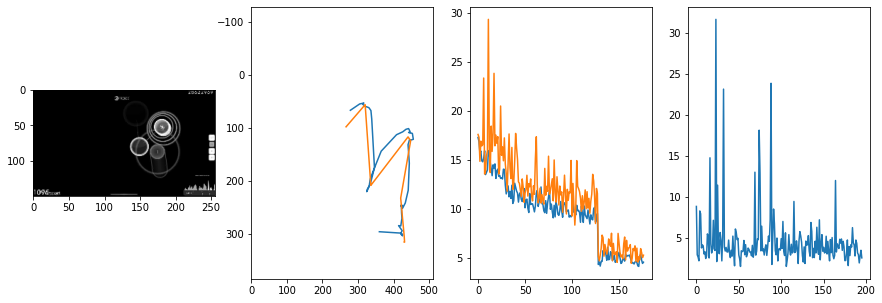


 183 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.97it/s  2.4064                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.640915476545995
outliers: 48
retrain: 4                 
val: 50/50 loss: 3.8020                                    
pred: 0.7598945498466492 0.8447048664093018
gt: 0.646484375 0.9036458134651184
(148, 123)


<Figure size 1080x360 with 0 Axes>

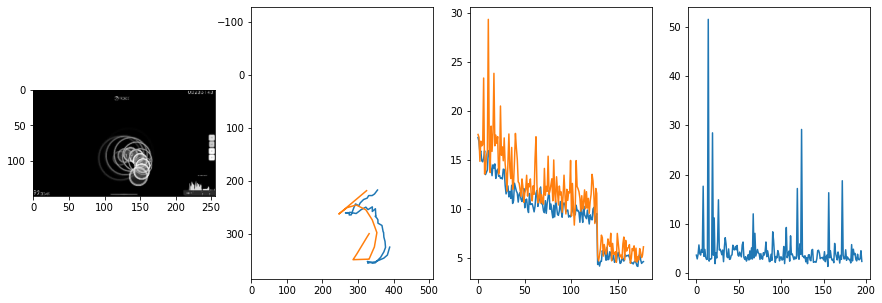


 184 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.23it/s  2.6896                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.695890572302195
outliers: 53
retrain: 4                 
val: 50/50 loss: 4.9649                                    
pred: 0.4103432595729828 0.6890543699264526
gt: 0.396484375 0.7473958134651184
(109, 104)


<Figure size 1080x360 with 0 Axes>

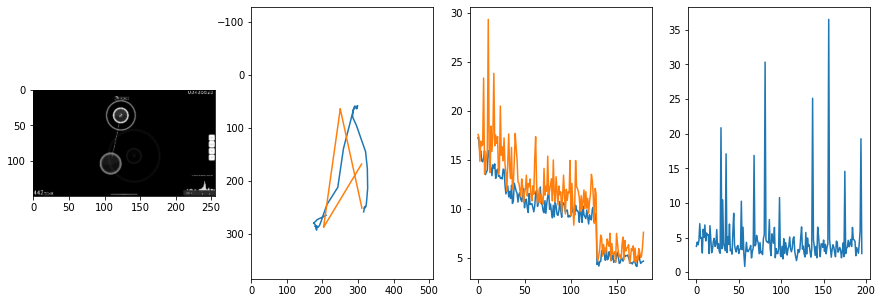


 185 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.91it/s  5.9212                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.5889111124739355
outliers: 59
retrain: 4                 
val: 50/50 loss: 6.8445                                    
pred: 0.7286567687988281 0.16335198283195496
gt: 0.9179692268371582 0.09375232458114624
(190, 28)


<Figure size 1080x360 with 0 Axes>

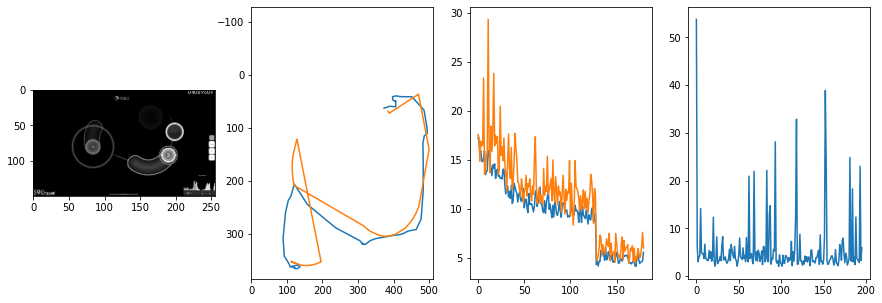


 186 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.94it/s  2.7308                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.497970114557111
outliers: 26
retrain: 4                 
val: 50/50 loss: 3.4470                                    
pred: 0.47326430678367615 0.8070859909057617
gt: 0.6035177707672119 0.8255243301391602
(141, 114)


<Figure size 1080x360 with 0 Axes>

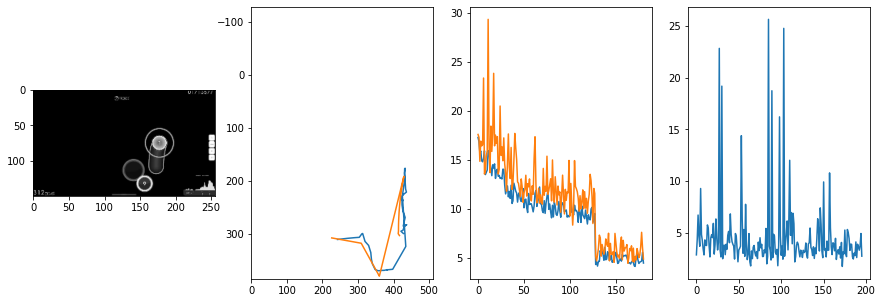


 187 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  13.02it/s  5.9861                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.392204843765619
outliers: 41
retrain: 4                 
val: 50/50 loss: 6.1000                                    
pred: 0.38468024134635925 0.26106953620910645
gt: 0.3975057601928711 0.29497721791267395
(109, 52)


<Figure size 1080x360 with 0 Axes>

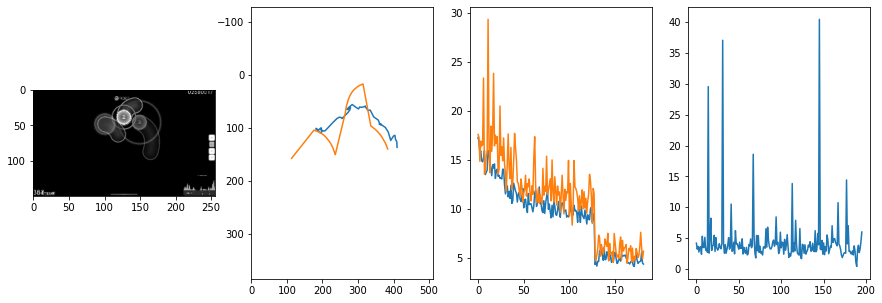


 188 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.22it/s  5.2412                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.6478226245666034
outliers: 52
retrain: 4                 
val: 50/50 loss: 5.7961                                    
pred: 0.5367506146430969 0.7153380513191223
gt: 0.5434117913246155 0.7071208953857422
(132, 100)


<Figure size 1080x360 with 0 Axes>

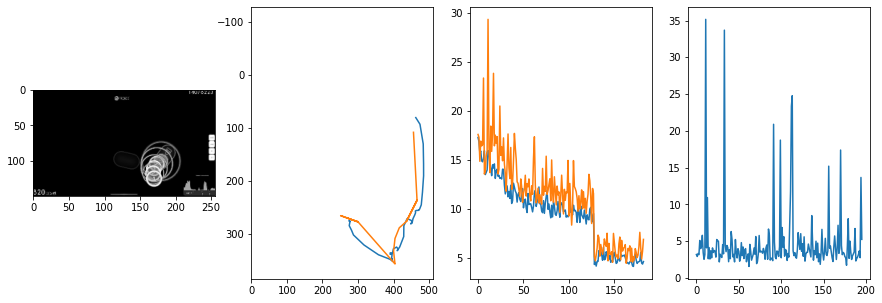


 189 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.10it/s  4.0753                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.529824610875577
outliers: 49
retrain: 4                 
val: 50/50 loss: 2.4409                                    
pred: 0.33349236845970154 0.6820815205574036
gt: 0.34375035762786865 0.4218710958957672
(101, 67)


<Figure size 1080x360 with 0 Axes>

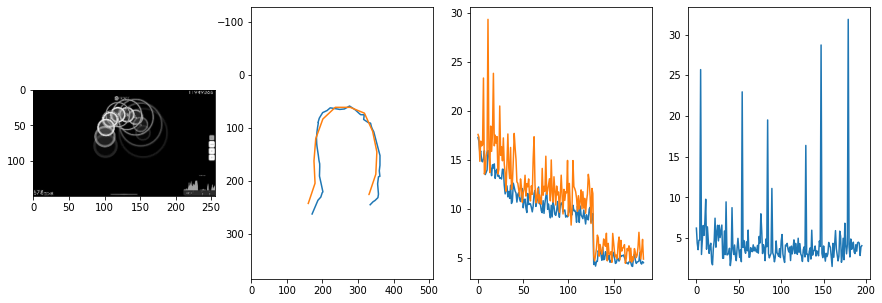


 190 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.82it/s  3.3978                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.471150680464142
outliers: 53
retrain: 4                 
val: 50/50 loss: 2.7303                                    
pred: 0.5430356860160828 0.9117241501808167
gt: 0.5312511324882507 0.9557281136512756
(130, 129)


<Figure size 1080x360 with 0 Axes>

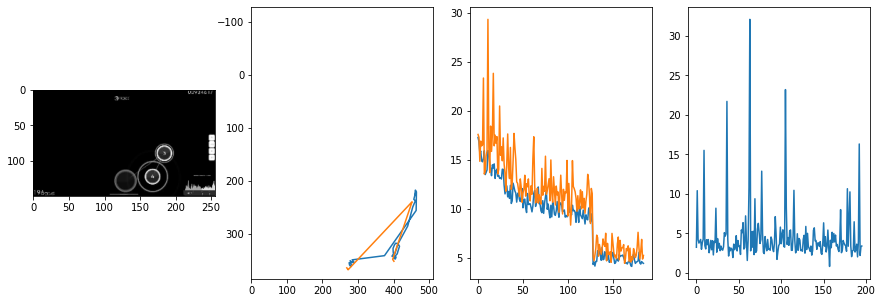


 191 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  3.7126                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.153603597563141
outliers: 54
retrain: 4                 
val: 50/50 loss: 4.3251                                    
pred: 0.09472071379423141 0.23891708254814148
gt: 0.002634924603626132 0.3697028160095215
(48, 60)


<Figure size 1080x360 with 0 Axes>

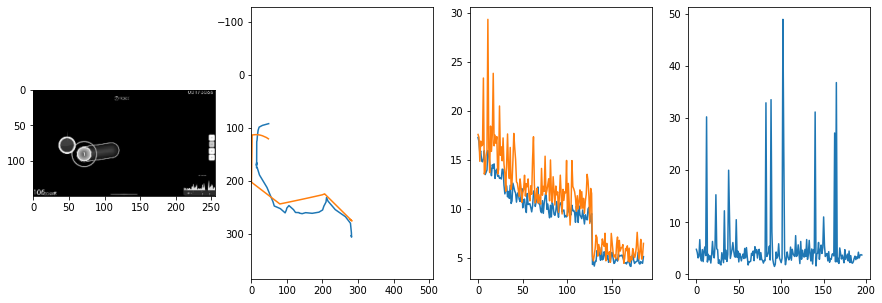


 192 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  1.7502                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.986681176083429
outliers: 41
retrain: 4                 
val: 50/50 loss: 4.3656                                    
pred: 0.7182559370994568 0.8569650650024414
gt: 0.42346248030662537 0.644175112247467
(113, 92)


<Figure size 1080x360 with 0 Axes>

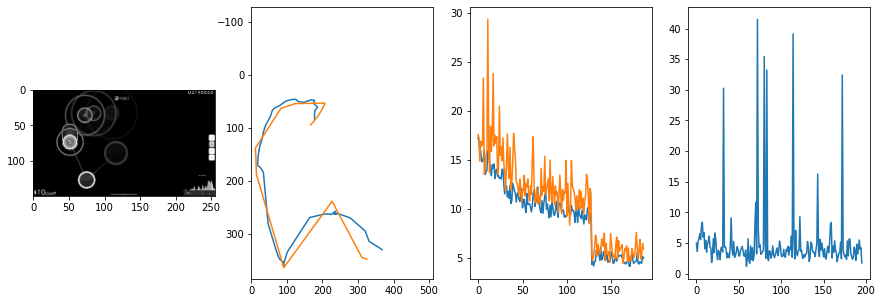


 193 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  3.2924                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.75542537533507
outliers: 39
retrain: 4                 
val: 50/50 loss: 3.6556                                    
pred: 0.721393346786499 0.7360502481460571
gt: 0.6461890935897827 0.8434587121009827
(148, 116)


<Figure size 1080x360 with 0 Axes>

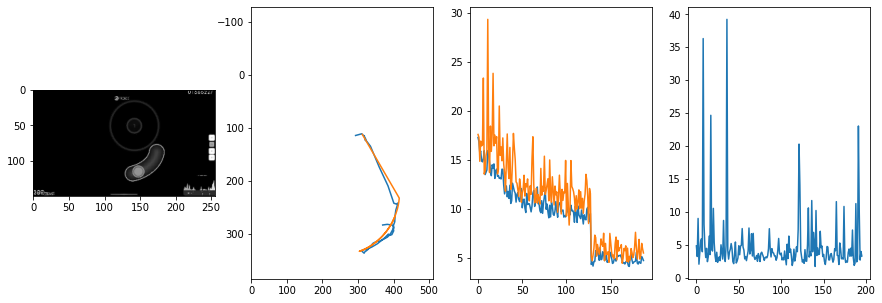


 194 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  4.6129                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.015680693850225
outliers: 44
retrain: 4                 
val: 50/50 loss: 28.5325                                   
pred: 0.3071601390838623 0.3852342963218689
gt: 0.49852362275123596 0.5004631876945496
(125, 76)


<Figure size 1080x360 with 0 Axes>

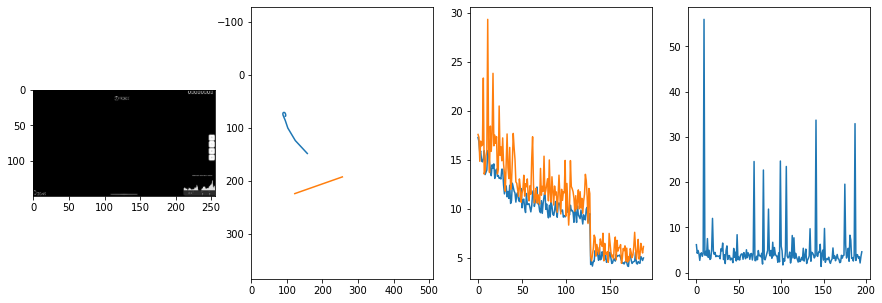


 195 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.82it/s  6.2243                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.006075684513364
outliers: 43
retrain: 4                 
val: 50/50 loss: 3.9291                                    
pred: 0.7786463499069214 0.23156778514385223
gt: 0.5084999799728394 0.38893750309944153
(126, 63)


<Figure size 1080x360 with 0 Axes>

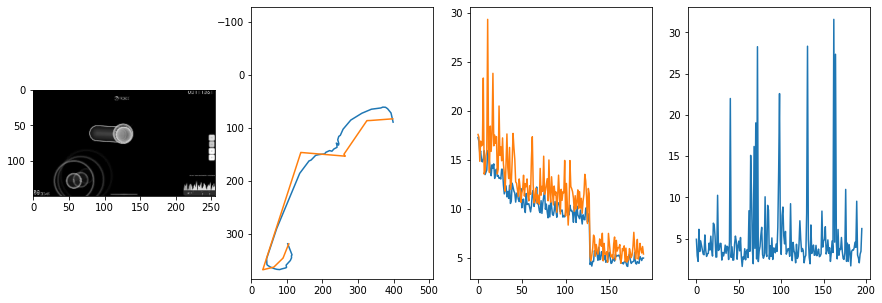


 196 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.74it/s  3.6986                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.529208020896328
outliers: 35
retrain: 4                 
val: 50/50 loss: 5.4206                                    
pred: 0.901240885257721 0.1501660943031311
gt: 0.6842865347862244 0.5237583518028259
(154, 78)


<Figure size 1080x360 with 0 Axes>

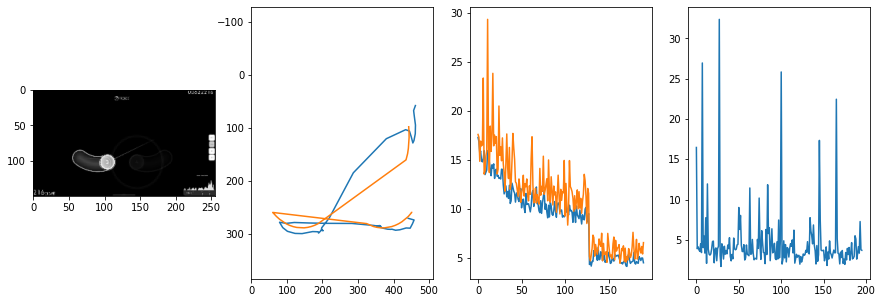


 197 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  1.2673                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.063306223373024
outliers: 49
retrain: 4                 
val: 50/50 loss: 5.8079                                    
pred: 0.7367205023765564 0.3243889808654785
gt: 0.8566150069236755 0.6163260340690613
(180, 89)


<Figure size 1080x360 with 0 Axes>

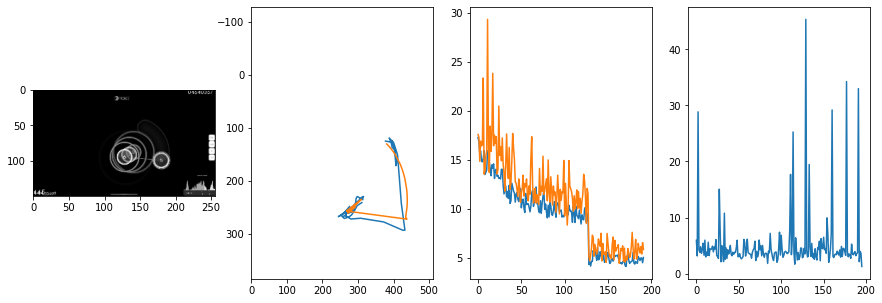


 198 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  2.7455                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.180721337089733
outliers: 49
retrain: 4                 
val: 50/50 loss: 5.2101                                    
pred: 0.41700997948646545 0.3374248147010803
gt: 0.1719140112400055 0.17679812014102936
(74, 38)


<Figure size 1080x360 with 0 Axes>

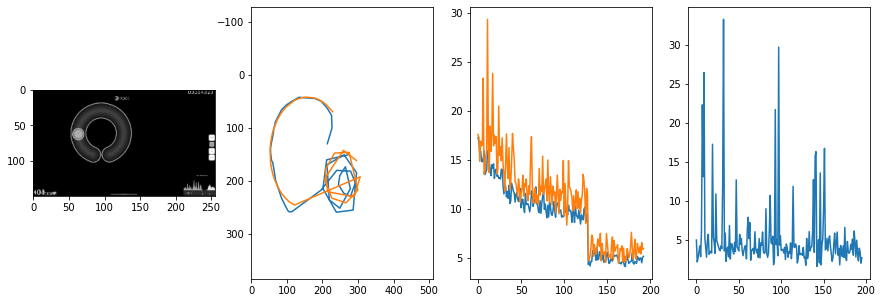


 199 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.77it/s  2.4979                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.712594647796786
outliers: 42
retrain: 4                 
val: 50/50 loss: 26.4023                                   
pred: 0.5242690443992615 0.5242308974266052
gt: 0.16528759896755219 0.18863964080810547
(73, 39)


<Figure size 1080x360 with 0 Axes>

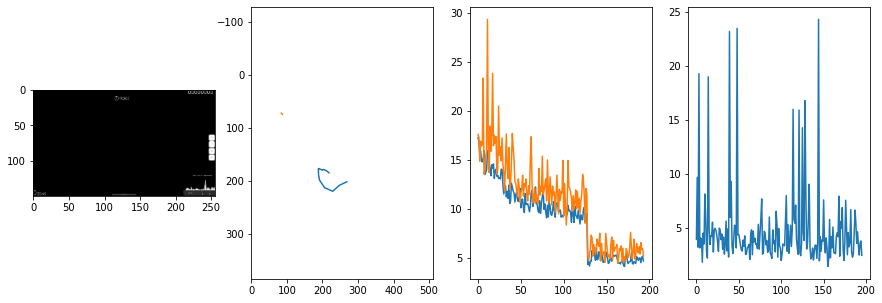


 200 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.87it/s  4.5938                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.2781273515857
outliers: 34
retrain: 4                 
val: 50/50 loss: 3.0197                                    
pred: 0.5098174214363098 0.35830745100975037
gt: 0.402689129114151 0.5956081748008728
(110, 87)


<Figure size 1080x360 with 0 Axes>

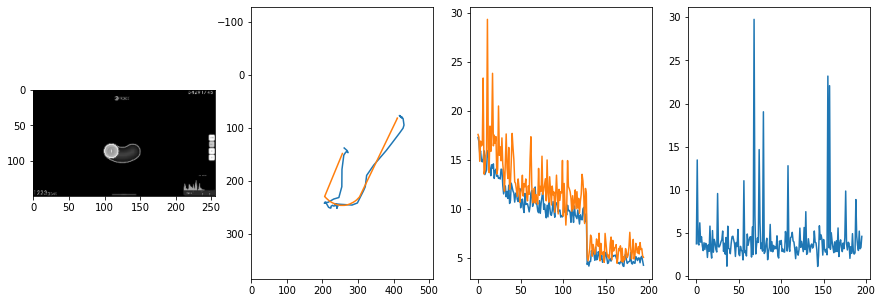


 201 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.79it/s  3.8854                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.240613861959808
outliers: 52
retrain: 4                 
val: 50/50 loss: 16.8748                                   
pred: 0.3920598328113556 0.10662057995796204
gt: 0.20320817828178406 0.2681466042995453
(79, 49)


<Figure size 1080x360 with 0 Axes>

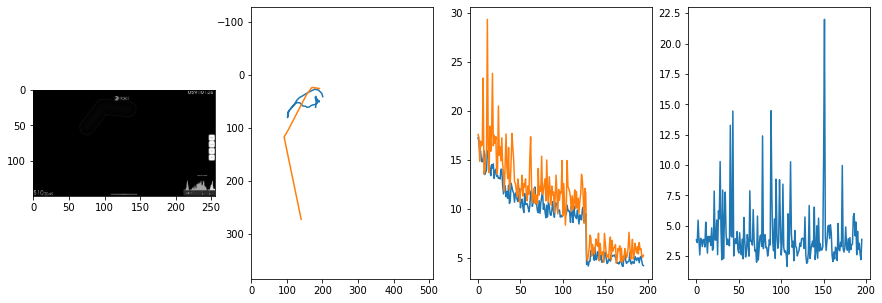


 202 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.26it/s  2.8159                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.499334441155804
outliers: 50
retrain: 4                 
val: 50/50 loss: 6.4622                                    
pred: 0.7102634310722351 0.8319571614265442
gt: 0.5068249702453613 0.370629221200943
(126, 61)


<Figure size 1080x360 with 0 Axes>

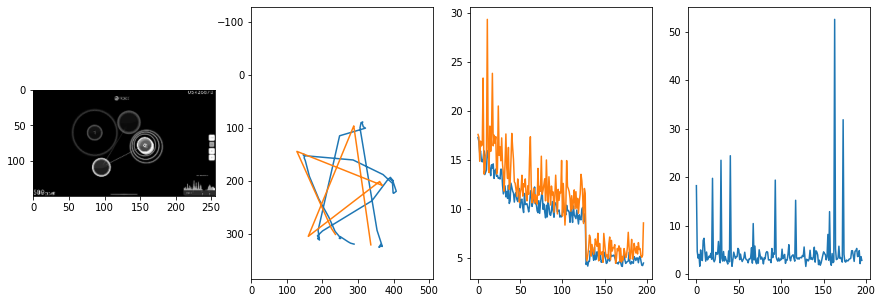


 203 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.18it/s  4.9563                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.229980889631777
outliers: 64
retrain: 4                 
val: 50/50 loss: 7.8969                                    
pred: 0.3760139048099518 0.5926434397697449
gt: 0.3261720836162567 0.8827771544456482
(98, 120)


<Figure size 1080x360 with 0 Axes>

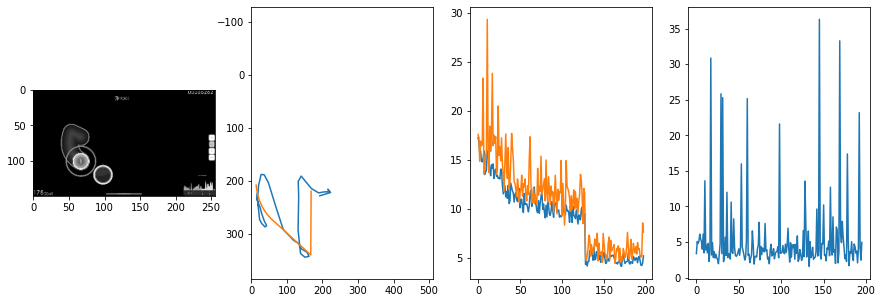


 204 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  4.1659                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.546956925367822
outliers: 44
retrain: 4                 
val: 50/50 loss: 5.8925                                    
pred: 0.38368016481399536 0.8893944025039673
gt: 0.5781227946281433 0.8958333134651184
(137, 122)


<Figure size 1080x360 with 0 Axes>

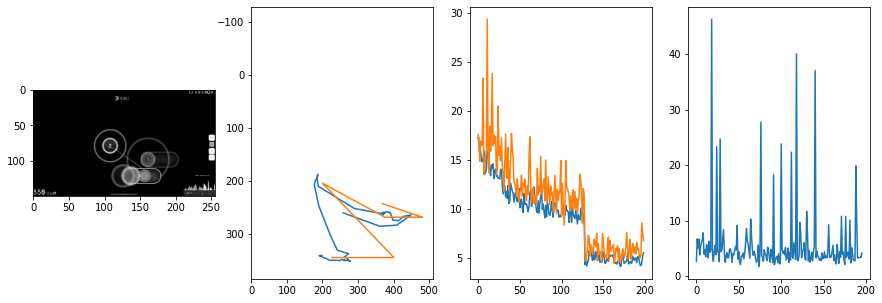


 205 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  3.0231                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.94790191613898
outliers: 28
retrain: 4                 
val: 50/50 loss: 6.0662                                    
pred: 0.6989020705223083 0.5297553539276123
gt: 0.8217347860336304 0.40242576599121094
(175, 64)


<Figure size 1080x360 with 0 Axes>

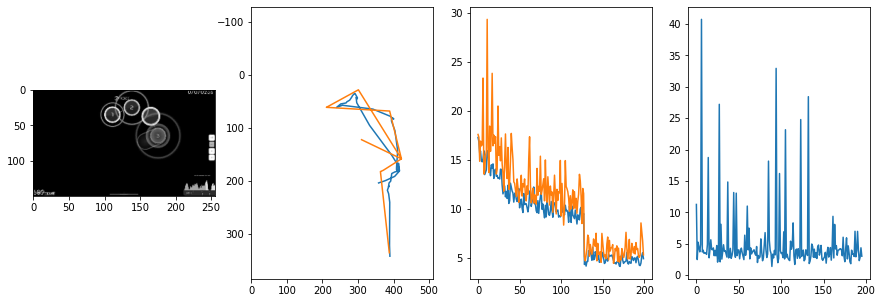


 206 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.14it/s  8.0028                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.144170464301596
outliers: 48
retrain: 4                 
val: 50/50 loss: 6.0942                                    
pred: 0.0669158473610878 0.4418969750404358
gt: 0.11684383451938629 0.18611027300357819
(66, 39)


<Figure size 1080x360 with 0 Axes>

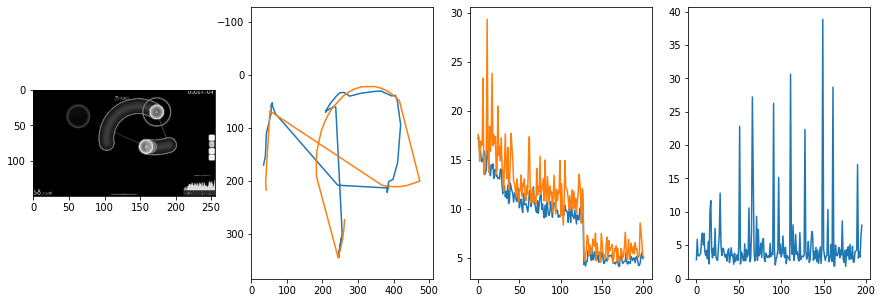


 207 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  4.4077                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.072533484016146
outliers: 36
retrain: 4                 
val: 50/50 loss: 6.7779                                    
pred: 0.24801906943321228 0.6898710131645203
gt: 0.5881275534629822 0.883185625076294
(139, 120)


<Figure size 1080x360 with 0 Axes>

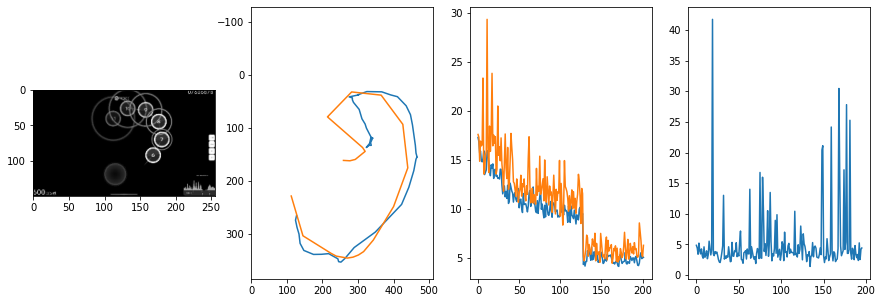


 208 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.85it/s  3.9331                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.0586638304652
outliers: 41
retrain: 4                 
val: 50/50 loss: 4.1544                                    
pred: 0.7590382695198059 0.8360999822616577
gt: 0.632793664932251 0.8177151083946228
(146, 113)


<Figure size 1080x360 with 0 Axes>

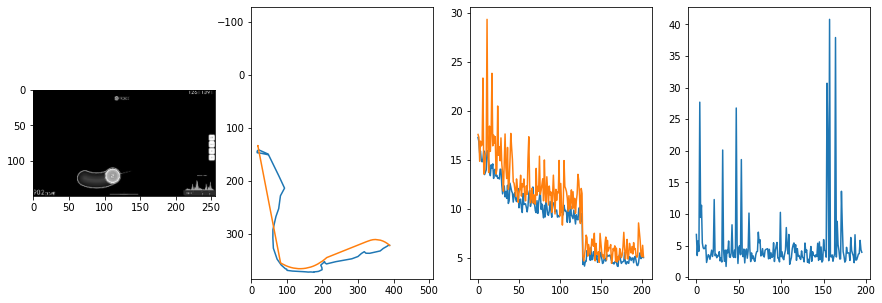


 209 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  4.7663                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.828043878686671
outliers: 37
retrain: 4                 
val: 50/50 loss: 3.6577                                    
pred: 0.7795034646987915 0.21806880831718445
gt: 0.7442627549171448 0.5739069581031799
(163, 84)


<Figure size 1080x360 with 0 Axes>

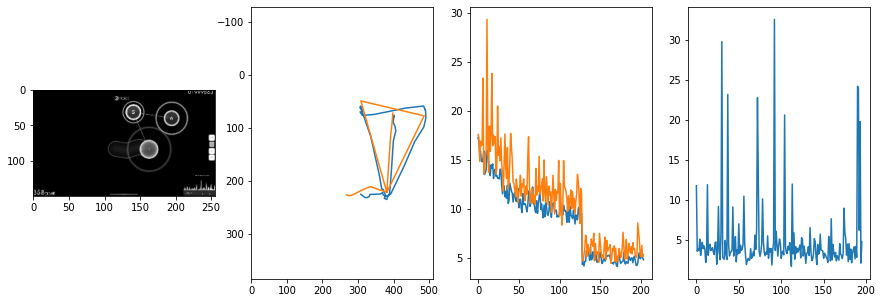


 210 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.87it/s  1.5902                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.123286296518481
outliers: 56
retrain: 4                 
val: 50/50 loss: 17.1656                                   
pred: 0.44084790349006653 0.6615946888923645
gt: 0.17382827401161194 0.18750013411045074
(74, 39)


<Figure size 1080x360 with 0 Axes>

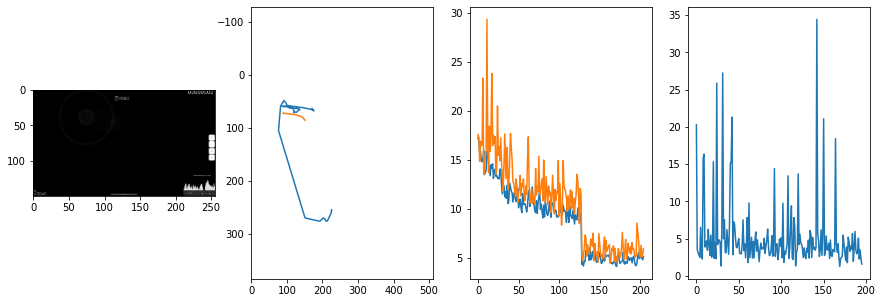


 211 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.78it/s  3.7053                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.395703868598354
outliers: 31
retrain: 4                 
val: 50/50 loss: 19.0201                                   
pred: 0.2378898710012436 0.27916592359542847
gt: 0.4999984800815582 0.4999988377094269
(125, 76)


<Figure size 1080x360 with 0 Axes>

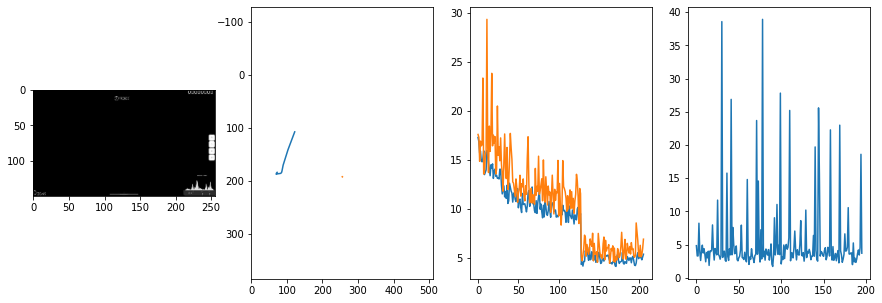


 212 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  3.1415                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.909097324828712
outliers: 51
retrain: 4                 
val: 50/50 loss: 3.4923                                    
pred: 0.7176892757415771 0.7723945379257202
gt: 0.6738281846046448 0.6093755960464478
(152, 88)


<Figure size 1080x360 with 0 Axes>

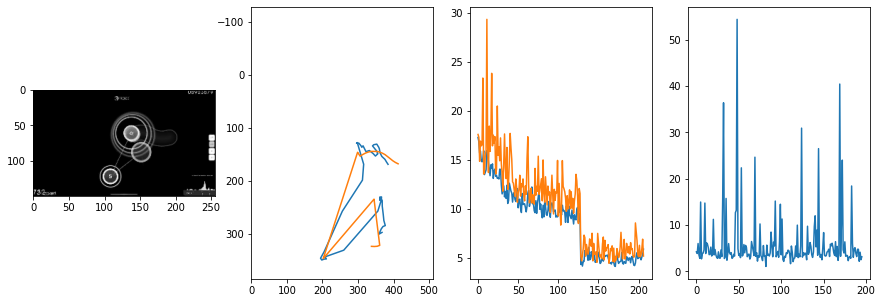


 213 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  6.0459                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.991359031930262
outliers: 28
retrain: 4                 
val: 50/50 loss: 3.4878                                    
pred: 0.5828036069869995 0.34664100408554077
gt: 0.5655990242958069 0.291296124458313
(135, 51)


<Figure size 1080x360 with 0 Axes>

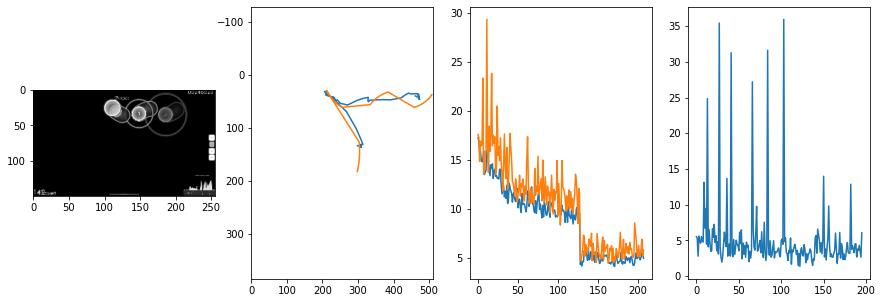


 214 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.68it/s  2.3306                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.482444195723047
outliers: 40
retrain: 4                 
val: 50/50 loss: 25.7638                                   
pred: 0.5579705238342285 0.6503469347953796
gt: 0.5 0.1400003880262375
(125, 34)


<Figure size 1080x360 with 0 Axes>

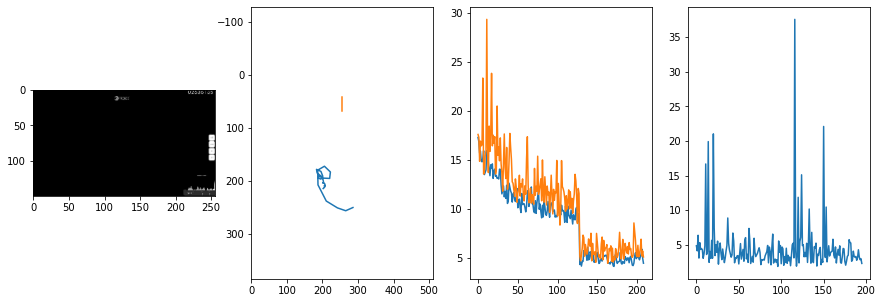


 215 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  4.8844                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.975918859851603
outliers: 52
retrain: 4                 
val: 50/50 loss: 4.3715                                    
pred: 0.22461679577827454 0.5788715481758118
gt: 0.2273080050945282 0.7338869571685791
(83, 103)


<Figure size 1080x360 with 0 Axes>

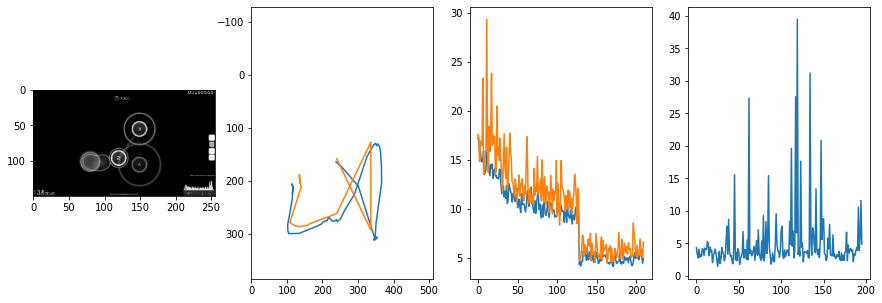


 216 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  3.4989                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.083507123042126
outliers: 42
retrain: 4                 
val: 50/50 loss: 6.1507                                    
pred: 0.19925706088542938 0.6969309449195862
gt: 0.7109375 0.3984375
(158, 64)


<Figure size 1080x360 with 0 Axes>

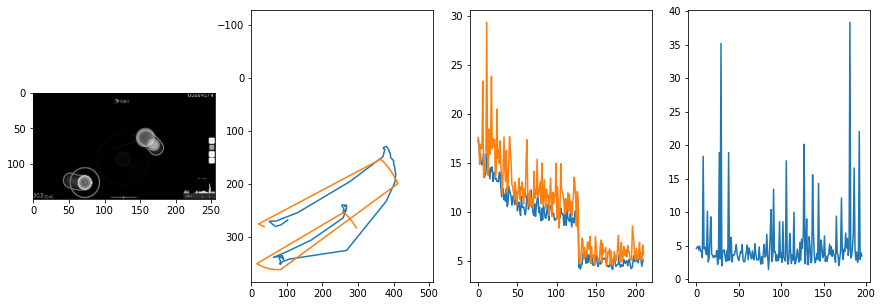


 217 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  3.3934                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.277750887432877
outliers: 38
retrain: 4                 
val: 50/50 loss: 8.8630                                    
pred: 0.47951173782348633 0.4754449427127838
gt: 0.404511034488678 0.47272029519081116
(110, 72)


<Figure size 1080x360 with 0 Axes>

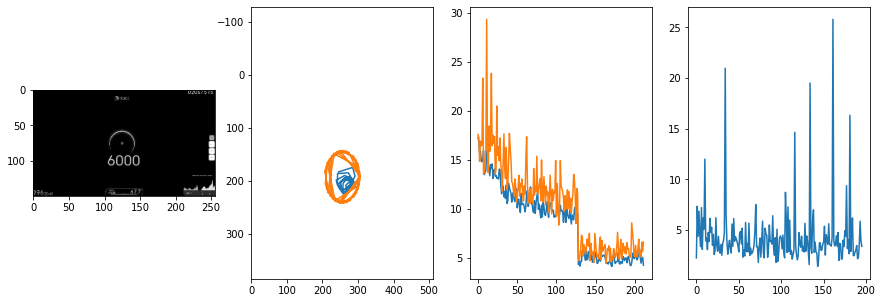


 218 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  3.5928                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.363367590977221
outliers: 54
retrain: 4                 
val: 50/50 loss: 6.5155                                    
pred: 0.49053168296813965 0.20951180160045624
gt: 0.578125 0.1380208283662796
(137, 34)


<Figure size 1080x360 with 0 Axes>

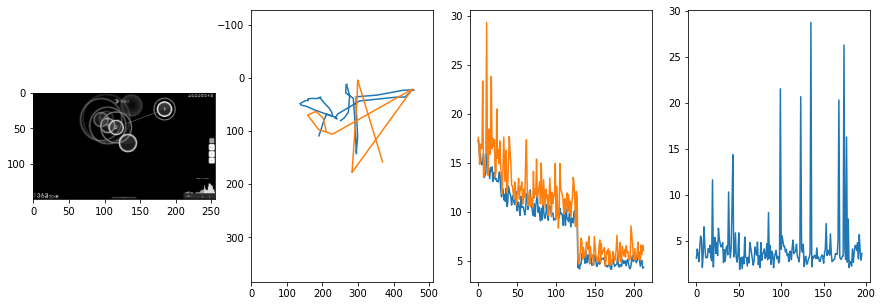


 219 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  3.6264                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.003222584724426
outliers: 41
retrain: 4                 
val: 50/50 loss: 5.0027                                    
pred: 0.5070940852165222 0.8098859190940857
gt: 0.5051068067550659 0.7650585770606995
(126, 106)


<Figure size 1080x360 with 0 Axes>

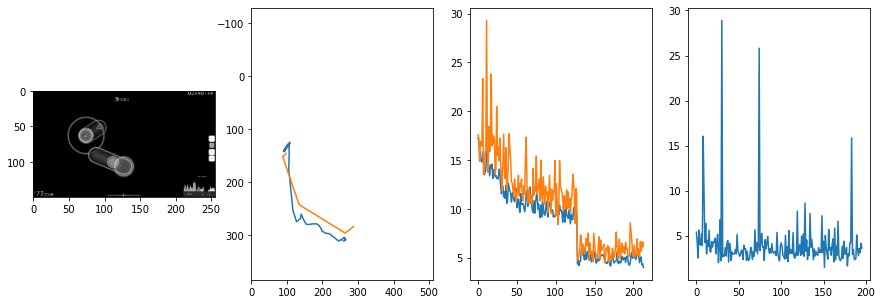


 220 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  3.0673                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.8824743269657604
outliers: 71
retrain: 4                 
val: 50/50 loss: 4.8467                                    
pred: 0.7301120758056641 0.4262012839317322
gt: 0.41894009709358215 0.5726150870323181
(112, 84)


<Figure size 1080x360 with 0 Axes>

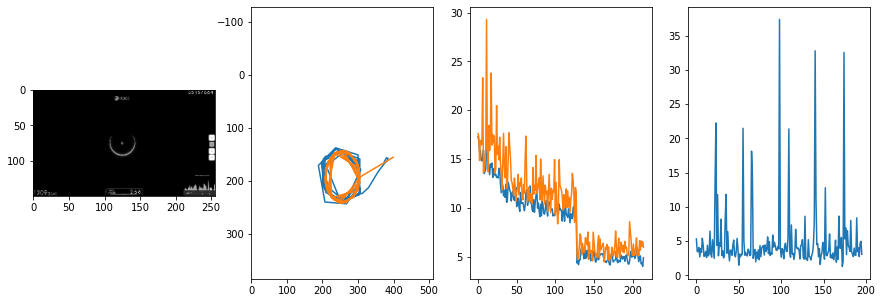


 221 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.13it/s  3.3534                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.702618393970996
outliers: 38
retrain: 4                 
val: 50/50 loss: 3.2355                                    
pred: 0.5295205116271973 0.9321340322494507
gt: 0.7031249403953552 0.4791668653488159
(157, 73)


<Figure size 1080x360 with 0 Axes>

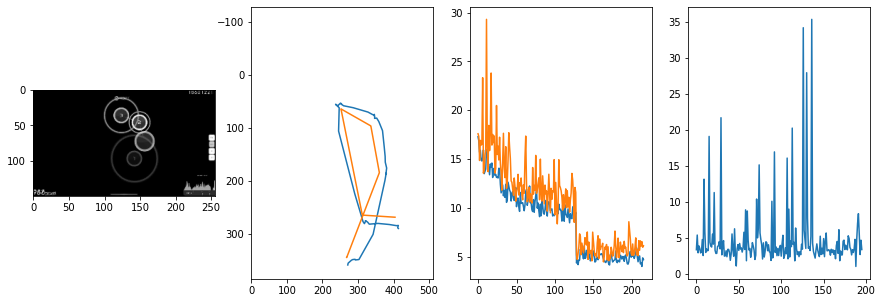


 222 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.90it/s  13.6496                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.021319521933186
outliers: 48
retrain: 4                 
val: 50/50 loss: 10.6586                                   
pred: 0.3338557183742523 0.39494824409484863
gt: 0.3945566415786743 0.3489947021007538
(109, 58)


<Figure size 1080x360 with 0 Axes>

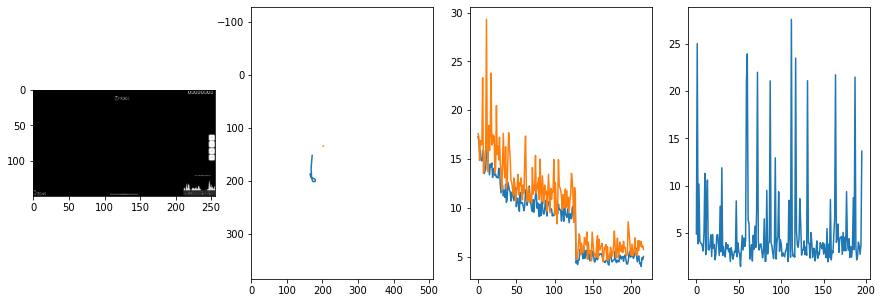


 223 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.09it/s  2.7441                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.039522953179418
outliers: 45
retrain: 4                 
val: 50/50 loss: 4.7986                                    
pred: 0.7700774073600769 0.749981164932251
gt: 0.6386303901672363 0.5629180073738098
(147, 83)


<Figure size 1080x360 with 0 Axes>

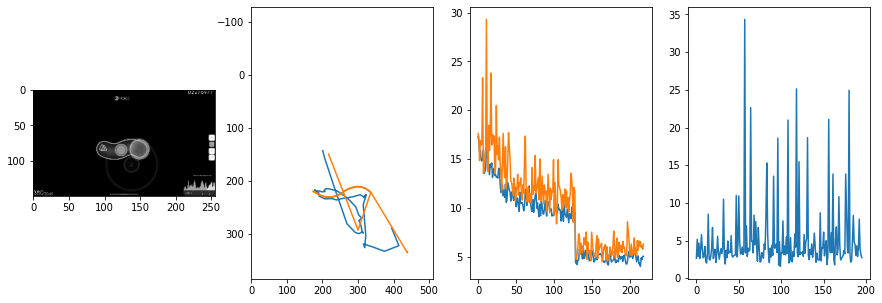


 224 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.77it/s  2.2371                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.74523620277035
outliers: 41
retrain: 4                 
val: 50/50 loss: 3.6388                                    
pred: 0.6575771570205688 0.3516111969947815
gt: 0.7152894735336304 0.3268330693244934
(158, 56)


<Figure size 1080x360 with 0 Axes>

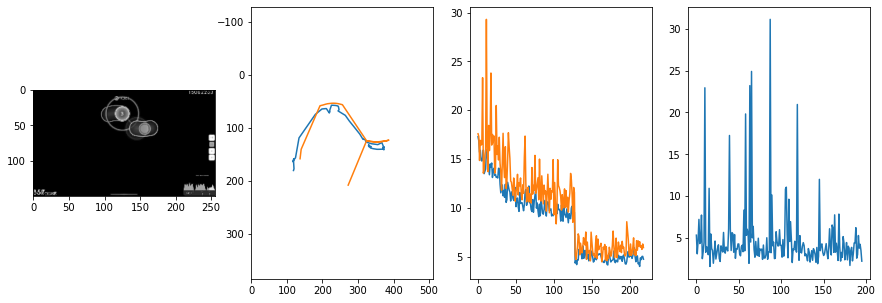


 225 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  3.3215                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.663789689540863
outliers: 45
retrain: 4                 
val: 50/50 loss: 4.6688                                    
pred: 0.4796772301197052 0.17231231927871704
gt: 0.7011720538139343 0.19534462690353394
(156, 40)


<Figure size 1080x360 with 0 Axes>

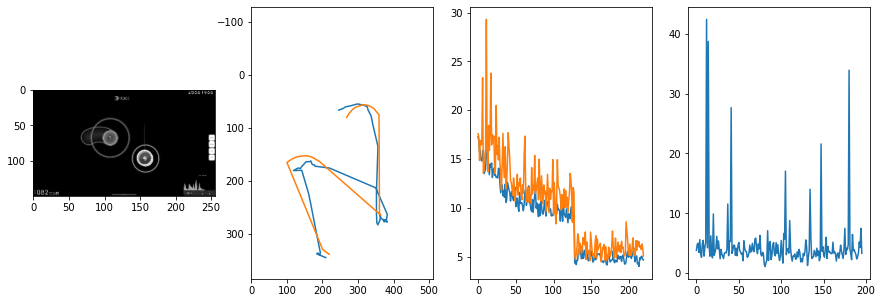


 226 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.64it/s  3.5729                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.711653255078257
outliers: 47
retrain: 4                 
val: 50/50 loss: 3.0419                                    
pred: 0.27340075373649597 0.624065101146698
gt: 0.283203125 0.2447916865348816
(91, 46)


<Figure size 1080x360 with 0 Axes>

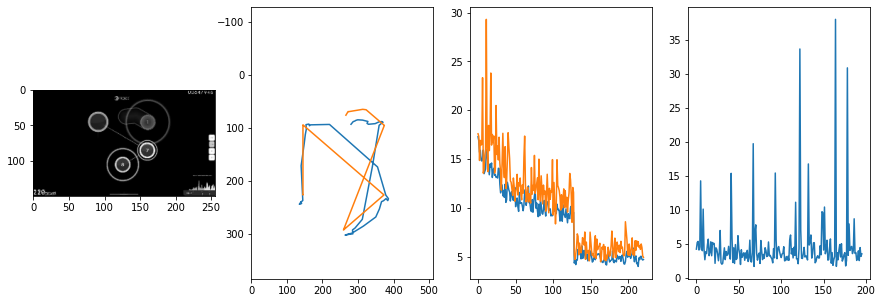


 227 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.86it/s  3.4957                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.465321681329182
outliers: 43
retrain: 4                 
val: 50/50 loss: 4.0709                                    
pred: 0.3256819546222687 0.5484354496002197
gt: 0.2265625 0.2708333432674408
(83, 49)


<Figure size 1080x360 with 0 Axes>

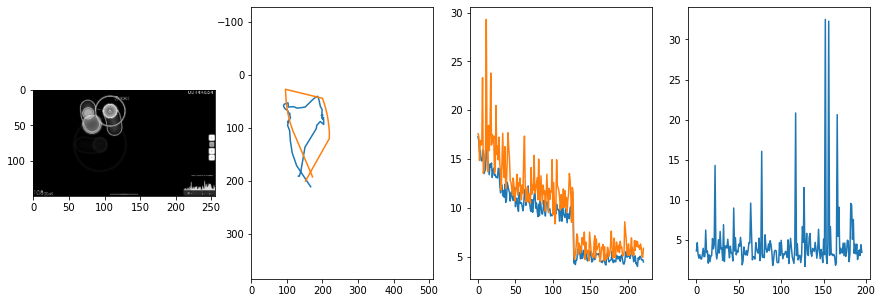


 228 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.88it/s  3.0388                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.5266046384159395
outliers: 45
retrain: 4                 
val: 50/50 loss: 5.8975                                    
pred: 0.7901370525360107 0.22238528728485107
gt: 0.7695335745811462 0.19791477918624878
(167, 41)


<Figure size 1080x360 with 0 Axes>

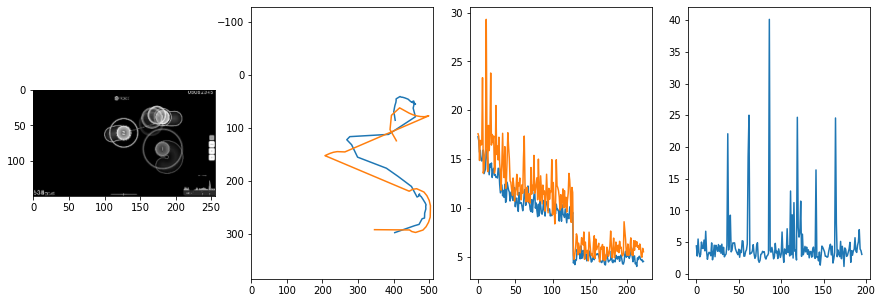


 229 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.57it/s  2.9338                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.874050046716418
outliers: 56
retrain: 4                 
val: 50/50 loss: 7.4087                                    
pred: 0.2793136239051819 0.39506995677948
gt: 0.4485633373260498 0.4329651892185211
(117, 68)


<Figure size 1080x360 with 0 Axes>

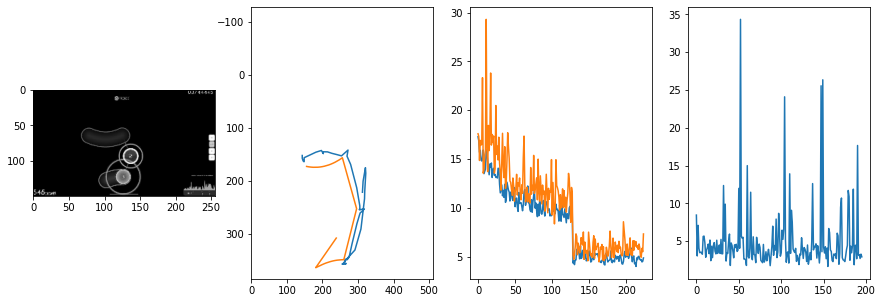


 230 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  2.2969                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.5411520229310405
outliers: 37
retrain: 4                 
val: 50/50 loss: 6.0200                                    
pred: 0.2921444773674011 0.6353796720504761
gt: 0.28906112909317017 0.6354213356971741
(92, 91)


<Figure size 1080x360 with 0 Axes>

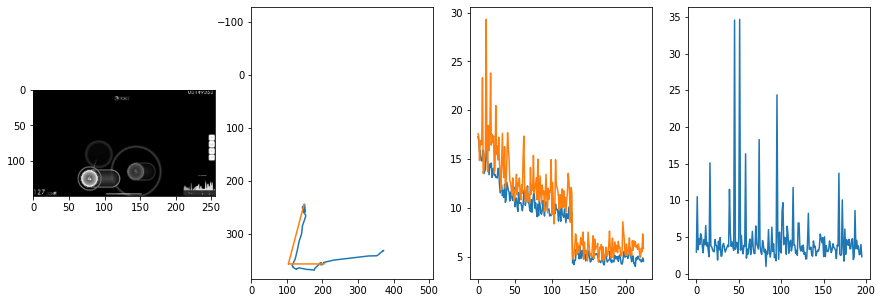


 231 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.64it/s  3.4691                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.479270098768935
outliers: 44
retrain: 4                 
val: 50/50 loss: 6.9124                                    
pred: 0.5981608629226685 0.822541356086731
gt: 0.8964865207672119 0.48995348811149597
(187, 74)


<Figure size 1080x360 with 0 Axes>

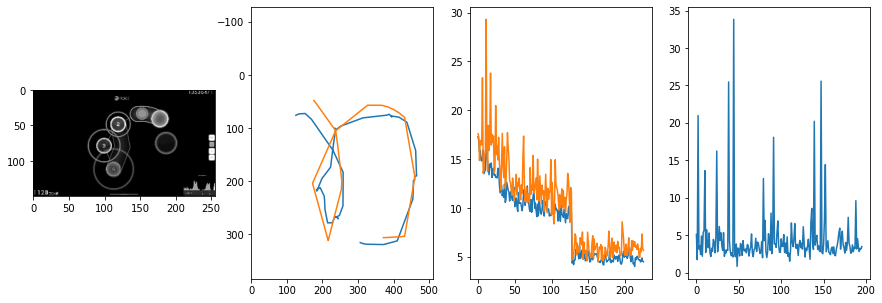


 232 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  14.00it/s  2.6249                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.178313102040972
outliers: 43
retrain: 4                 
val: 50/50 loss: 5.5282                                    
pred: 0.3405001759529114 0.7427180409431458
gt: 0.7981932163238525 0.9105497002601624
(171, 123)


<Figure size 1080x360 with 0 Axes>

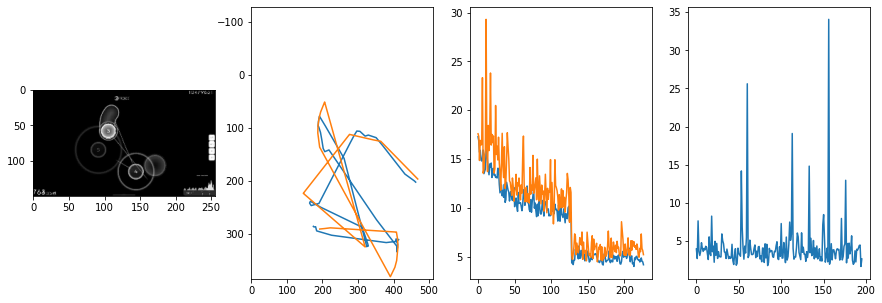


 233 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.53it/s  2.4646                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.056619012842373
outliers: 60
retrain: 4                 
val: 50/50 loss: 4.8186                                    
pred: 0.20573194324970245 0.5658037066459656
gt: 0.16298221051692963 0.5
(73, 76)


<Figure size 1080x360 with 0 Axes>

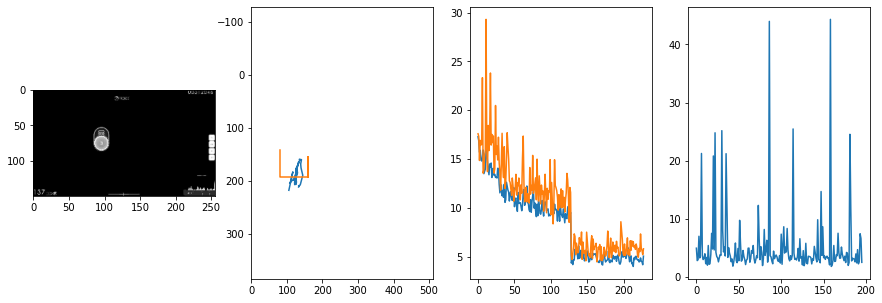


 234 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  1.9981                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.63544716153826
outliers: 42
retrain: 4                 
val: 50/50 loss: 3.0778                                    
pred: 0.3282812535762787 0.5487285256385803
gt: 0.3306041955947876 0.4336174726486206
(99, 68)


<Figure size 1080x360 with 0 Axes>

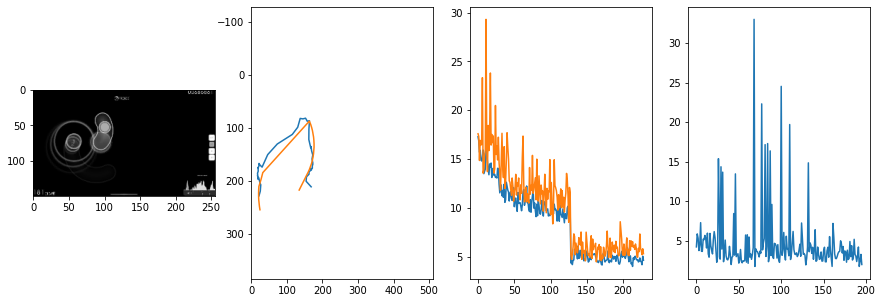


 235 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.80it/s  2.3628                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.013027491009965
outliers: 56
retrain: 4                 
val: 50/50 loss: 5.9153                                    
pred: 0.2982366383075714 0.16844333708286285
gt: 0.4063727855682373 0.3228726089000702
(111, 55)


<Figure size 1080x360 with 0 Axes>

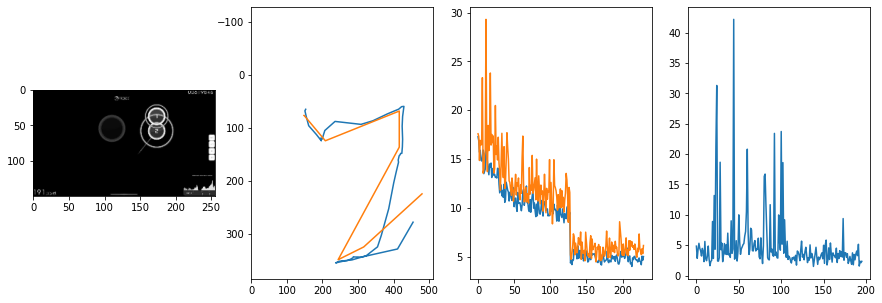


 236 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  21.9268                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.150823044533632
outliers: 42
retrain: 4                 
val: 50/50 loss: 3.1602                                    
pred: 0.3246120512485504 0.6521766185760498
gt: 0.2502816915512085 0.5864227414131165
(86, 86)


<Figure size 1080x360 with 0 Axes>

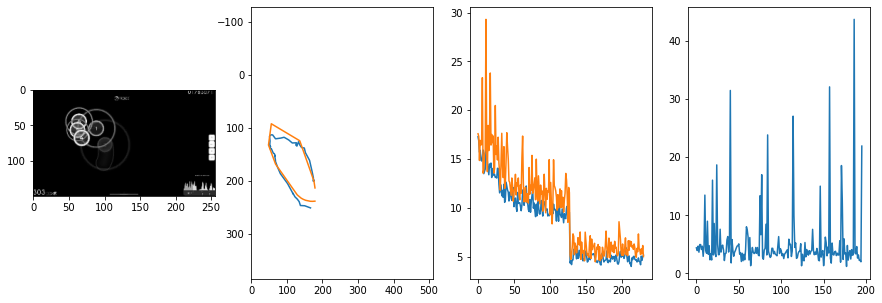


 237 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  4.3289                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.076522420863716
outliers: 23
retrain: 4                 
val: 50/50 loss: 5.4731                                    
pred: 0.8486336469650269 0.8052238821983337
gt: 0.7910179495811462 0.9114559292793274
(170, 124)


<Figure size 1080x360 with 0 Axes>

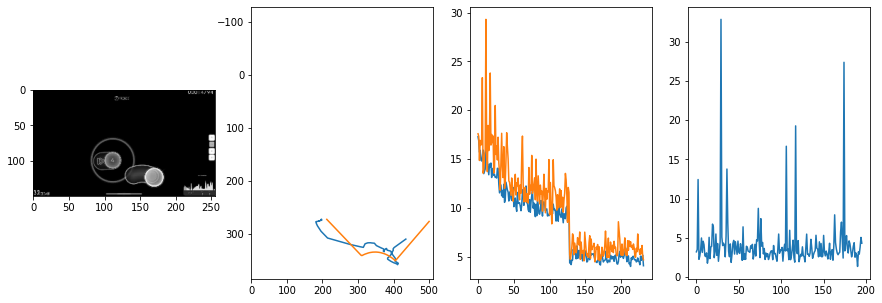


 238 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.84it/s  2.5344                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.451482826805845
outliers: 51
retrain: 4                 
val: 50/50 loss: 3.2404                                    
pred: 0.28057628870010376 0.9056629538536072
gt: 0.41796875 0.7942707538604736
(112, 110)


<Figure size 1080x360 with 0 Axes>

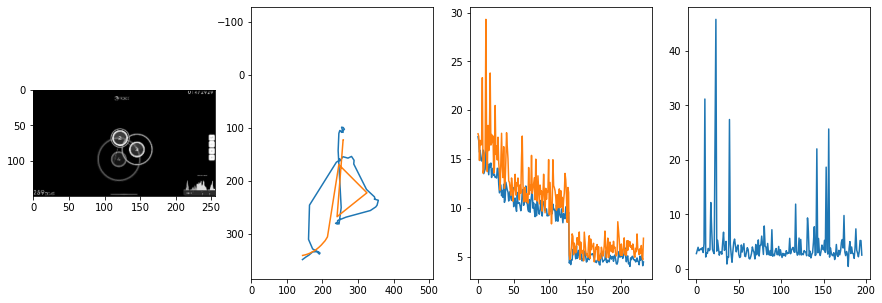


 239 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  4.0926                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.67458094686878
outliers: 52
retrain: 4                 
val: 50/50 loss: 4.4405                                    
pred: 0.7898024320602417 0.7136879563331604
gt: 0.46865469217300415 0.8749418258666992
(120, 119)


<Figure size 1080x360 with 0 Axes>

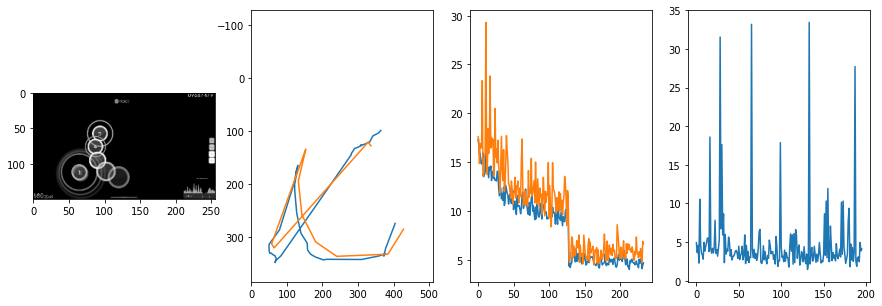


 240 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.82it/s  2.3853                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.549787589481899
outliers: 44
retrain: 4                 
val: 50/50 loss: 6.7887                                    
pred: 0.48441267013549805 0.4928271472454071
gt: 0.5 0.33333921432495117
(125, 56)


<Figure size 1080x360 with 0 Axes>

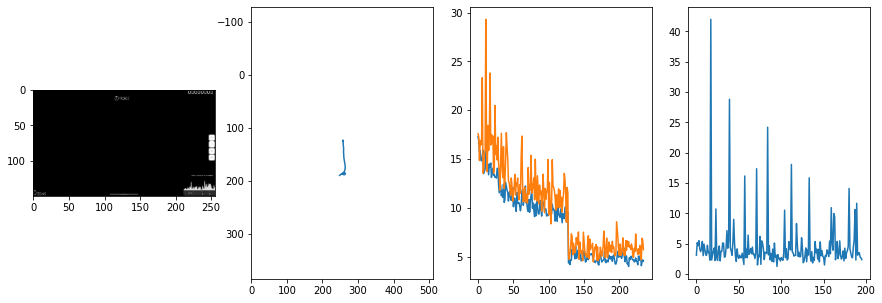


 241 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.83it/s  6.0064                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.074968380891547
outliers: 42
retrain: 4                 
val: 50/50 loss: 2.5015                                    
pred: 0.6450841426849365 0.4120950996875763
gt: 0.669921875 0.53125
(151, 79)


<Figure size 1080x360 with 0 Axes>

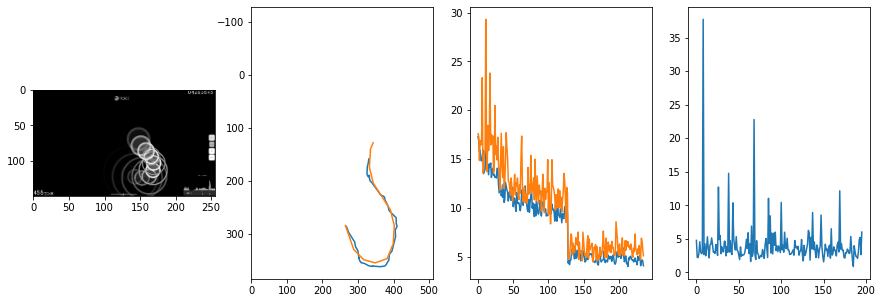


 242 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.16it/s  2.0460                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.784015416490789
outliers: 73
retrain: 4                 
val: 50/50 loss: 4.0667                                    
pred: 0.7414806485176086 0.686678409576416
gt: 0.643243670463562 0.7582572102546692
(147, 106)


<Figure size 1080x360 with 0 Axes>

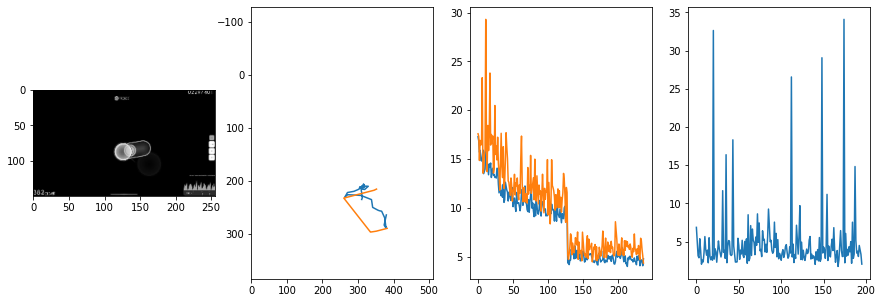


 243 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  3.9568                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.582008507178754
outliers: 39
retrain: 4                 
val: 50/50 loss: 3.2450                                    
pred: 0.8566404581069946 0.061729803681373596
gt: 0.7284992337226868 0.03655584156513214
(160, 22)


<Figure size 1080x360 with 0 Axes>

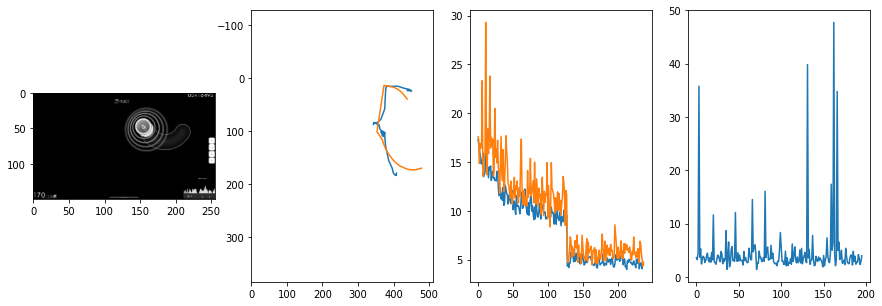


 244 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  4.4062                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.878785022667476
outliers: 33
retrain: 4                 
val: 50/50 loss: 2.7058                                    
pred: 0.6057630777359009 0.30127623677253723
gt: 0.767578125 0.2630208432674408
(167, 48)


<Figure size 1080x360 with 0 Axes>

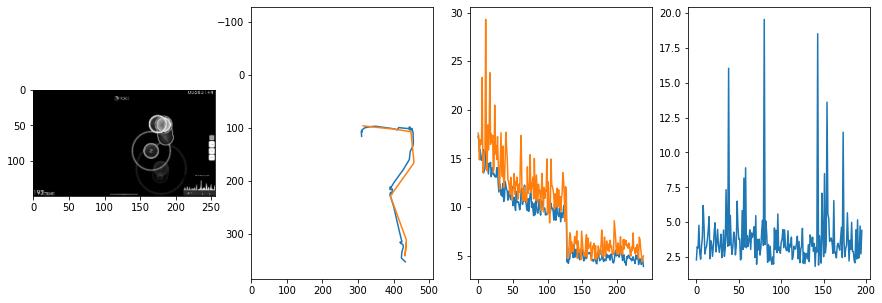


 245 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  2.9824                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.9867745473676797
outliers: 58
retrain: 4                 
val: 50/50 loss: 4.6358                                    
pred: 0.1482727974653244 0.7465464472770691
gt: 0.02670329436659813 0.6861793398857117
(52, 97)


<Figure size 1080x360 with 0 Axes>

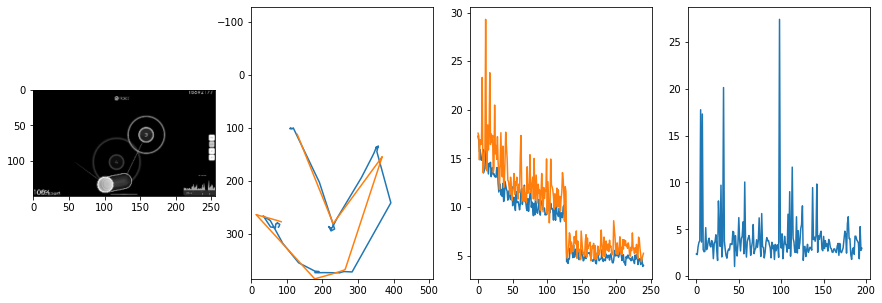


 246 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.87it/s  2.7989                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.862756700844181
outliers: 62
retrain: 4                 
val: 50/50 loss: 4.3025                                    
pred: 0.9352591633796692 0.3653203547000885
gt: 0.7734374403953552 0.440104216337204
(167, 69)


<Figure size 1080x360 with 0 Axes>

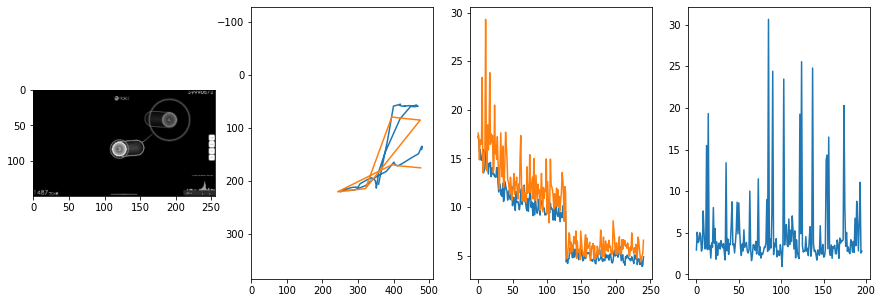


 247 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.66it/s  2.6495                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.321840549001888
outliers: 32
retrain: 4                 
val: 50/50 loss: 2.6336                                    
pred: 0.7246587872505188 0.6544131636619568
gt: 0.7447319626808167 0.7002546191215515
(163, 99)


<Figure size 1080x360 with 0 Axes>

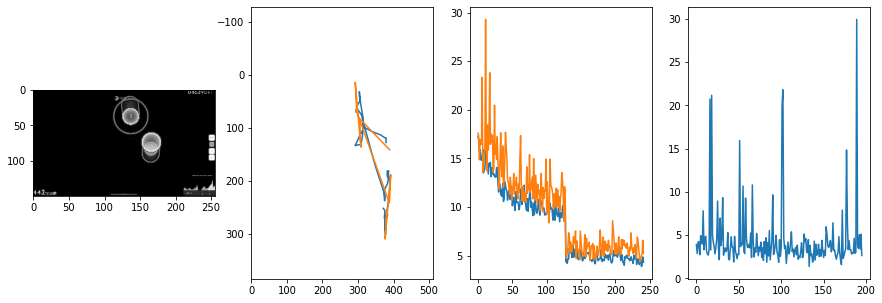


 248 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.86it/s  2.0669                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.2364704006788685
outliers: 51
retrain: 4                 
val: 50/50 loss: 3.4551                                    
pred: 0.7932010293006897 0.8971688151359558
gt: 0.7871094346046448 0.17447972297668457
(170, 38)


<Figure size 1080x360 with 0 Axes>

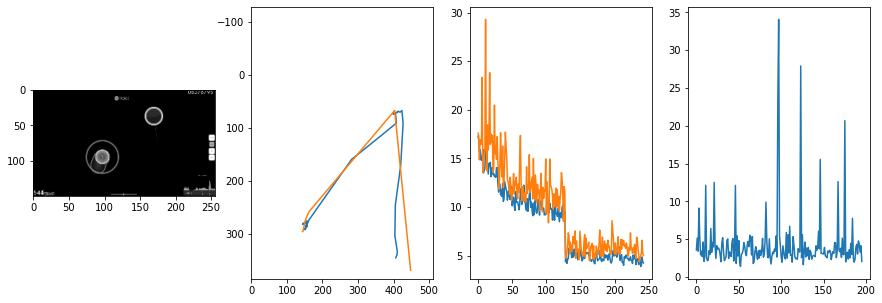


 249 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  3.1417                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.126632501884383
outliers: 46
retrain: 4                 
val: 50/50 loss: 1.9262                                    
pred: 0.5894561409950256 0.7623161673545837
gt: 0.552734375 0.7760416865348816
(133, 108)


<Figure size 1080x360 with 0 Axes>

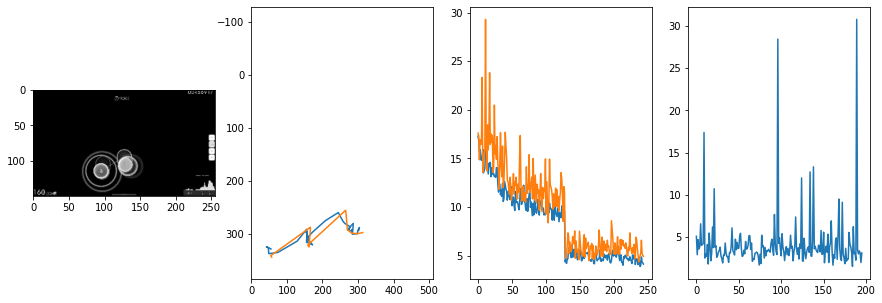


 250 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  3.2361                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.000805542633241
outliers: 48
retrain: 4                 
val: 50/50 loss: 3.9418                                    
pred: 0.7552691102027893 0.8959257006645203
gt: 0.41953688859939575 0.7198742032051086
(113, 101)


<Figure size 1080x360 with 0 Axes>

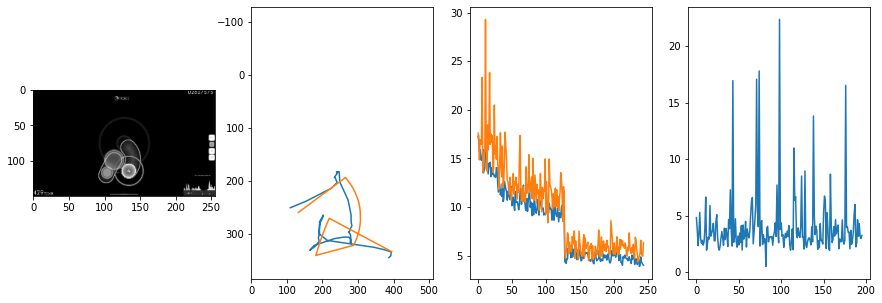


 251 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.81it/s  13.8459                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.531756050732671
outliers: 71
retrain: 4                 
val: 50/50 loss: 4.9554                                    
pred: 0.7170860171318054 0.5949571132659912
gt: 0.13281258940696716 0.6874999403953552
(68, 97)


<Figure size 1080x360 with 0 Axes>

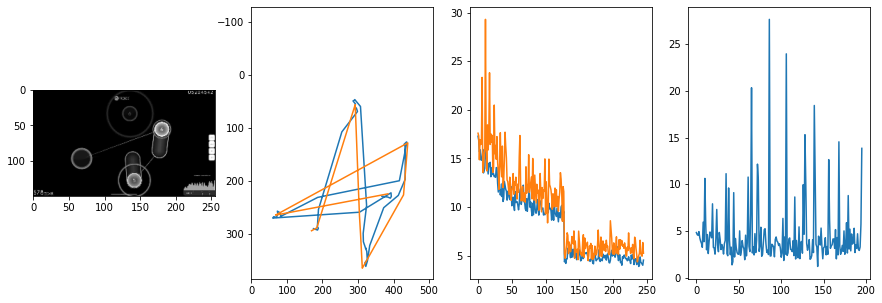


 252 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.20it/s  2.4538                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.204412467017466
outliers: 42
retrain: 4                 
val: 50/50 loss: 3.1462                                    
pred: 0.6975410580635071 0.17664848268032074
gt: 0.7502400875091553 0.1670934557914734
(164, 37)


<Figure size 1080x360 with 0 Axes>

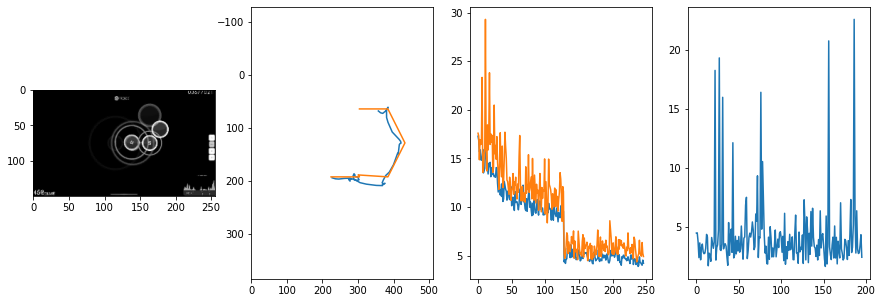


 253 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  3.0985                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.8942136502995783
outliers: 39
retrain: 4                 
val: 50/50 loss: 4.4120                                    
pred: 0.17651256918907166 0.381158709526062
gt: 0.134765625 0.1640625
(68, 37)


<Figure size 1080x360 with 0 Axes>

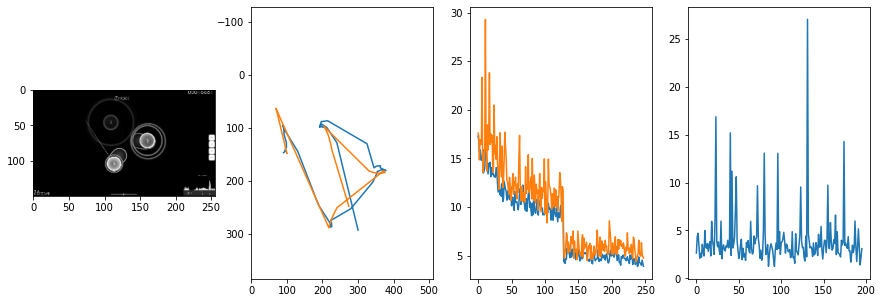


 254 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.86it/s  2.3114                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.499289452421422
outliers: 68
retrain: 4                 
val: 50/50 loss: 5.9531                                    
pred: 0.2544448971748352 0.5883122086524963
gt: 0.2905573844909668 0.4811514616012573
(93, 73)


<Figure size 1080x360 with 0 Axes>

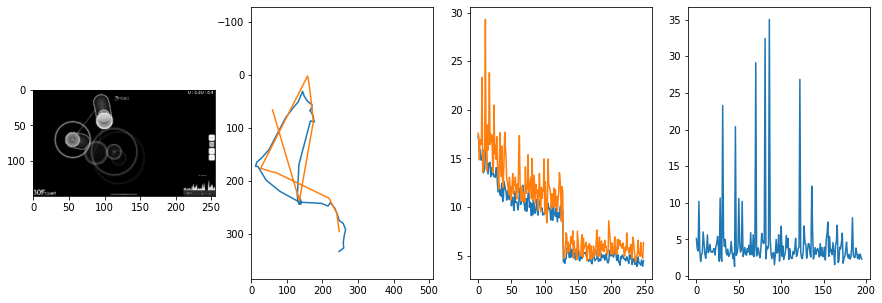


 255 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.01it/s  2.3539                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.797562809014807
outliers: 55
retrain: 4                 
val: 50/50 loss: 16.4618                                   
pred: 0.5103924870491028 0.7240085601806641
gt: 0.5 0.6979166865348816
(125, 99)


<Figure size 1080x360 with 0 Axes>

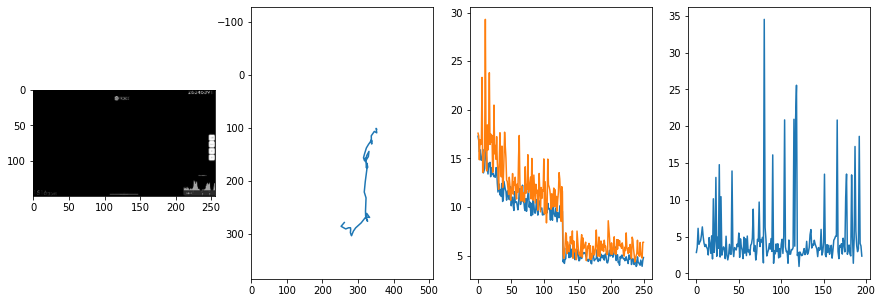


 256 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.87it/s  4.8619                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.213005868756041
outliers: 32
retrain: 4                 
val: 50/50 loss: 2.9723                                    
pred: 0.6458300948143005 0.6447495222091675
gt: 0.7925933599472046 0.762877881526947
(170, 106)


<Figure size 1080x360 with 0 Axes>

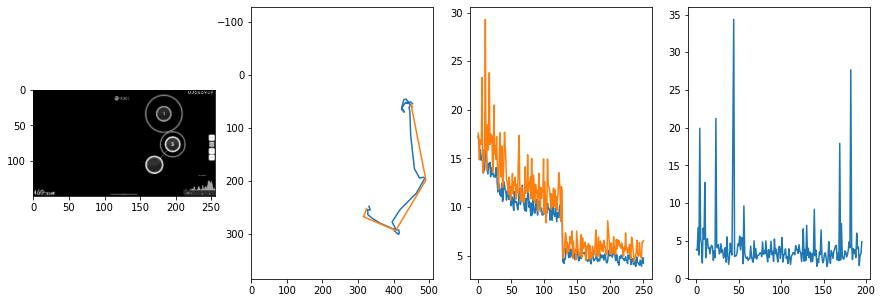


 257 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.77it/s  37.8618                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.633735427442862
outliers: 58
retrain: 4                 
val: 50/50 loss: 6.2483                                    
pred: 0.7371457815170288 0.5310187935829163
gt: 0.6090071797370911 0.5813294649124146
(142, 85)


<Figure size 1080x360 with 0 Axes>

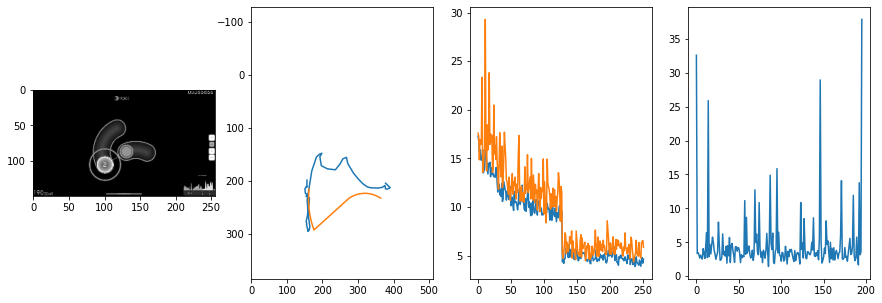


 258 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  11.6696                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 6.99551846664779
outliers: 106
retrain: 4                 
val: 50/50 loss: 3.3624                                    
pred: 0.7962706089019775 0.7020323276519775
gt: 0.8515576124191284 0.5937826037406921
(180, 87)


<Figure size 1080x360 with 0 Axes>

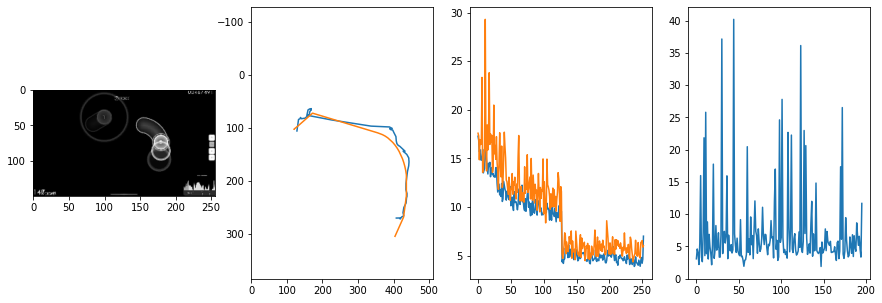


 259 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.83it/s  3.7608                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.047014771067366
outliers: 23
retrain: 4                 
val: 50/50 loss: 3.7229                                    
pred: 0.6256585121154785 0.794980525970459
gt: 0.37500014901161194 0.10416698455810547
(106, 30)


<Figure size 1080x360 with 0 Axes>

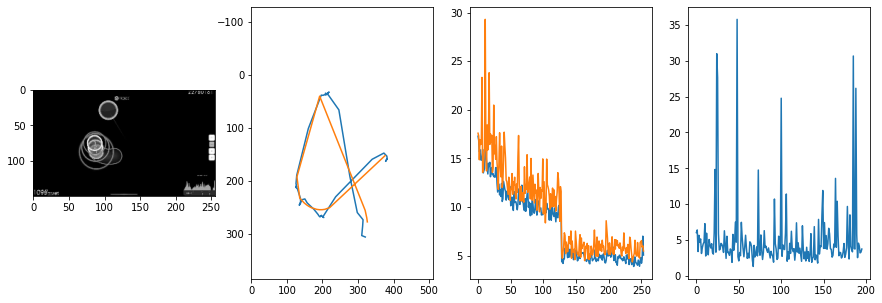


 260 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  4.5126                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.661044485714971
outliers: 38
retrain: 4                 
val: 50/50 loss: 3.6164                                    
pred: 0.4743562638759613 0.5672510862350464
gt: 0.5787765383720398 0.42304694652557373
(137, 67)


<Figure size 1080x360 with 0 Axes>

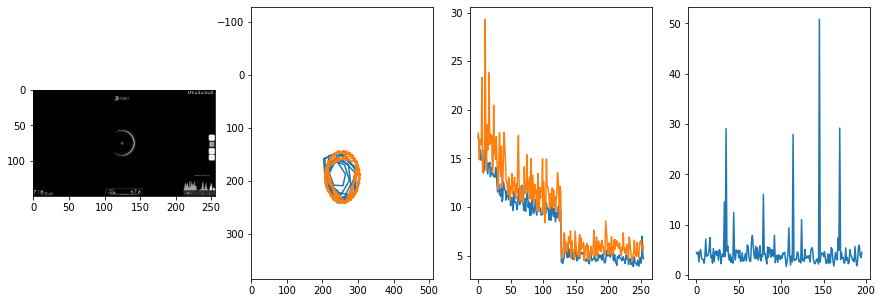


 261 of 262


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.68it/s  2.4071                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.373167561633246
outliers: 41
retrain: 4                 
val: 50/50 loss: 3.4270                                    
pred: 0.45647966861724854 0.5603230595588684
gt: 0.3514633774757385 0.4180251657962799
(102, 66)


<Figure size 1080x360 with 0 Axes>

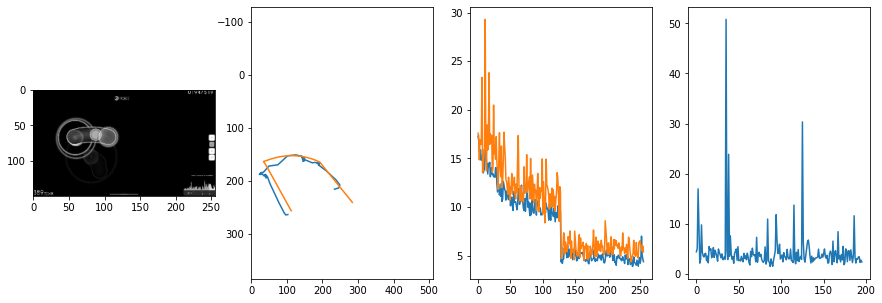


 262 of 262
2638.9924952983856 secs


In [25]:
start = time.time()

epochs = 128
loss_thresh = 0.0003
rnum_min = 4
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [26]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

4.3446117115020755


In [72]:
best_loss = 9999

1 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.80it/s  3.0215                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

avg: 4.255402683603521
outliers: 196
retrain: 4                 
val: 50/50 loss: 2.5356                                    
pred: 0.5319859981536865 0.8309990763664246
gt: 0.3671875 0.78125
(104, 108)


<Figure size 1080x360 with 0 Axes>

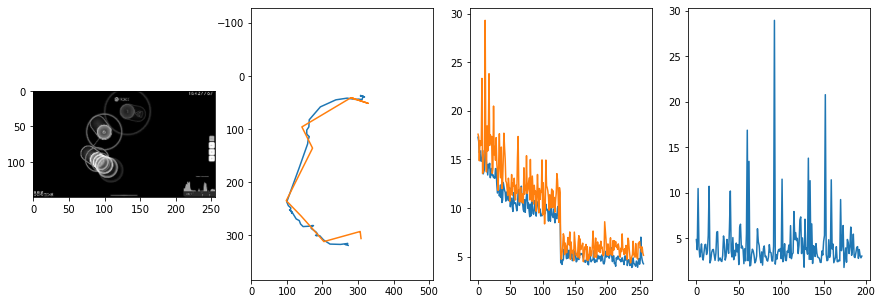


 263 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.16it/s  2.5102                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.1890504560908495
outliers: 50
retrain: 4                 
val: 50/50 loss: 5.2093                                    
pred: 0.37774088978767395 0.27779024839401245
gt: 0.5322664380073547 0.3001113533973694
(130, 52)


<Figure size 1080x360 with 0 Axes>

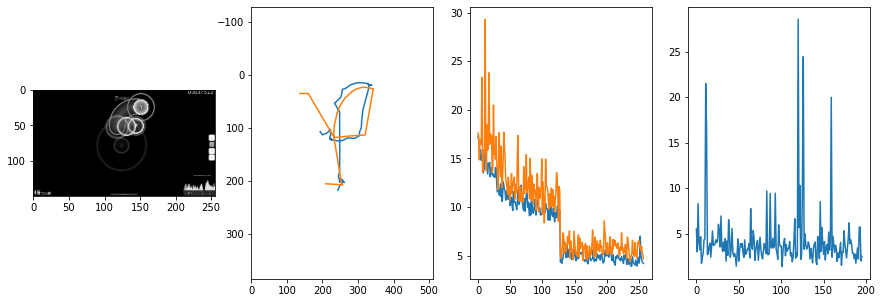


 264 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.32it/s  3.4172                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.390474927668669
outliers: 59
retrain: 4                 
val: 50/50 loss: 3.3161                                    
pred: 0.4035256803035736 0.11552883684635162
gt: 0.53125 0.0625
(130, 25)


<Figure size 1080x360 with 0 Axes>

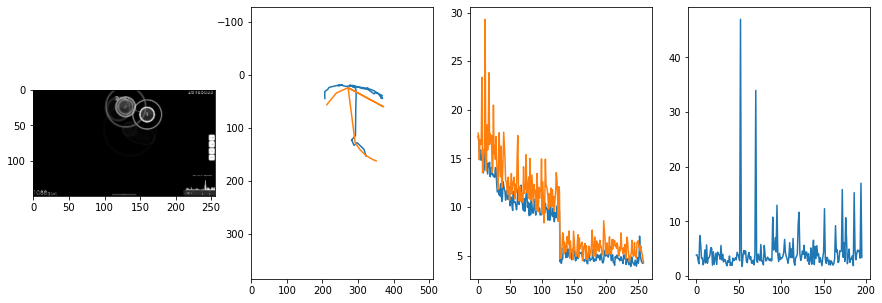


 265 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.13it/s  10.7474                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.271285907346375
outliers: 53
retrain: 4                 
val: 50/50 loss: 3.4766                                    
pred: 0.08690455555915833 0.10723760724067688
gt: 0.23520690202713013 0.16050869226455688
(84, 36)


<Figure size 1080x360 with 0 Axes>

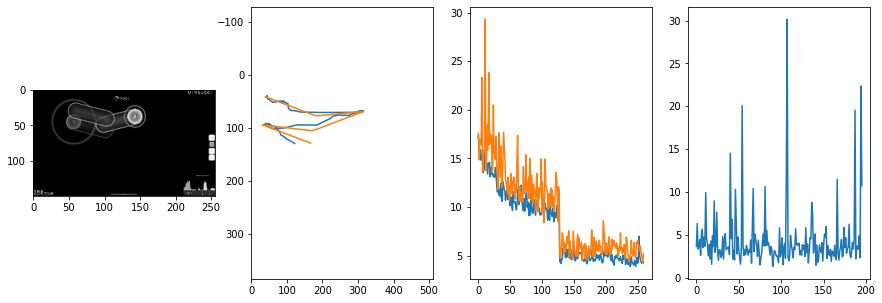


 266 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.36it/s  3.8091                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.433674206539076
outliers: 49
retrain: 4                 
val: 50/50 loss: 3.5769                                    
pred: 0.8430586457252502 0.7976429462432861
gt: 0.779296875 0.7265625
(168, 102)


<Figure size 1080x360 with 0 Axes>

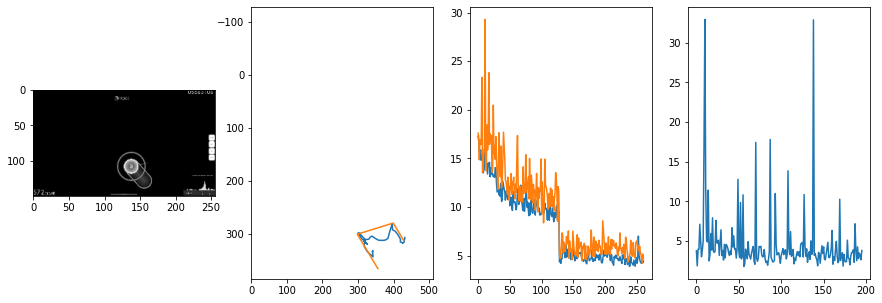


 267 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.46it/s  4.0232                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.260620322154493
outliers: 42
retrain: 4                 
val: 50/50 loss: 4.2174                                    
pred: 0.5152389407157898 0.7186039686203003
gt: 0.2187870591878891 0.29171067476272583
(81, 51)


<Figure size 1080x360 with 0 Axes>

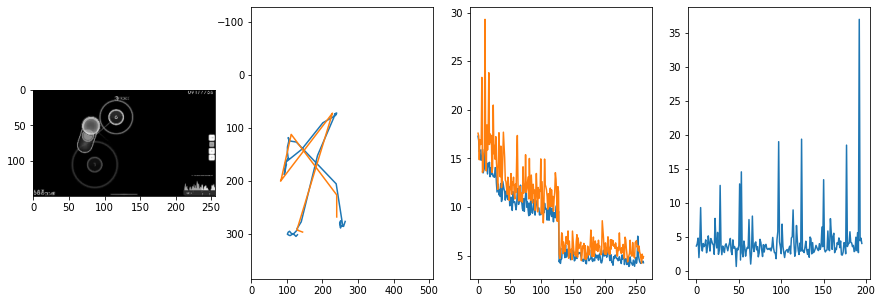


 268 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.21it/s  2.5438                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.938038395983832
outliers: 61
retrain: 4                 
val: 50/50 loss: 4.1619                                    
pred: 0.8594068288803101 0.6554627418518066
gt: 0.9960889220237732 0.9374993443489075
(202, 127)


<Figure size 1080x360 with 0 Axes>

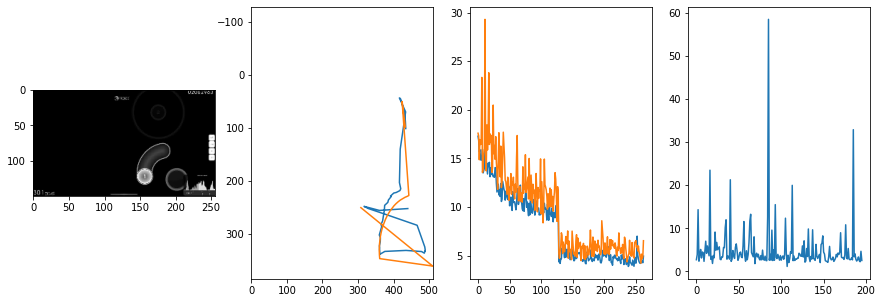


 269 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:15<00:00:00  12.97it/s  7.0978                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.679965253387179
outliers: 33
retrain: 4                 
val: 50/50 loss: 4.2231                                    
pred: 0.31331267952919006 0.13376902043819427
gt: 0.2669307589530945 0.10004838556051254
(89, 29)


<Figure size 1080x360 with 0 Axes>

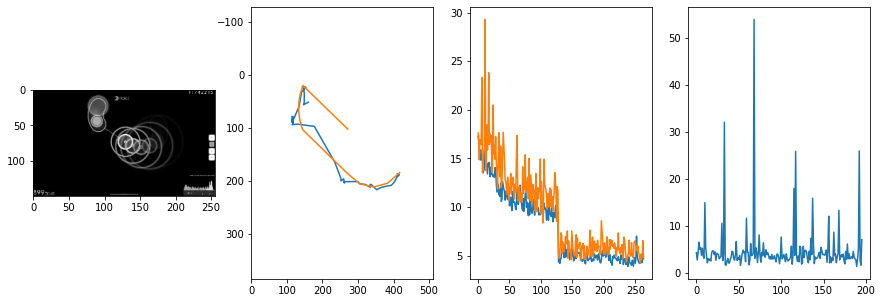


 270 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.32it/s  5.2413                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.468343026175791
outliers: 41
retrain: 4                 
val: 50/50 loss: 3.7044                                    
pred: 0.2500195801258087 0.25388863682746887
gt: 0.4106738269329071 0.276960164308548
(111, 50)


<Figure size 1080x360 with 0 Axes>

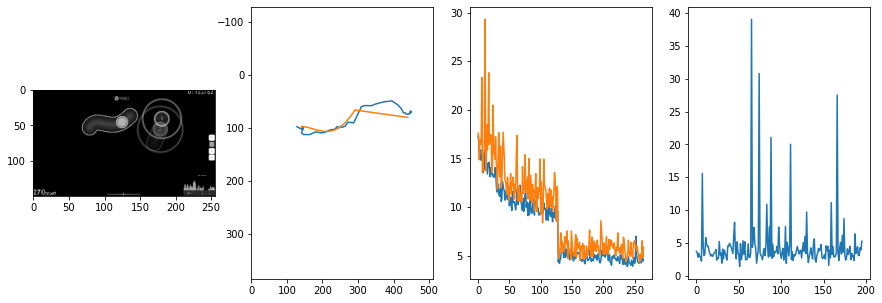


 271 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.22it/s  4.4151                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.176315410404789
outliers: 33
retrain: 4                 
val: 50/50 loss: 5.2368                                    
pred: 0.12496352940797806 0.1712220460176468
gt: 0.296875 0.34375
(94, 57)


<Figure size 1080x360 with 0 Axes>

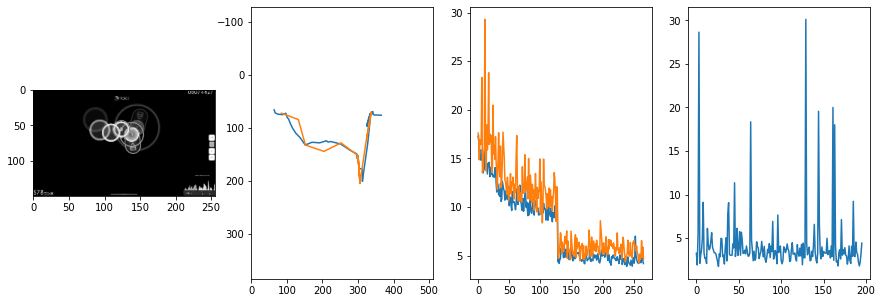


 272 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.49it/s  3.3077                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.385564064492985
outliers: 51
retrain: 4                 
val: 50/50 loss: 6.5915                                    
pred: 0.8331003189086914 0.17593999207019806
gt: 0.46873271465301514 0.833079993724823
(120, 114)


<Figure size 1080x360 with 0 Axes>

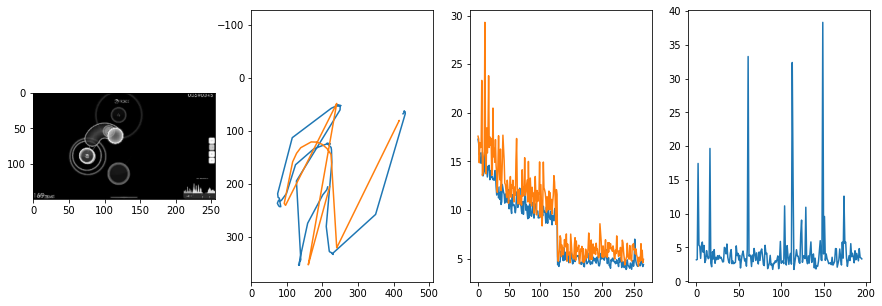


 273 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.94it/s  5.8124                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.407948802928535
outliers: 83
retrain: 4                 
val: 50/50 loss: 3.8562                                    
pred: 0.7431913018226624 0.9429017901420593
gt: 0.60546875 0.7682291865348816
(141, 107)


<Figure size 1080x360 with 0 Axes>

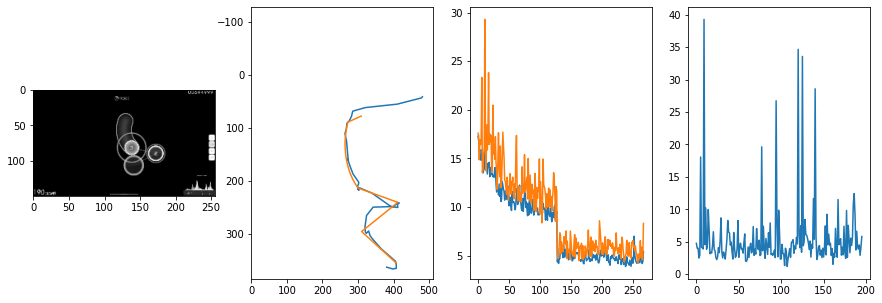


 274 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.75it/s  2.5772                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 7.243029540290638
outliers: 103
retrain: 4                 
val: 50/50 loss: 5.8741                                    
pred: 0.2950511574745178 0.7947901487350464
gt: 0.328125 0.47979167103767395
(98, 73)


<Figure size 1080x360 with 0 Axes>

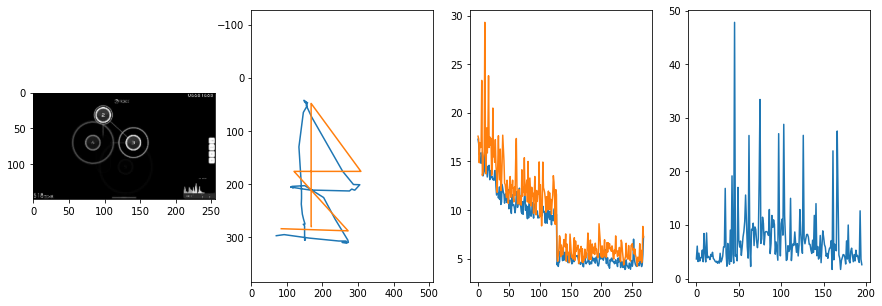


 275 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.76it/s  3.2428                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.005363388329136
outliers: 21
retrain: 4                 
val: 50/50 loss: 3.9059                                    
pred: 0.8648151159286499 0.6089724898338318
gt: 0.6840112805366516 0.5955110788345337
(154, 87)


<Figure size 1080x360 with 0 Axes>

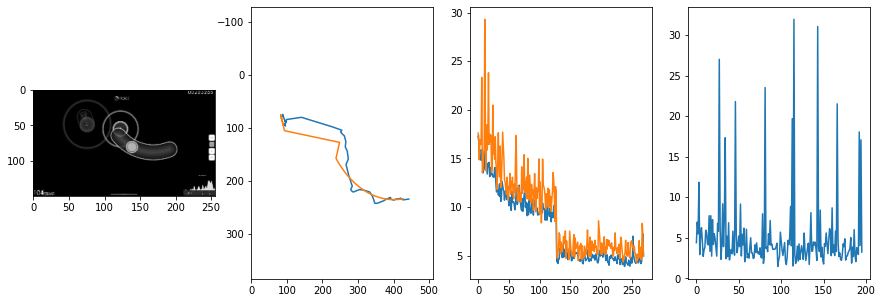


 276 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.63it/s  3.0535                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.0756069050759685
outliers: 28
retrain: 4                 
val: 50/50 loss: 4.5725                                    
pred: 0.6325527429580688 0.6893067359924316
gt: 0.52734375 0.59375
(129, 87)


<Figure size 1080x360 with 0 Axes>

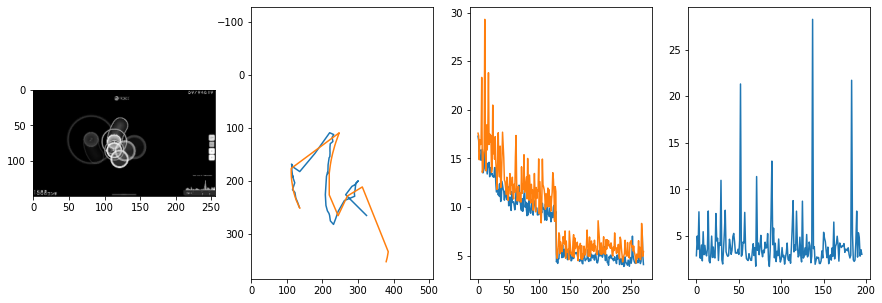


 277 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.62it/s  2.1268                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.641221812793186
outliers: 62
retrain: 4                 
val: 50/50 loss: 20.3681                                   
pred: 0.5229974389076233 0.49568137526512146
gt: 0.18869930505752563 0.5321138501167297
(77, 79)


<Figure size 1080x360 with 0 Axes>

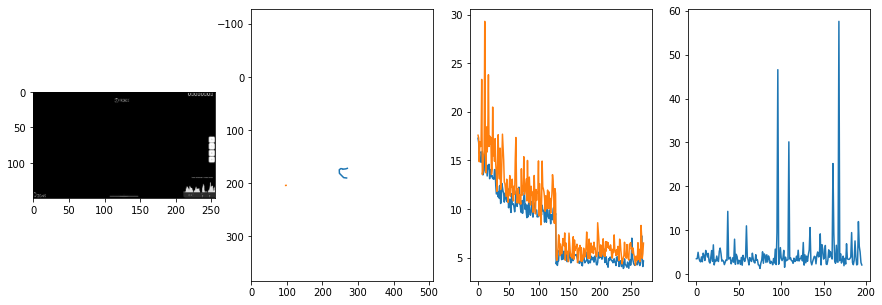


 278 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.35it/s  17.3402                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.63507780767217
outliers: 47
retrain: 4                 
val: 50/50 loss: 4.1514                                    
pred: 0.4966086447238922 0.5339003801345825
gt: 0.4921875 0.59375
(124, 87)


<Figure size 1080x360 with 0 Axes>

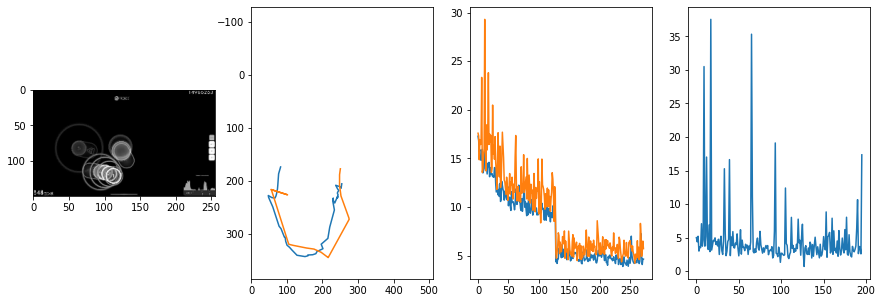


 279 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.75it/s  3.0242                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.777593795742307
outliers: 50
retrain: 4                 
val: 50/50 loss: 7.3523                                    
pred: 0.496876984834671 0.823940634727478
gt: 0.49336960911750793 0.9034762978553772
(124, 123)


<Figure size 1080x360 with 0 Axes>

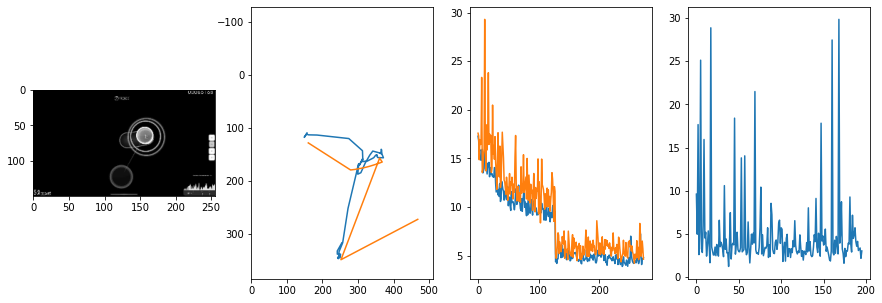


 280 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.58it/s  2.9615                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.524353545539233
outliers: 48
retrain: 4                 
val: 50/50 loss: 4.2254                                    
pred: 0.5131382346153259 0.3540633022785187
gt: 0.49150487780570984 0.30696216225624084
(124, 53)


<Figure size 1080x360 with 0 Axes>

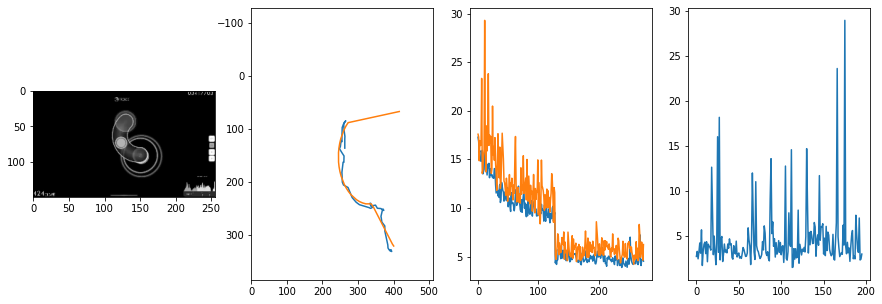


 281 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.87it/s  7.3068                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 7.461287728377751
outliers: 153
retrain: 4                 
val: 50/50 loss: 3.6561                                    
pred: 0.5719409584999084 0.1435663402080536
gt: 0.5390625 0.17708517611026764
(131, 38)


<Figure size 1080x360 with 0 Axes>

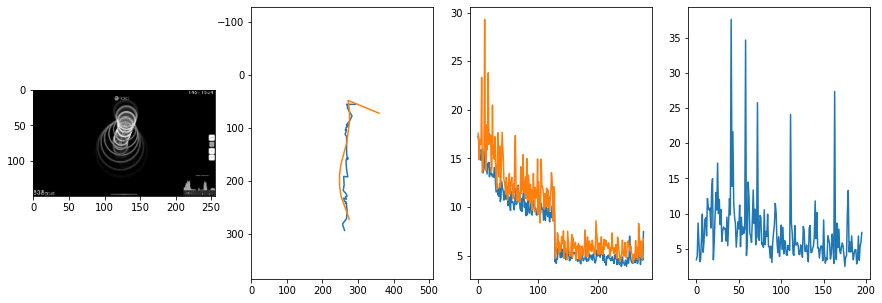


 282 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.54it/s  2.7753                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.360502166407449
outliers: 21
retrain: 4                 
val: 50/50 loss: 2.8882                                    
pred: 0.15151792764663696 0.2926981449127197
gt: 0.25462499260902405 0.3125
(87, 54)


<Figure size 1080x360 with 0 Axes>

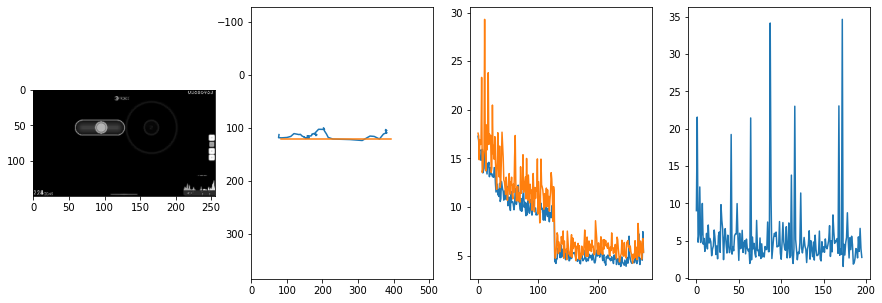


 283 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.79it/s  3.3490                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.278736597421218
outliers: 43
retrain: 4                 
val: 50/50 loss: 3.4980                                    
pred: 0.6472447514533997 0.7637044787406921
gt: 0.499240905046463 0.7255503535270691
(125, 102)


<Figure size 1080x360 with 0 Axes>

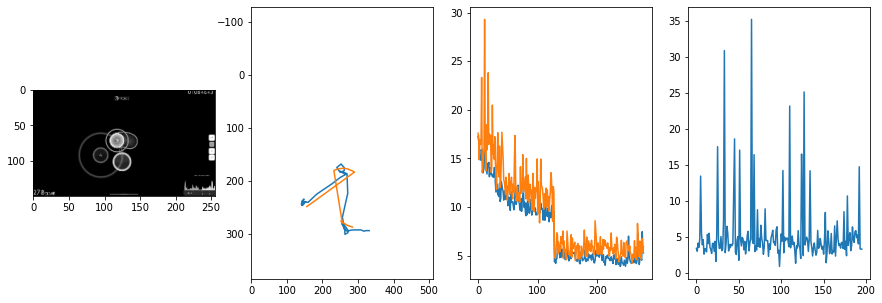


 284 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.77it/s  4.5632                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.747031997661201
outliers: 37
retrain: 4                 
val: 50/50 loss: 4.2103                                    
pred: 0.6055302619934082 0.33536142110824585
gt: 0.5886949896812439 0.2628667652606964
(139, 48)


<Figure size 1080x360 with 0 Axes>

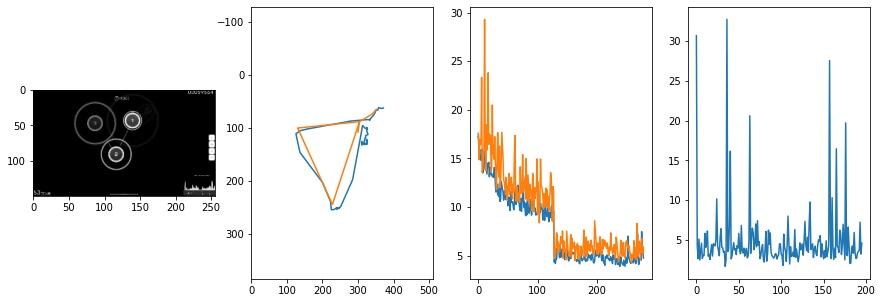


 285 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.50it/s  2.3576                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.122432064036934
outliers: 33
retrain: 4                 
val: 50/50 loss: 29.4924                                   
pred: 0.5241184830665588 0.4384554624557495
gt: 0.16213199496269226 0.31772053241729736
(73, 54)


<Figure size 1080x360 with 0 Axes>

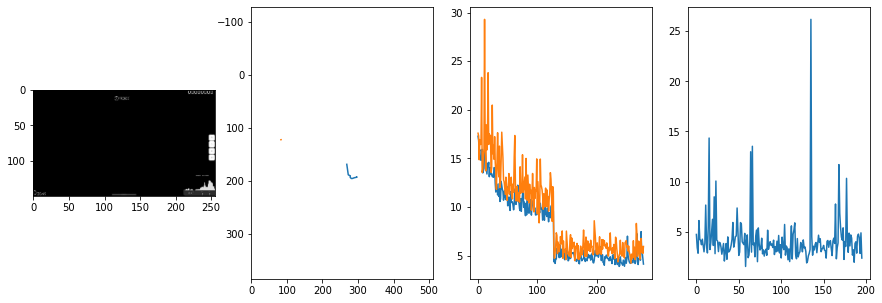


 286 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.30it/s  2.7445                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.7441277479638857
outliers: 52
retrain: 4                 
val: 50/50 loss: 2.8434                                    
pred: 0.6370766162872314 0.7418233156204224
gt: 0.7734253406524658 0.7916646599769592
(167, 110)


<Figure size 1080x360 with 0 Axes>

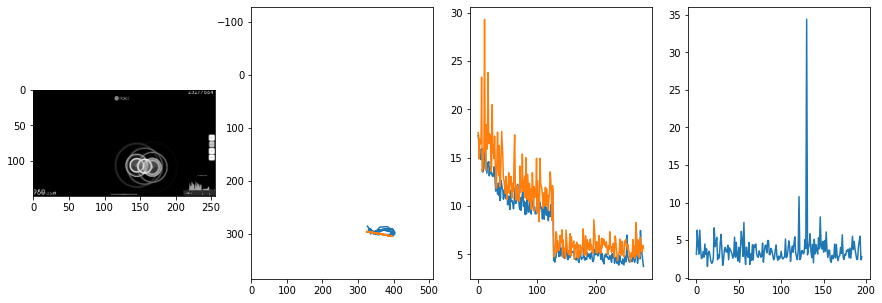


 287 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.48it/s  3.4404                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.601630878691771
outliers: 88
retrain: 4                 
val: 50/50 loss: 3.9210                                    
pred: 0.47767406702041626 0.5951740741729736
gt: 0.7109367847442627 0.8645824790000916
(158, 118)


<Figure size 1080x360 with 0 Axes>

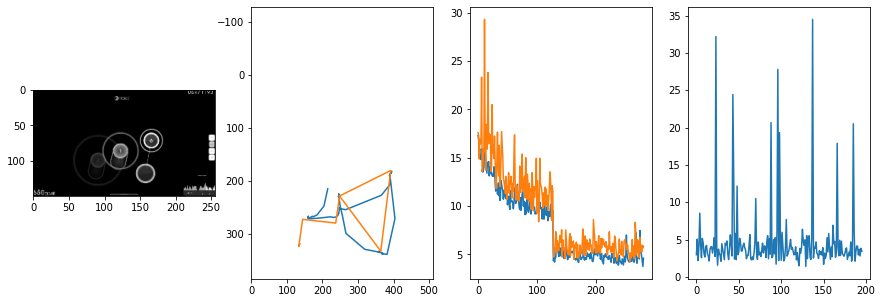


 288 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.73it/s  2.1697                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.623668435276771
outliers: 37
retrain: 4                 
val: 50/50 loss: 5.8114                                    
pred: 0.5550029873847961 0.5517125129699707
gt: 0.4228367209434509 0.4201938807964325
(113, 66)


<Figure size 1080x360 with 0 Axes>

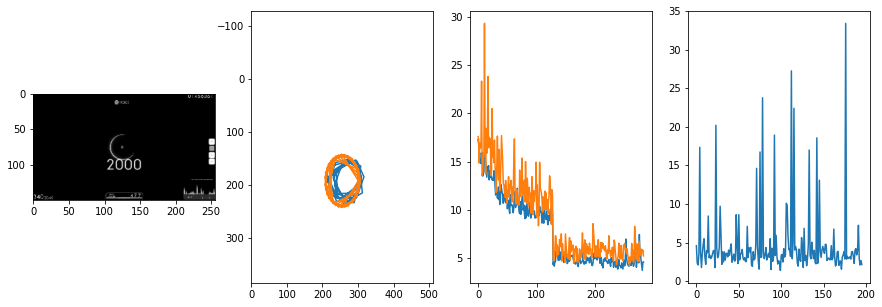


 289 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.73it/s  3.1045                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.518732668185721
outliers: 45
retrain: 4                 
val: 50/50 loss: 3.5322                                    
pred: 0.18248872458934784 0.643323540687561
gt: 0.16863401234149933 0.5527636408805847
(74, 82)


<Figure size 1080x360 with 0 Axes>

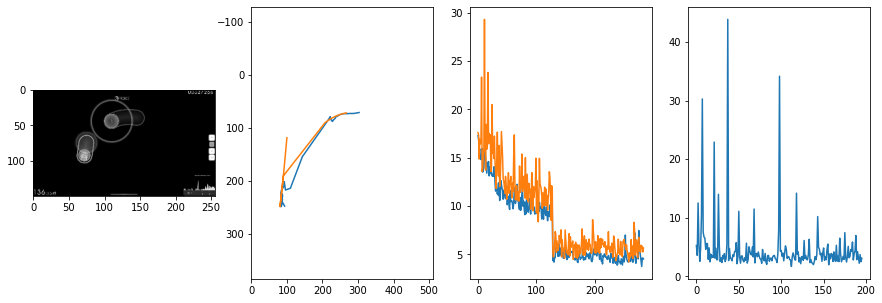


 290 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.27it/s  3.2855                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.422553931572
outliers: 38
retrain: 4                 
val: 50/50 loss: 4.7250                                    
pred: 0.45765072107315063 0.07767564803361893
gt: 0.6874977946281433 0.4166660010814667
(154, 66)


<Figure size 1080x360 with 0 Axes>

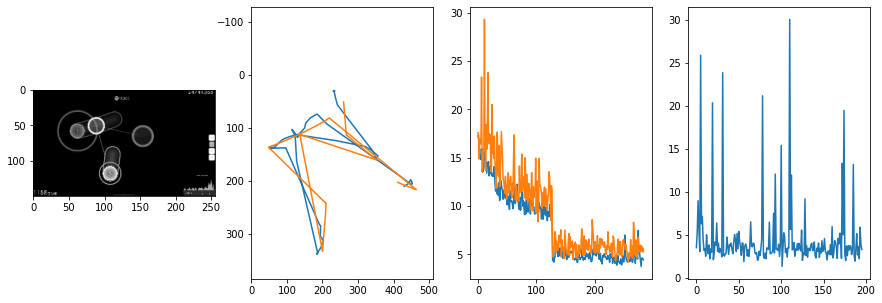


 291 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  25.1545                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.890453818501259
outliers: 49
retrain: 4                 
val: 50/50 loss: 2.5756                                    
pred: 0.43573707342147827 0.31836920976638794
gt: 0.4375 0.3125
(115, 54)


<Figure size 1080x360 with 0 Axes>

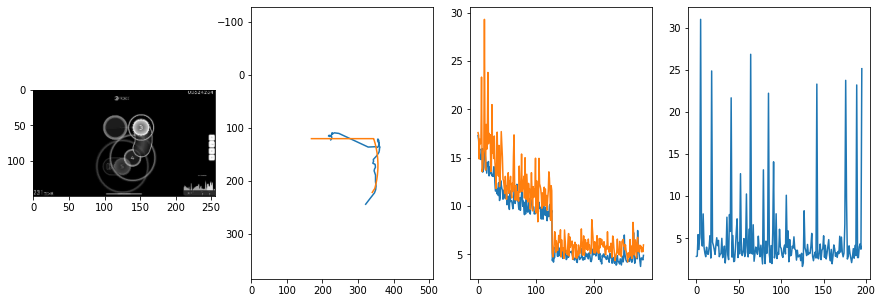


 292 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.79it/s  26.4549                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.436670458438445
outliers: 41
retrain: 4                 
val: 50/50 loss: 5.7293                                    
pred: 0.6878786683082581 0.29537707567214966
gt: 0.6894530653953552 0.4609375298023224
(154, 71)


<Figure size 1080x360 with 0 Axes>

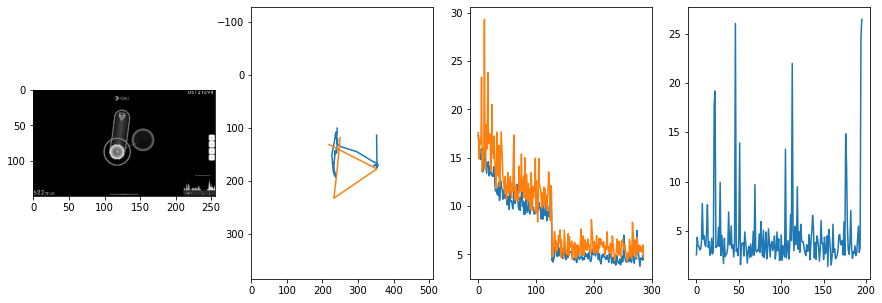


 293 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.81it/s  3.3486                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.639134889354511
outliers: 45
retrain: 4                 
val: 50/50 loss: 5.0337                                    
pred: 0.6101629734039307 0.5040428638458252
gt: 0.319591224193573 0.7512770295143127
(97, 105)


<Figure size 1080x360 with 0 Axes>

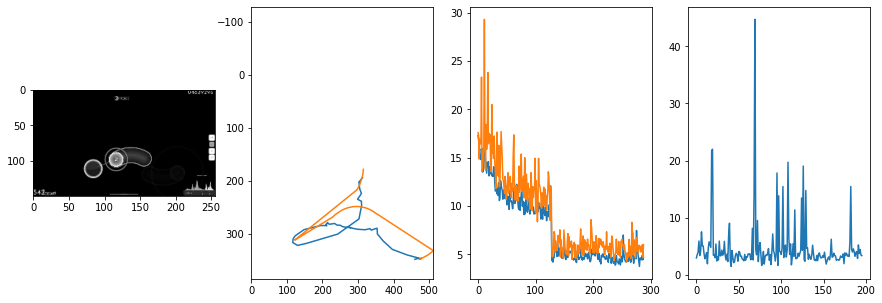


 294 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.76it/s  3.1261                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.271146526142043
outliers: 42
retrain: 4                 
val: 50/50 loss: 4.1011                                    
pred: 0.9409095048904419 0.6230952739715576
gt: 0.6601560711860657 0.9088541865348816
(150, 123)


<Figure size 1080x360 with 0 Axes>

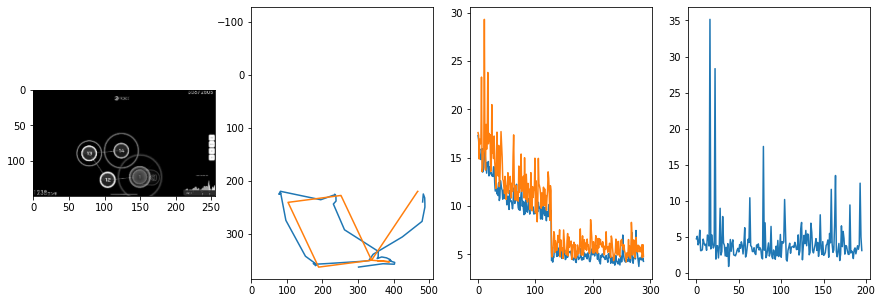


 295 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  4.4803                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.58660931003337
outliers: 55
retrain: 4                 
val: 50/50 loss: 7.1029                                    
pred: 0.34615200757980347 0.2404107004404068
gt: 0.5229538083076477 0.7659531235694885
(129, 107)


<Figure size 1080x360 with 0 Axes>

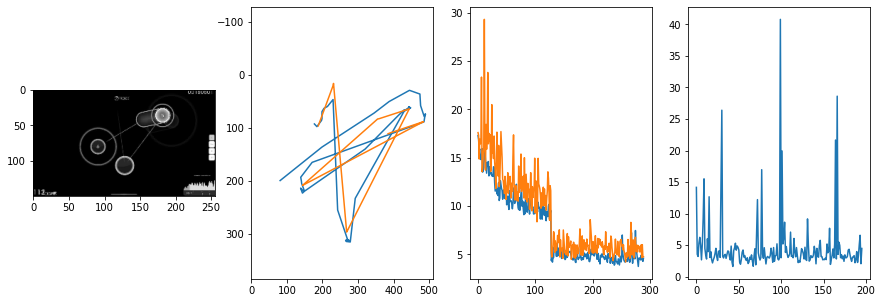


 296 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.36it/s  5.0442                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.262740343809128
outliers: 34
retrain: 4                 
val: 50/50 loss: 4.8009                                    
pred: 0.5008785128593445 0.6862227320671082
gt: 0.549950122833252 0.5323995351791382
(133, 79)


<Figure size 1080x360 with 0 Axes>

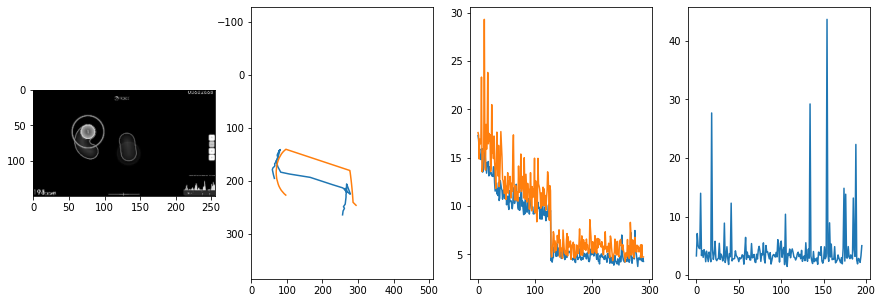


 297 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  5.3671                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.510797154538485
outliers: 50
retrain: 4                 
val: 50/50 loss: 2.8645                                    
pred: 0.6078042984008789 0.685167670249939
gt: 0.6803749799728394 0.5634166598320007
(153, 83)


<Figure size 1080x360 with 0 Axes>

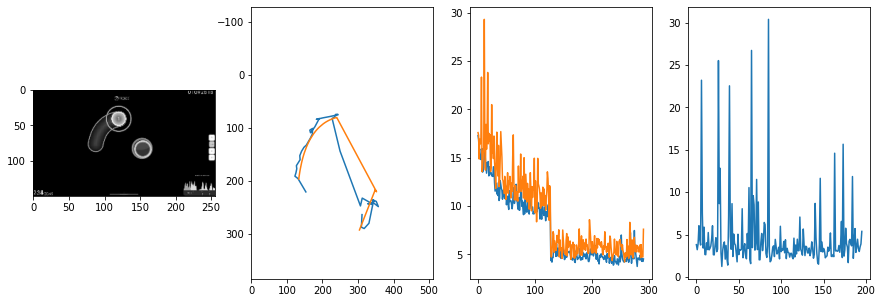


 298 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  8.2197                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.0119638917397475
outliers: 32
retrain: 4                 
val: 50/50 loss: 2.4250                                    
pred: 0.4733791947364807 0.506121814250946
gt: 0.5953512191772461 0.5281233191490173
(140, 79)


<Figure size 1080x360 with 0 Axes>

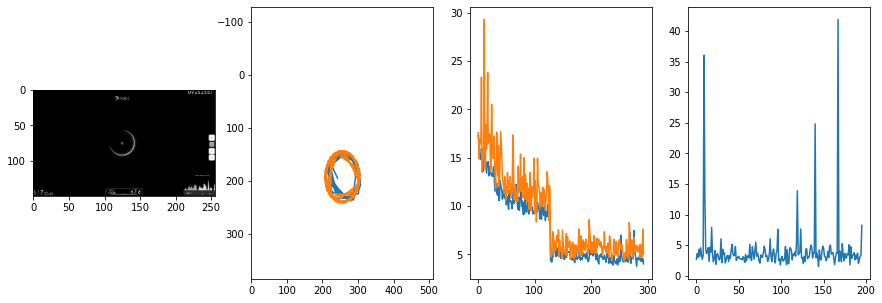


 299 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  7.3837                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.321100589572167
outliers: 54
retrain: 4                 
val: 50/50 loss: 4.8828                                    
pred: 0.29984578490257263 0.03729455918073654
gt: 0.1173696219921112 0.0026388566475361586
(66, 18)


<Figure size 1080x360 with 0 Axes>

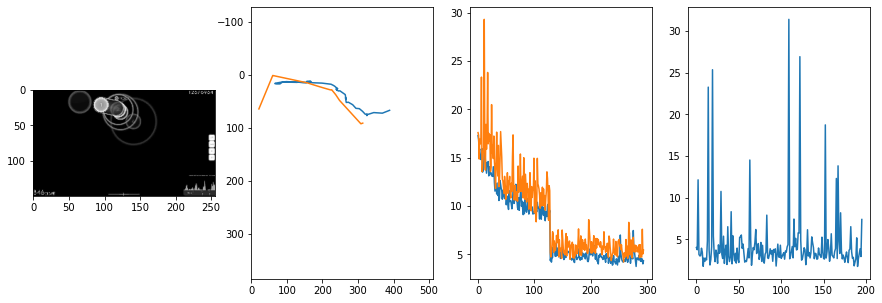


 300 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  3.7783                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.720909986568957
outliers: 53
retrain: 4                 
val: 50/50 loss: 4.0297                                    
pred: 0.5185410976409912 0.7702178359031677
gt: 0.7313451766967773 0.942326545715332
(161, 127)


<Figure size 1080x360 with 0 Axes>

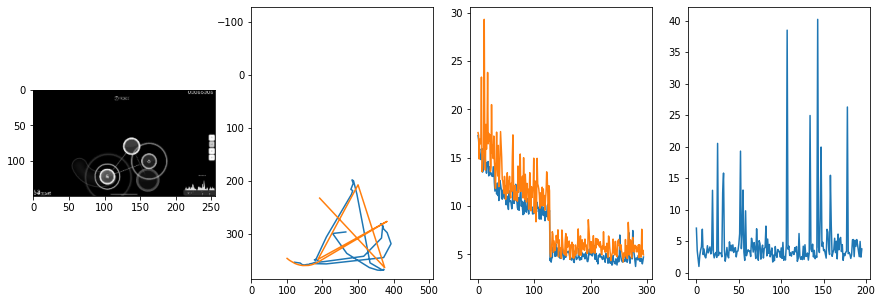


 301 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.85it/s  2.9319                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.239844865944921
outliers: 43
retrain: 4                 
val: 50/50 loss: 5.5816                                    
pred: 0.37074530124664307 0.8236968517303467
gt: 0.6100627183914185 0.865940272808075
(142, 118)


<Figure size 1080x360 with 0 Axes>

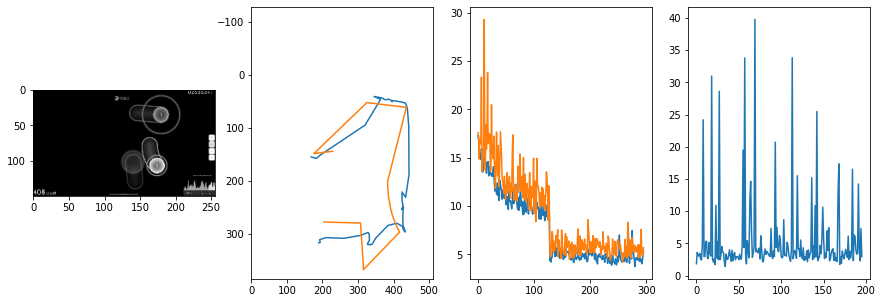


 302 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.74it/s  2.7671                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.177466114564818
outliers: 39
retrain: 4                 
val: 50/50 loss: 3.0677                                    
pred: 0.4753505289554596 0.5607551336288452
gt: 0.5053123831748962 0.3699844777584076
(126, 61)


<Figure size 1080x360 with 0 Axes>

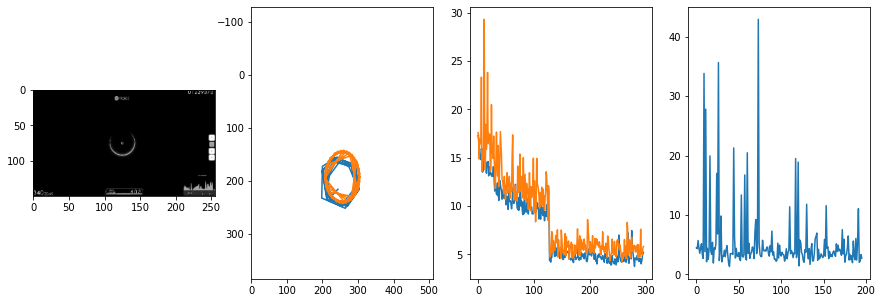


 303 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  4.0382                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.179521177496229
outliers: 27
retrain: 4                 
val: 50/50 loss: 2.6192                                    
pred: 0.2835233211517334 0.6373854279518127
gt: 0.3744578957557678 0.5652487277984619
(106, 83)


<Figure size 1080x360 with 0 Axes>

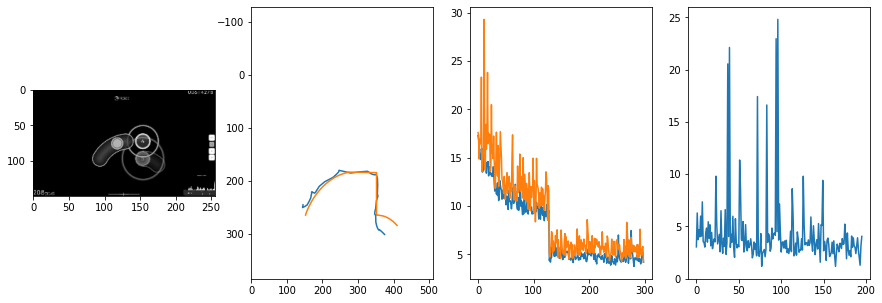


 304 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  2.9039                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.663688079739104
outliers: 67
retrain: 4                 
val: 50/50 loss: 4.3306                                    
pred: 0.3915475904941559 0.8529459834098816
gt: 0.7178518176078796 0.5015188455581665
(159, 76)


<Figure size 1080x360 with 0 Axes>

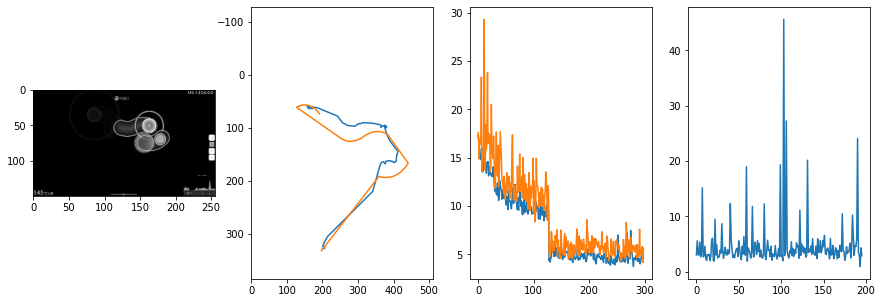


 305 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  5.9939                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.388028754263508
outliers: 37
retrain: 4                 
val: 50/50 loss: 6.8010                                    
pred: 0.4057862162590027 0.8135996460914612
gt: 0.4341494143009186 0.8231622576713562
(115, 113)


<Figure size 1080x360 with 0 Axes>

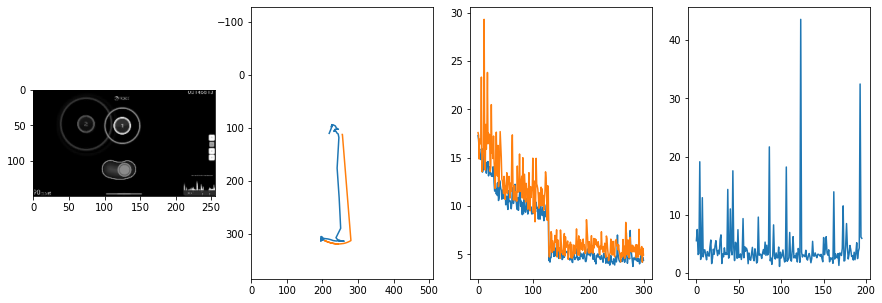


 306 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  3.1145                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.389317721736674
outliers: 43
retrain: 4                 
val: 50/50 loss: 3.0267                                    
pred: 0.36802664399147034 0.19011440873146057
gt: 0.35937657952308655 0.27083495259284973
(103, 49)


<Figure size 1080x360 with 0 Axes>

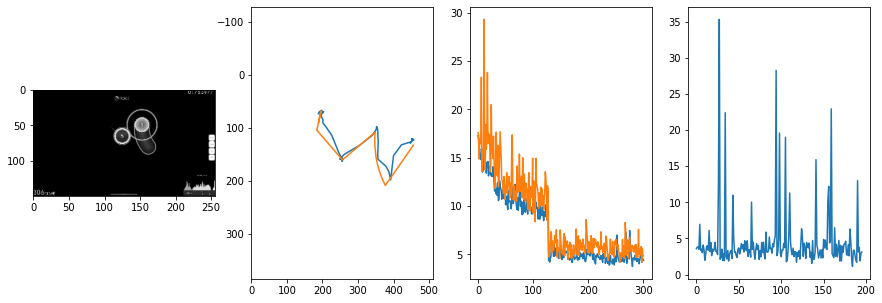


 307 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.83it/s  4.1226                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.353735465480357
outliers: 44
retrain: 4                 
val: 50/50 loss: 5.3593                                    
pred: 0.5577458739280701 0.20215259492397308
gt: 0.7246090769767761 0.08333320170640945
(160, 27)


<Figure size 1080x360 with 0 Axes>

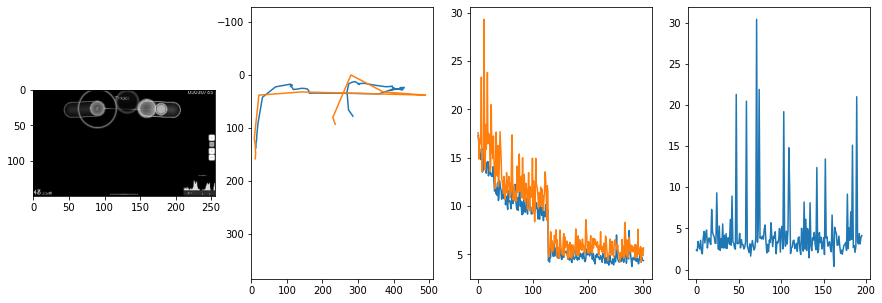


 308 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  2.4586                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.130964577198029
outliers: 58
retrain: 4                 
val: 50/50 loss: 5.9202                                    
pred: 0.4514024257659912 0.864055335521698
gt: 0.8748044371604919 0.8542001247406006
(183, 117)


<Figure size 1080x360 with 0 Axes>

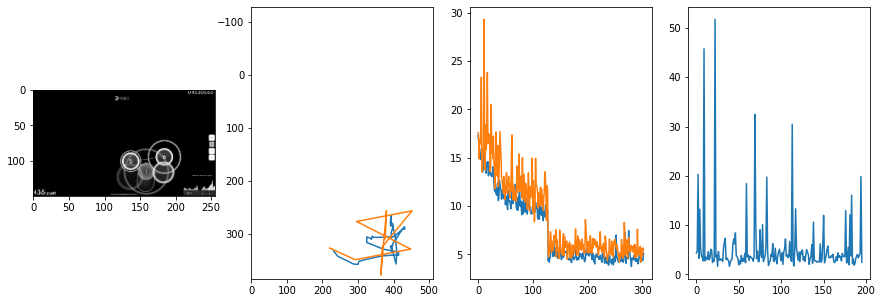


 309 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  2.9784                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.659469204897783
outliers: 26
retrain: 4                 
val: 50/50 loss: 6.0694                                    
pred: 0.734568178653717 0.565321683883667
gt: 0.8281248807907104 0.3333354890346527
(176, 56)


<Figure size 1080x360 with 0 Axes>

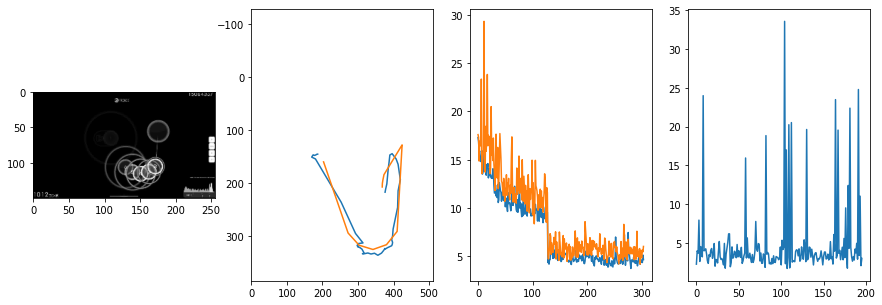


 310 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.80it/s  2.7560                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.842122549913367
outliers: 53
retrain: 4                 
val: 50/50 loss: 3.6670                                    
pred: 0.3533570170402527 0.2475791871547699
gt: 0.2901575565338135 0.3835581839084625
(92, 62)


<Figure size 1080x360 with 0 Axes>

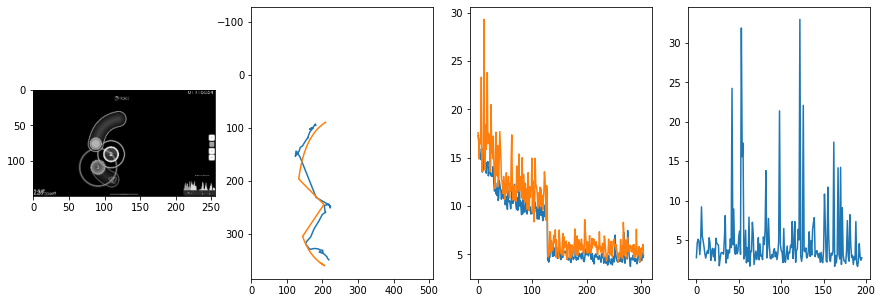


 311 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.75it/s  2.1559                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.233480419431414
outliers: 27
retrain: 4                 
val: 50/50 loss: 9.8167                                    
pred: 0.45083707571029663 0.4988764822483063
gt: 0.5012817978858948 0.5
(125, 76)


<Figure size 1080x360 with 0 Axes>

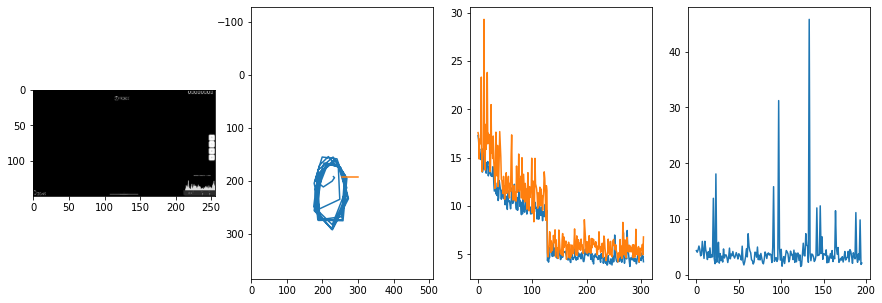


 312 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.88it/s  3.1469                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.34505823923617
outliers: 52
retrain: 4                 
val: 50/50 loss: 5.6409                                    
pred: 0.6064148545265198 0.8401184678077698
gt: 0.5703124403953552 0.8125
(136, 112)


<Figure size 1080x360 with 0 Axes>

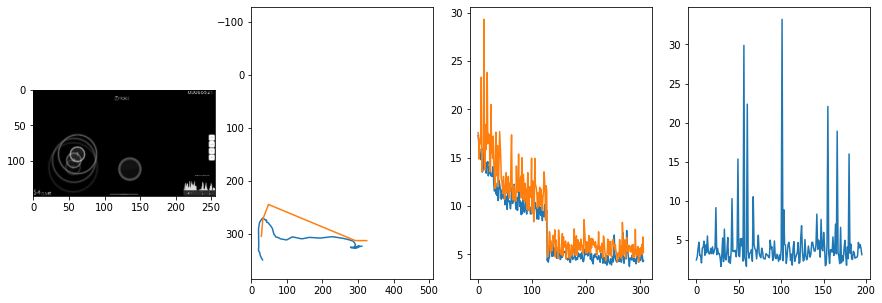


 313 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  2.5854                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.142060447712334
outliers: 44
retrain: 4                 
val: 50/50 loss: 5.0807                                    
pred: 0.22971466183662415 0.4579434394836426
gt: 0.515625 0.3333333432674408
(127, 56)


<Figure size 1080x360 with 0 Axes>

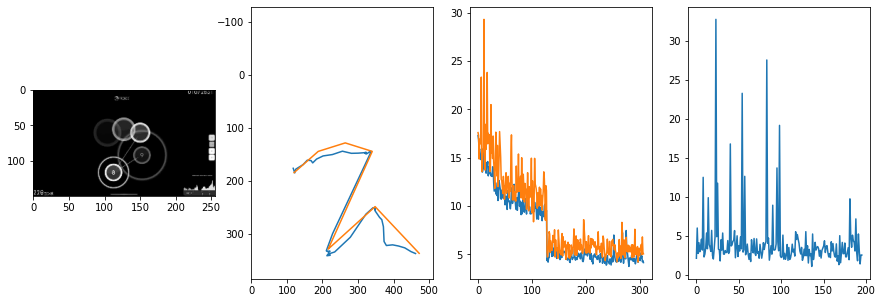


 314 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.88it/s  5.0628                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.809563155076941
outliers: 53
retrain: 4                 
val: 50/50 loss: 3.6988                                    
pred: 0.40150490403175354 0.7767502665519714
gt: 0.26171875 0.7447916865348816
(88, 104)


<Figure size 1080x360 with 0 Axes>

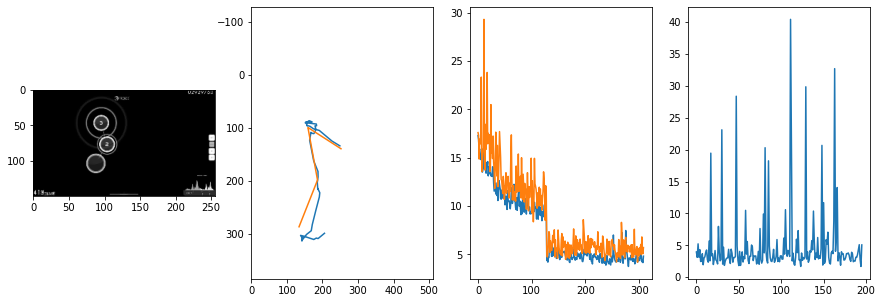


 315 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.95it/s  2.2430                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.762432595296782
outliers: 39
retrain: 4                 
val: 50/50 loss: 4.4339                                    
pred: 0.3802763819694519 0.2129688709974289
gt: 0.3736899793148041 0.33186376094818115
(105, 56)


<Figure size 1080x360 with 0 Axes>

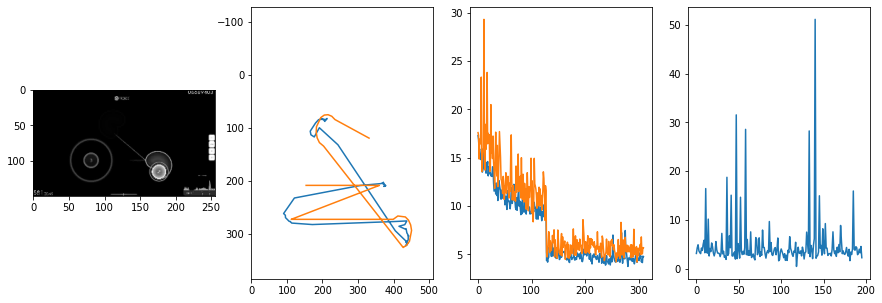


 316 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  3.3096                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.737050386107698
outliers: 38
retrain: 4                 
val: 50/50 loss: 7.2423                                    
pred: 0.18475641310214996 0.43054452538490295
gt: 0.8125 0.4583333432674408
(174, 71)


<Figure size 1080x360 with 0 Axes>

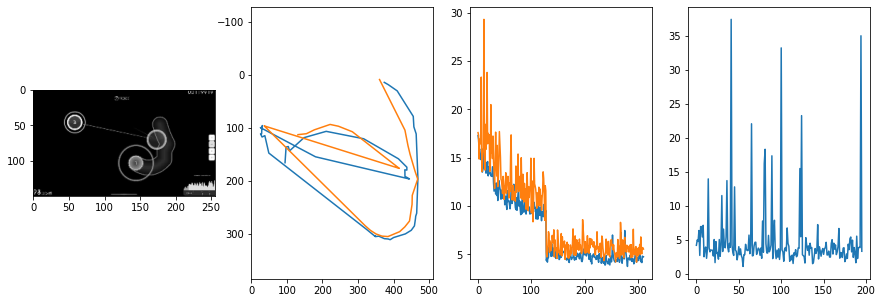


 317 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.76it/s  2.7417                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.730551193563306
outliers: 35
retrain: 4                 
val: 50/50 loss: 4.2280                                    
pred: 0.4200090765953064 0.8538299798965454
gt: 0.4055982232093811 0.781697690486908
(110, 108)


<Figure size 1080x360 with 0 Axes>

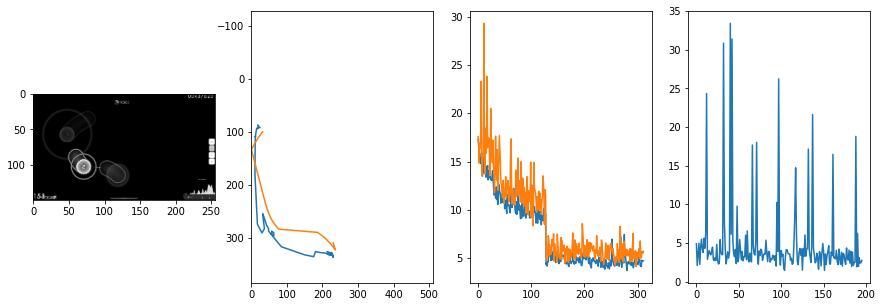


 318 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.85it/s  3.2558                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.601851768639623
outliers: 35
retrain: 4                 
val: 50/50 loss: 3.8016                                    
pred: 0.3417833149433136 0.5295445322990417
gt: 0.49929726123809814 0.5919110774993896
(125, 86)


<Figure size 1080x360 with 0 Axes>

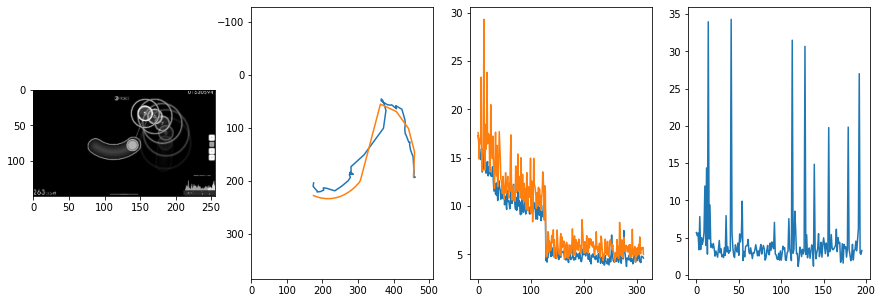


 319 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  5.0430                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.364413017216994
outliers: 35
retrain: 4                 
val: 50/50 loss: 5.1201                                    
pred: 0.4139629304409027 0.37625184655189514
gt: 0.582249104976654 0.3410208225250244
(138, 57)


<Figure size 1080x360 with 0 Axes>

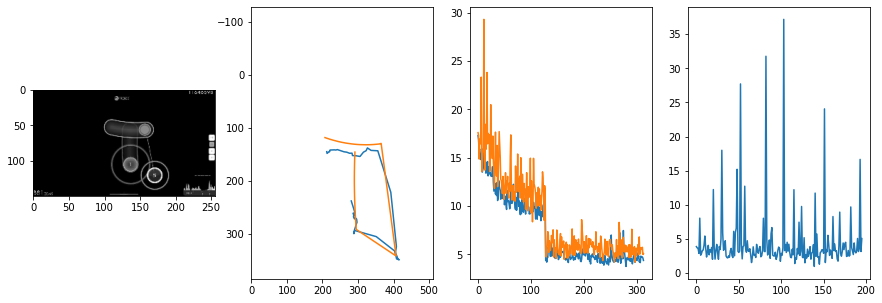


 320 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  2.9316                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.304581103884444
outliers: 39
retrain: 4                 
val: 50/50 loss: 4.5630                                    
pred: 0.8241015672683716 0.8206788301467896
gt: 0.8896498680114746 0.5668691396713257
(185, 83)


<Figure size 1080x360 with 0 Axes>

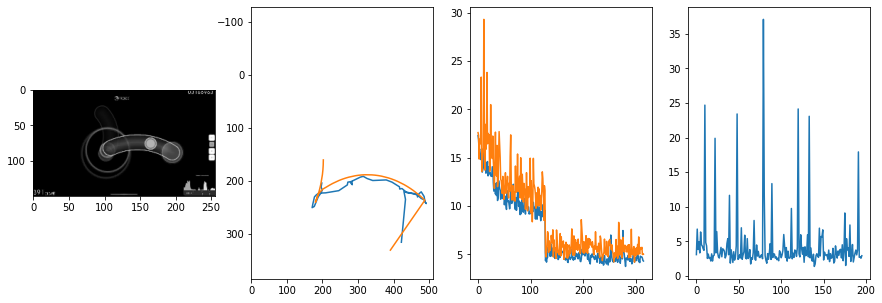


 321 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.90it/s  3.8441                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.196003465628137
outliers: 39
retrain: 4                 
val: 50/50 loss: 2.8274                                    
pred: 0.1752941906452179 0.9369856715202332
gt: 0.3207084834575653 0.9291061758995056
(97, 126)


<Figure size 1080x360 with 0 Axes>

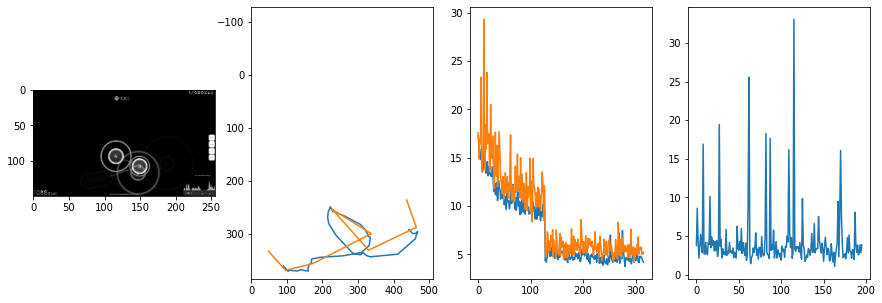


 322 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  3.2854                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.211968089244803
outliers: 46
retrain: 4                 
val: 50/50 loss: 4.8909                                    
pred: 0.32422417402267456 0.6732648015022278
gt: 0.33270618319511414 0.6709179878234863
(99, 96)


<Figure size 1080x360 with 0 Axes>

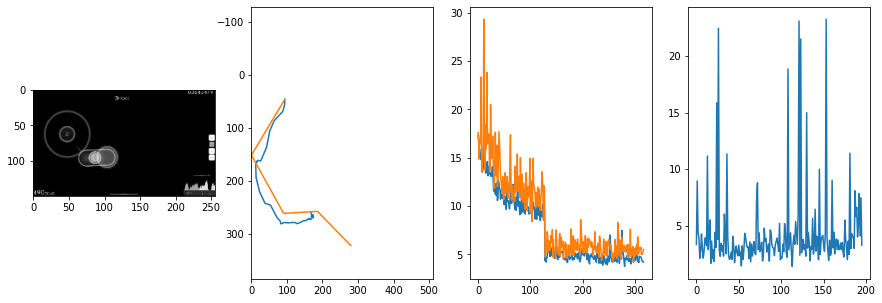


 323 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.80it/s  2.7827                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.069743135753943
outliers: 60
retrain: 4                 
val: 50/50 loss: 5.7819                                    
pred: 0.9583166837692261 0.771565854549408
gt: 0.7792046070098877 0.2663564383983612
(168, 48)


<Figure size 1080x360 with 0 Axes>

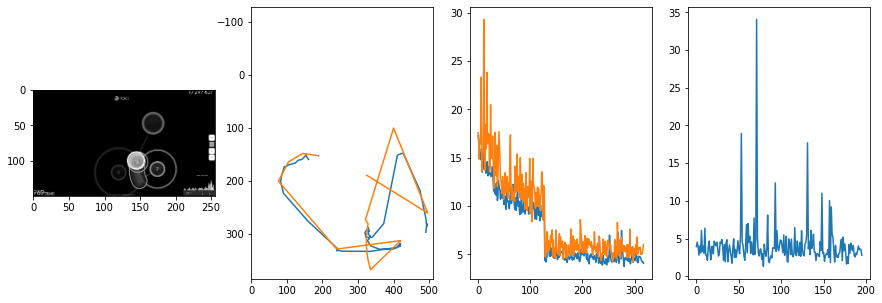


 324 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.70it/s  6.3409                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.371508805727472
outliers: 55
retrain: 4                 
val: 50/50 loss: 4.7093                                    
pred: 0.49663034081459045 0.5536110401153564
gt: 0.43751755356788635 0.5703257322311401
(115, 84)


<Figure size 1080x360 with 0 Axes>

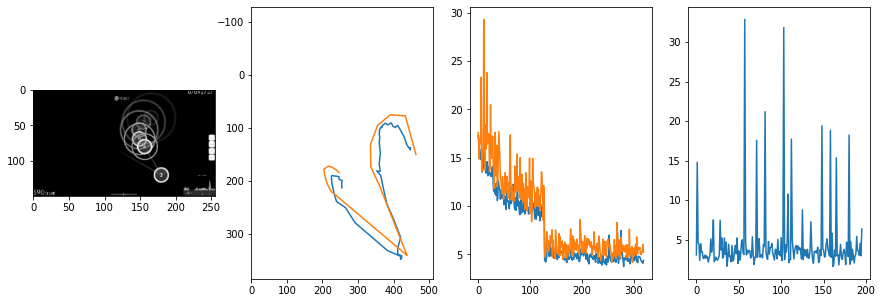


 325 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.99it/s  3.3534                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.805676480945276
outliers: 56
retrain: 4                 
val: 50/50 loss: 2.6535                                    
pred: 0.8032119870185852 0.6144717931747437
gt: 0.7421880960464478 0.8958302140235901
(163, 122)


<Figure size 1080x360 with 0 Axes>

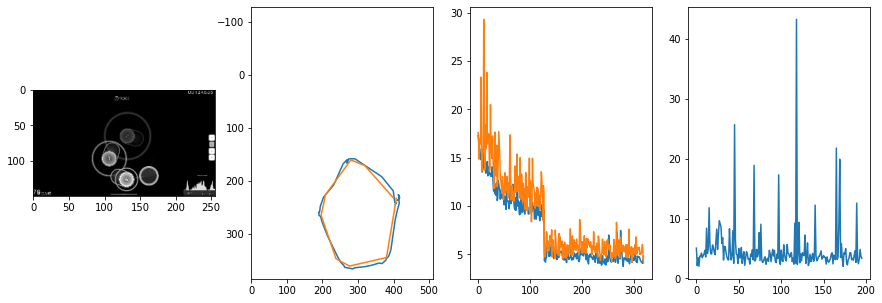


 326 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.73it/s  1.8359                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.5364810277004635
outliers: 35
retrain: 4                 
val: 50/50 loss: 2.7841                                    
pred: 0.83479243516922 0.15879012644290924
gt: 0.831095814704895 0.2169640213251114
(176, 43)


<Figure size 1080x360 with 0 Axes>

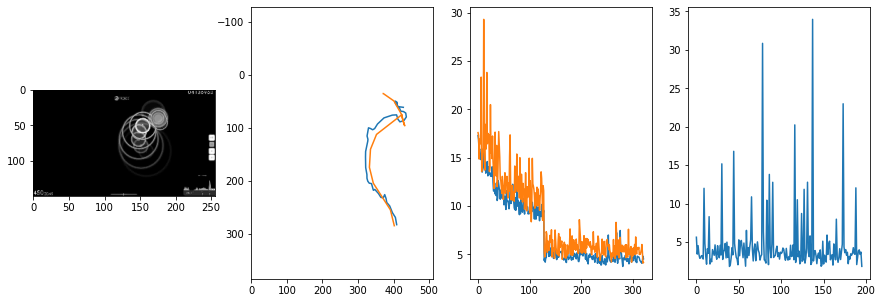


 327 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  4.5434                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.387221535249632
outliers: 41
retrain: 4                 
val: 50/50 loss: 9.1997                                    
pred: 0.42099523544311523 0.5480705499649048
gt: 0.49984145164489746 0.49995267391204834
(125, 76)


<Figure size 1080x360 with 0 Axes>

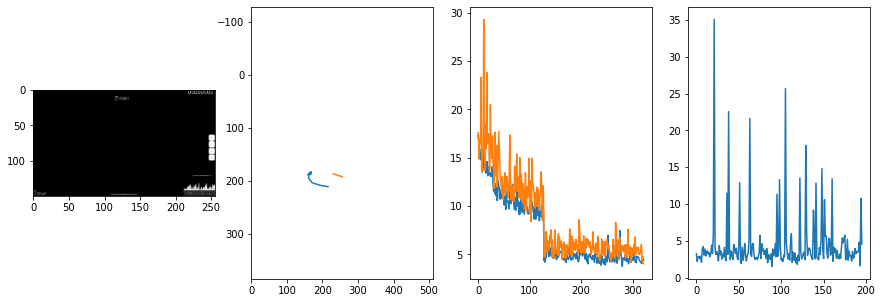


 328 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.54it/s  2.8803                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.636995838612926
outliers: 56
retrain: 4                 
val: 50/50 loss: 2.0940                                    
pred: 0.6438059210777283 0.6362298727035522
gt: 0.5916228890419006 0.640550971031189
(139, 92)


<Figure size 1080x360 with 0 Axes>

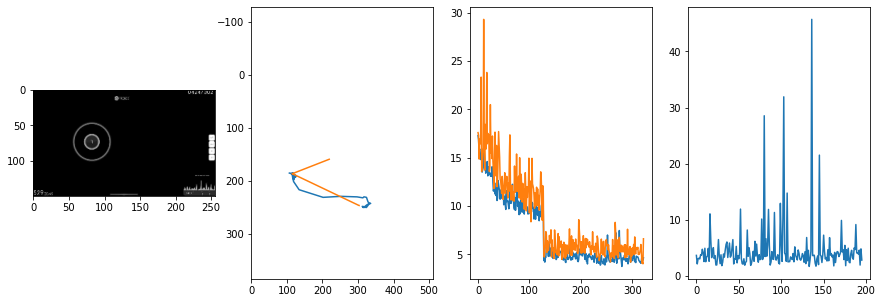


 329 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.75it/s  2.9688                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.332860597542354
outliers: 34
retrain: 4                 
val: 50/50 loss: 4.4293                                    
pred: 0.7688988447189331 0.8126507997512817
gt: 0.720703125 0.765625
(159, 107)


<Figure size 1080x360 with 0 Axes>

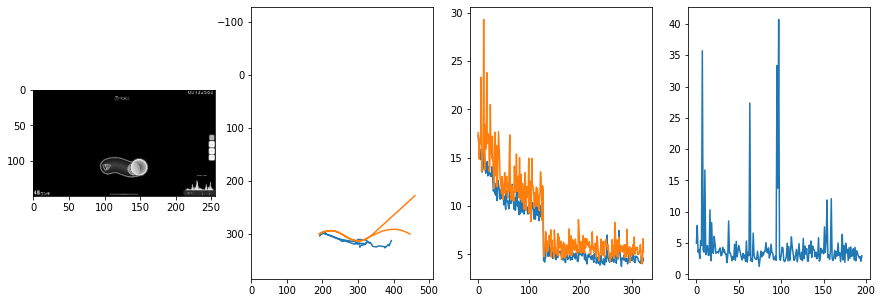


 330 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.28it/s  4.4625                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.52112689675117
outliers: 87
retrain: 4                 
val: 50/50 loss: 3.8124                                    
pred: 0.8066293597221375 0.8177304267883301
gt: 0.9853555560112 0.4765636920928955
(200, 73)


<Figure size 1080x360 with 0 Axes>

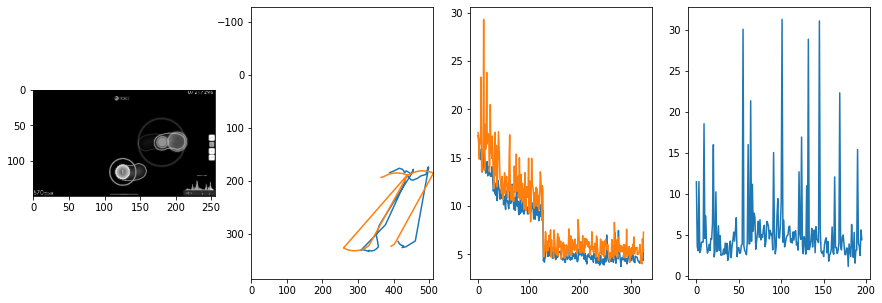


 331 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  2.6650                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.8274849373467115
outliers: 36
retrain: 4                 
val: 50/50 loss: 4.5535                                    
pred: 0.9250540137290955 0.7382460832595825
gt: 0.9394846558570862 0.9506042003631592
(193, 128)


<Figure size 1080x360 with 0 Axes>

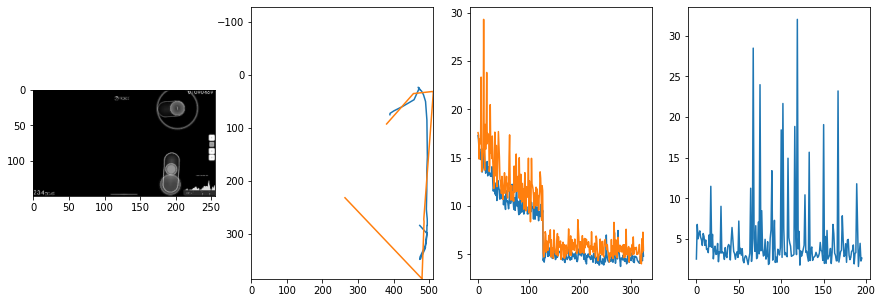


 332 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.78it/s  3.6544                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.130468777247837
outliers: 27
retrain: 4                 
val: 50/50 loss: 5.5047                                    
pred: 0.48016372323036194 0.5212092399597168
gt: 0.46875059604644775 0.08334112167358398
(120, 27)


<Figure size 1080x360 with 0 Axes>

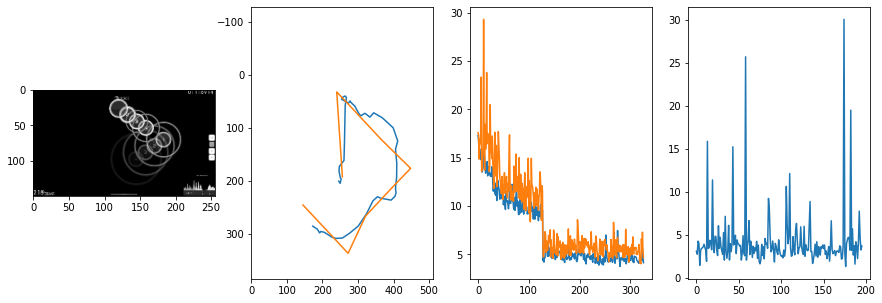


 333 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.96it/s  3.2445                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.0728268830143675
outliers: 52
retrain: 4                 
val: 50/50 loss: 2.4137                                    
pred: 0.8252324461936951 0.6208503842353821
gt: 0.8108403086662292 0.6133350133895874
(173, 89)


<Figure size 1080x360 with 0 Axes>

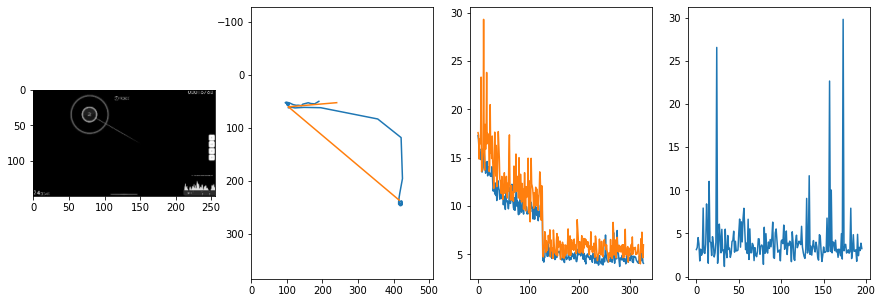


 334 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.81it/s  3.0269                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.337763897010258
outliers: 59
retrain: 4                 
val: 50/50 loss: 3.2208                                    
pred: 0.6046687364578247 0.5720916986465454
gt: 0.7290014028549194 0.48548856377601624
(161, 74)


<Figure size 1080x360 with 0 Axes>

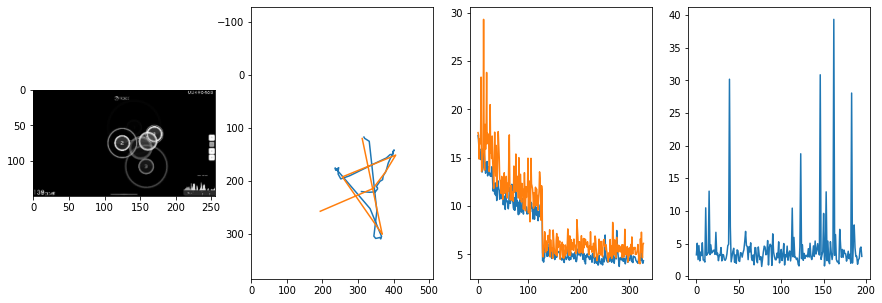


 335 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  3.5405                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.065284469906165
outliers: 32
retrain: 4                 
val: 50/50 loss: 3.2499                                    
pred: 0.8294036984443665 0.5488643050193787
gt: 0.7031363248825073 0.4166681468486786
(157, 66)


<Figure size 1080x360 with 0 Axes>

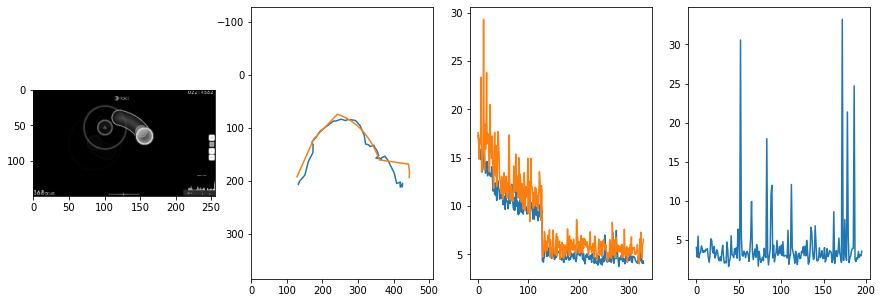


 336 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  4.3902                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.7145544579442666
outliers: 38
retrain: 4                 
val: 50/50 loss: 2.3106                                    
pred: 0.7733749747276306 0.20848725736141205
gt: 0.62109375 0.0807291641831398
(144, 27)


<Figure size 1080x360 with 0 Axes>

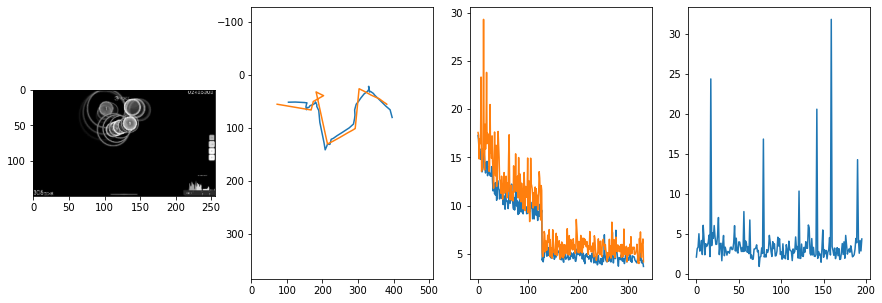


 337 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  3.0491                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.526409707507309
outliers: 67
retrain: 4                 
val: 50/50 loss: 5.4238                                    
pred: 0.548156201839447 0.5548064708709717
gt: 0.5294374227523804 0.37584826350212097
(130, 61)


<Figure size 1080x360 with 0 Axes>

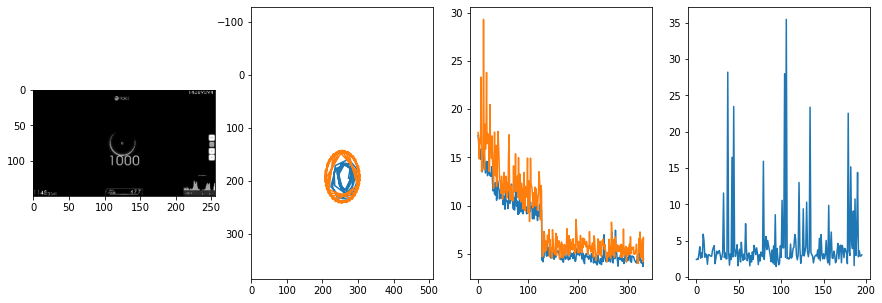


 338 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.03it/s  3.3301                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.590246621443301
outliers: 45
retrain: 4                 
val: 50/50 loss: 3.7546                                    
pred: 0.20962883532047272 0.4381827712059021
gt: 0.5111405253410339 0.20235420763492584
(127, 41)


<Figure size 1080x360 with 0 Axes>

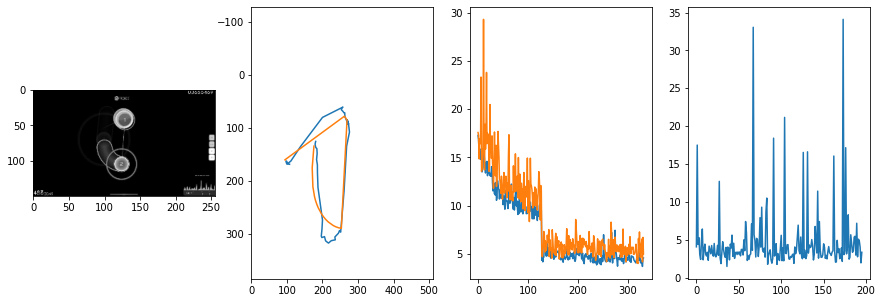


 339 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  8.9319                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.686199050776812
outliers: 47
retrain: 4                 
val: 50/50 loss: 4.0855                                    
pred: 0.2665088176727295 0.6960476636886597
gt: 0.5917968153953552 0.640625
(139, 92)


<Figure size 1080x360 with 0 Axes>

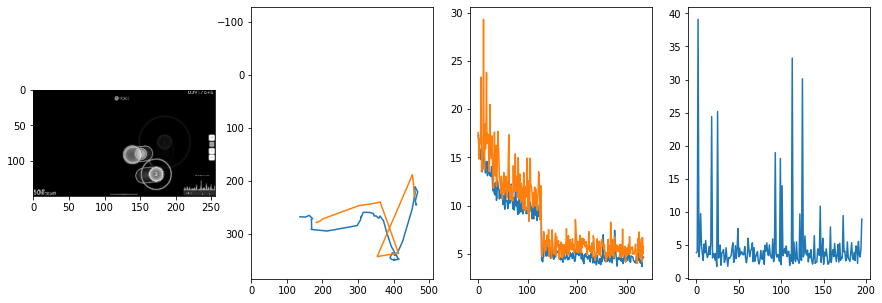


 340 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.79it/s  5.1131                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.40351282212199
outliers: 42
retrain: 4                 
val: 50/50 loss: 2.9792                                    
pred: 0.6314027309417725 0.38242605328559875
gt: 0.6708577275276184 0.5785861015319824
(152, 85)


<Figure size 1080x360 with 0 Axes>

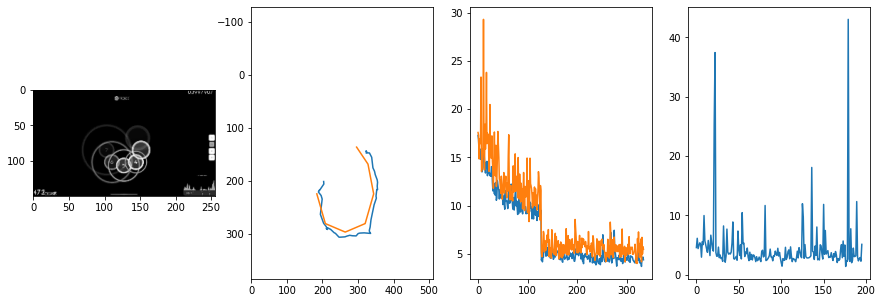


 341 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.91it/s  3.1653                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.151963236380596
outliers: 40
retrain: 4                 
val: 50/50 loss: 4.0182                                    
pred: 0.2397185117006302 0.13446374237537384
gt: 0.5827406048774719 0.11022450774908066
(138, 30)


<Figure size 1080x360 with 0 Axes>

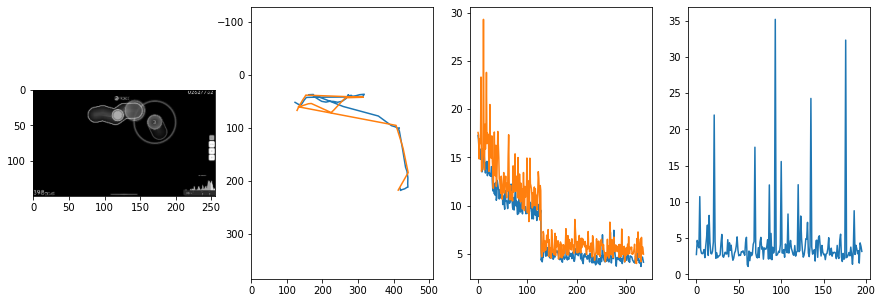


 342 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  3.0226                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.6955052048576125
outliers: 54
retrain: 4                 
val: 50/50 loss: 3.7091                                    
pred: 0.8333969116210938 0.6499486565589905
gt: 0.8497956991195679 0.5369165539741516
(179, 80)


<Figure size 1080x360 with 0 Axes>

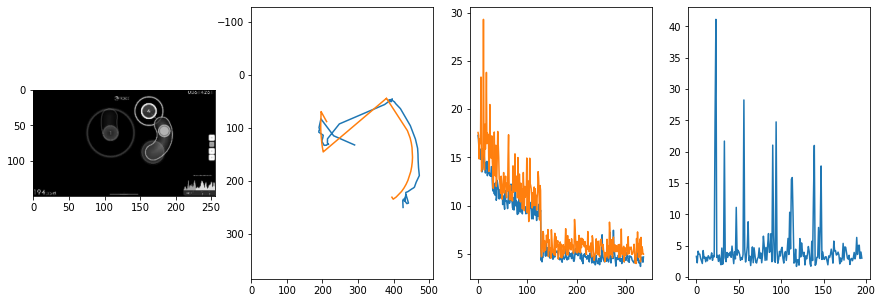


 343 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.21it/s  3.5558                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.402656272357824
outliers: 35
retrain: 4                 
val: 50/50 loss: 3.9785                                    
pred: 0.39796334505081177 0.7166101932525635
gt: 0.2370157092809677 0.8394584655761719
(84, 115)


<Figure size 1080x360 with 0 Axes>

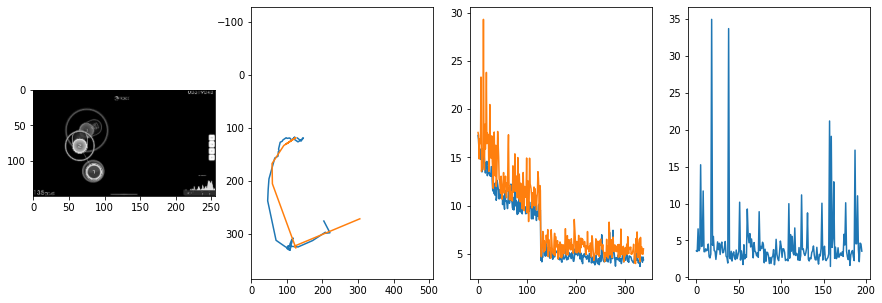


 344 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.83it/s  2.6884                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.8607867402689795
outliers: 51
retrain: 4                 
val: 50/50 loss: 8.2759                                    
pred: 0.06895890086889267 0.5930083394050598
gt: 0.11787532269954681 0.6050837635993958
(66, 88)


<Figure size 1080x360 with 0 Axes>

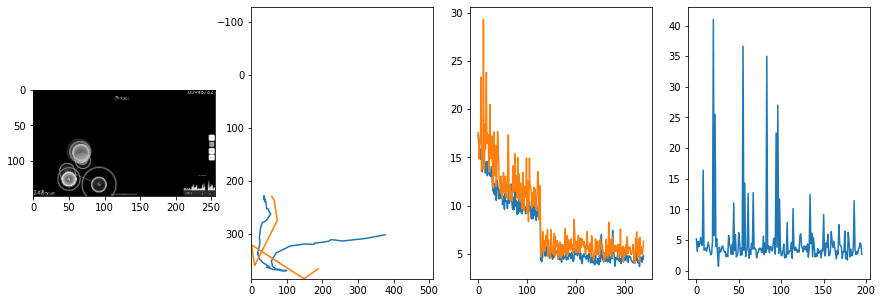


 345 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.08it/s  2.8314                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.7518578141319505
outliers: 38
retrain: 4                 
val: 50/50 loss: 3.3236                                    
pred: 0.20830851793289185 0.6657140851020813
gt: 0.5053048729896545 0.9091041088104248
(126, 123)


<Figure size 1080x360 with 0 Axes>

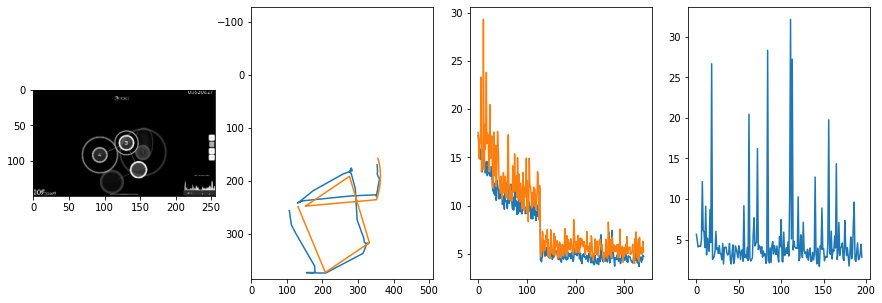


 346 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.86it/s  2.7261                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.77634063119791
outliers: 35
retrain: 4                 
val: 50/50 loss: 13.1441                                   
pred: 0.3943755626678467 0.5654788017272949
gt: 0.5 0.5
(125, 76)


<Figure size 1080x360 with 0 Axes>

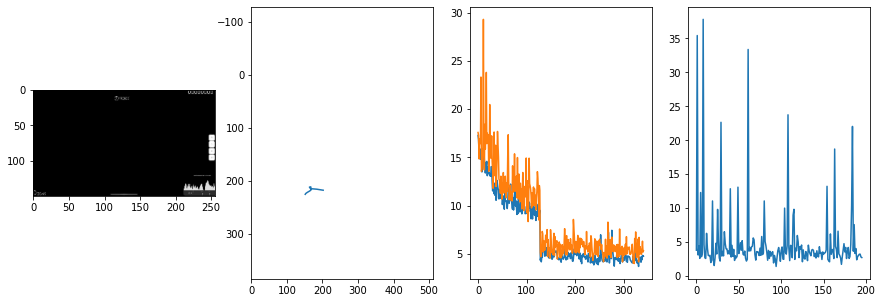


 347 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.67it/s  3.7660                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.489376962184906
outliers: 37
retrain: 4                 
val: 50/50 loss: 4.8556                                    
pred: 0.34997618198394775 0.31560689210891724
gt: 0.3515326976776123 0.3312634527683258
(102, 56)


<Figure size 1080x360 with 0 Axes>

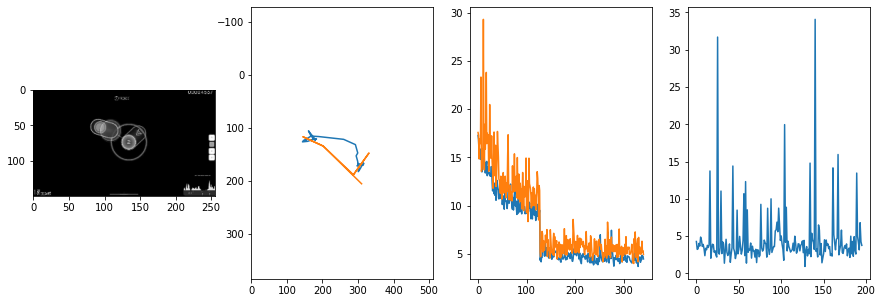


 348 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.90it/s  2.9164                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.648048579692841
outliers: 47
retrain: 4                 
val: 50/50 loss: 4.7161                                    
pred: 0.2702715992927551 0.7548070549964905
gt: 0.2832464277744293 0.7343289852142334
(91, 103)


<Figure size 1080x360 with 0 Axes>

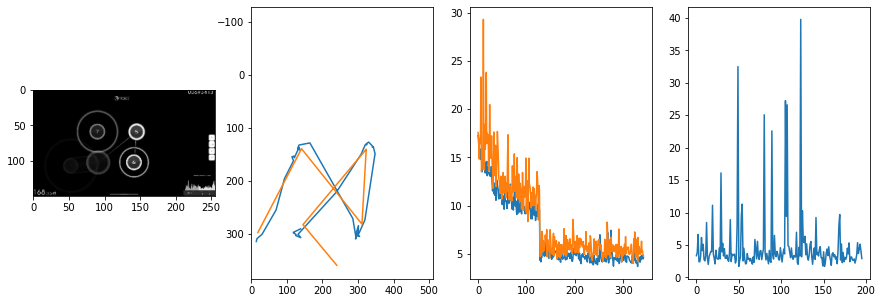


 349 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.02it/s  3.8391                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.949020486096947
outliers: 46
retrain: 4                 
val: 50/50 loss: 4.0377                                    
pred: 0.47446200251579285 0.565603494644165
gt: 0.4666975438594818 0.37612059712409973
(120, 61)


<Figure size 1080x360 with 0 Axes>

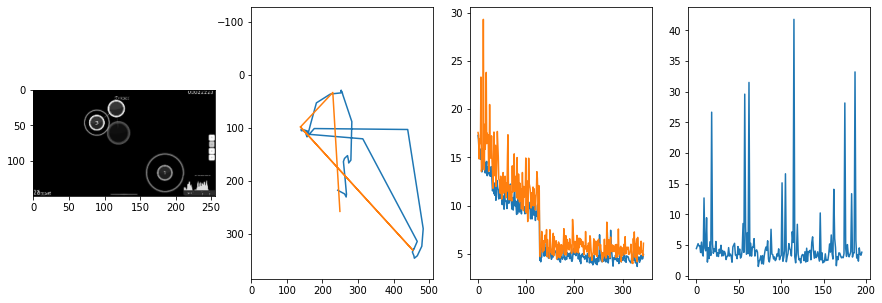


 350 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.86it/s  3.2287                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.030887122665133
outliers: 42
retrain: 4                 
val: 50/50 loss: 4.7022                                    
pred: 0.24862684309482574 0.675693154335022
gt: 0.3295523226261139 0.5999194383621216
(99, 87)


<Figure size 1080x360 with 0 Axes>

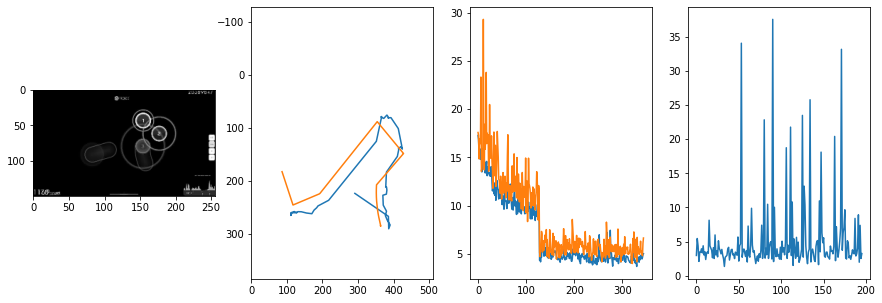


 351 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  3.2040                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.596646816754828
outliers: 28
retrain: 4                 
val: 50/50 loss: 4.2605                                    
pred: 0.7522454261779785 0.7976524829864502
gt: 0.9179686903953552 0.765625
(190, 107)


<Figure size 1080x360 with 0 Axes>

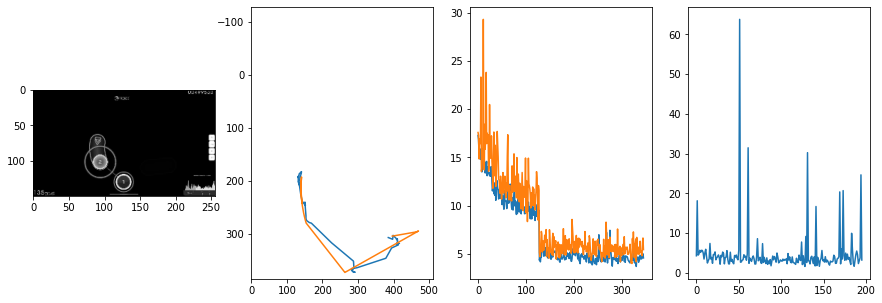


 352 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.89it/s  2.0885                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 6.3040995378883515
outliers: 116
retrain: 4                 
val: 50/50 loss: 4.7649                                    
pred: 0.2362920492887497 0.5905731320381165
gt: 0.484637975692749 0.8470985889434814
(123, 116)


<Figure size 1080x360 with 0 Axes>

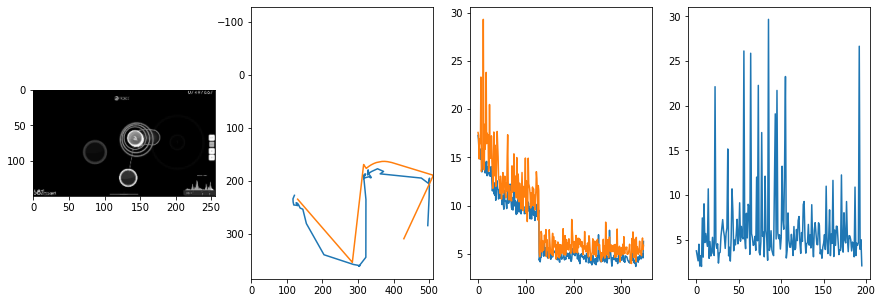


 353 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.90it/s  3.4372                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.456424686981707
outliers: 18
retrain: 4                 
val: 50/50 loss: 2.7538                                    
pred: 0.36241254210472107 0.6885225772857666
gt: 0.02798292599618435 0.5736697912216187
(52, 84)


<Figure size 1080x360 with 0 Axes>

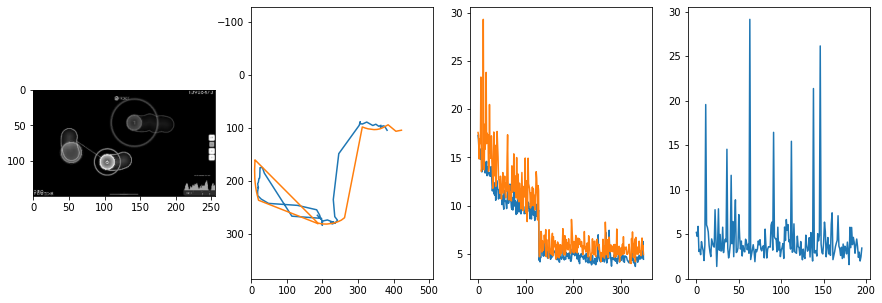


 354 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.05it/s  3.1416                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.426929455022423
outliers: 48
retrain: 4                 
val: 50/50 loss: 4.6124                                    
pred: 0.7378635406494141 0.5854846835136414
gt: 0.5020301342010498 0.8003771305084229
(125, 111)


<Figure size 1080x360 with 0 Axes>

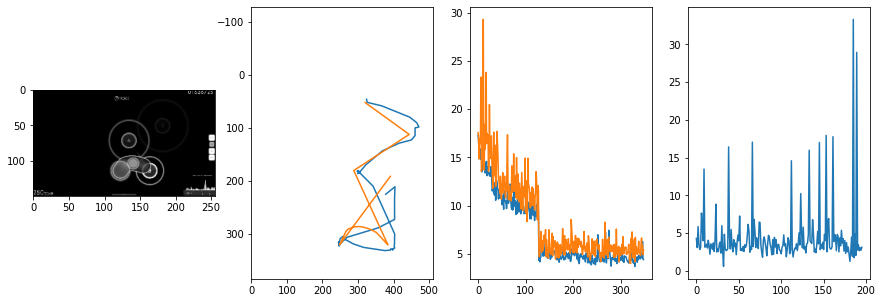


 355 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.94it/s  2.5704                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.473586418798992
outliers: 46
retrain: 4                 
val: 50/50 loss: 11.0403                                   
pred: 0.3717760741710663 0.3135093152523041
gt: 0.6045301556587219 0.41688403487205505
(141, 66)


<Figure size 1080x360 with 0 Axes>

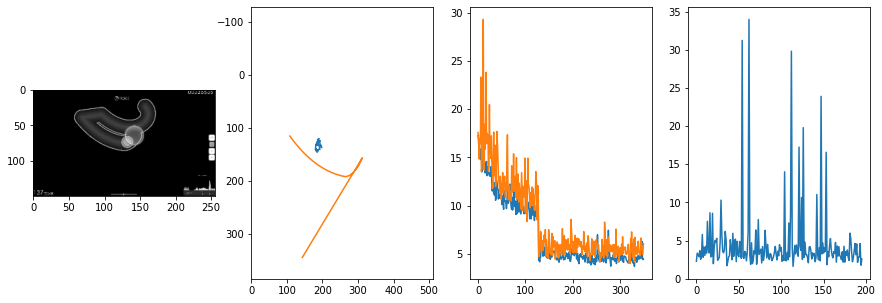


 356 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.88it/s  5.4036                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.410111150571278
outliers: 50
retrain: 4                 
val: 50/50 loss: 2.8440                                    
pred: 0.6035287380218506 0.5195670127868652
gt: 0.6152186989784241 0.6664411425590515
(143, 95)


<Figure size 1080x360 with 0 Axes>

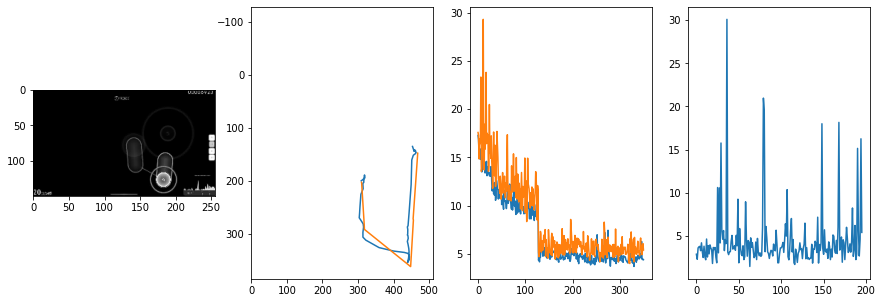


 357 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  14.3544                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.276500889841391
outliers: 43
retrain: 4                 
val: 50/50 loss: 2.8761                                    
pred: 0.6700345277786255 0.5773403644561768
gt: 0.4843766391277313 0.13542035222053528
(123, 33)


<Figure size 1080x360 with 0 Axes>

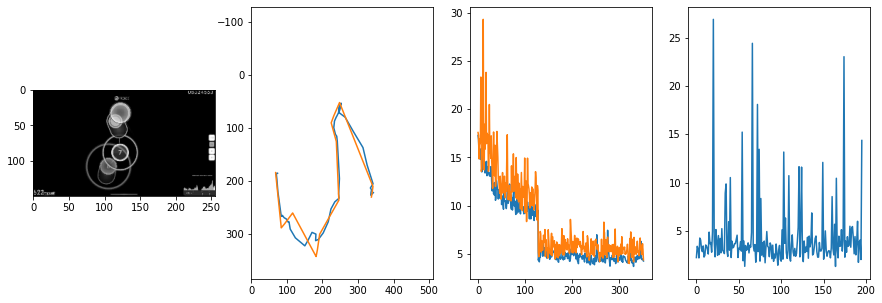


 358 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.77it/s  3.6672                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.4044196973649825
outliers: 52
retrain: 4                 
val: 50/50 loss: 10.1919                                   
pred: 0.5438292026519775 0.5046232342720032
gt: 0.5809615254402161 0.5835993885993958
(138, 85)


<Figure size 1080x360 with 0 Axes>

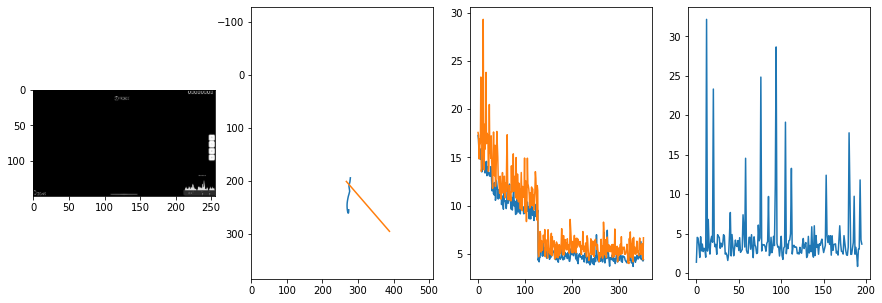


 359 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  14.00it/s  4.0991                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.126957106346986
outliers: 42
retrain: 4                 
val: 50/50 loss: 3.6255                                    
pred: 0.24215562641620636 0.5509259104728699
gt: 0.3378589153289795 0.6691438555717468
(100, 95)


<Figure size 1080x360 with 0 Axes>

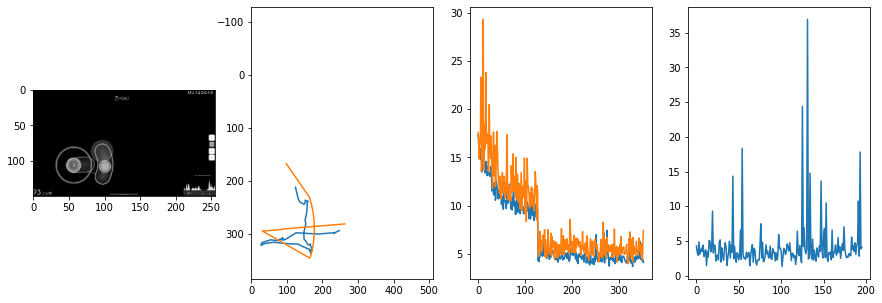


 360 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  2.6901                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 5.009261578929667
outliers: 66
retrain: 4                 
val: 50/50 loss: 3.7685                                    
pred: 0.3424656391143799 0.5526660680770874
gt: 0.7128560543060303 0.7037365436553955
(158, 99)


<Figure size 1080x360 with 0 Axes>

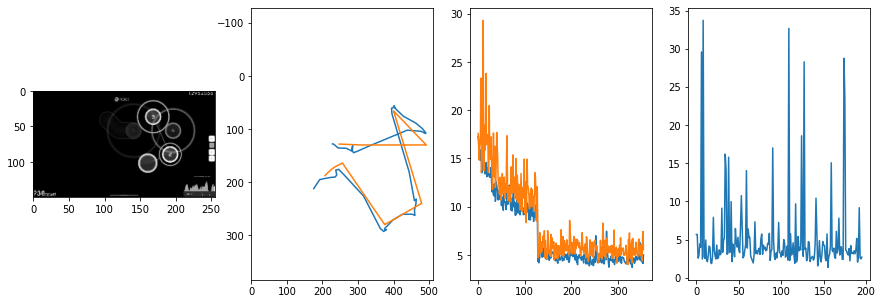


 361 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  3.6097                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.580334597096151
outliers: 35
retrain: 4                 
val: 50/50 loss: 2.6252                                    
pred: 0.46941304206848145 0.6578561067581177
gt: 0.4223467707633972 0.6070313453674316
(113, 88)


<Figure size 1080x360 with 0 Axes>

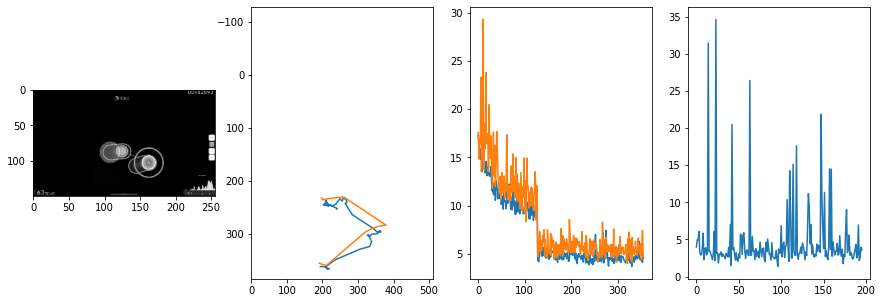


 362 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.83it/s  4.2049                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.857709089712221
outliers: 40
retrain: 4                 
val: 50/50 loss: 3.4099                                    
pred: 0.33636823296546936 0.866928219795227
gt: 0.5820316076278687 0.7300991415977478
(138, 102)


<Figure size 1080x360 with 0 Axes>

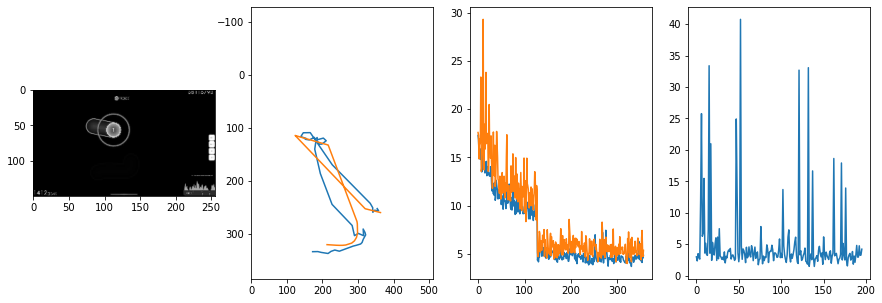


 363 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.94it/s  4.4533                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.912995075692936
outliers: 46
retrain: 4                 
val: 50/50 loss: 6.6993                                    
pred: 0.2576054334640503 0.7977949380874634
gt: 0.18745866417884827 0.8266249299049377
(77, 114)


<Figure size 1080x360 with 0 Axes>

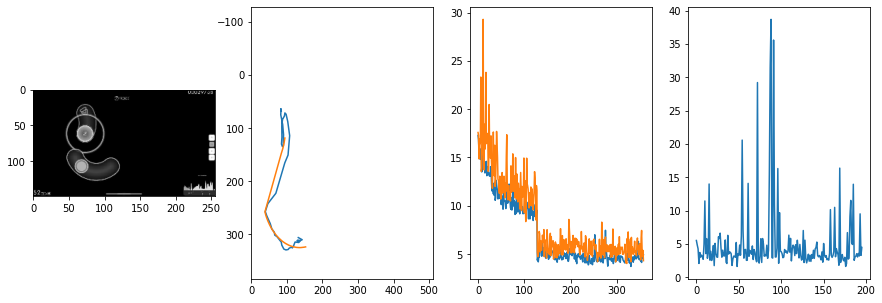


 364 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.83it/s  3.1487                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.106207794072676
outliers: 30
retrain: 4                 
val: 50/50 loss: 3.9603                                    
pred: 0.9011867642402649 0.5241657495498657
gt: 0.640625 0.2838541567325592
(147, 51)


<Figure size 1080x360 with 0 Axes>

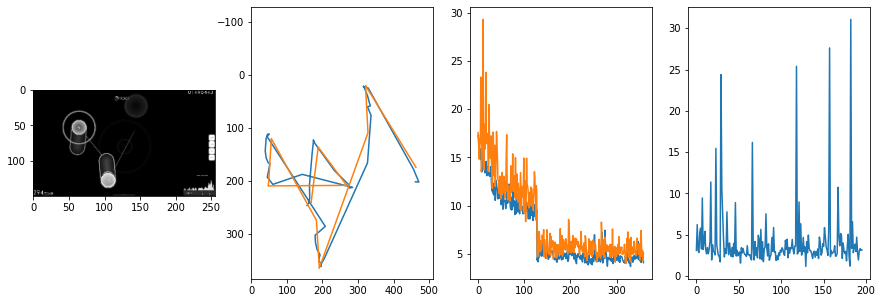


 365 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.84it/s  3.7571                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.8917222254130306
outliers: 37
retrain: 4                 
val: 50/50 loss: 2.6273                                    
pred: 0.5657779574394226 0.7573736310005188
gt: 0.5300261378288269 0.6994783282279968
(130, 99)


<Figure size 1080x360 with 0 Axes>

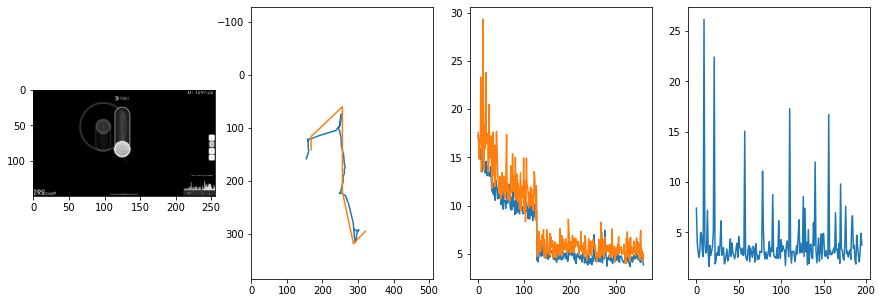


 366 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  24.3539                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.577398664489085
outliers: 72
retrain: 4                 
val: 50/50 loss: 3.0334                                    
pred: 0.10822972655296326 0.6304680109024048
gt: 0.33202388882637024 0.8489459156990051
(99, 116)


<Figure size 1080x360 with 0 Axes>

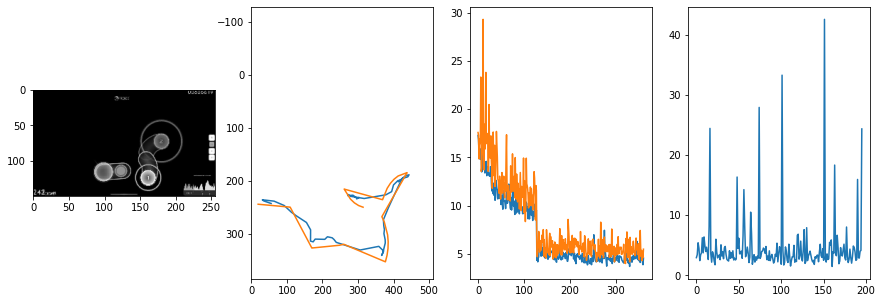


 367 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.78it/s  3.0431                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.219751347692645
outliers: 31
retrain: 4                 
val: 50/50 loss: 3.4013                                    
pred: 0.7418699264526367 0.41461965441703796
gt: 0.4277484118938446 0.2890586256980896
(114, 51)


<Figure size 1080x360 with 0 Axes>

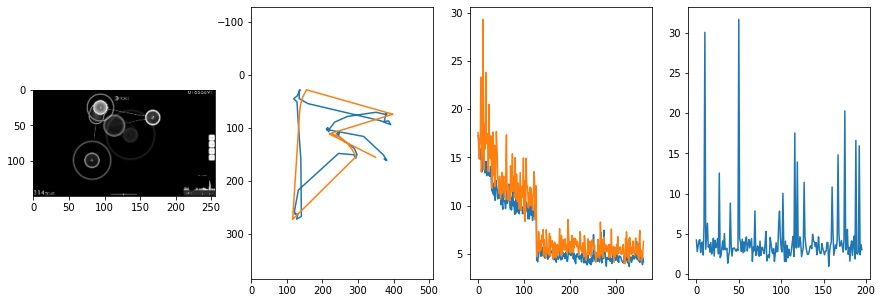


 368 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.04it/s  2.9012                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.053475483947871
outliers: 46
retrain: 4                 
val: 50/50 loss: 2.5332                                    
pred: 0.2540859282016754 0.08328395336866379
gt: 0.306640625 0.3802083432674408
(95, 62)


<Figure size 1080x360 with 0 Axes>

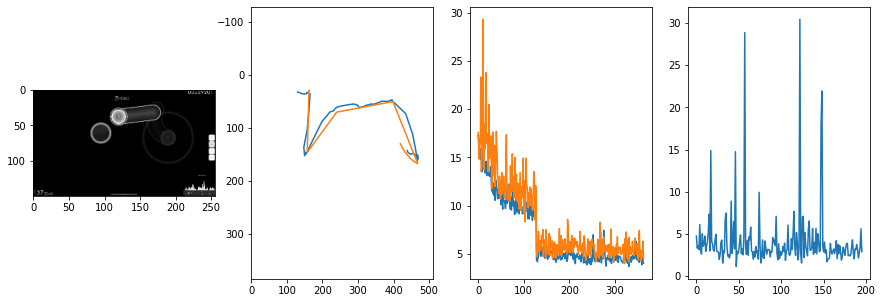


 369 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.88it/s  4.1205                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.218925057625284
outliers: 55
retrain: 4                 
val: 50/50 loss: 3.4267                                    
pred: 0.3664530813694 0.26928701996803284
gt: 0.4003012776374817 0.2833908498287201
(110, 50)


<Figure size 1080x360 with 0 Axes>

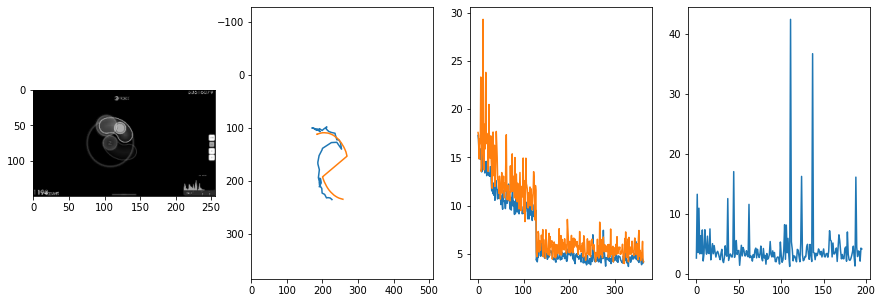


 370 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.00it/s  4.1297                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.675605628563433
outliers: 53
retrain: 4                 
val: 50/50 loss: 5.8391                                    
pred: 0.5071950554847717 0.4364526569843292
gt: 0.5692977905273438 0.40825578570365906
(136, 65)


<Figure size 1080x360 with 0 Axes>

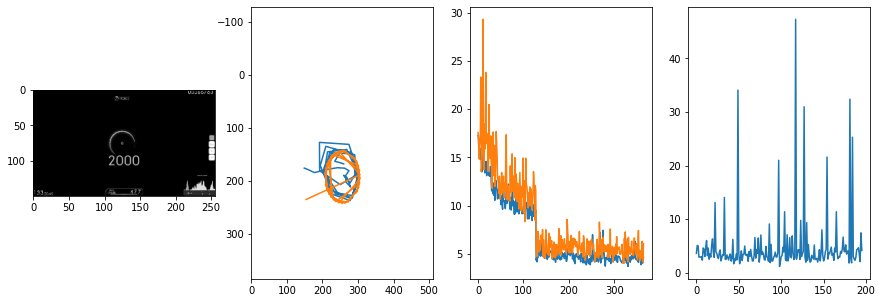


 371 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.23it/s  18.6602                                 

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.789253596748624
outliers: 47
retrain: 4                 
val: 50/50 loss: 4.9100                                    
pred: 0.7813259959220886 0.335050493478775
gt: 0.7871048450469971 0.5364469885826111
(170, 80)


<Figure size 1080x360 with 0 Axes>

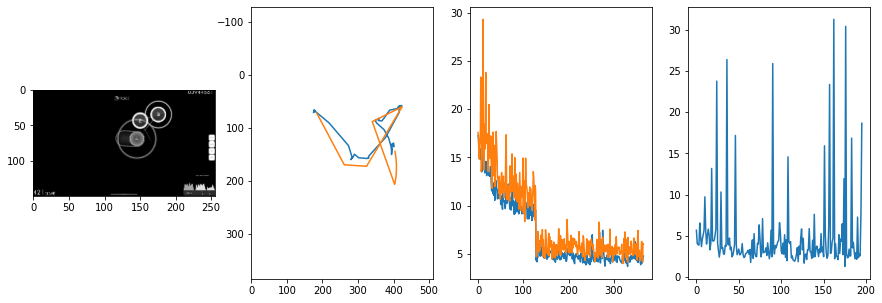


 372 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.82it/s  3.1465                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.595836331649703
outliers: 39
retrain: 4                 
val: 50/50 loss: 3.5198                                    
pred: 0.49003469944000244 0.5367352366447449
gt: 0.334231436252594 0.616383969783783
(99, 89)


<Figure size 1080x360 with 0 Axes>

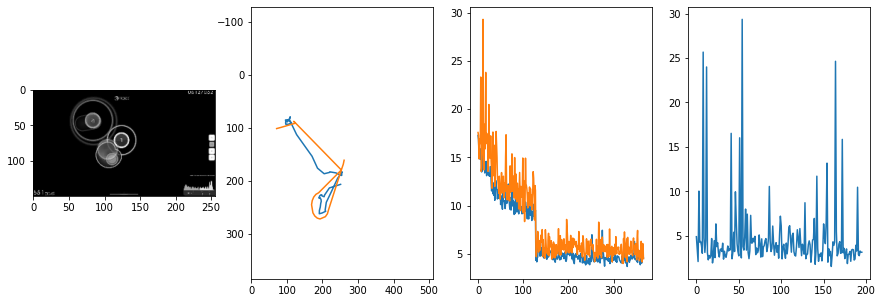


 373 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.80it/s  2.6031                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.18371889299276
outliers: 34
retrain: 4                 
val: 50/50 loss: 2.6124                                    
pred: 0.4713450074195862 0.83456951379776
gt: 0.6210960149765015 0.8723926544189453
(144, 119)


<Figure size 1080x360 with 0 Axes>

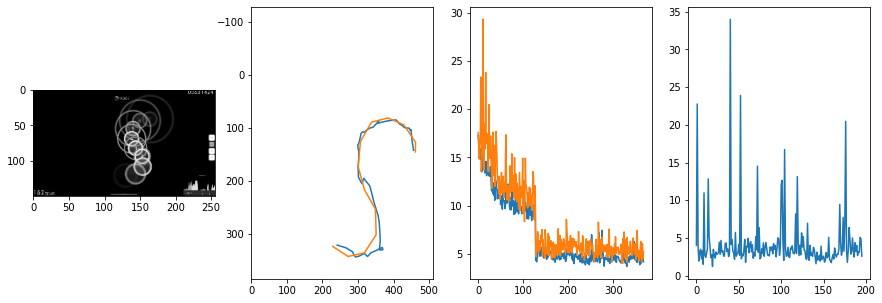


 374 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  3.3478                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.416319651263101
outliers: 51
retrain: 4                 
val: 50/50 loss: 4.8802                                    
pred: 0.6363906860351562 0.44336652755737305
gt: 0.9193920493125916 0.3913284242153168
(190, 63)


<Figure size 1080x360 with 0 Axes>

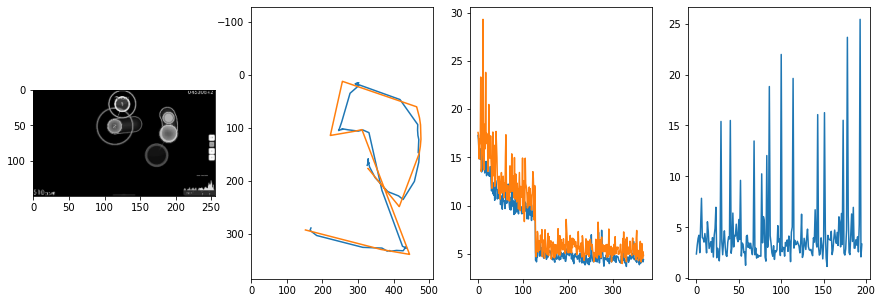


 375 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.93it/s  2.4693                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.375065730542553
outliers: 31
retrain: 4                 
val: 50/50 loss: 4.4950                                    
pred: 0.5623036623001099 0.7795278429985046
gt: 0.693359375 0.7682291865348816
(155, 107)


<Figure size 1080x360 with 0 Axes>

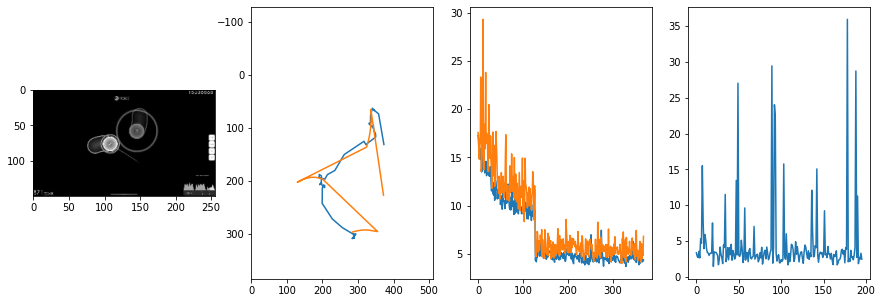


 376 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.88it/s  3.0392                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.981336321757764
outliers: 63
retrain: 4                 
val: 50/50 loss: 6.5074                                    
pred: 0.5216366052627563 0.45529410243034363
gt: 0.1894838660955429 0.5260380506515503
(77, 79)


<Figure size 1080x360 with 0 Axes>

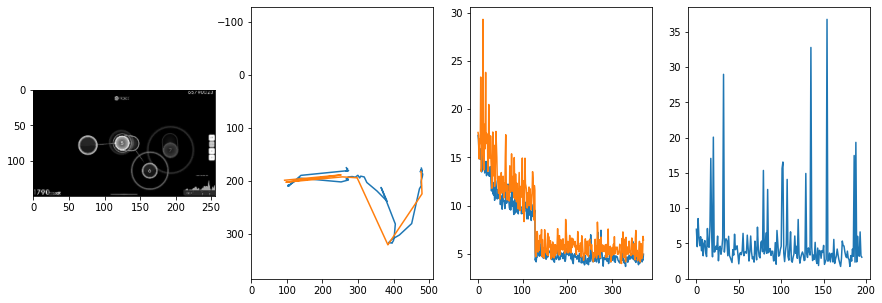


 377 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  2.6399                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.30351686356019
outliers: 28
retrain: 4                 
val: 50/50 loss: 4.7696                                    
pred: 0.3928031325340271 0.4953556954860687
gt: 0.6679680347442627 0.557291567325592
(151, 82)


<Figure size 1080x360 with 0 Axes>

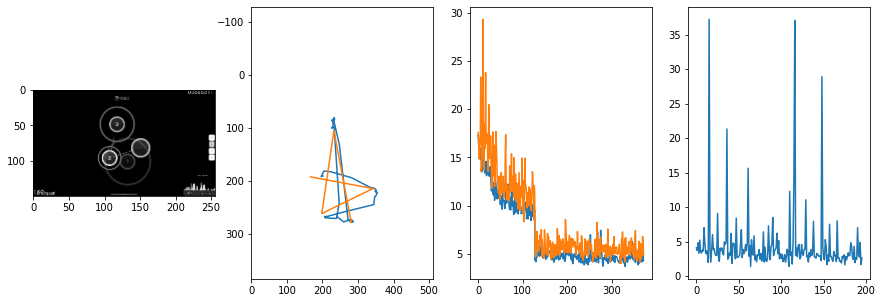


 378 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.74it/s  3.4886                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.472842150804948
outliers: 49
retrain: 4                 
val: 50/50 loss: 32.0996                                   
pred: 0.4740792214870453 0.4503522217273712
gt: 0.32913586497306824 0.810662031173706
(99, 112)


<Figure size 1080x360 with 0 Axes>

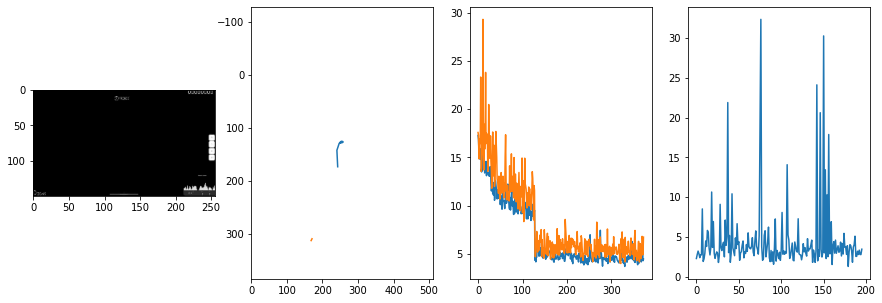


 379 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.90it/s  2.3714                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.19921620098912
outliers: 27
retrain: 4                 
val: 50/50 loss: 3.5329                                    
pred: 0.5631552338600159 0.5814084410667419
gt: 0.28125 0.34375
(91, 57)


<Figure size 1080x360 with 0 Axes>

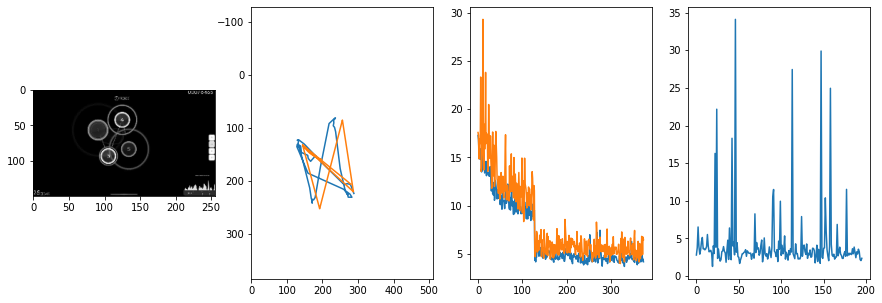


 380 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.97it/s  3.0978                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.395617682106641
outliers: 54
retrain: 4                 
val: 50/50 loss: 3.3767                                    
pred: 0.17245113849639893 0.6231652498245239
gt: 0.09180039912462234 0.7994586825370789
(62, 110)


<Figure size 1080x360 with 0 Axes>

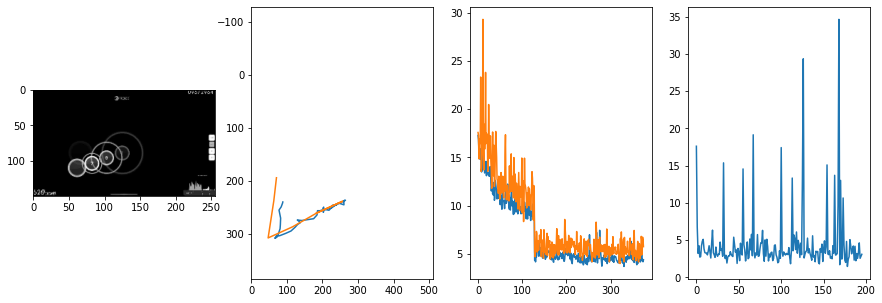


 381 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.82it/s  2.0298                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.440000006738974
outliers: 42
retrain: 4                 
val: 50/50 loss: 23.0441                                   
pred: 0.4127938449382782 0.43017831444740295
gt: 0.5625003576278687 0.1979169398546219
(135, 41)


<Figure size 1080x360 with 0 Axes>

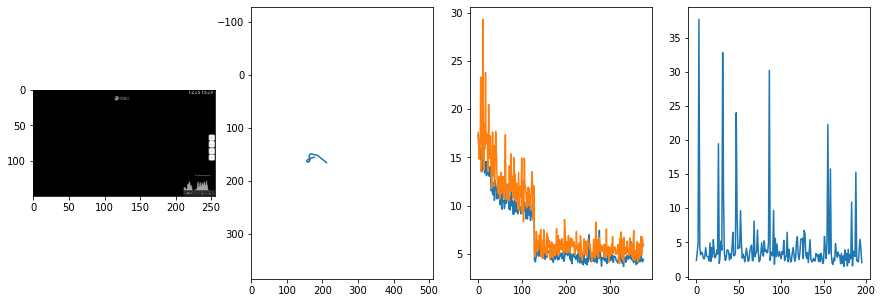


 382 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.86it/s  2.5838                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 3.970743493766201
outliers: 31
retrain: 4                 
val: 50/50 loss: 3.6751                                    
pred: 0.33425453305244446 0.4605782926082611
gt: 0.27093082666397095 0.3372304141521454
(90, 57)


<Figure size 1080x360 with 0 Axes>

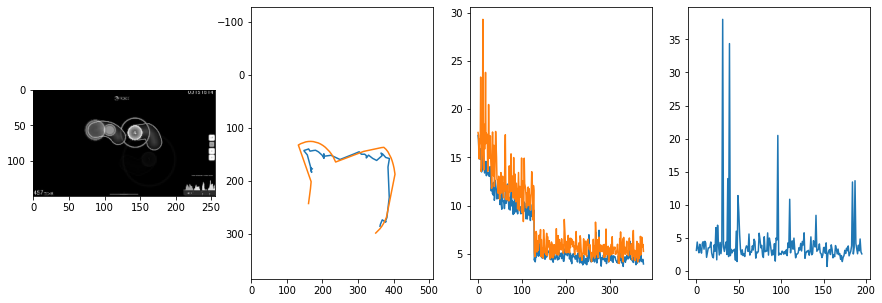


 383 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.92it/s  4.1666                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.196514598569092
outliers: 52
retrain: 4                 
val: 50/50 loss: 5.7332                                    
pred: 0.3607332408428192 0.4250294864177704
gt: 0.35718226432800293 0.6935978531837463
(103, 98)


<Figure size 1080x360 with 0 Axes>

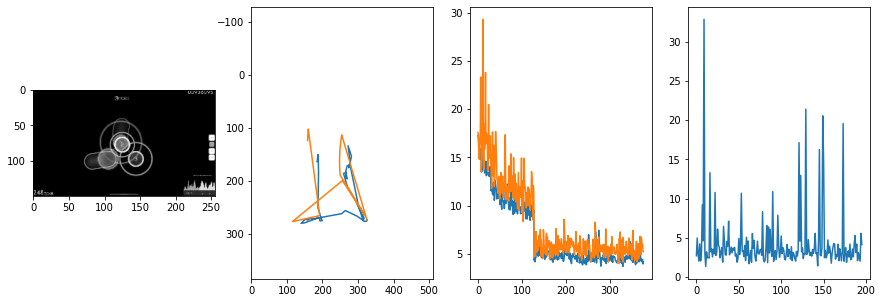


 384 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.81it/s  3.9389                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.520943645311862
outliers: 42
retrain: 4                 
val: 50/50 loss: 2.4058                                    
pred: 0.7309622764587402 0.4883505403995514
gt: 0.578125 0.5833333134651184
(137, 85)


<Figure size 1080x360 with 0 Axes>

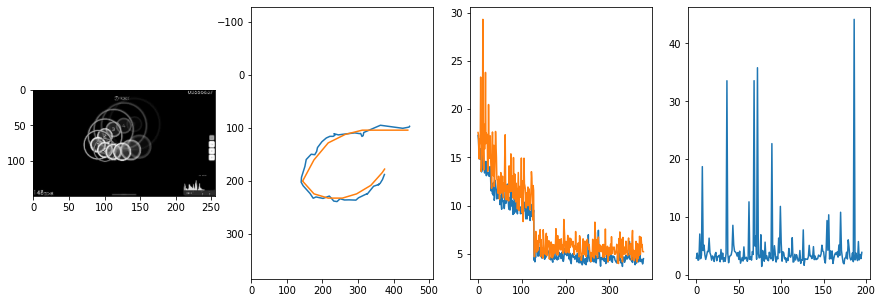


 385 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.06it/s  2.4671                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.396283687985673
outliers: 35
retrain: 4                 
val: 50/50 loss: 3.3489                                    
pred: 0.655619204044342 0.5380662083625793
gt: 0.7602593898773193 0.21185632050037384
(165, 42)


<Figure size 1080x360 with 0 Axes>

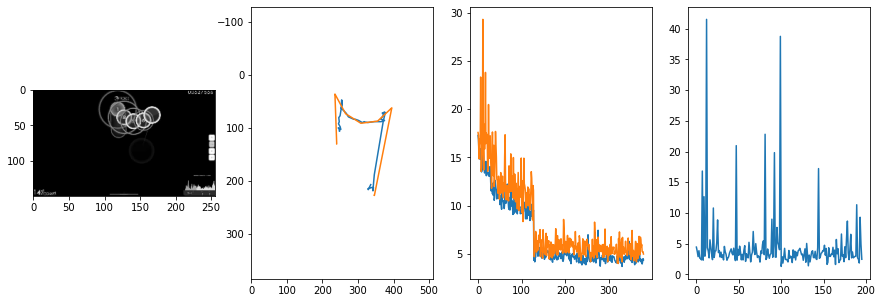


 386 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.11it/s  1.9024                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.289288635156592
outliers: 35
retrain: 4                 
val: 50/50 loss: 2.8206                                    
pred: 0.2145620733499527 0.27288416028022766
gt: 0.11641108244657516 0.42073166370391846
(66, 66)


<Figure size 1080x360 with 0 Axes>

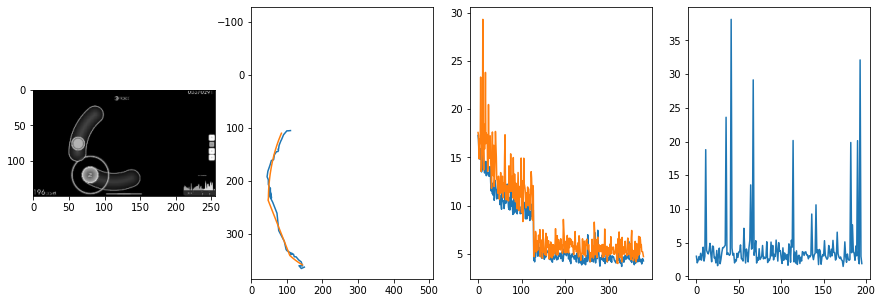


 387 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:13<00:00:00  14.12it/s  3.1956                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.506238208741558
outliers: 47
retrain: 4                 
val: 50/50 loss: 4.7447                                    
pred: 0.34528830647468567 0.3901961147785187
gt: 0.41210973262786865 0.19531339406967163
(111, 40)


<Figure size 1080x360 with 0 Axes>

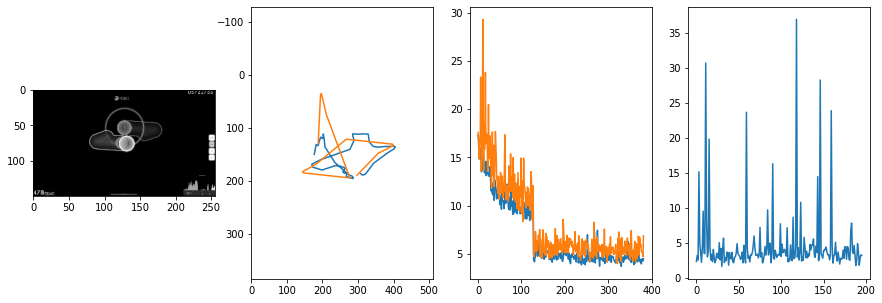


 388 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.73it/s  2.8762                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.059681056713571
outliers: 35
retrain: 4                 
val: 50/50 loss: 6.5970                                    
pred: 0.5780676007270813 0.4416656196117401
gt: 0.5864966511726379 0.4395561218261719
(138, 69)


<Figure size 1080x360 with 0 Axes>

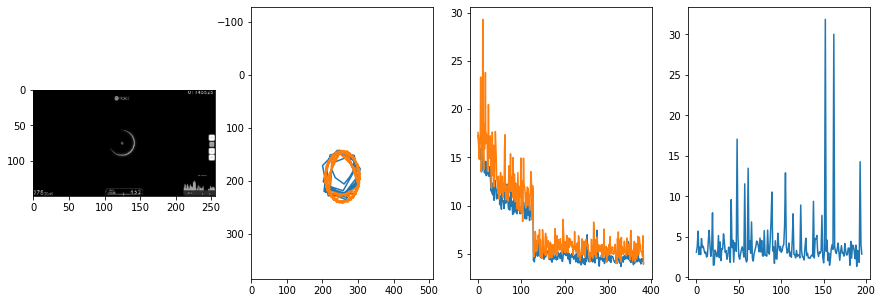


 389 of 390


  Iters     Elapsed Time       Speed     loss                                   
 196/196  00:00:14<00:00:00  13.98it/s  3.5959                                  

IpythonBar(children=(HTML(value='  0.0%'), FloatProgress(value=0.0)))

/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1933: UserWarning: nn.functional.tanh is deprecated. Use torch.tanh instead.
  warnings.warn("nn.functional.tanh is deprecated. Use torch.tanh instead.")
/home/poi/proj/osuAi/osuAi/.env/lib/python3.10/site-packages/torch/nn/functional.py:1944: UserWarning: nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.
  warnings.warn("nn.functional.sigmoid is deprecated. Use torch.sigmoid instead.")


avg: 4.03711416040148
outliers: 44
retrain: 4                 
val: 50/50 loss: 2.7594                                    
pred: 0.18678945302963257 0.30916088819503784
gt: 0.34356948733329773 0.6119666695594788
(101, 89)


<Figure size 1080x360 with 0 Axes>

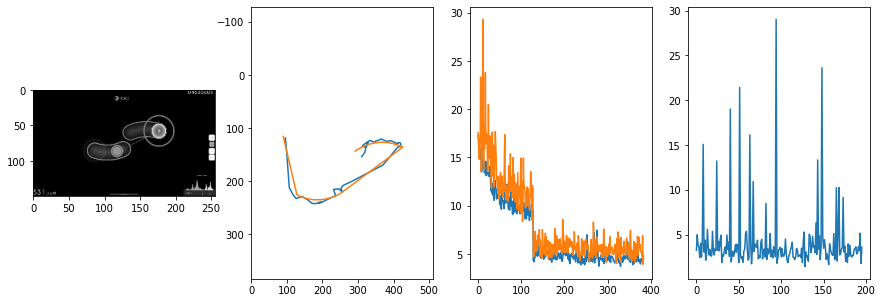


 390 of 390
2596.1523258686066 secs


In [73]:
start = time.time()

epochs = 128
loss_thresh = 0.0003
rnum_min = 4
trainVNRecurse()

end = time.time()
print(end - start, 'secs')

In [74]:
print(best_loss)
torch.save(best_weights, model_path + str(epoch_cum) + '.pt')

3.9380082988739016


# Test Model

In [14]:
import os
import cv2
import torch
import torchvision.transforms as transforms

In [15]:
vn.load_state_dict(torch.load(model_path + str(390) + '.pt'))

<All keys matched successfully>

In [28]:
#osud = '../demo/beatmaps/567301 LamazeP - Spam Jack'
#osuf = 'LamazeP - Spam Jack (OsuToothbrush) [SPAM].osu'
#osud = '../ex/beatmaps/252981 DJ Okawari - Flower Dance (Short Ver)'
#osuf = 'DJ Okawari - Flower Dance (Short Ver.) (-Hanayuki-) [Relax].osu'
#osud = '../demo/beatmaps/348381 sasakureUK - Spider Thread Monopoly feat Hatsune Miku'
#osuf = 'sasakure.UK - Spider Thread Monopoly feat. Hatsune Miku (Mishima Yurara) [Milan-\'s Hard].osu'
#osud = '../demo/beatmaps/835194 Mili - Vulnerability'
#osuf = 'Mili_-_Vulnerability_IceKalt_Saturnalizes_Insane.osu'
#osud = '../demo/beatmaps/653534 Panda Eyes - ILY'
#osuf = 'Panda Eyes - ILY (M a r v o l l o) [Light Insane].osu'
osud = '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun'
osuf = 'Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu'
#osud = '../demo/beatmaps/962088 MIMI feat Hatsune Miku - Marshmary'
#osuf = 'MIMI feat. Hatsune Miku - Marshmary (Log Off Now) [Horizon].osu'
#osud = '../demo/beatmaps/1314370 GYARI, Nekomiya Hinata - Nekomiya Days'
#osuf = 'GYARI, Nekomiya Hinata - Nekomiya Days (Thanres) [Neko-days].osu'

In [29]:
hidden = True
osr = OSR(osud, osuf, sample_rate=sample_rate, hop_size=hop_size, hidden=hidden, vtmp='../demo/vids/')

In [30]:
osr.queue_vid()

'../demo/vids/Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osuhdn.avi'

In [31]:
hdn = 'hdn' if hidden else ''
video_path = os.path.join('../demo/vids/', osuf + hdn + '.avi')

In [32]:
vn.to(device)
vn.init_hidden(1)
vn.eval()

VN(
  (convB1): Conv2d(1, 4, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPB1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (convC1): Conv2d(4, 8, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (maxPC1): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (lstmA): LSTM(19456, 256, num_layers=2, batch_first=True)
  (linearA): Linear(in_features=256, out_features=256, bias=True)
  (normA): LayerNorm((256,), eps=1e-05, elementwise_affine=True)
  (linearB): Linear(in_features=256, out_features=32, bias=True)
  (normB): LayerNorm((32,), eps=1e-05, elementwise_affine=True)
  (linearC): Linear(in_features=32, out_features=2, bias=True)
)

In [33]:
start = time.time()

transform = transforms.ToTensor()
frames = []
vc = cv2.VideoCapture(video_path)
p = []
while True:
    r, f = vc.read()
    if r is False:
        break
    f = cv2.resize(f, (0,0), fx=scale, fy=scale)
    f = cv2.cvtColor(f, cv2.COLOR_BGR2GRAY)
    F = transform(f).to(device)
    with torch.no_grad():
        P = vn(F.unsqueeze(0).unsqueeze(0))
    p.append(P.squeeze(0).squeeze(0).cpu().detach().numpy())
    
end = time.time()
print(end - start, 'secs')

5.788782358169556 secs


In [34]:
np.save('predVN.npy', p)

# Create Replay Video

In [35]:
from IPython.display import Video

In [36]:
eosud = osud.replace('/', '\/')

In [37]:
!sed -i "s/Beatmap path.*/Beatmap path\": \"$eosud\/$osuf\",/" data.json
!sed -i "s/Output path.*/Output path\": \"videoVN.mp4\",/" data.json

In [38]:
!python create_replayVN.py predVN.npy 50

2022-04-20 11:59:57,105:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-20 11:59:57,105:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun/Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'videoVN.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7fa54eedf550>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb'

In [39]:
Video("videoVN.mp4")

In [40]:
!sed -i "s/Output path.*/Output path\": \"video.mp4\",/" data.json

In [43]:
!python create_replay.py predASU.npy predVN.npy 50 0.5

2022-04-20 12:02:11,833:INFO:osr2mp4.Osr2mp4:__init__:test
2022-04-20 12:02:11,833:TRACE:osr2mp4.Utils.Setup:setupglobals:CALL *({'osu! path': '', 'Skin path': 'skin/', 'Beatmap path': '../demo/beatmaps/388036 Akiyama Uni - Kanpan Tasogare Shinbun/Akiyama Uni - Kanpan Tasogare Shinbun (09kami) [Insane].osu', '.osr path': 'auto', 'Default skin path': 'skin/', 'Output path': 'video.mp4', 'Width': 1024, 'Height': 600, 'FPS': 30, 'Start time': 0, 'End time': -1, 'Video codec': 'mjpeg', 'Process': 0, 'ffmpeg path': 'ffmpeg'}, {'Show score meter': True, 'Always show key overlay': True, 'Song volume': 100, 'Effect volume': 100, 'Enable PP counter': True, 'Enable Strain Graph': True, 'FFmpeg codec': 'libx264', 'FFmpeg custom commands': '', 'Audio bitrate': 320, 'api key': None, 'Use FFmpeg video writer': True, 'Custom mods': ''}, [], <osr2mp4.global_var.Settings object at 0x7f0d340a35b0>) **{'ppsettings': {'x': 1220, 'y': 690, 'text_x': 1140, 'text_y': 748, 'Font Size': 20, 'Size': 10, 'Rgb': 

In [44]:
Video("video.mp4")